In [1]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import os

def load_religion_data(data_dir):
    class_names = ['مسلم', 'مسلمة', 'مسيحي', 'مسيحية']  # 0: مسلم, 1: مسلمة, 2: مسيحي, 3: مسيحية
    X, Y = [], []
    for label, class_name in enumerate(class_names):
        class_dir = os.path.join(data_dir, class_name)
        for file in os.listdir(class_dir):
            img_path = os.path.join(class_dir, file)
            img = load_img(img_path, target_size=(64, 100))  # Same size as gender model
            img_array = img_to_array(img) / 255.0
            X.append(img_array)
            Y.append(label)
    return np.array(X), np.array(Y)

if __name__ == "__main__":
    data_dir =r"C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion"
    X, Y = load_religion_data(data_dir)
    print(f"Total samples: {len(X)}")
    print("Class counts:", {i: sum(Y==i) for i in range(4)})

Total samples: 6151
Class counts: {0: np.int64(1578), 1: np.int64(1542), 2: np.int64(1517), 3: np.int64(1514)}


In [2]:
from tensorflow.keras import layers, models

def create_religion_model():
    model = models.Sequential([
        layers.Conv2D(32, (5, 5), activation='relu', input_shape=(64, 100, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.BatchNormalization(),
        
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        
        layers.Conv2D(128, (3, 3), activation='relu'),
        layers.GlobalAveragePooling2D(),
        
        layers.Dense(64, activation='relu'),
        layers.Dropout(0.5),
        layers.Dense(4, activation='softmax')  # 4 classes for religion
    ])
    
    model.compile(optimizer=tf.keras.optimizers.Adam(0.001),
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])
    return model

In [3]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import confusion_matrix, classification_report
import matplotlib.pyplot as plt
import os

def run_religion_cross_validation(X, Y, n_splits=5, epochs=100, batch_size=32):
    kfold = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)
    fold_no = 1
    all_val_preds = []
    all_val_true = []
    best_model = None
    best_score = 0

    os.makedirs('religion_cv_results', exist_ok=True)

    for train_idx, val_idx in kfold.split(X, Y):
        print(f'\n=== Fold {fold_no}/{n_splits} ===')
        
        model = create_religion_model()
        early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True, verbose=1)
        
        history = model.fit(
            X[train_idx], Y[train_idx],
            validation_data=(X[val_idx], Y[val_idx]),
            epochs=epochs,
            batch_size=batch_size,
            callbacks=[early_stop],
            verbose=1
        )
        
        scores = model.evaluate(X[val_idx], Y[val_idx], verbose=0)
        val_preds = np.argmax(model.predict(X[val_idx]), axis=1)
        
        all_val_preds.extend(val_preds)
        all_val_true.extend(Y[val_idx])
        
        if scores[1] > best_score:
            best_score = scores[1]
            best_model = model
            print(f"New best model with val_accuracy: {best_score:.4f}")
        
        plt.figure()
        plt.plot(history.history['accuracy'], label='train')
        plt.plot(history.history['val_accuracy'], label='validation')
        plt.title(f'Fold {fold_no} Accuracy')
        plt.legend()
        plt.savefig(f'religion_cv_results/fold_{fold_no}_history.png')
        plt.close()
        #used to track and visualize training progress accuracy Loss over epochs for each fold. 
        
        fold_no += 1

    if best_model:
        best_model.save('religion_cv_results/best_religion_model.h5')
        print(f"\nSaved best model with validation accuracy: {best_score:.4f}")
    
    print("\n=== Overall Cross-Validation Metrics ===")
    class_names = ['مسلم', 'مسلمة', 'مسيحي', 'مسيحية']
    print(classification_report(all_val_true, all_val_preds, target_names=class_names))

    cm = confusion_matrix(all_val_true, all_val_preds)  #Computes a confusion matrix cm by comparing the true labels (all_val_true) with the predicted labels all_val_preds
    plt.figure(figsize=(8, 6))
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title('Confusion Matrix')
    plt.colorbar()
    tick_marks = np.arange(4)
    plt.xticks(tick_marks, class_names, rotation=45)
    plt.yticks(tick_marks, class_names)
    plt.ylabel('True')
    plt.xlabel('Predicted')
    plt.tight_layout()
    plt.savefig('religion_cv_results/confusion_matrix.png')
    plt.close()
    #ALL THESE ARE JUST TO MAEK SURE THAT I DONT HAVE ANY MISSCLASSIFICATION AND TO 
    #THESE VISUALIZATIONS HELPS MAKES IT EASY TO SPOT ERROR IN PATTERNS 

    return best_model

if __name__ == "__main__":
    data_dir = r"C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion"
    X, Y = load_religion_data(data_dir)
    
    print(f"Total samples: {len(X)}")
    print("Class distribution:", {i: sum(Y==i) for i in range(4)})

    best_model = run_religion_cross_validation(X, Y)

    # Final training on all data
    final_model = create_religion_model()
    early_stop = EarlyStopping(monitor='loss', patience=5, restore_best_weights=True, verbose=1)
    final_model.fit(X, Y, epochs=100, batch_size=32, callbacks=[early_stop])
    final_model.save('final_religion_model.h5')

Total samples: 6151
Class distribution: {0: np.int64(1578), 1: np.int64(1542), 2: np.int64(1517), 3: np.int64(1514)}

=== Fold 1/5 ===


c:\Users\alhas\Downloads\LABELED IDSSSS\.venv\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100
154/154 ━━━━━━━━━━━━━━━━━━━━ 36s 191ms/step - accuracy: 0.3377 - loss: 1.3429 - val_accuracy: 0.3972 - val_loss: 1.2981
Epoch 2/100
154/154 ━━━━━━━━━━━━━━━━━━━━ 41s 190ms/step - accuracy: 0.5267 - loss: 1.0264 - val_accuracy: 0.6158 - val_loss: 0.9190
Epoch 3/100
154/154 ━━━━━━━━━━━━━━━━━━━━ 29s 189ms/step - accuracy: 0.7082 - loss: 0.6880 - val_accuracy: 0.3599 - val_loss: 1.5290
Epoch 4/100
154/154 ━━━━━━━━━━━━━━━━━━━━ 29s 187ms/step - accuracy: 0.8452 - loss: 0.4241 - val_accuracy: 0.8505 - val_loss: 0.3813
Epoch 5/100
154/154 ━━━━━━━━━━━━━━━━━━━━ 29s 189ms/step - accuracy: 0.9453 - loss: 0.1800 - val_accuracy: 0.5995 - val_loss: 2.2906
Epoch 6/100
154/154 ━━━━━━━━━━━━━━━━━━━━ 29s 191ms/step - accuracy: 0.9696 - loss: 0.1055 - val_accuracy: 0.9854 - val_loss: 0.0528
Epoch 7/100
154/154 ━━━━━━━━━━━━━━━━━━━━ 41s 191ms/step - accuracy: 0.9730 - loss: 0.0770 - val_accuracy: 0.7173 - val_loss: 2.4167
Epoch 8/100
154/154 ━━━━━━━━━━━━━━━━━━━━ 30s 192ms/step - accuracy: 0.9825 -


Saved best model with validation accuracy: 1.0000

=== Overall Cross-Validation Metrics ===
              precision    recall  f1-score   support

        مسلم       1.00      1.00      1.00      1578
       مسلمة       1.00      1.00      1.00      1542
       مسيحي       1.00      1.00      1.00      1517
      مسيحية       1.00      1.00      1.00      1514

    accuracy                           1.00      6151
   macro avg       1.00      1.00      1.00      6151
weighted avg       1.00      1.00      1.00      6151



c:\Users\alhas\Downloads\LABELED IDSSSS\.venv\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100
193/193 ━━━━━━━━━━━━━━━━━━━━ 41s 181ms/step - accuracy: 0.3321 - loss: 1.3245
Epoch 2/100
193/193 ━━━━━━━━━━━━━━━━━━━━ 35s 181ms/step - accuracy: 0.5165 - loss: 1.0260
Epoch 3/100
193/193 ━━━━━━━━━━━━━━━━━━━━ 41s 180ms/step - accuracy: 0.6738 - loss: 0.7700
Epoch 4/100
193/193 ━━━━━━━━━━━━━━━━━━━━ 35s 181ms/step - accuracy: 0.8011 - loss: 0.5031
Epoch 5/100
193/193 ━━━━━━━━━━━━━━━━━━━━ 35s 181ms/step - accuracy: 0.9276 - loss: 0.2283
Epoch 6/100
193/193 ━━━━━━━━━━━━━━━━━━━━ 41s 181ms/step - accuracy: 0.9668 - loss: 0.1094
Epoch 7/100
193/193 ━━━━━━━━━━━━━━━━━━━━ 41s 178ms/step - accuracy: 0.9762 - loss: 0.0911
Epoch 8/100
193/193 ━━━━━━━━━━━━━━━━━━━━ 41s 177ms/step - accuracy: 0.9829 - loss: 0.0524
Epoch 9/100
193/193 ━━━━━━━━━━━━━━━━━━━━ 41s 179ms/step - accuracy: 0.9885 - loss: 0.0359
Epoch 10/100
193/193 ━━━━━━━━━━━━━━━━━━━━ 41s 178ms/step - accuracy: 0.9935 - loss: 0.0265
Epoch 11/100
193/193 ━━━━━━━━━━━━━━━━━━━━ 41s 181ms/step - accuracy: 0.9883 - loss: 0.0370
Epoch 12

Model path exists: True
Test folder exists: True


✅ Successfully loaded model from religion_cv_results\best_religion_model.h5
🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_100_egypt_id_189_1.jpg


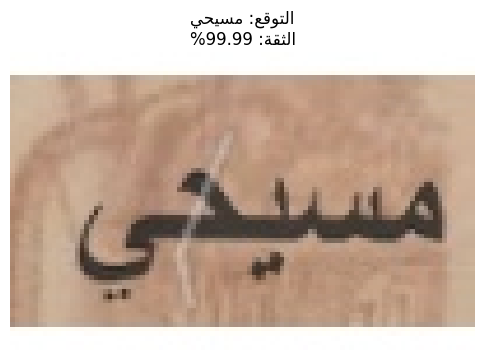

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_100_egypt_id_189_5.jpg


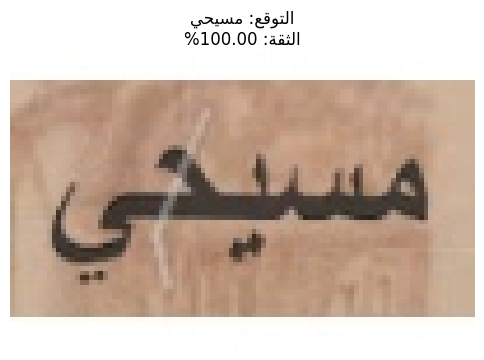

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_101_egypt_id_19_1.jpg


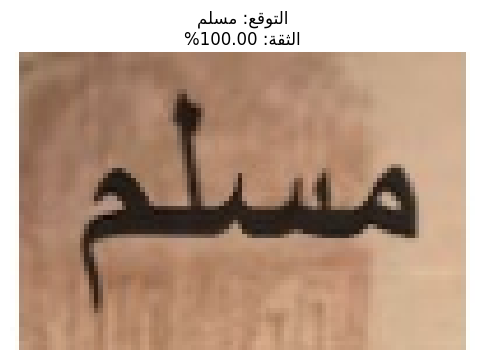

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_102_egypt_id_190_2.jpg


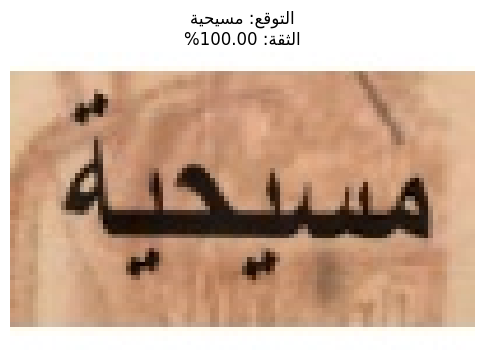

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (10).jpg


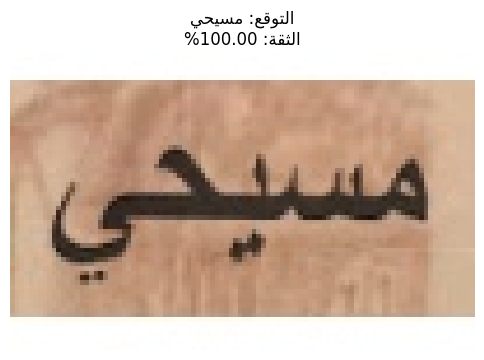

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (100).jpg


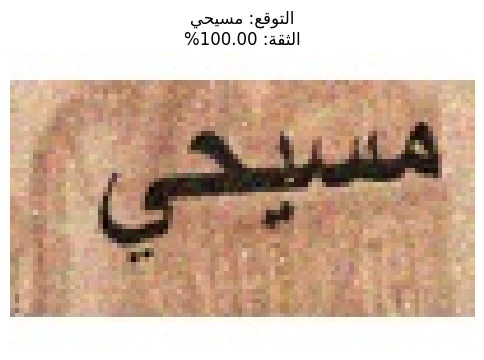

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (107).jpg


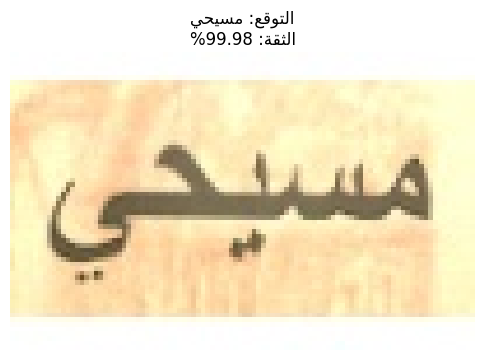

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (108).jpg


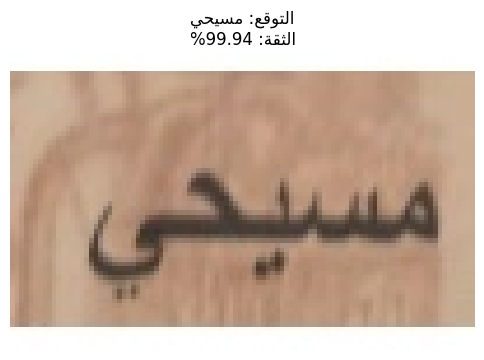

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (109).jpg


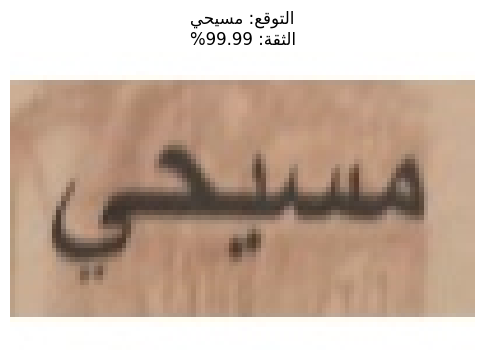

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (110).jpg


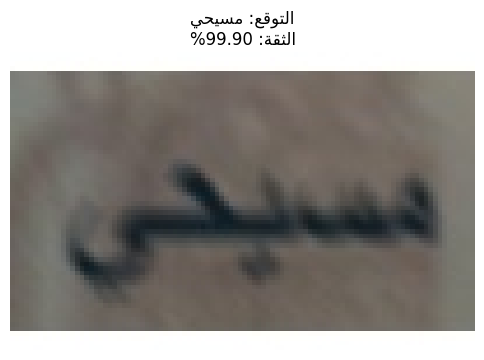

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (117).jpg


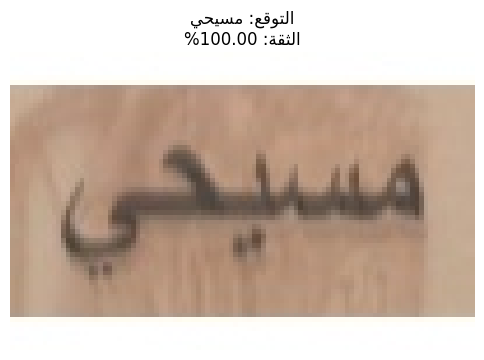

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (118).jpg


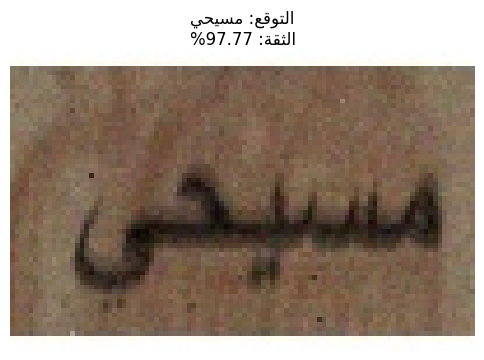

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (119).jpg


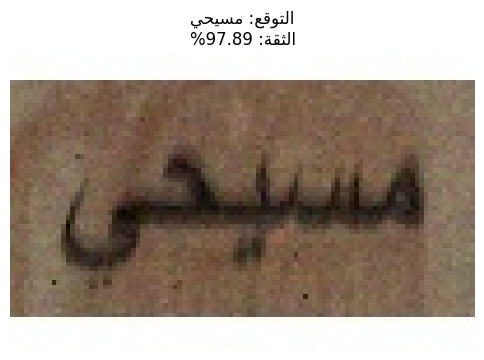

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (120).jpg


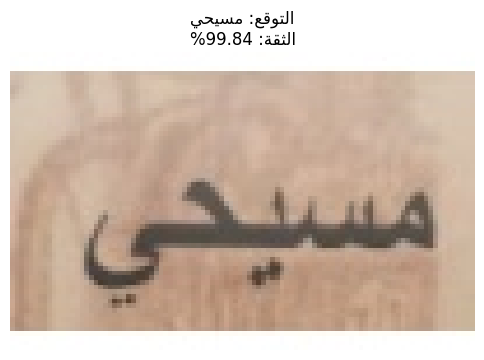

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (127).jpg


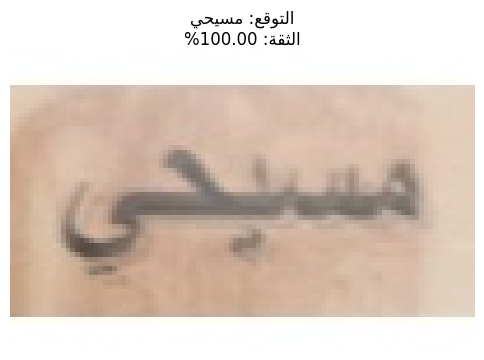

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (128).jpg


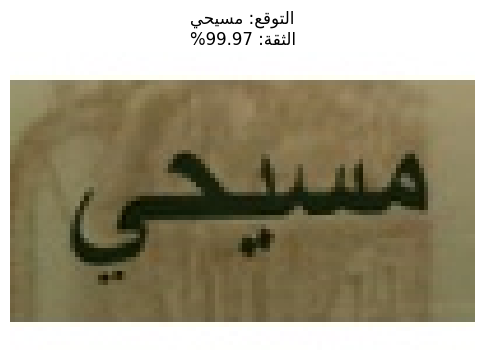

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (129).jpg


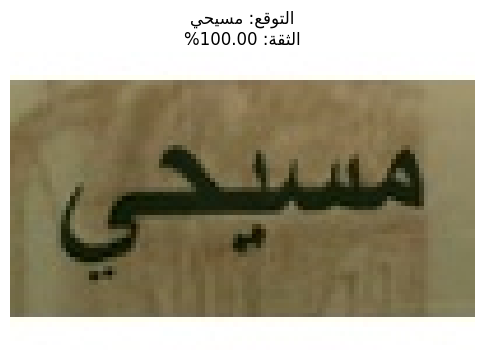

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (130).jpg


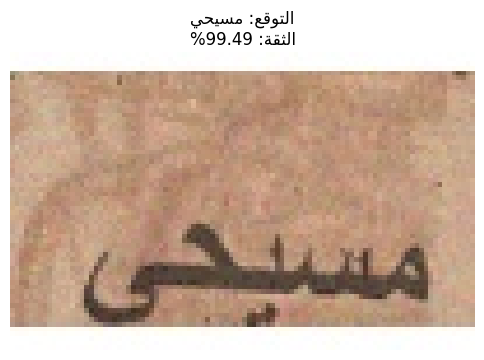

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (137).jpg


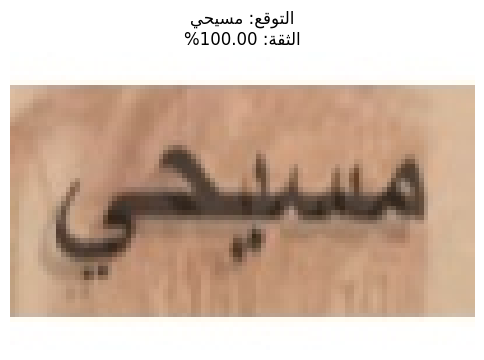

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (138).jpg


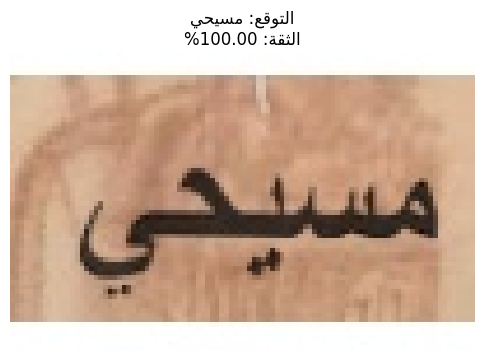

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (139).jpg


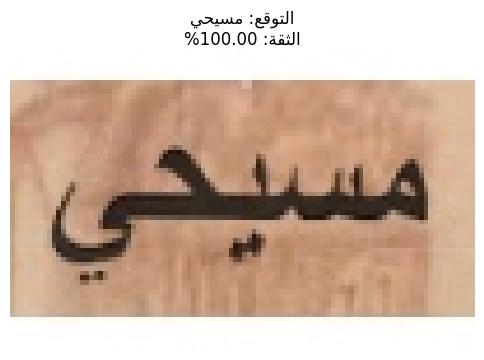

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (140).jpg


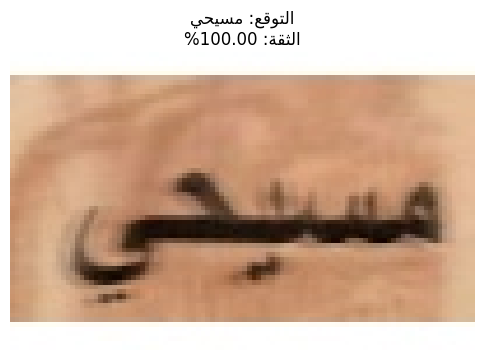

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (147).jpg


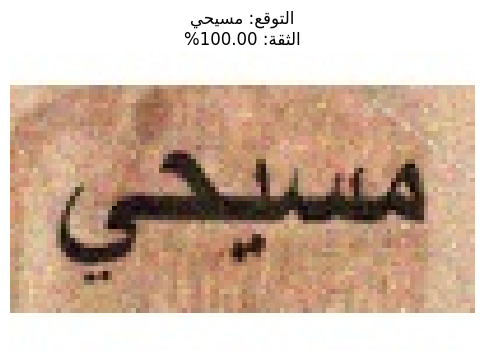

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (148).jpg


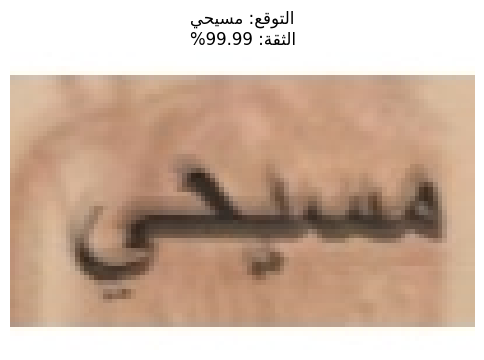

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (149).jpg


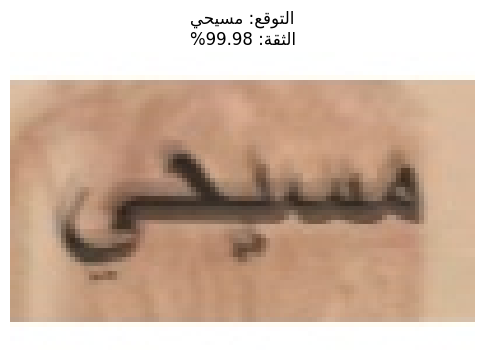

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (150).jpg


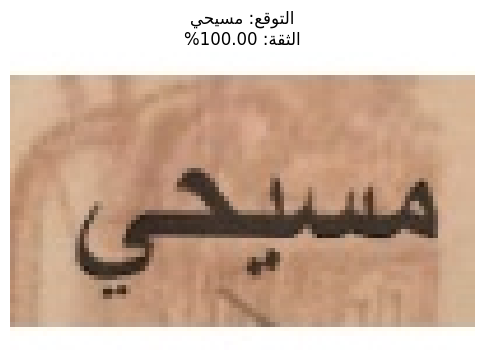

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (157).jpg


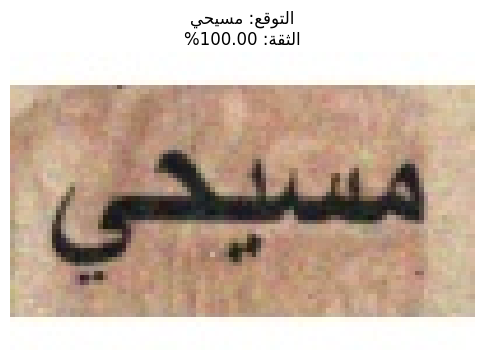

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (158).jpg


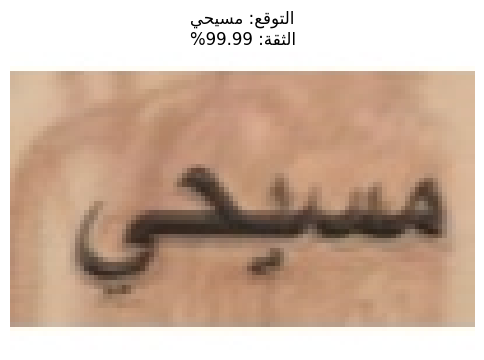

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (159).jpg


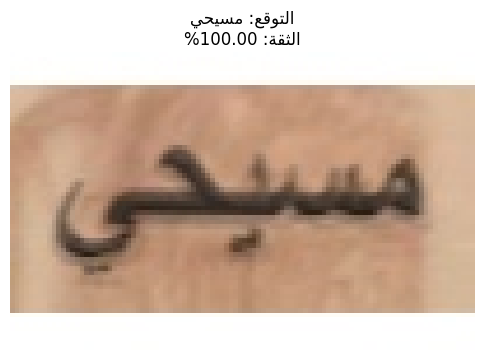

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (160).jpg


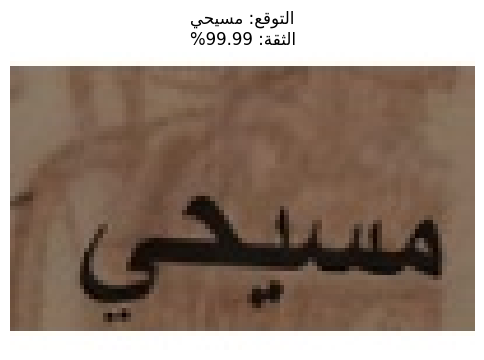

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (167).jpg


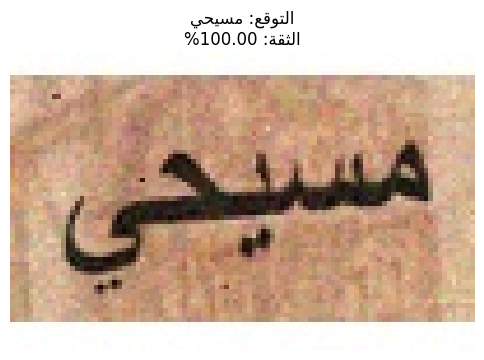

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (168).jpg


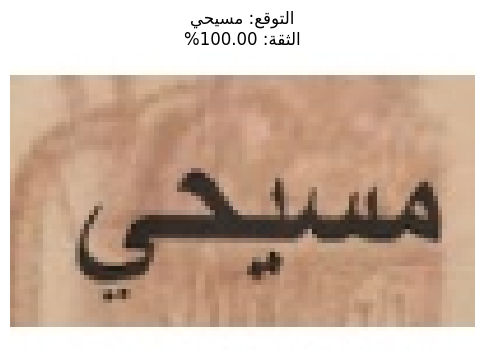

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (169).jpg


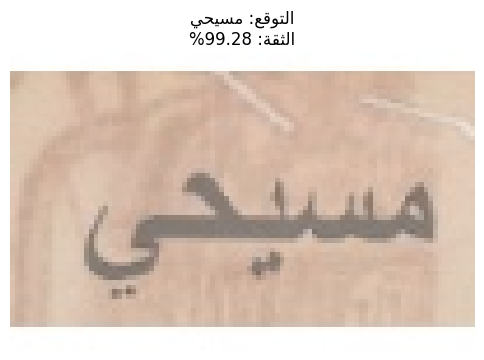

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (17).jpg


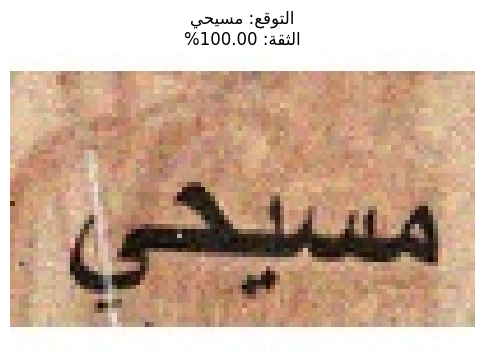

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (170).jpg


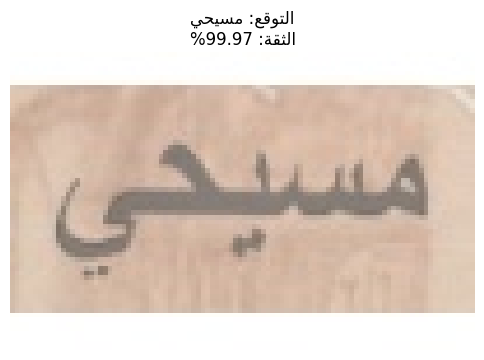

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (177).jpg


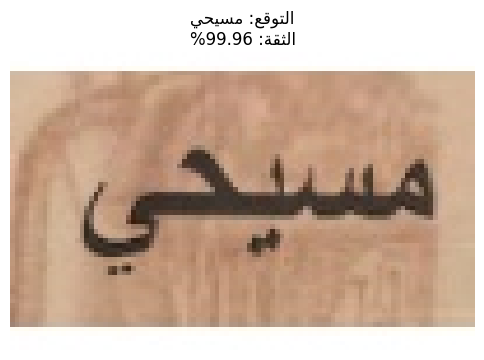

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (178).jpg


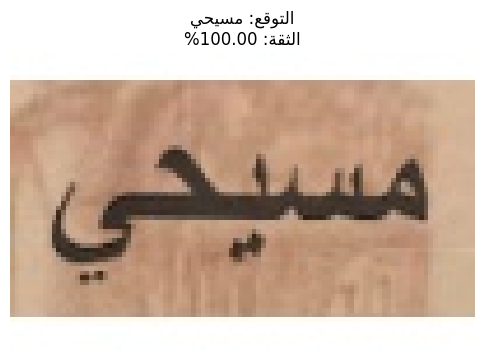

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (179).jpg


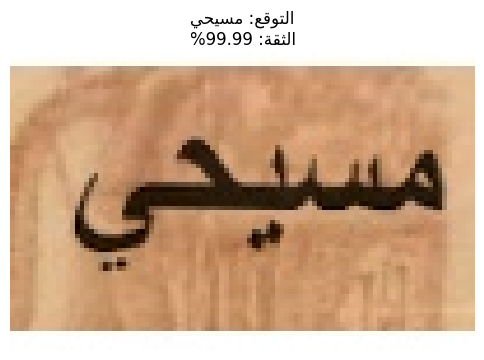

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (18).jpg


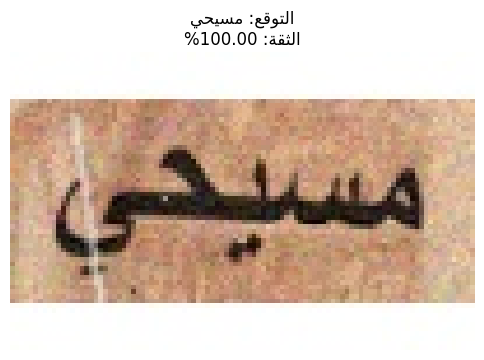

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (180).jpg


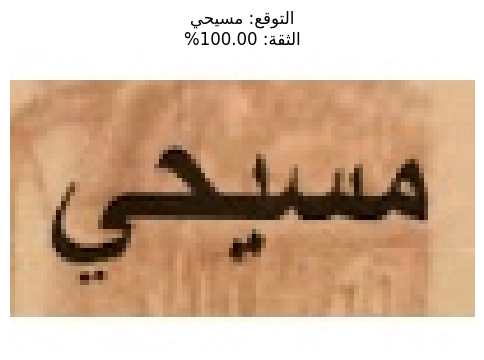

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (187).jpg


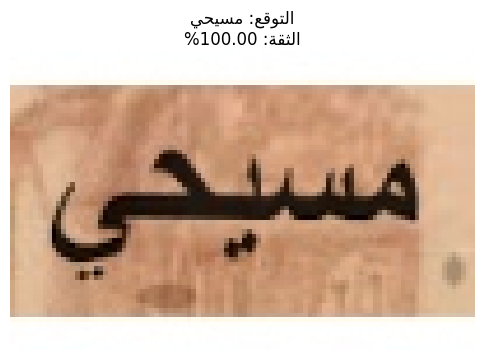

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (188).jpg


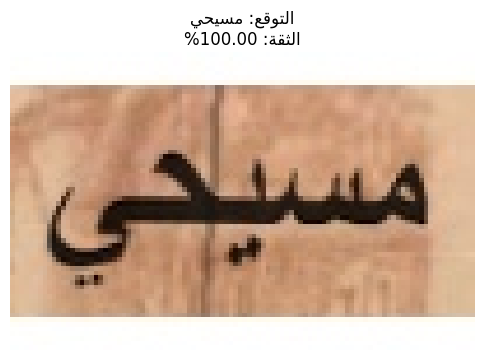

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (189).jpg


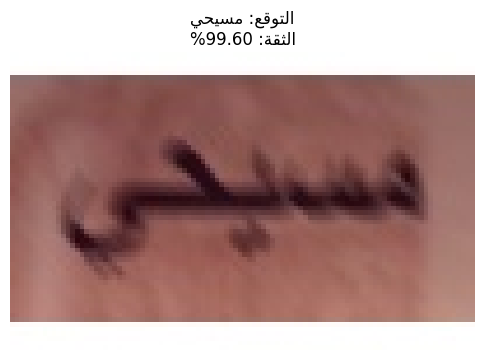

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (19).jpg


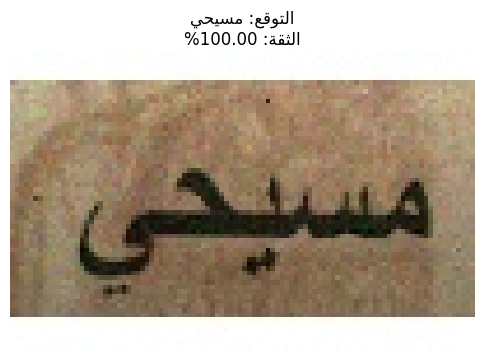

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (190).jpg


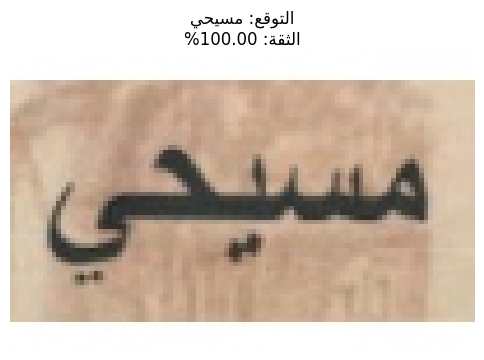

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (197).jpg


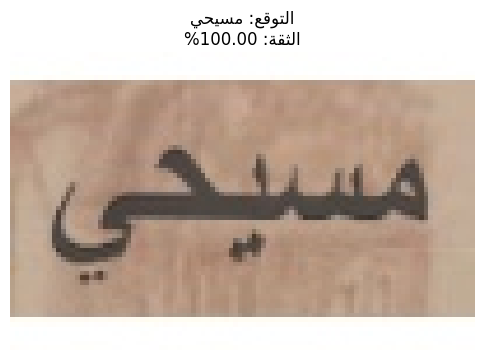

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (198).jpg


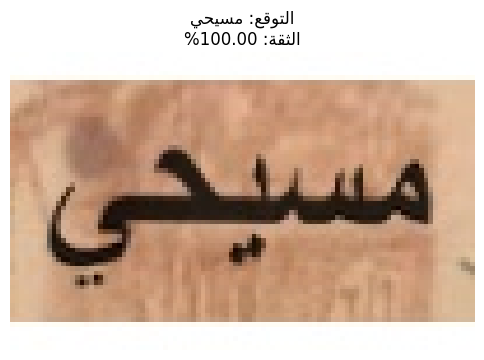

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (199).jpg


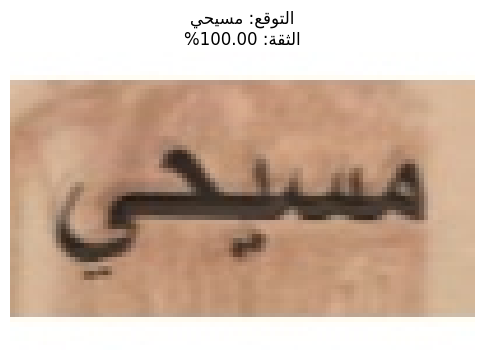

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (20).jpg


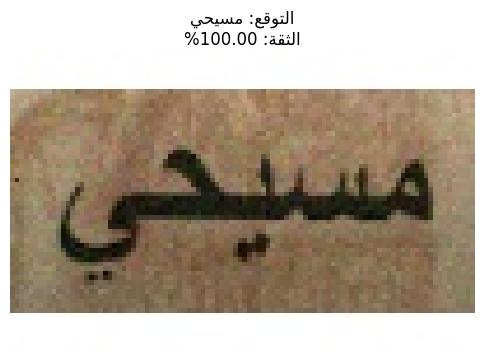

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (200).jpg


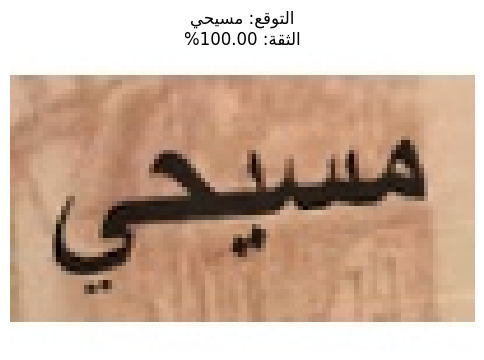

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (207).jpg


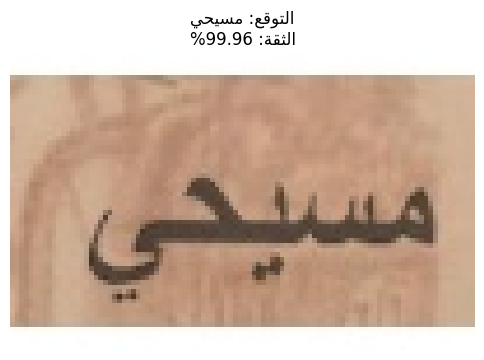

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (208).jpg


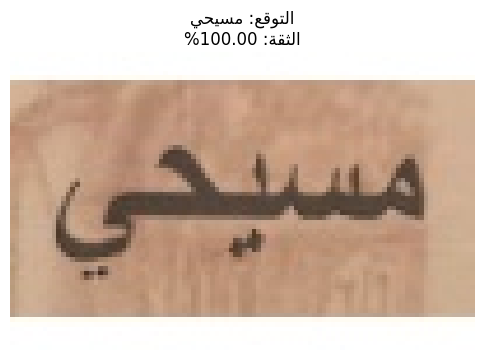

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (209).jpg


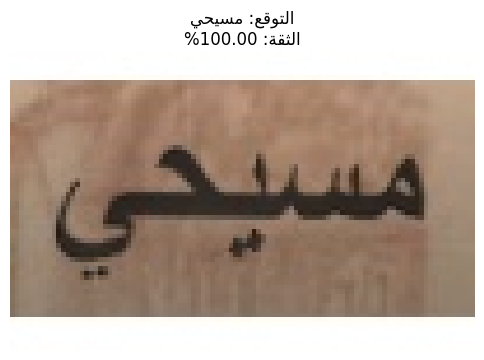

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (210).jpg


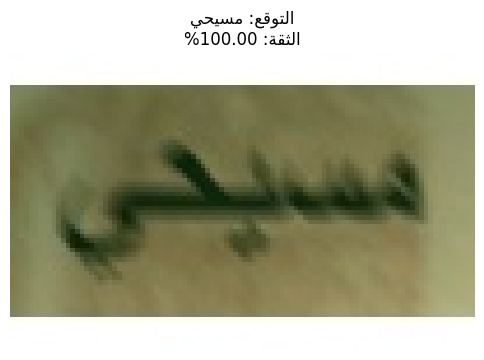

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (217).jpg


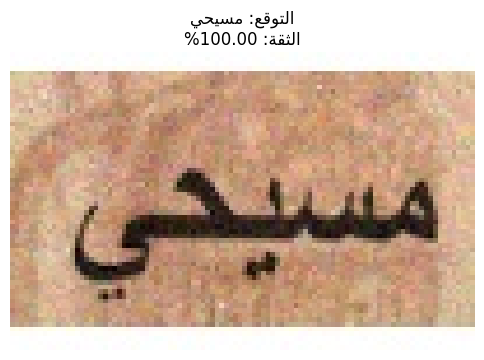

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (218).jpg


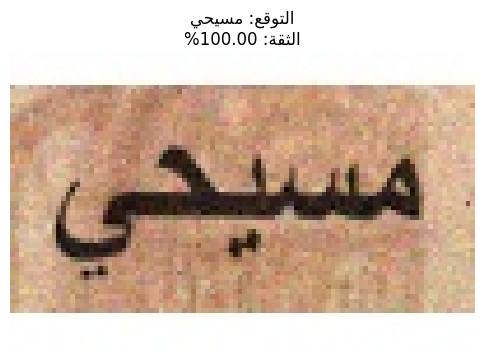

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (219).jpg


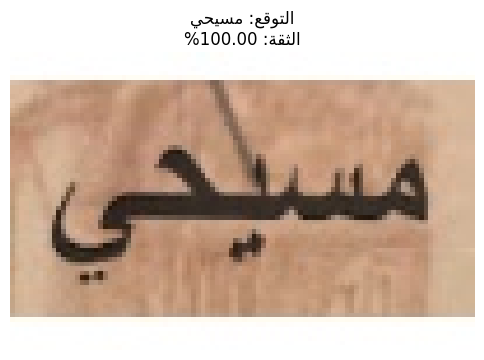

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (220).jpg


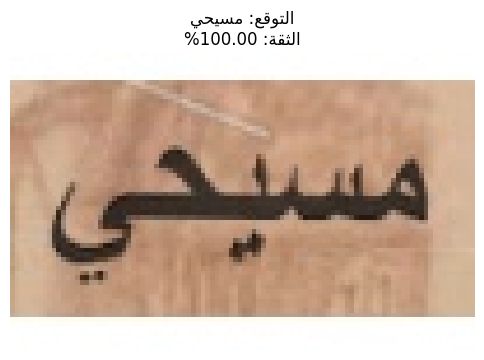

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (227).jpg


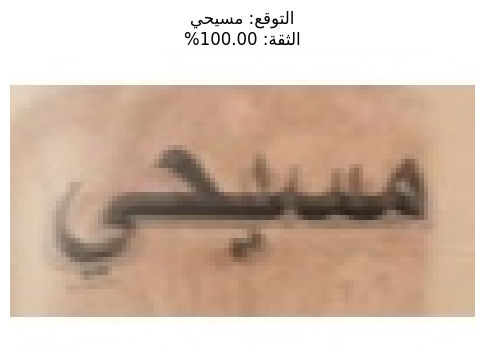

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (228).jpg


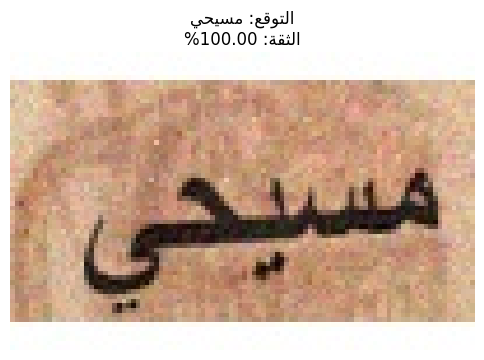

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (229).jpg


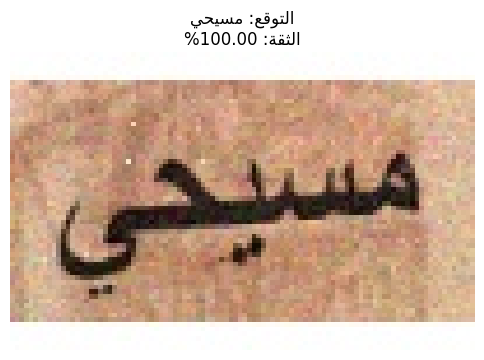

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (230).jpg


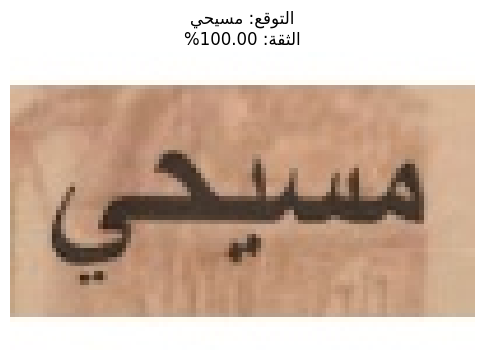

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (237).jpg


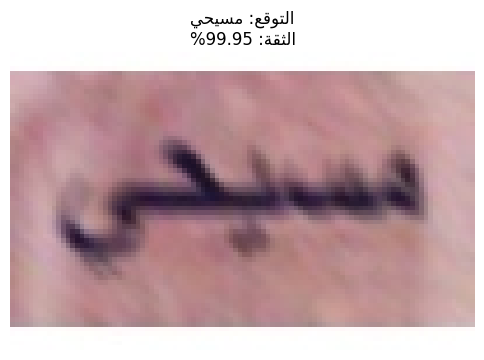

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (238).jpg


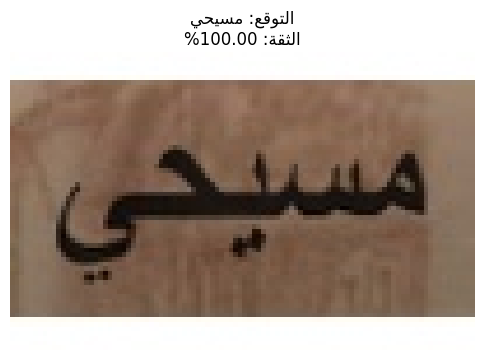

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (239).jpg


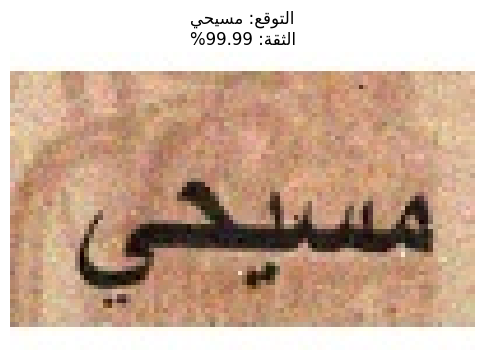

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (240).jpg


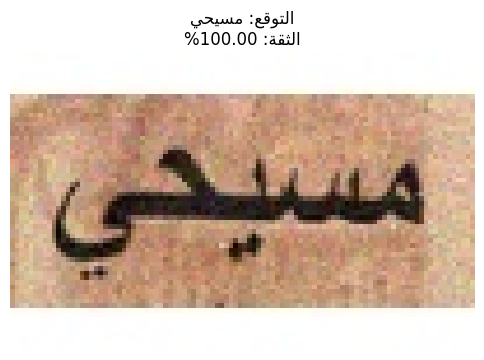

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (247).jpg


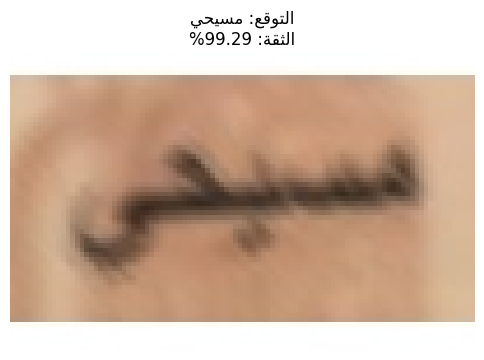

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (248).jpg


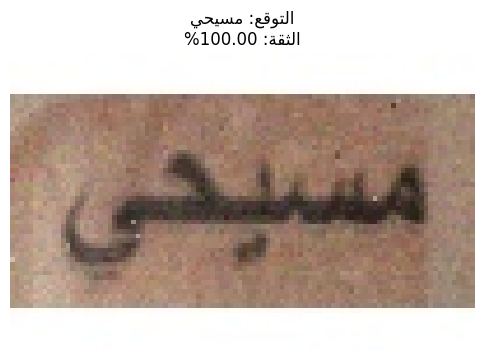

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (249).jpg


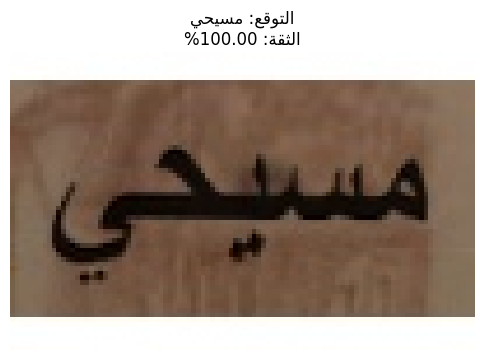

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (250).jpg


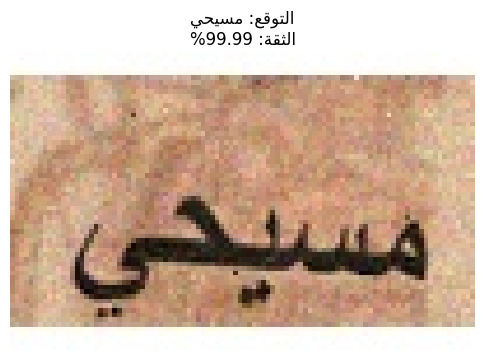

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (257).jpg


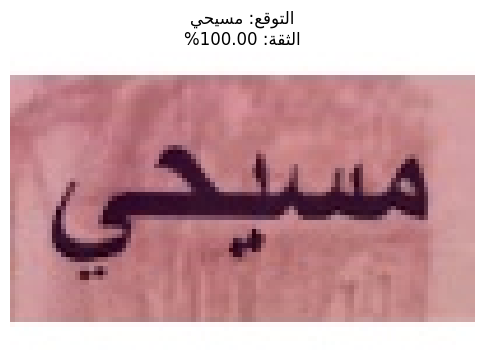

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (258).jpg


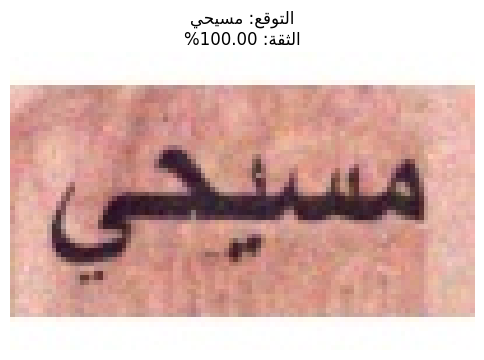

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (259).jpg


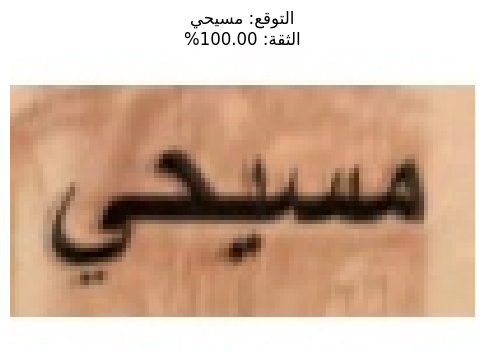

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (260).jpg


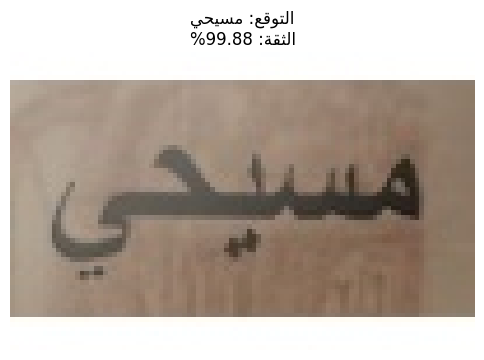

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (267).jpg


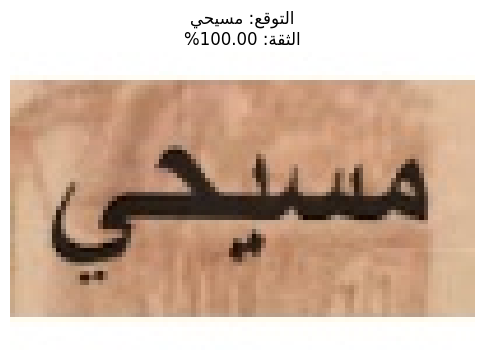

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (268).jpg


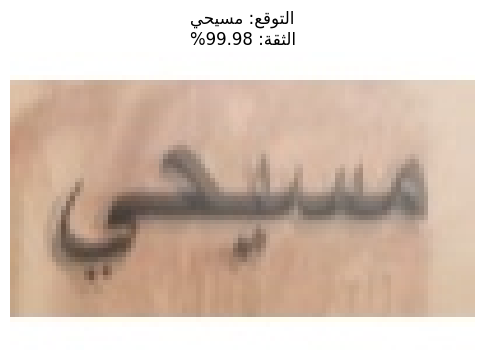

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (269).jpg


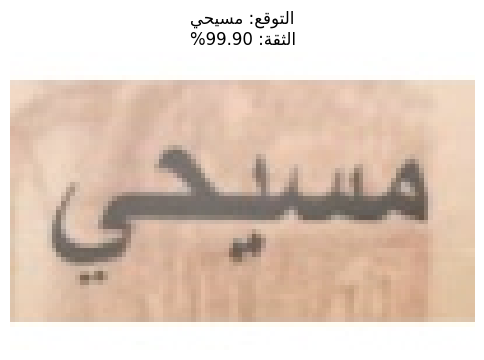

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (27).jpg


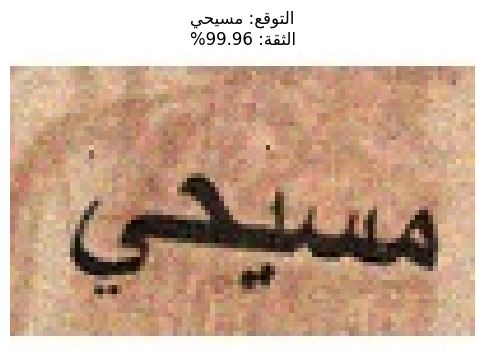

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (270).jpg


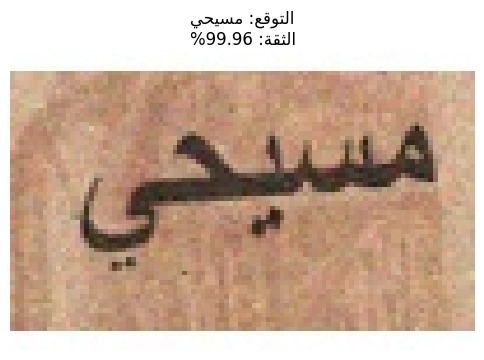

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (277).jpg


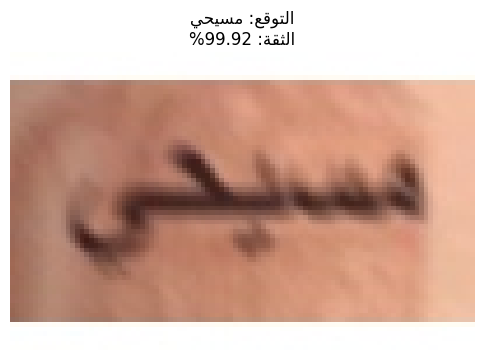

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (278).jpg


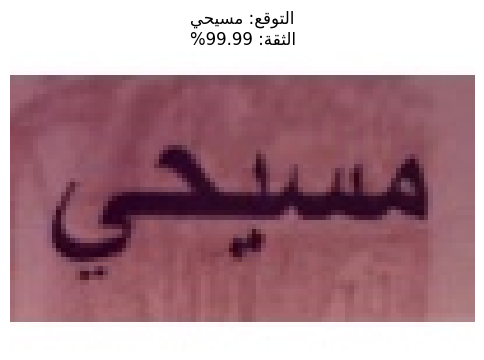

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (279).jpg


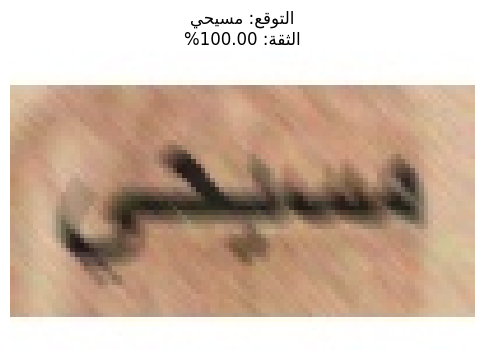

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (28).jpg


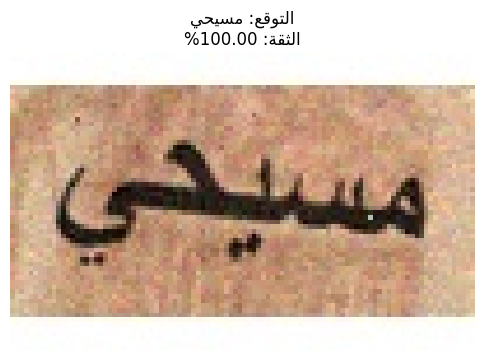

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (280).jpg


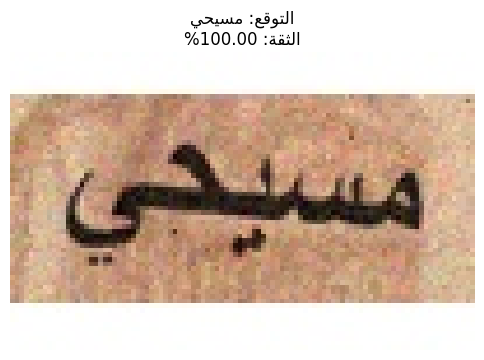

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (287).jpg


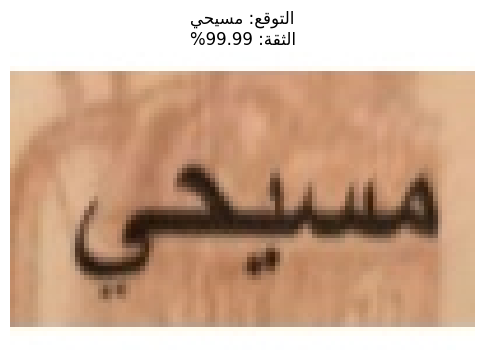

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (288).jpg


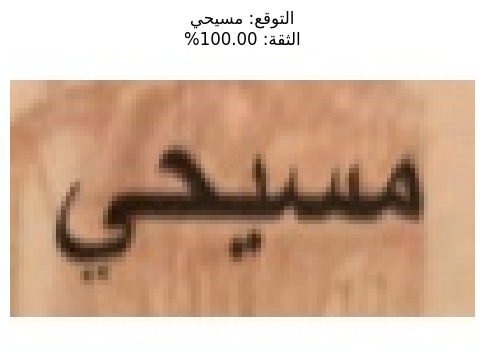

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (289).jpg


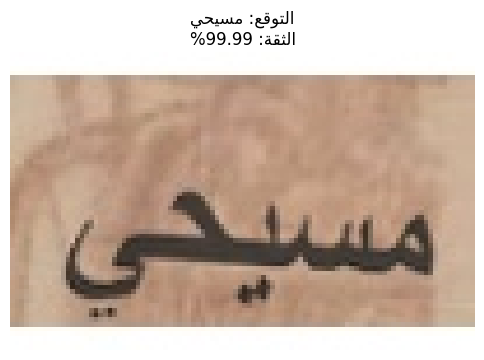

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (29).jpg


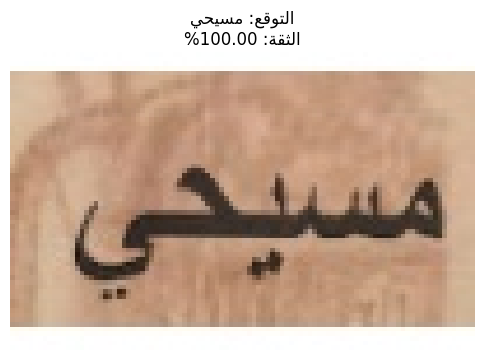

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (290).jpg


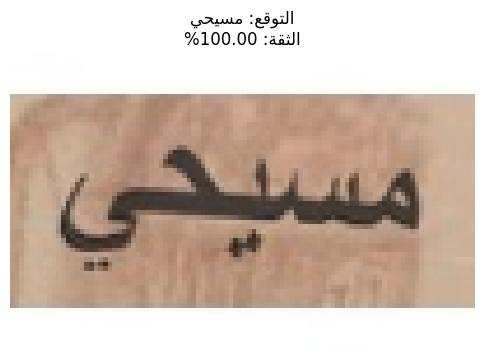

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (297).jpg


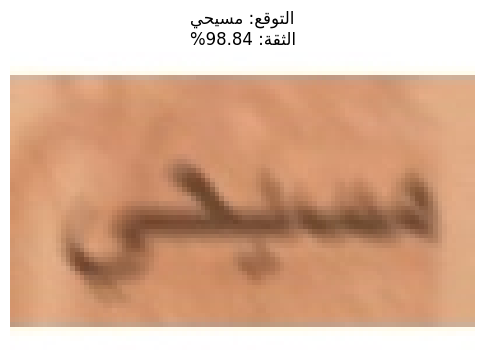

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (298).jpg


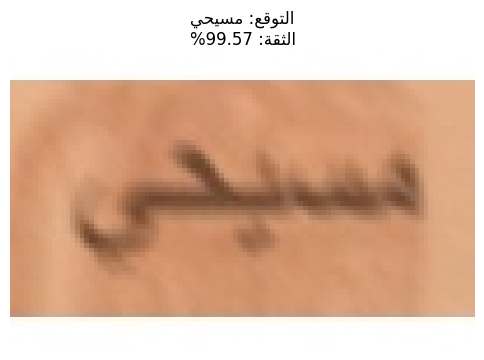

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (299).jpg


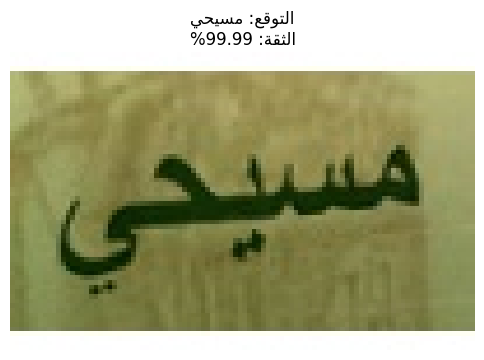

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (30).jpg


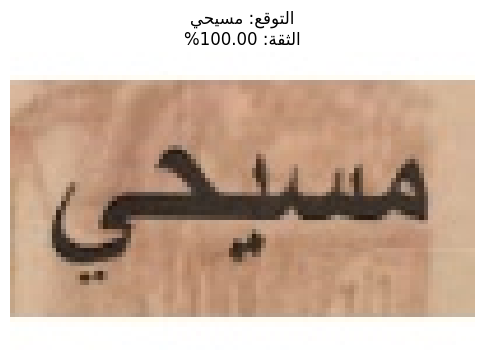

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (300).jpg


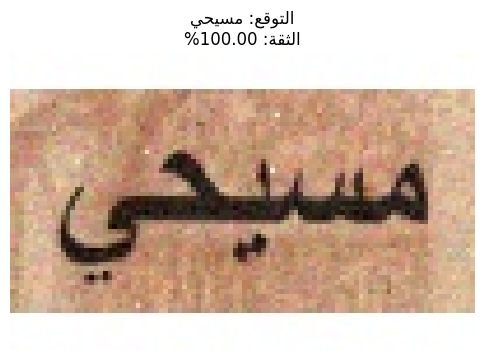

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (303).jpg


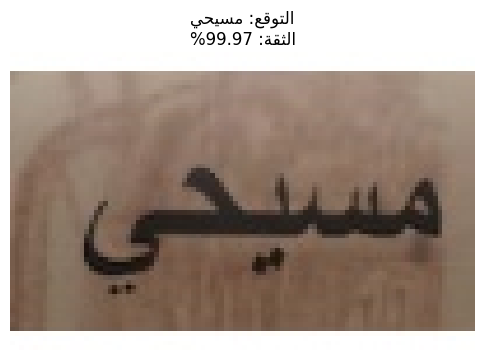

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (304).jpg


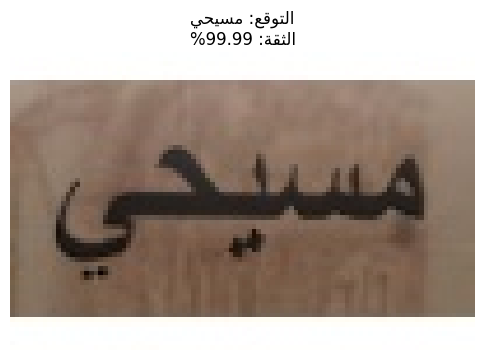

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (37).jpg


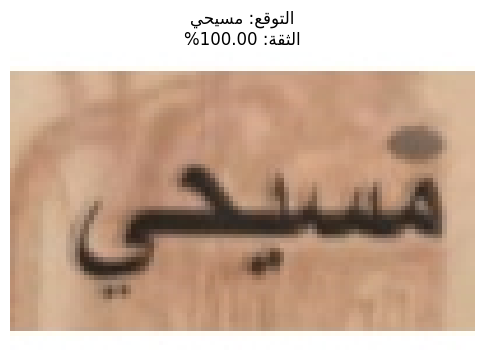

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (38).jpg


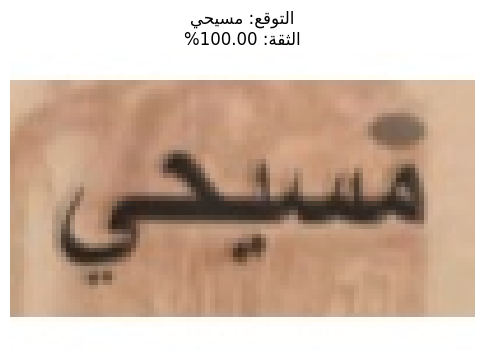

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (39).jpg


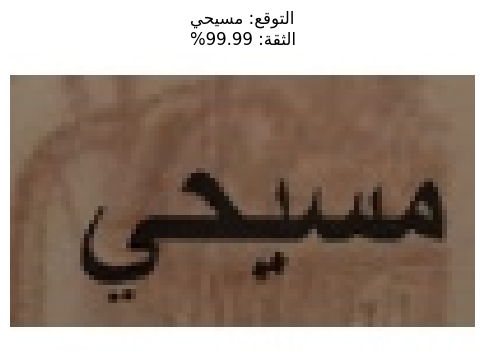

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (40).jpg


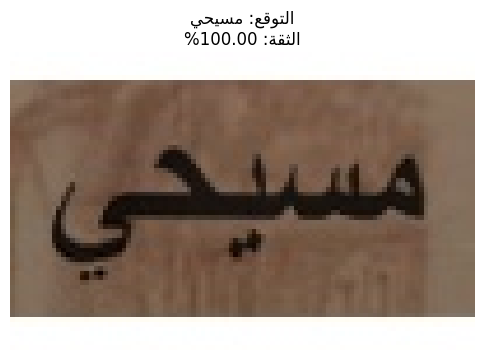

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (47).jpg


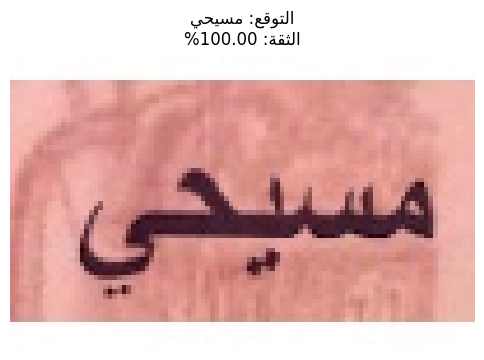

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (48).jpg


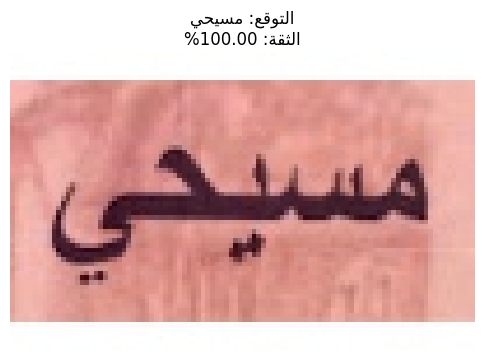

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (49).jpg


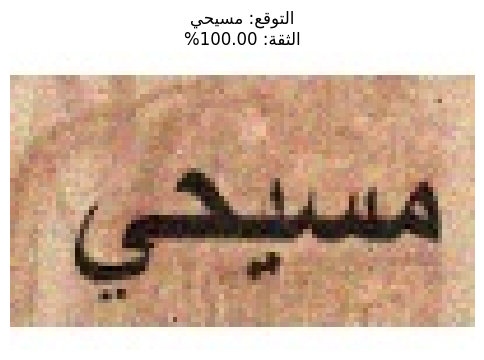

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (5).jpg


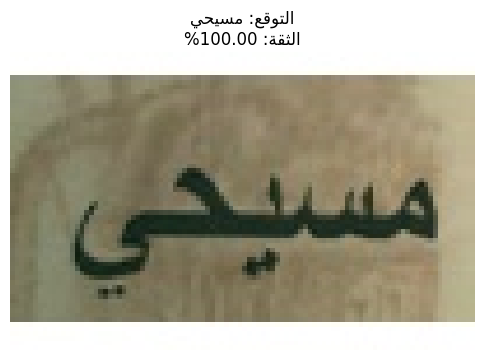

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (50).jpg


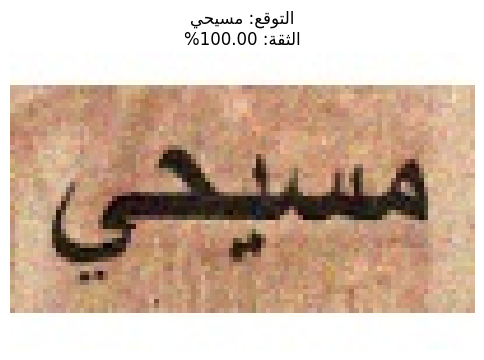

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (57).jpg


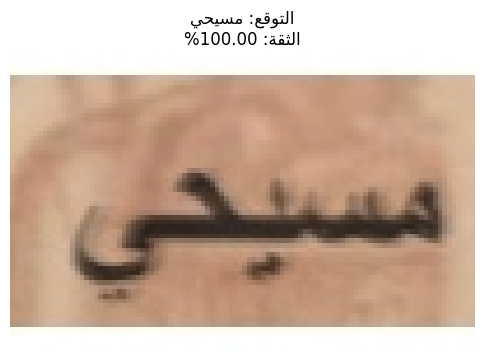

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (58).jpg


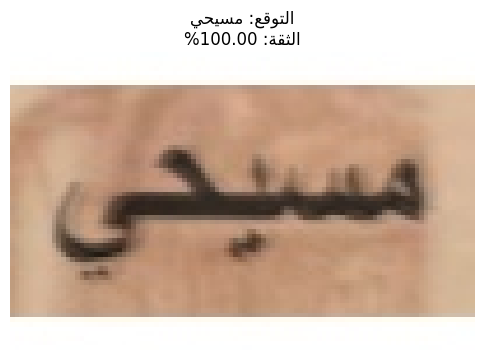

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (59).jpg


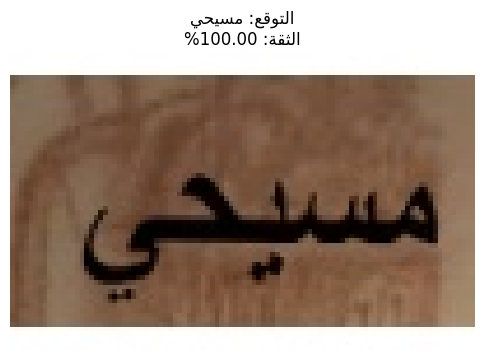

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (6).jpg


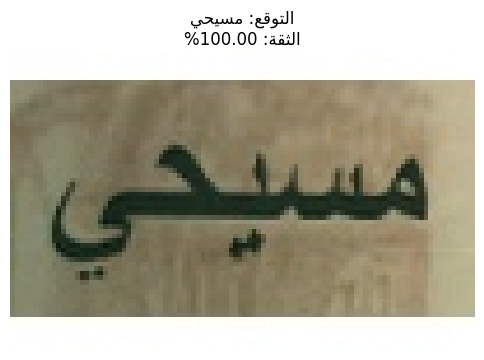

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (60).jpg


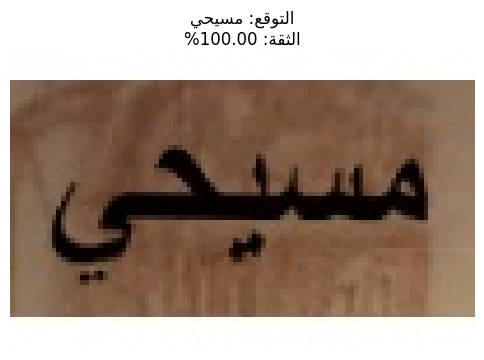

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (67).jpg


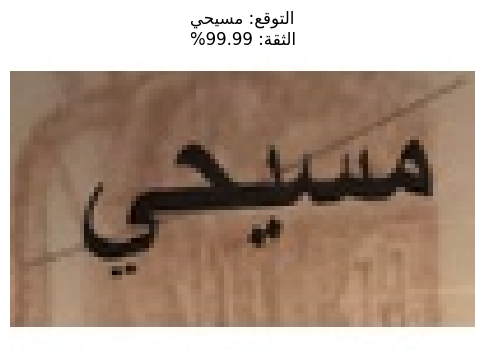

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (68).jpg


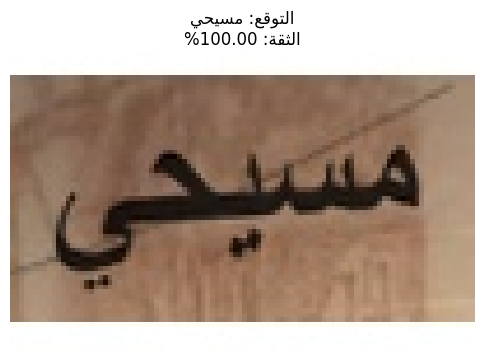

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (69).jpg


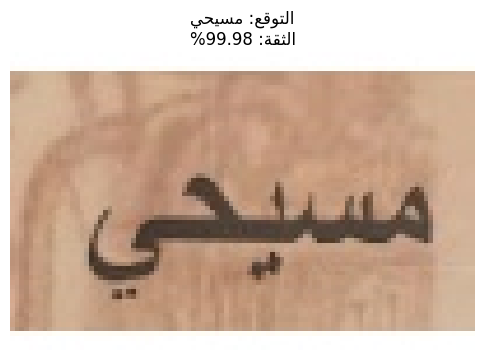

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (7).jpg


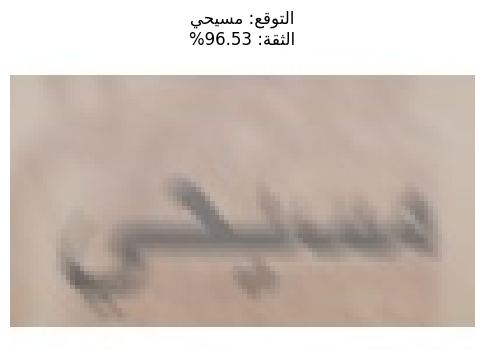

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (70).jpg


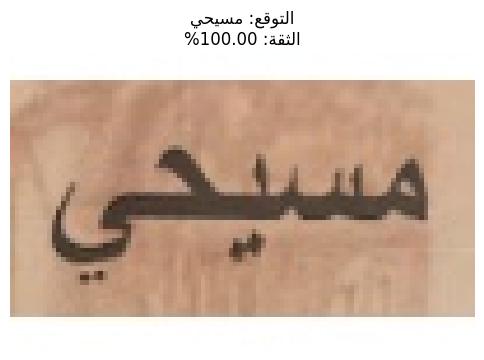

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (77).jpg


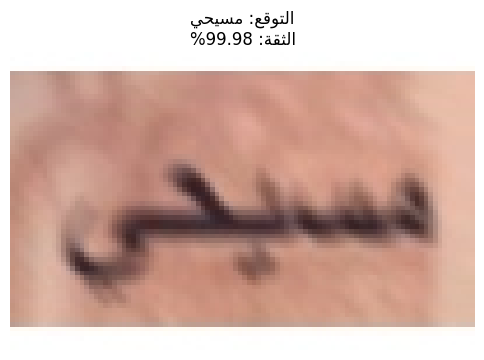

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (78).jpg


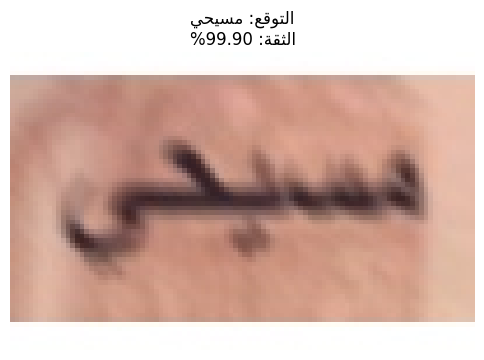

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (79).jpg


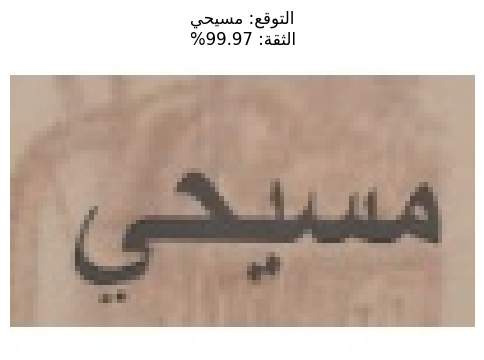

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (8).jpg


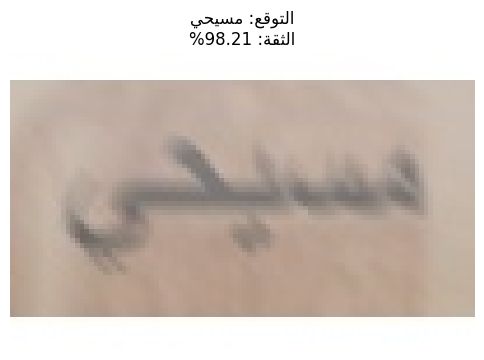

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (80).jpg


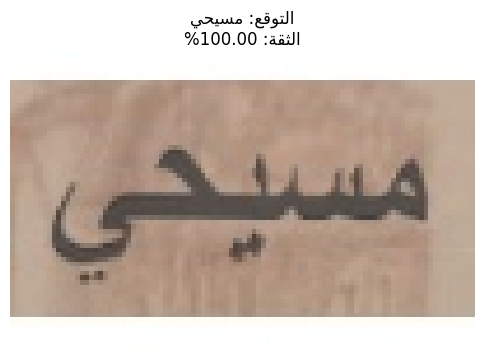

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (87).jpg


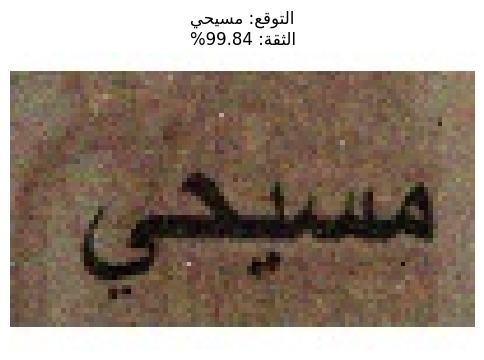

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (88).jpg


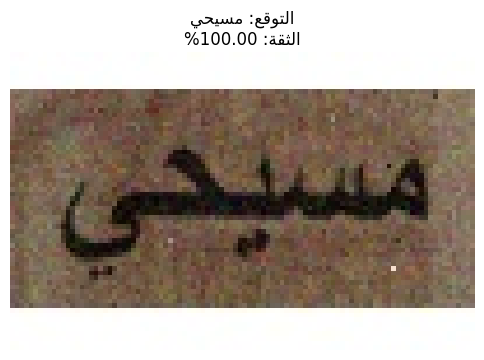

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (89).jpg


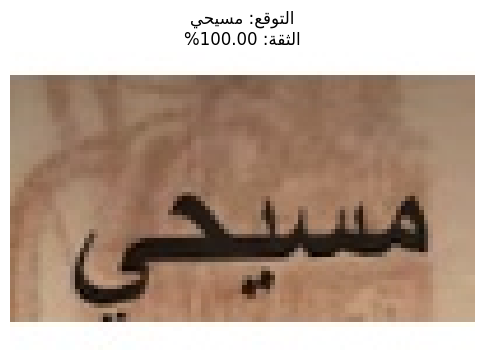

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (9).jpg


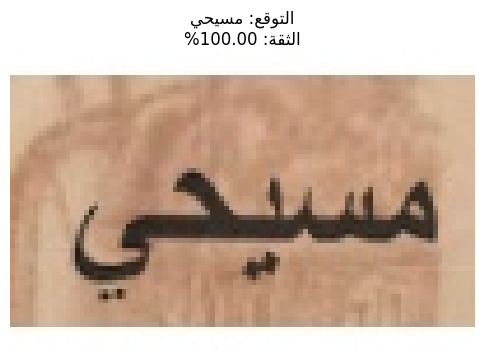

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (90).jpg


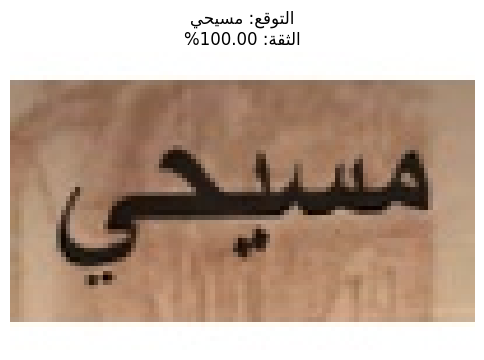

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (97).jpg


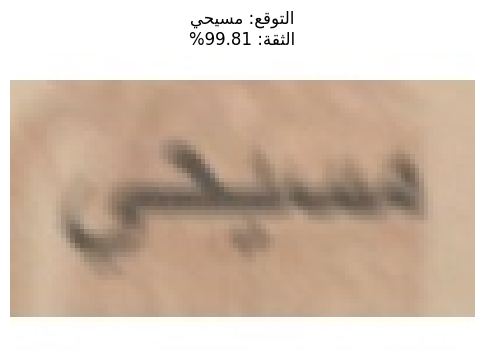

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (98).jpg


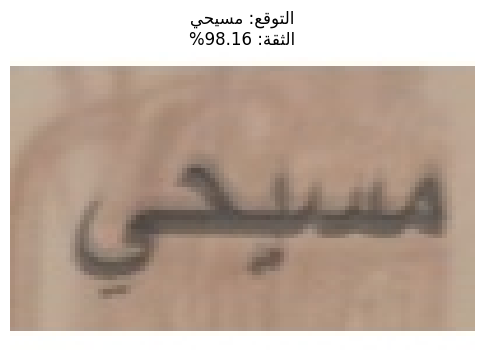

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_105_egypt_id_193_1لاكخيس (99).jpg


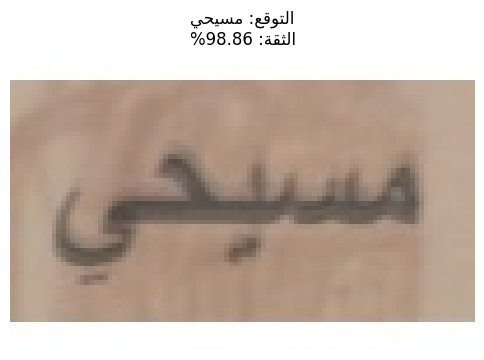

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_108_egypt_id_196_2.jpg


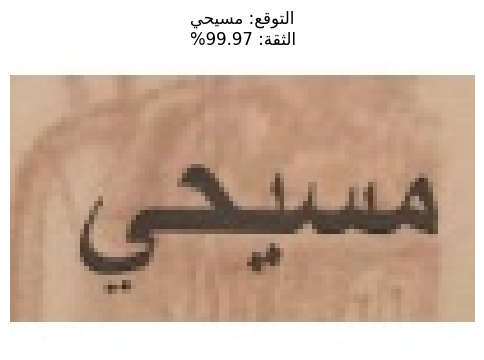

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_108_egypt_id_196_5.jpg


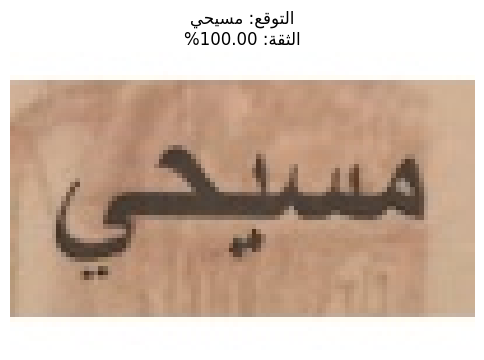

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_113_egypt_id_20_1.jpg


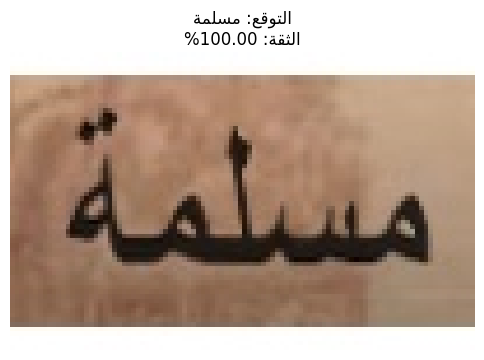

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_115_egypt_id_201_2.jpg


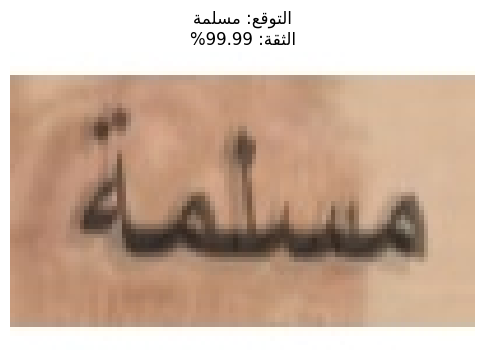

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_116_egypt_id_202_1.jpg


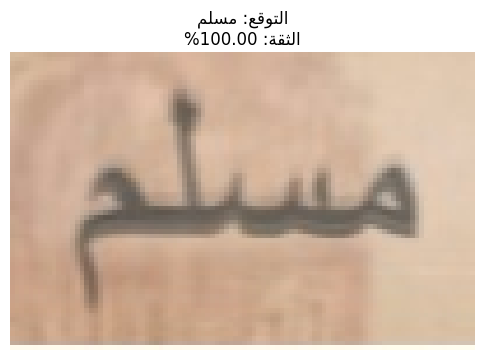

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_123_egypt_id_209_1.jpg


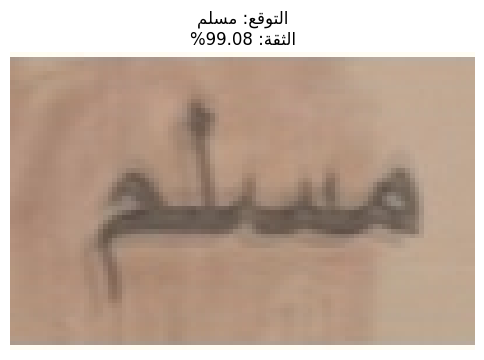

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_124_egypt_id_21_1.jpg


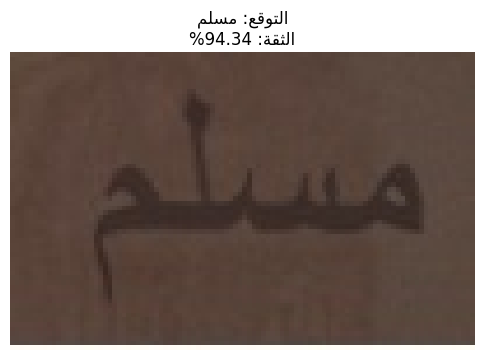

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_125_egypt_id_210_1.jpg


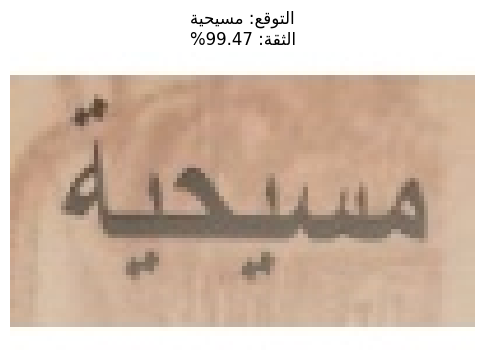

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_126_egypt_id_211_1.jpg


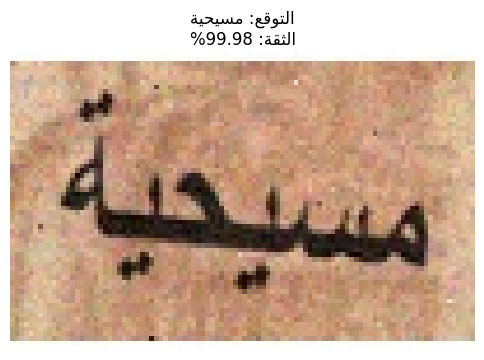

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_128_egypt_id_213_1.jpg


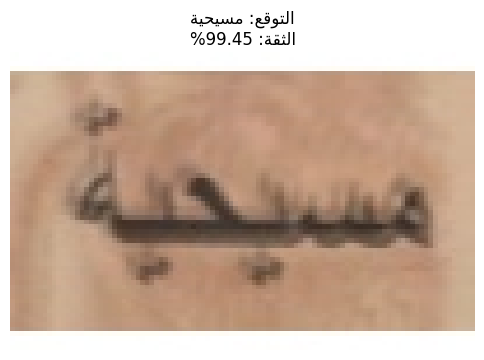

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (105).jpg


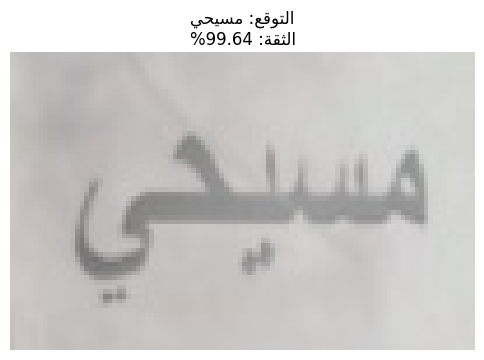

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (106).jpg


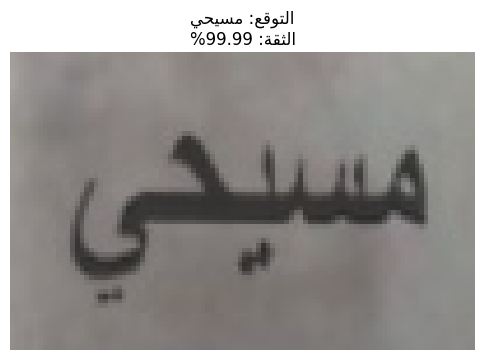

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (107).jpg


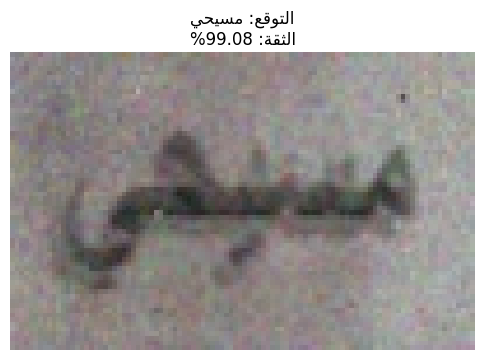

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (108).jpg


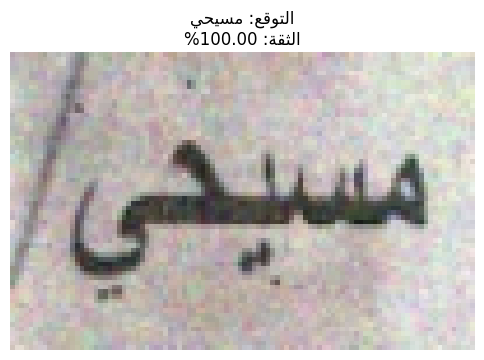

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (109).jpg


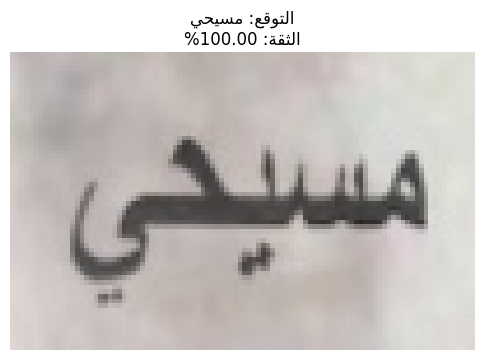

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (116).jpg


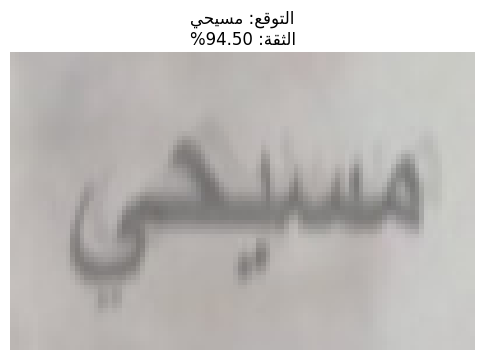

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (117).jpg


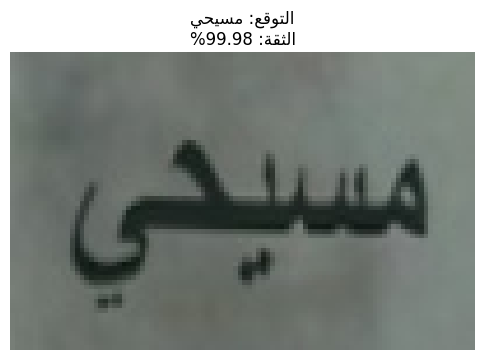

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (23).jpg


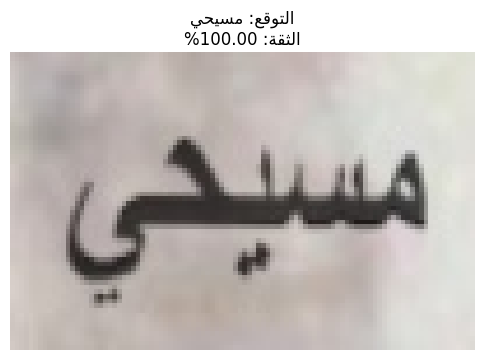

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (24).jpg


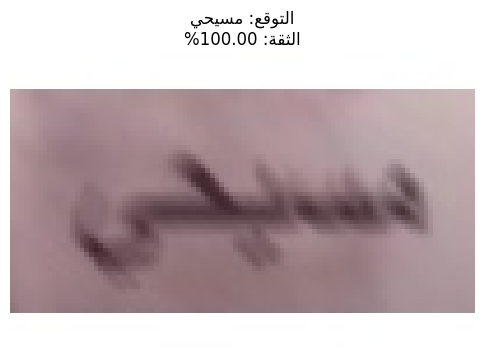

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (25).jpg


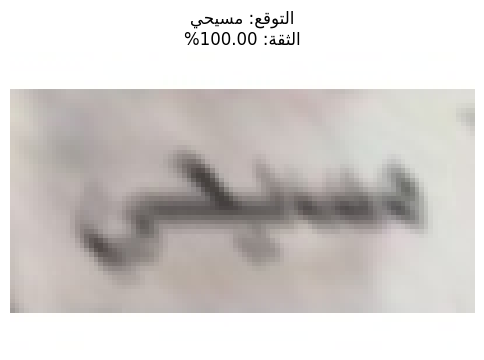

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (26).jpg


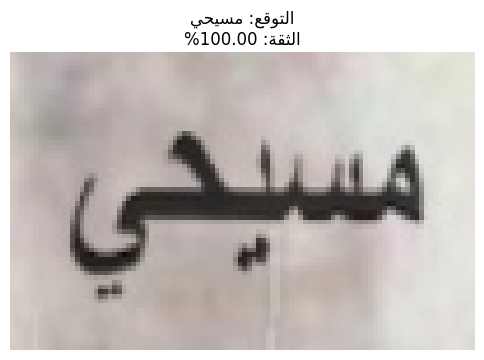

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (34).jpg


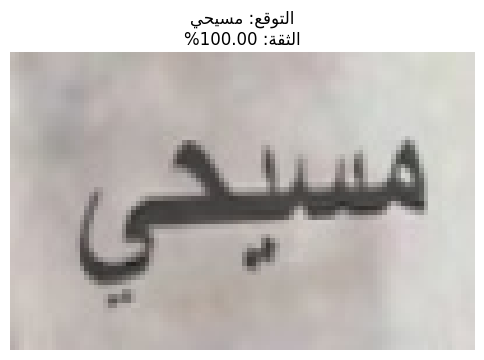

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (35).jpg


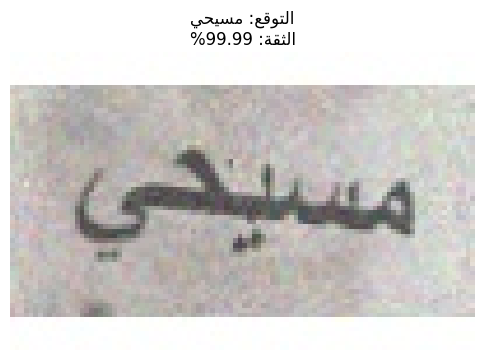

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (36).jpg


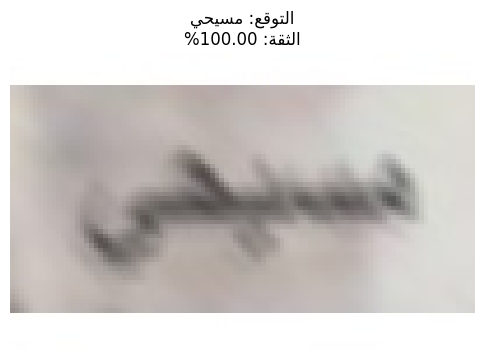

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (37).jpg


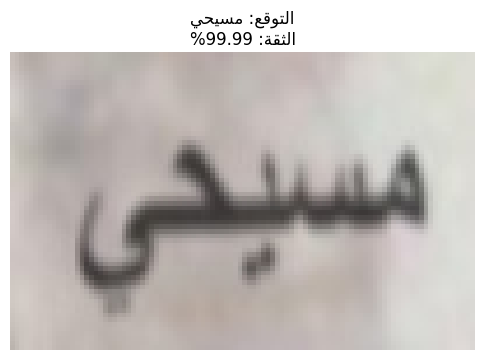

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (44).jpg


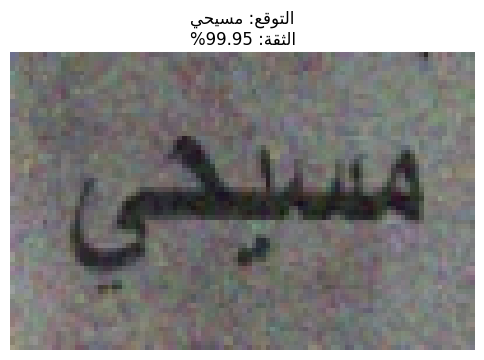

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (45).jpg


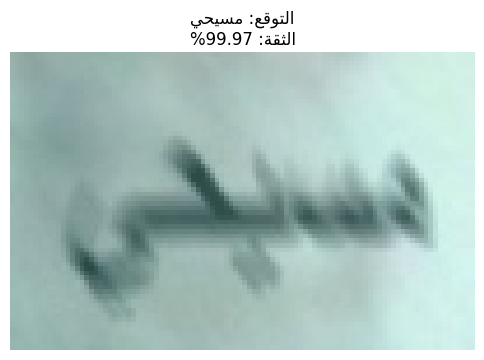

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (46).jpg


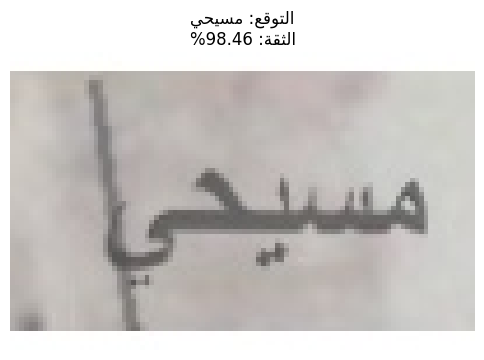

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (47).jpg


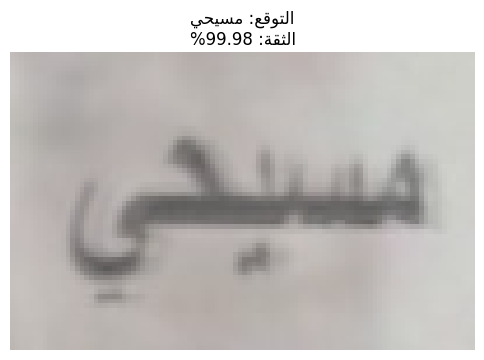

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (56).jpg


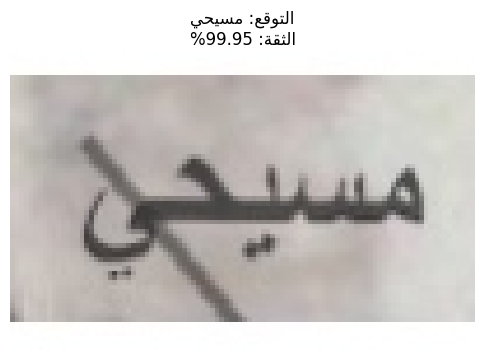

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (57).jpg


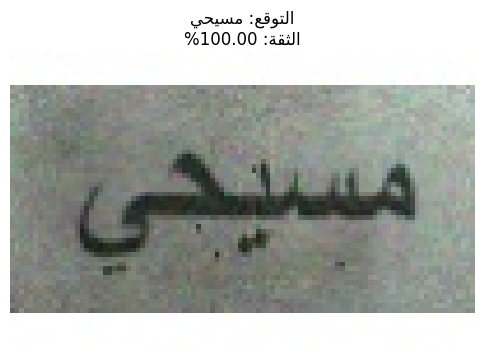

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (58).jpg


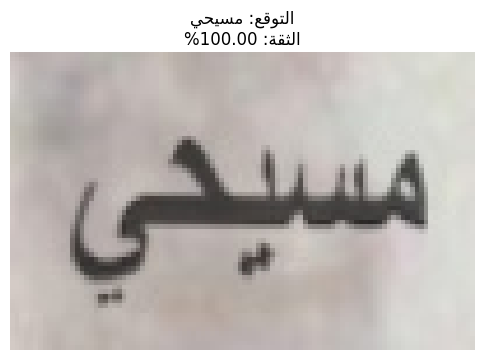

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (59).jpg


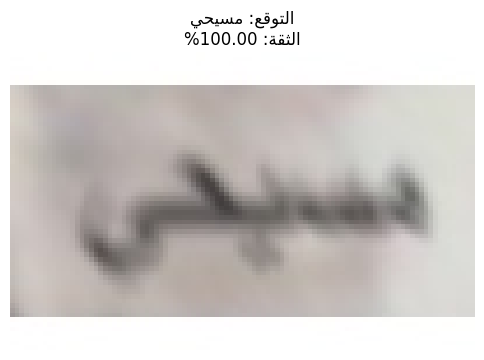

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (60).jpg


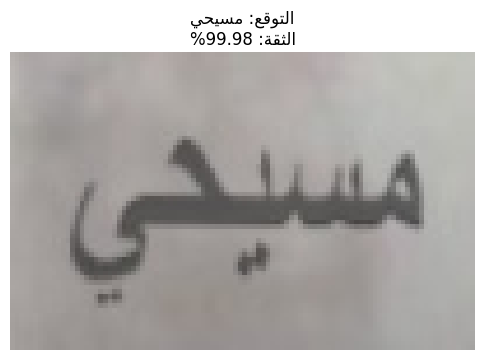

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (61).jpg


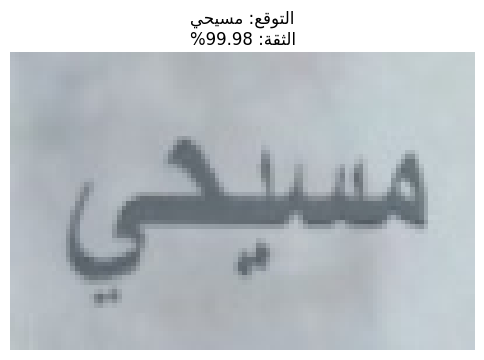

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (62).jpg


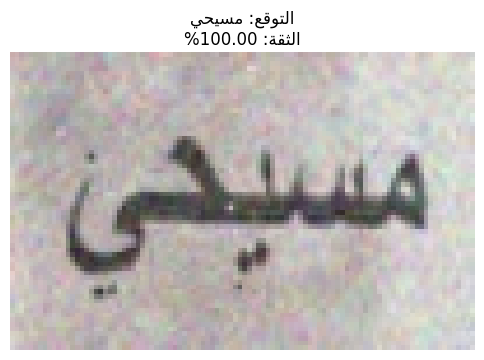

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (63).jpg


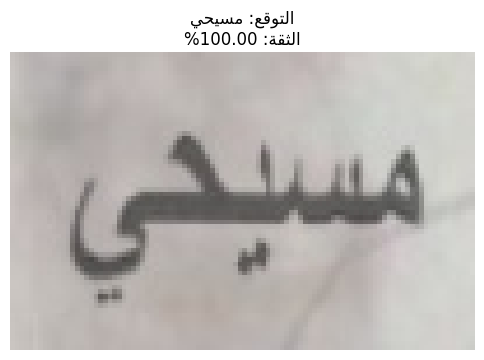

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (71).jpg


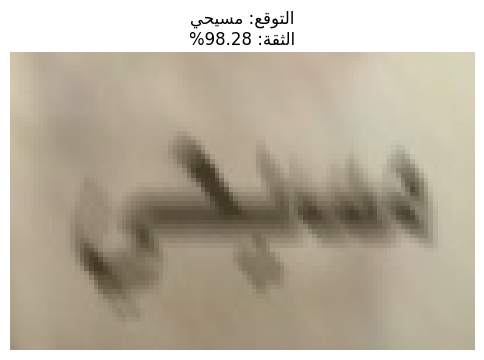

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (72).jpg


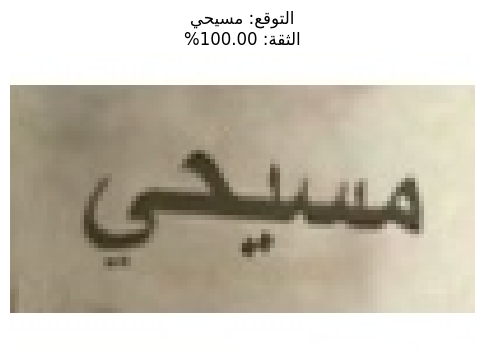

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (73).jpg


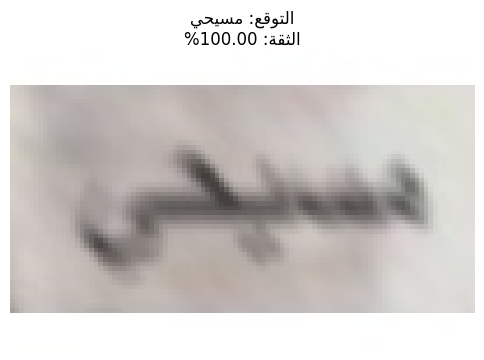

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (74).jpg


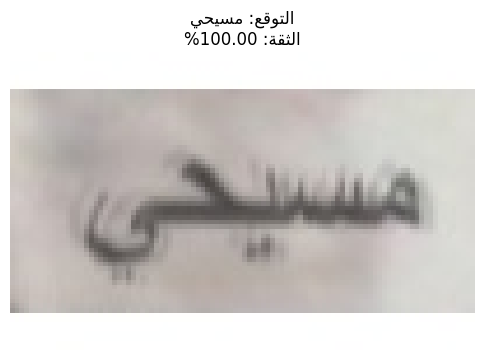

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (76).jpg


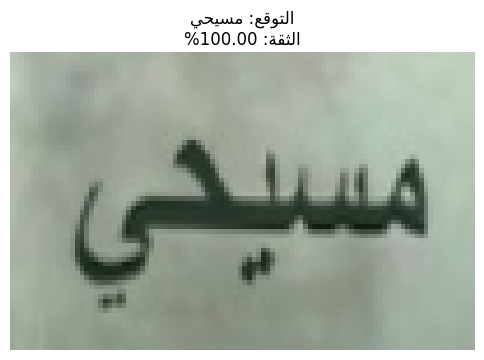

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (77).jpg


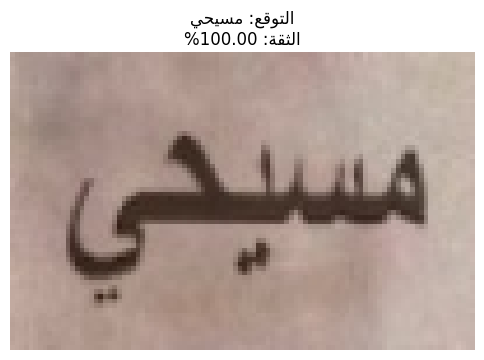

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (78).jpg


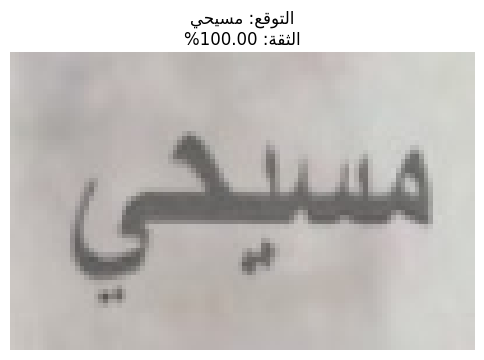

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (79).jpg


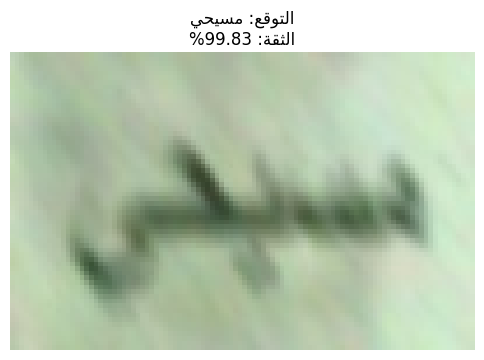

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (83).jpg


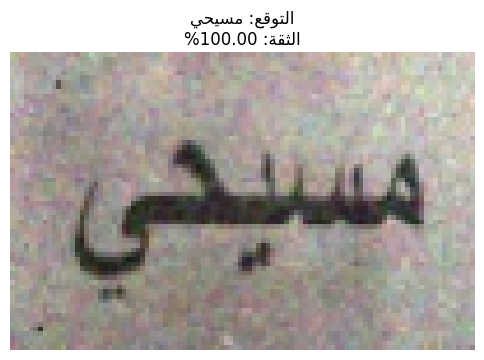

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (84).jpg


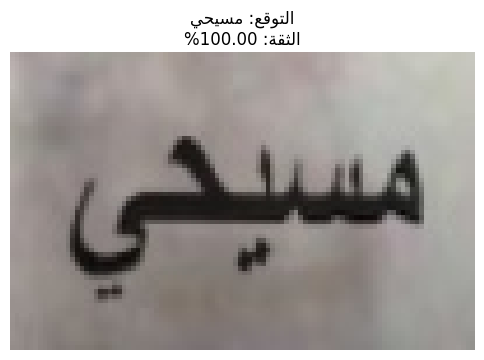

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (85).jpg


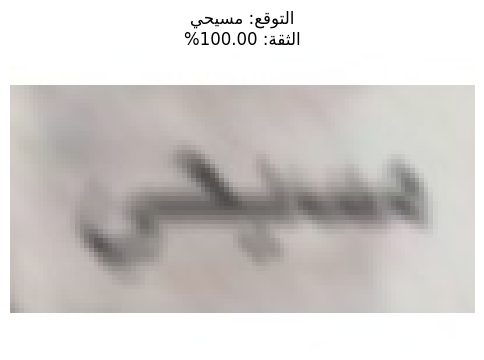

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (86).jpg


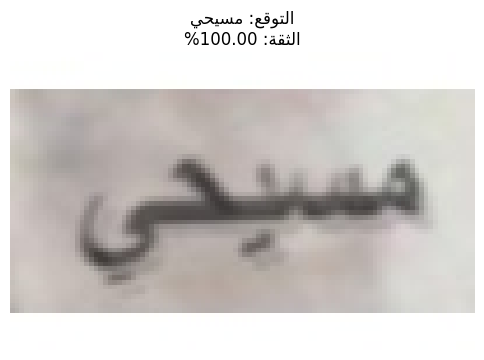

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (94).jpg


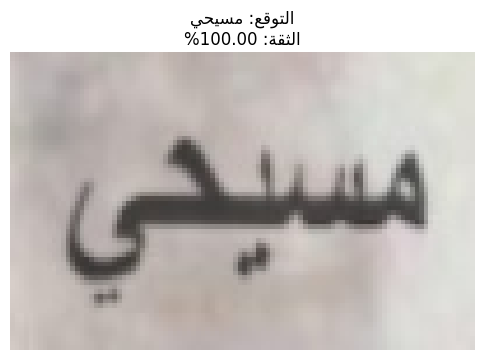

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (95).jpg


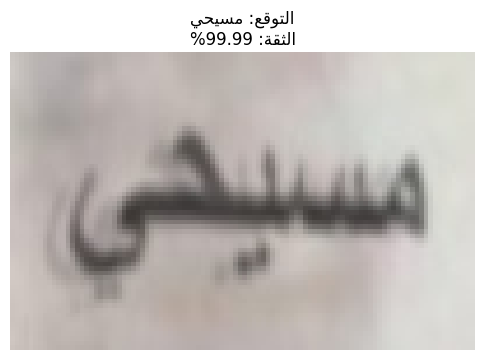

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (96).jpg


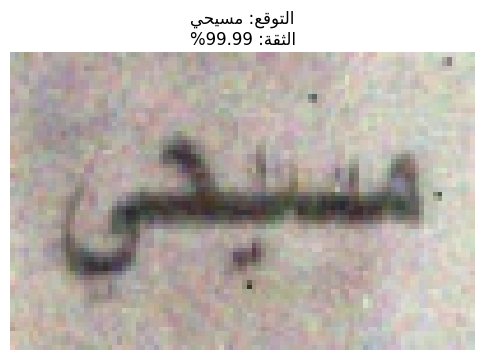

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_1ئثقخ (97).jpg


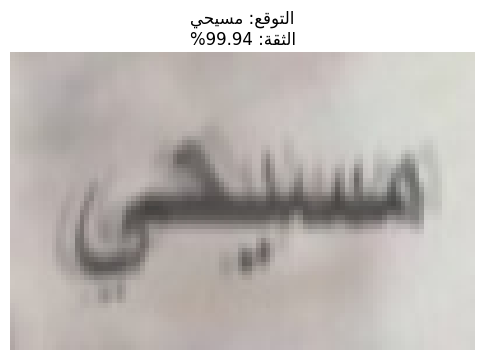

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_129_egypt_id_214_2.jpg


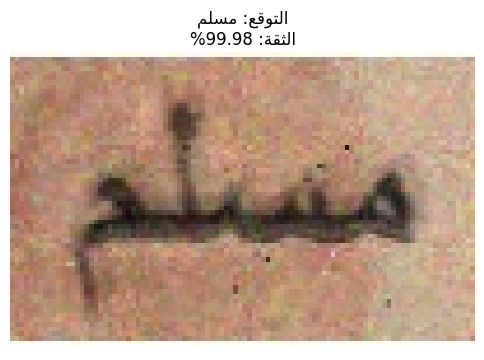

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_130_egypt_id_215_1.jpg


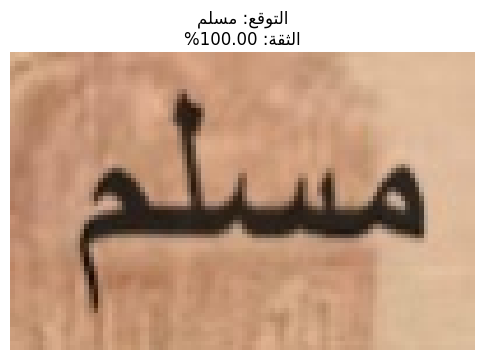

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_134_egypt_id_219_1.jpg


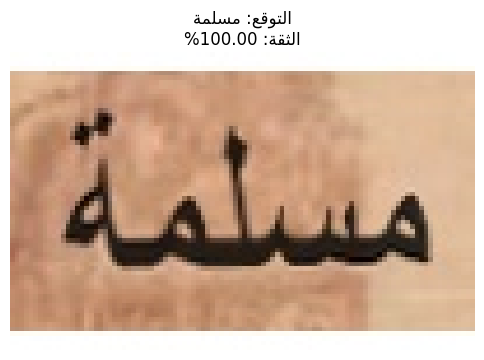

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_134_egypt_id_219_2.jpg


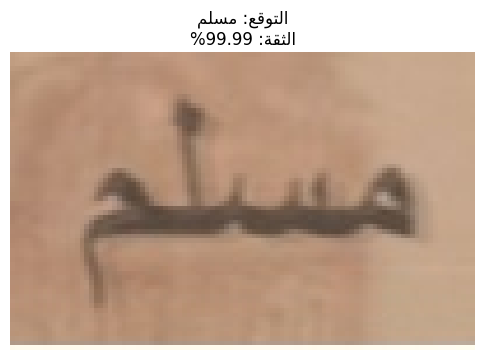

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_135_egypt_id_22_1.jpg


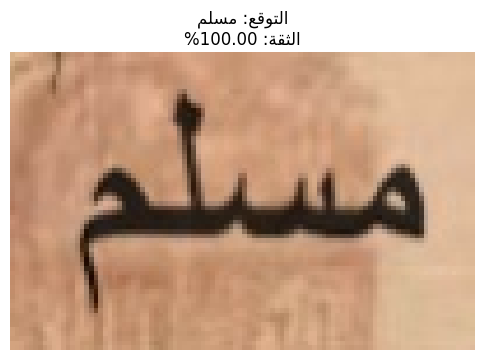

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_136_egypt_id_220_2.jpg


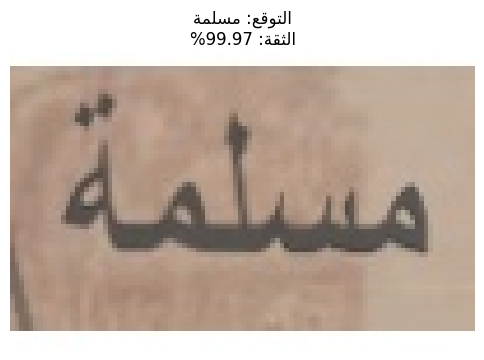

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_139_egypt_id_223_1.jpg


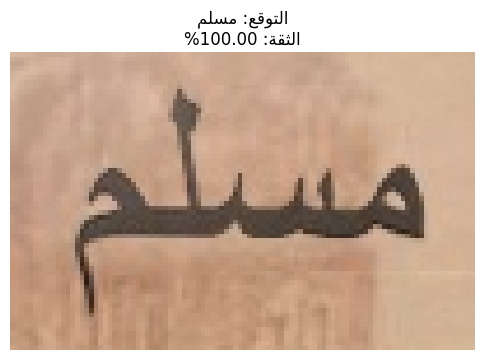

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_13_egypt_id_11_1.jpg


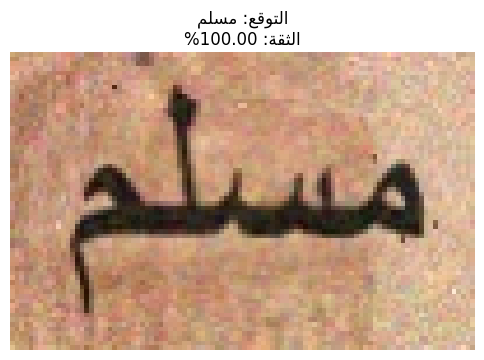

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_142_egypt_id_226_2.jpg


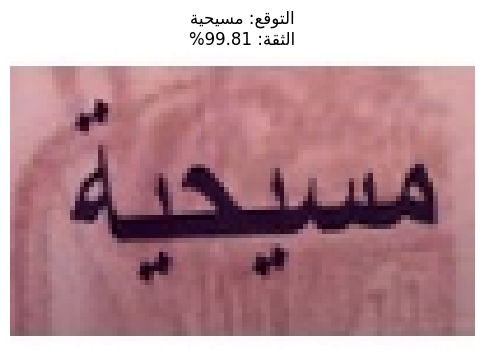

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_143_egypt_id_227_0.jpg


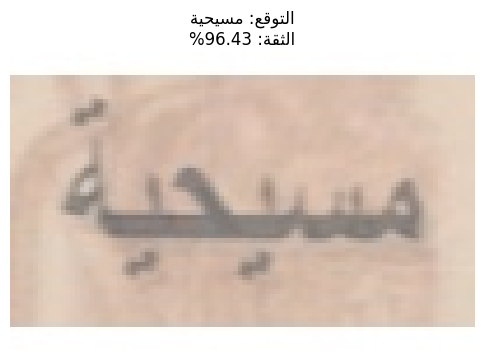

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_143_egypt_id_227_2.jpg


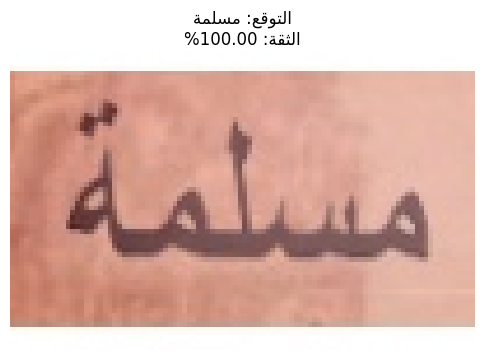

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_144_egypt_id_228_2.jpg


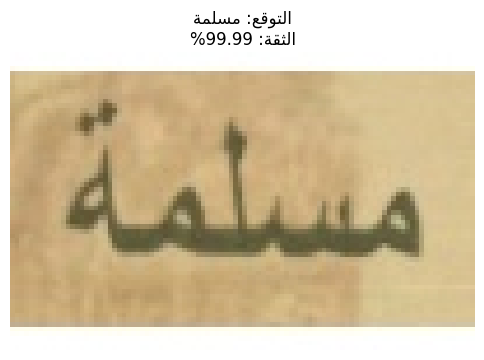

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_14_egypt_id_110_1.jpg


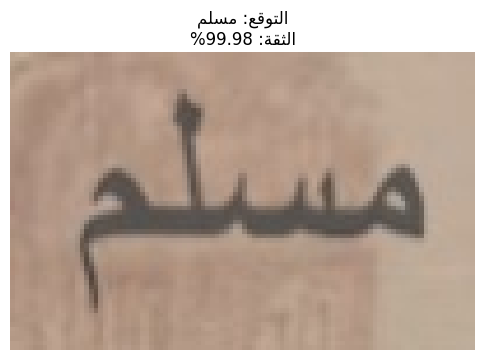

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_159_egypt_id_241_2.jpg


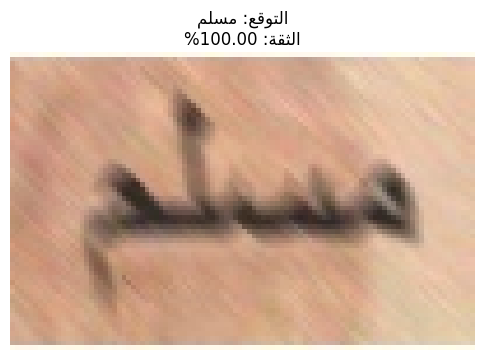

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_162_egypt_id_244_2.jpg


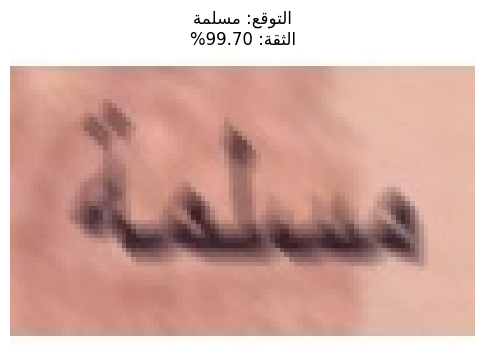

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_164_egypt_id_246_2.jpg


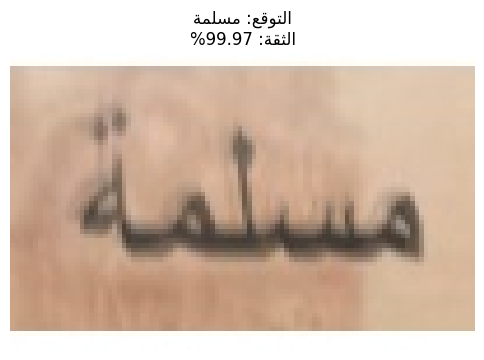

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_165_egypt_id_247_0.jpg


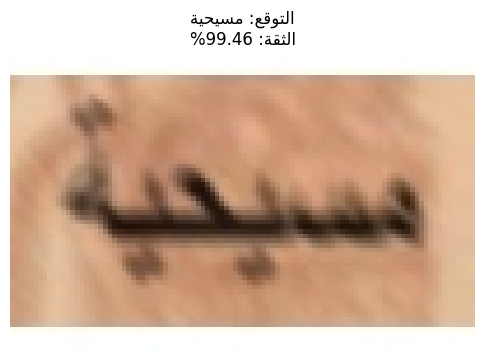

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_165_egypt_id_247_1.jpg


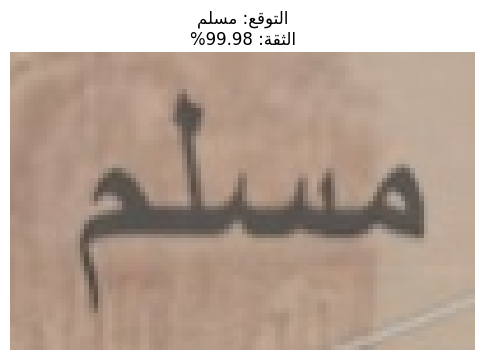

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_166_egypt_id_248_1.jpg


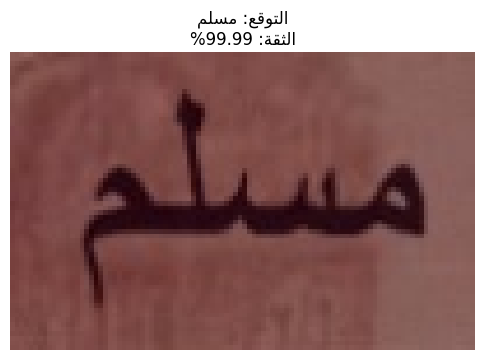

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_167_egypt_id_249_2.jpg


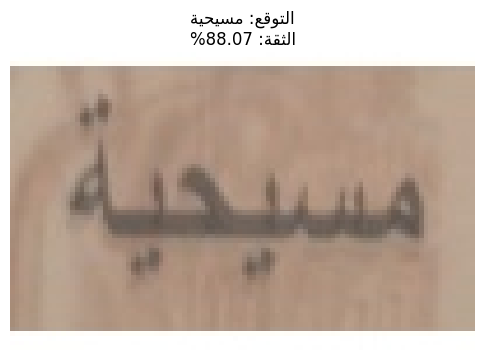

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_16_egypt_id_112_2.jpg


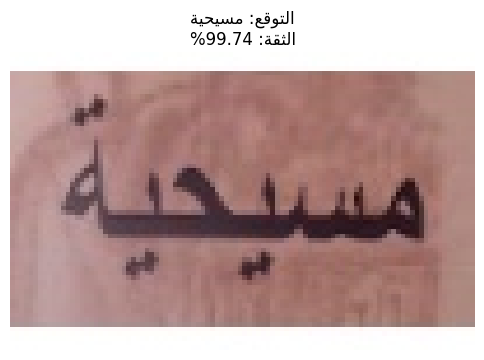

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_171_egypt_id_252_1.jpg


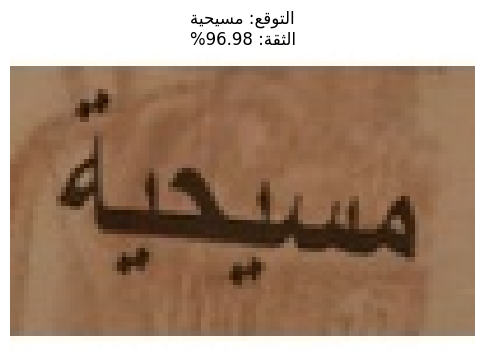

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_172_egypt_id_253_1.jpg


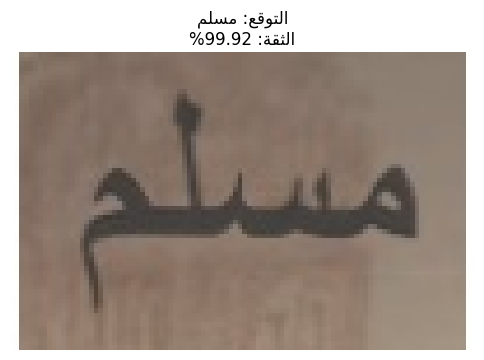

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_173_egypt_id_254_2.jpg


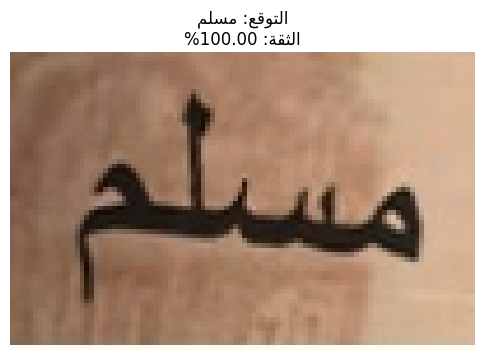

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_176_egypt_id_257_2.jpg


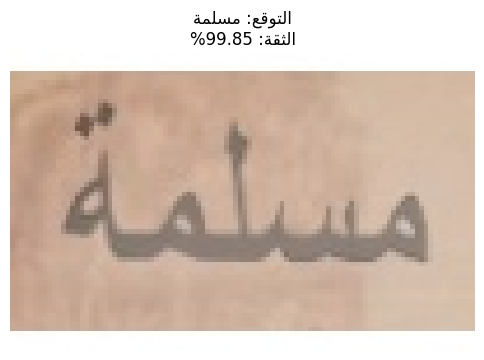

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_177_egypt_id_258_0.jpg


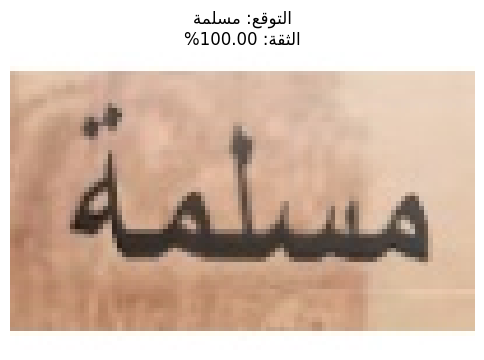

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_177_egypt_id_258_1.jpg


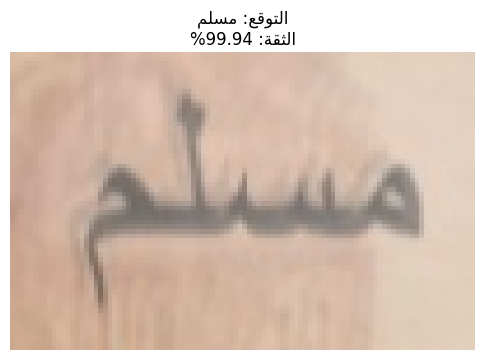

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_178_egypt_id_259_1.jpg


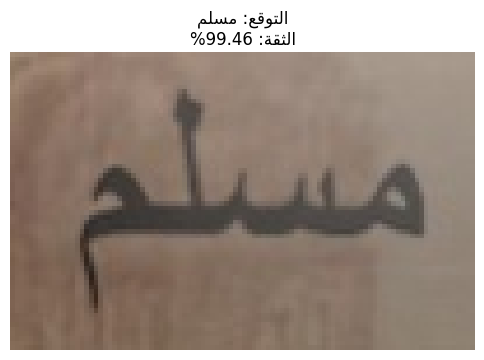

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_184_egypt_id_264_2.jpg


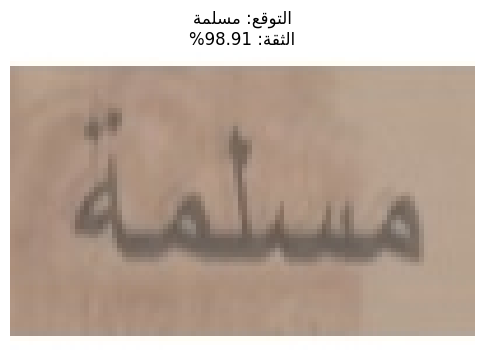

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_186_egypt_id_266_2.jpg


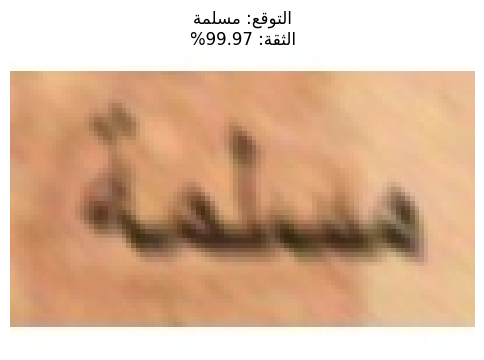

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_187_egypt_id_267_2.jpg


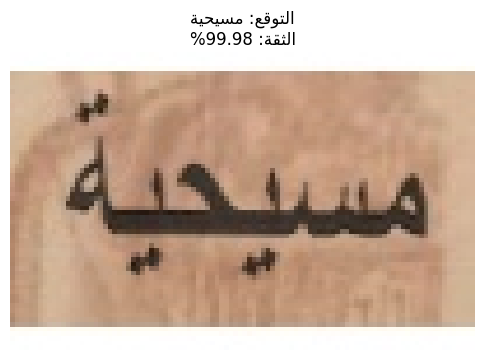

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_188_egypt_id_268_0.jpg


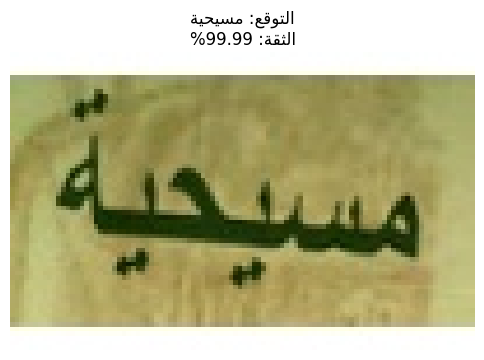

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_18_egypt_id_114_0.jpg


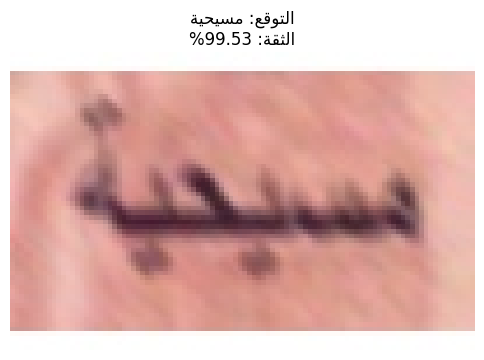

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_196_egypt_id_275_1.jpg


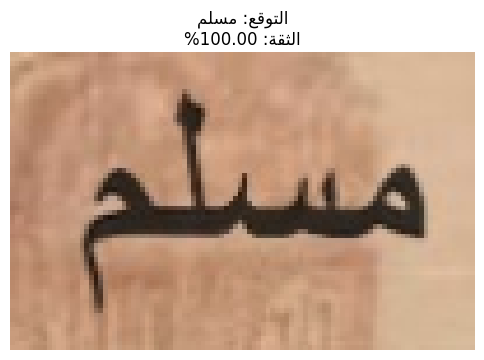

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_196_egypt_id_275_2.jpg


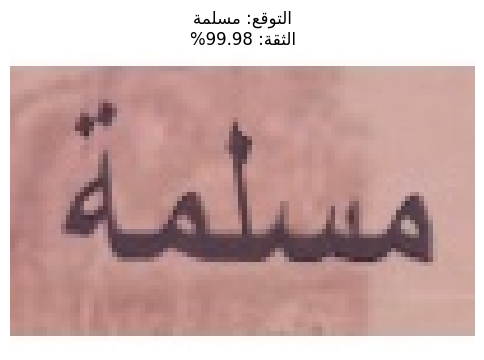

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_197_egypt_id_276_1.jpg


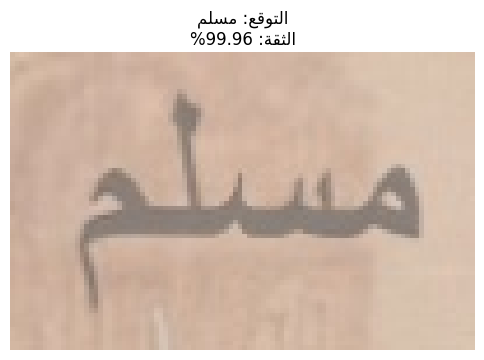

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_197_egypt_id_276_2.jpg


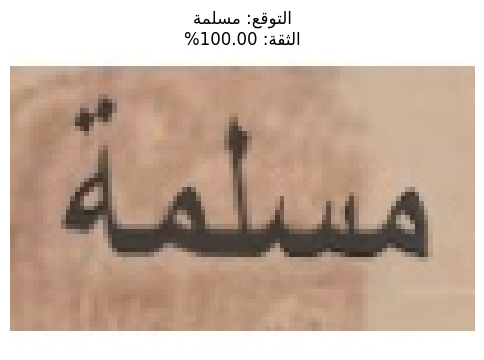

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_199_egypt_id_278_2.jpg


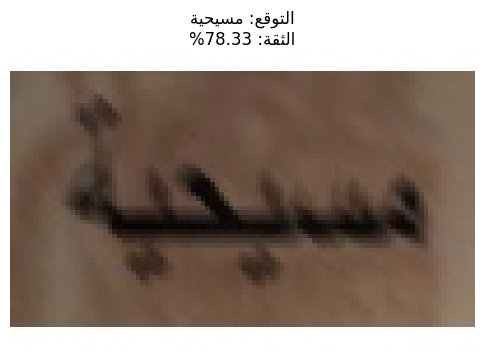

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_19_egypt_id_115_2.jpg


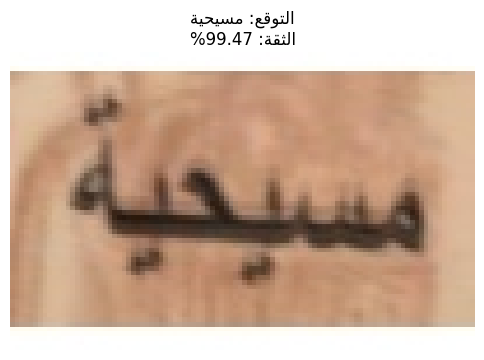

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_200_egypt_id_279_2.jpg


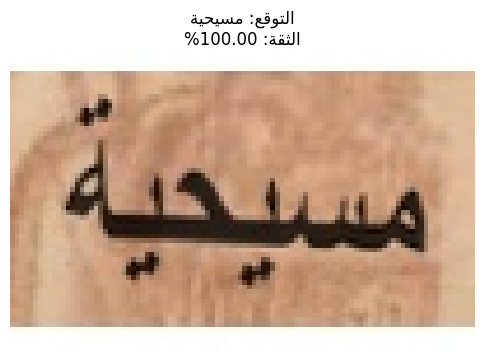

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_201_egypt_id_28_1.jpg


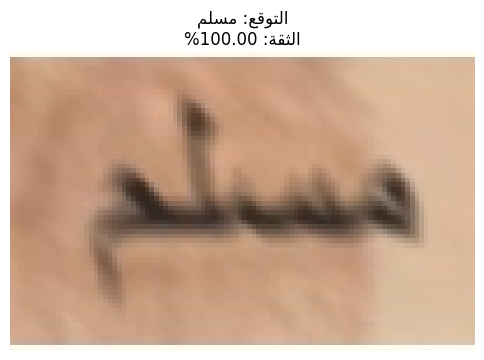

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_202_egypt_id_280_1.jpg


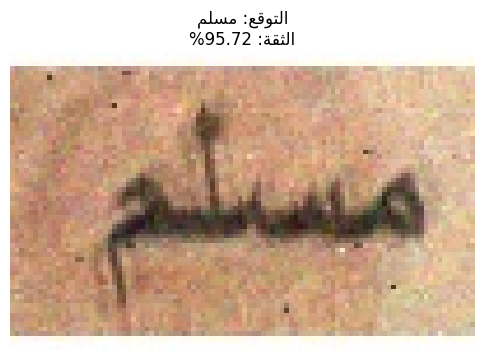

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_204_egypt_id_282_1.jpg


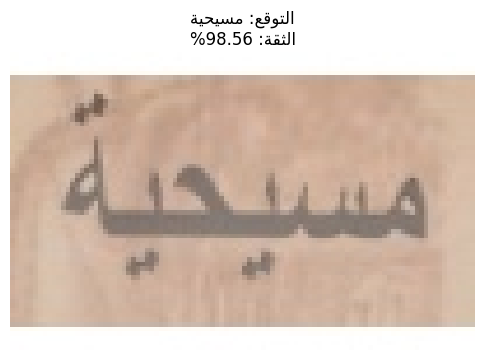

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_206_egypt_id_284_1.jpg


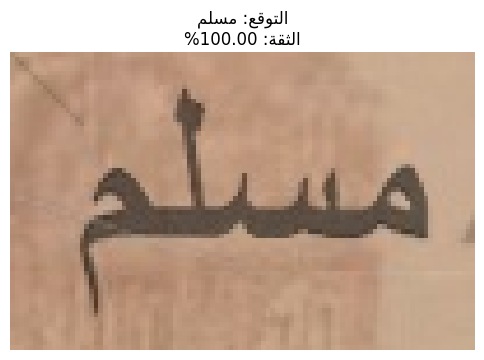

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_207_egypt_id_285_1.jpg


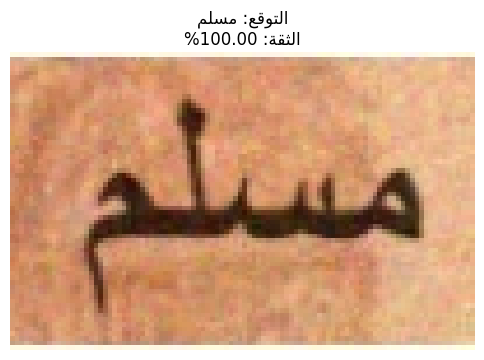

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_211_egypt_id_289_1.jpg


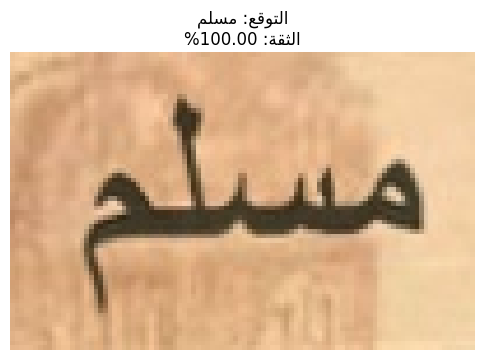

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_212_egypt_id_29_1.jpg


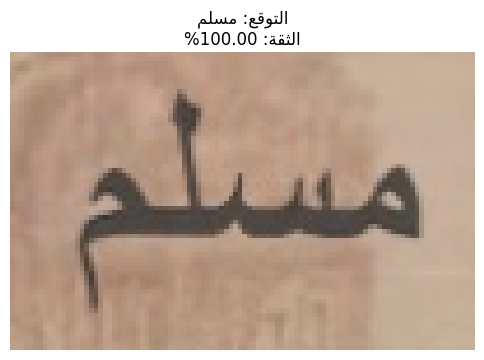

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_214_egypt_id_291_2.jpg


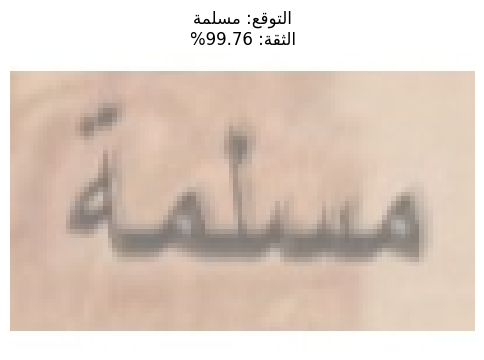

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_215_egypt_id_292_2.jpg


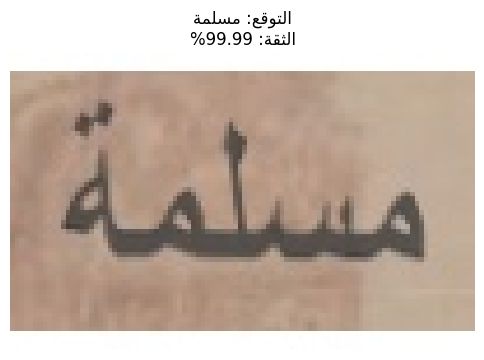

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_220_egypt_id_297_0.jpg


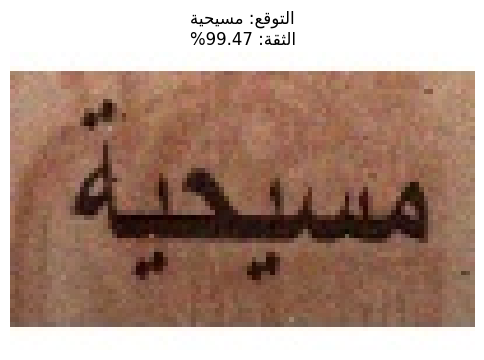

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_221_egypt_id_298_0.jpg


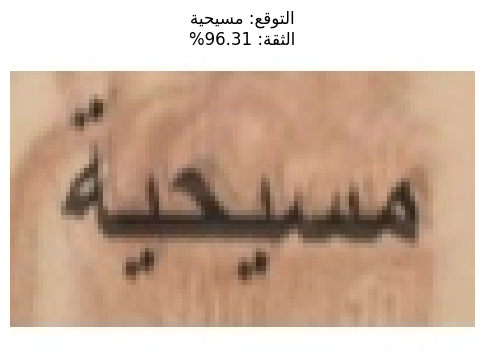

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_224_egypt_id_30_2.jpg


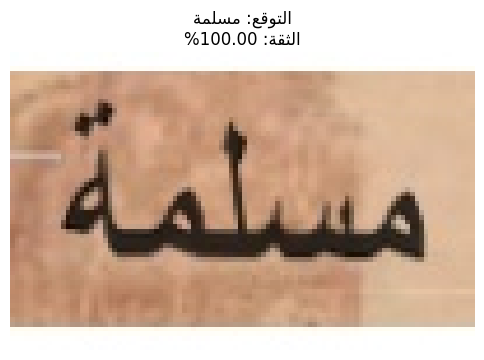

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_226_egypt_id_301_2.jpg


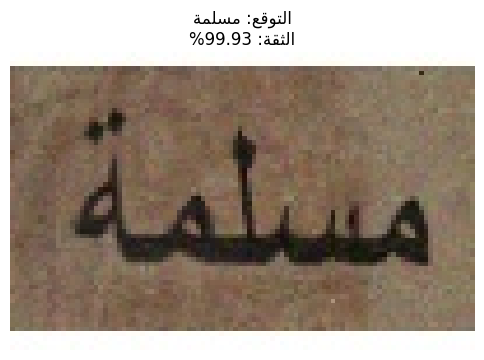

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_228_egypt_id_303_1.jpg


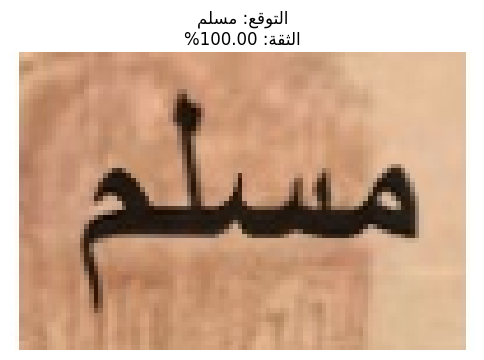

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_229_egypt_id_304_1.jpg


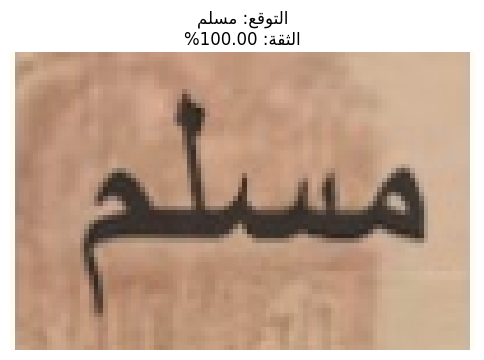

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_234_egypt_id_309_2.jpg


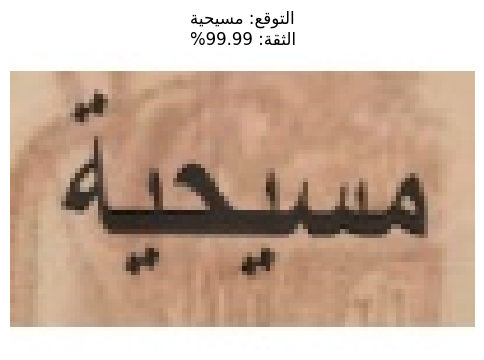

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_235_egypt_id_31_0.jpg


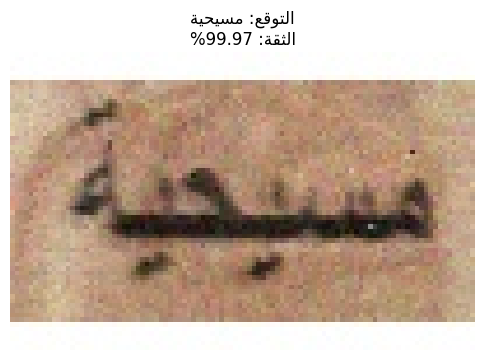

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_235_egypt_id_31_1.jpg


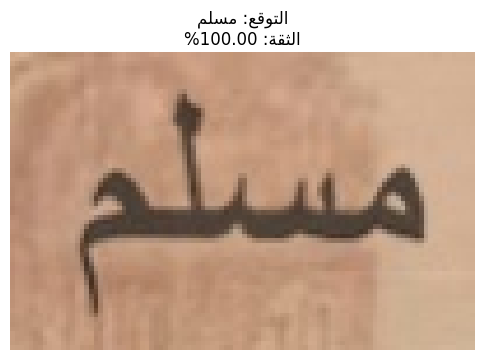

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_236_egypt_id_310_2.jpg


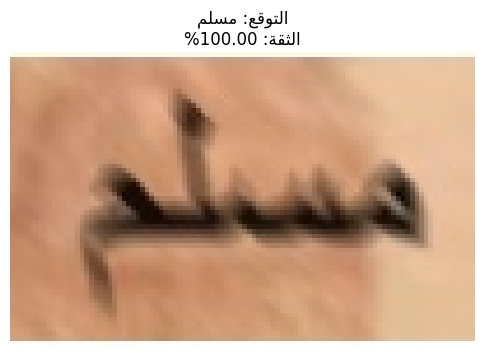

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_238_egypt_id_312_2.jpg


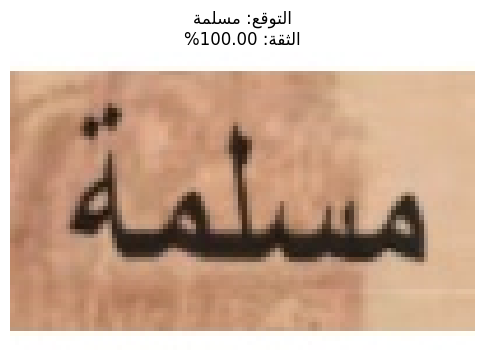

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_239_egypt_id_313_2.jpg


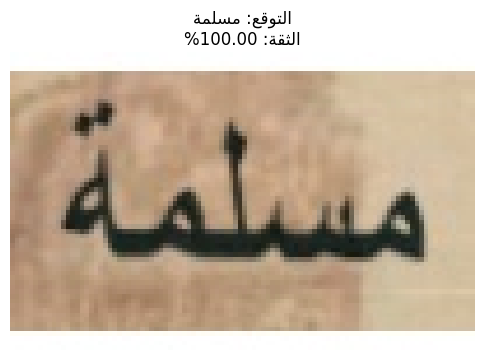

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_240_egypt_id_314_2.jpg


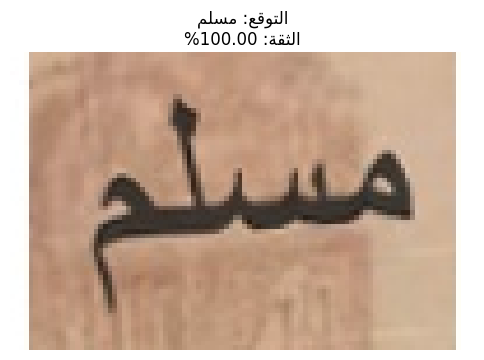

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_241_egypt_id_315_1.jpg


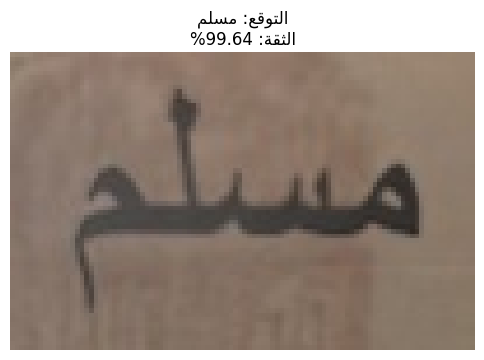

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_246_egypt_id_32_2.jpg


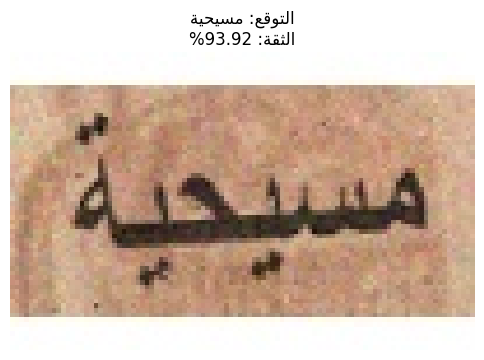

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_247_egypt_id_320_0.jpg


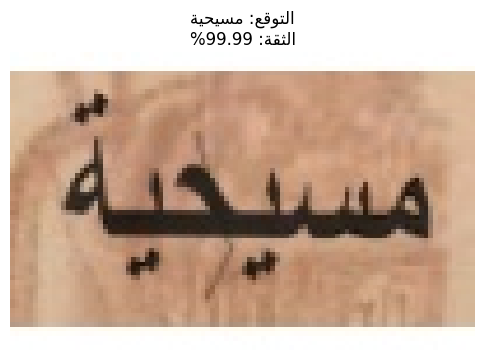

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_248_egypt_id_321_1.jpg


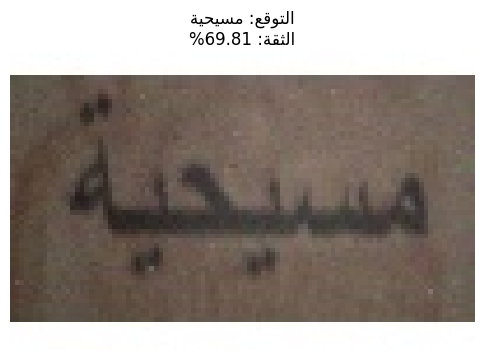

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_250_egypt_id_323_1.jpg


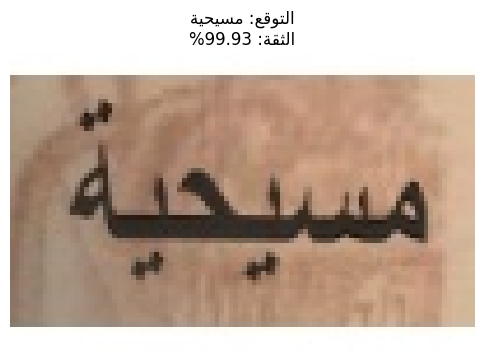

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_250_egypt_id_323_2.jpg


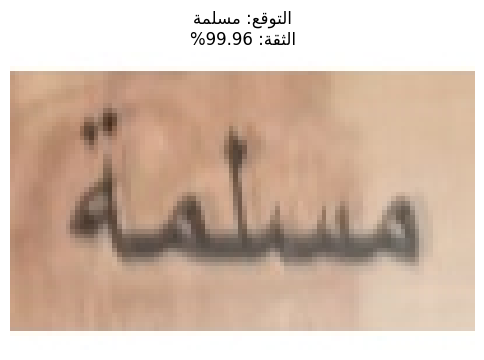

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_252_egypt_id_325_0.jpg


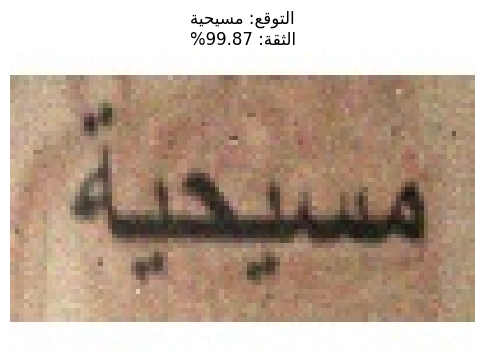

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_258_egypt_id_330_2.jpg


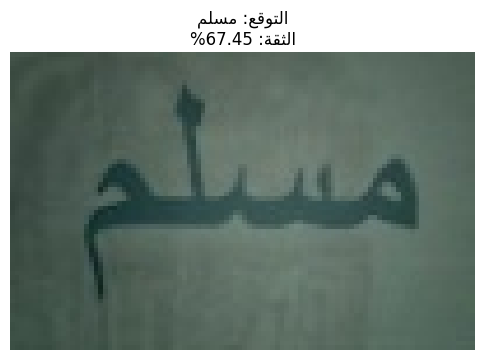

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_259_egypt_id_331_1.jpg


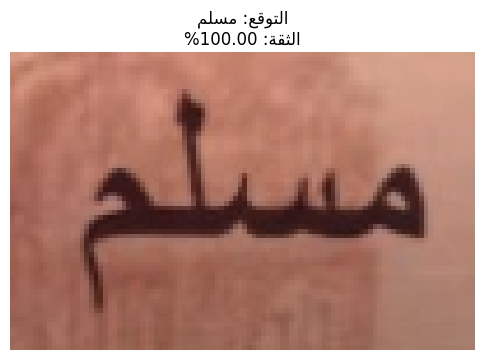

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_260_egypt_id_332_1.jpg


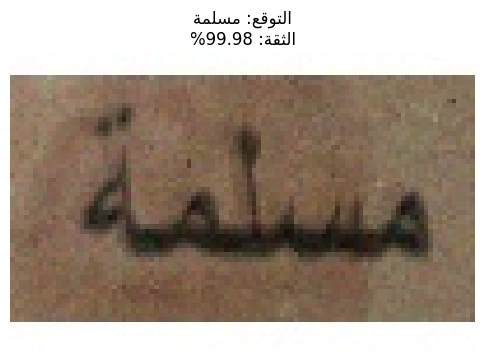

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_262_egypt_id_334_1.jpg


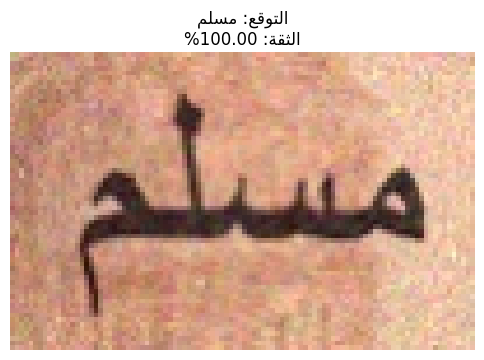

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_263_egypt_id_335_1.jpg


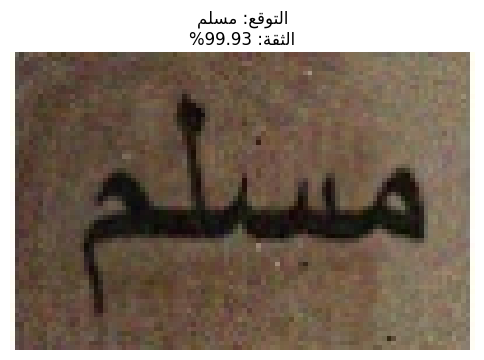

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_264_egypt_id_336_2.jpg


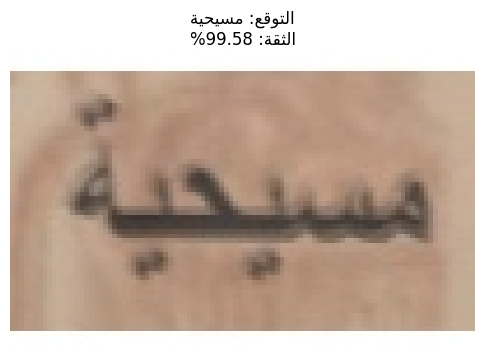

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_266_egypt_id_338_2.jpg


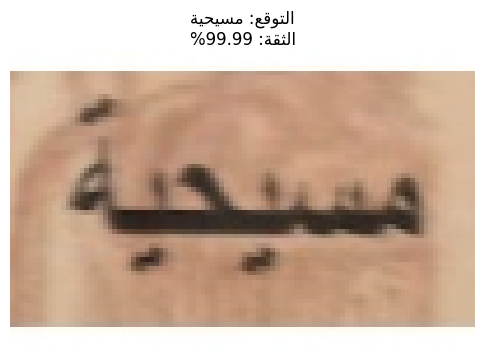

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_268_egypt_id_34_1.jpg


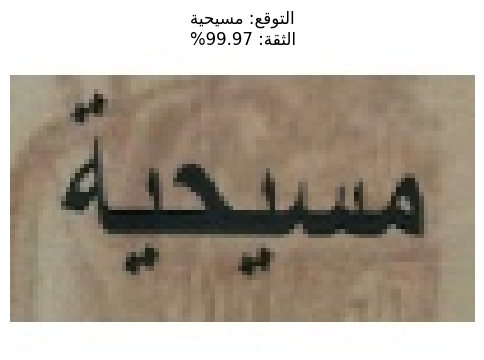

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_269_egypt_id_340_2.jpg


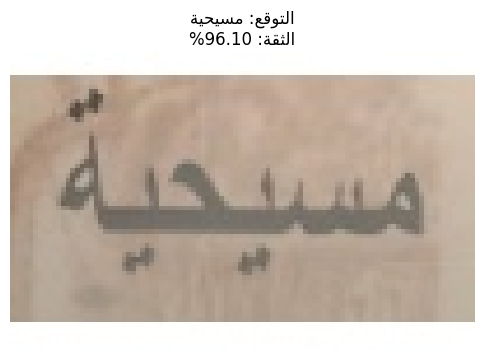

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_26_egypt_id_121_1.jpg


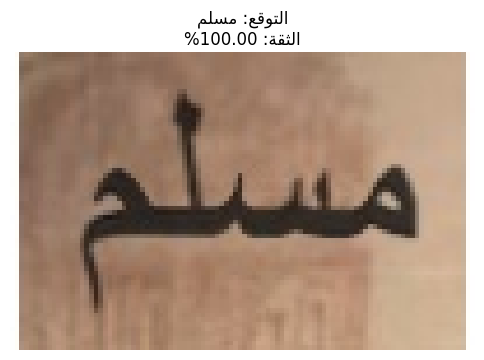

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_270_egypt_id_341_2.jpg


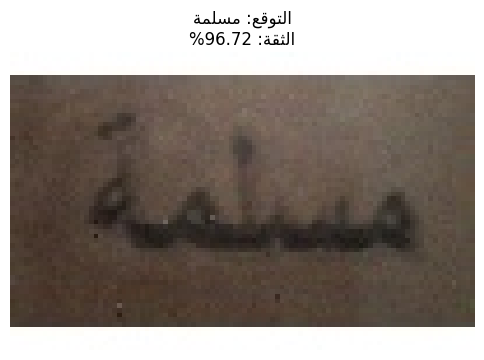

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_271_egypt_id_342_2.jpg


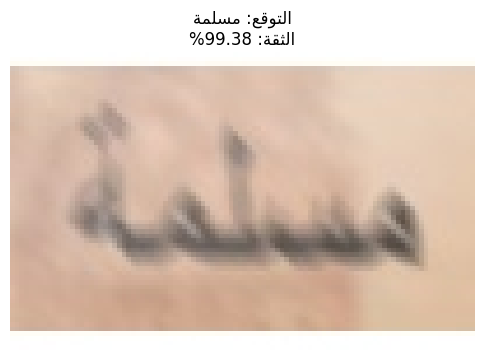

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_278_egypt_id_349_1.jpg


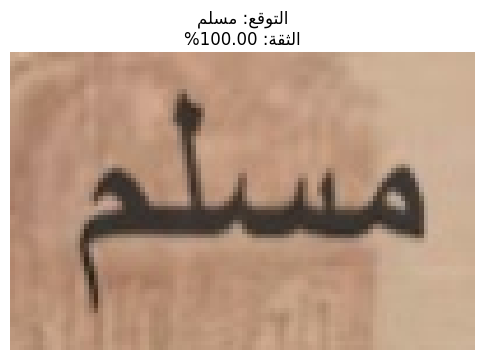

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_282_egypt_id_352_1.jpg


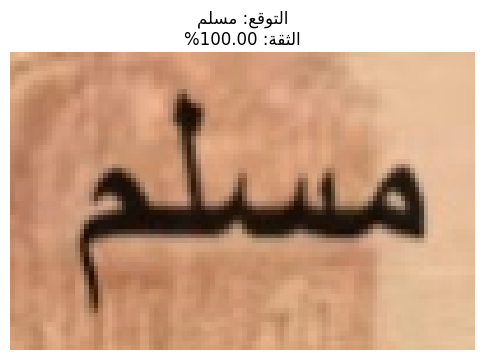

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_283_egypt_id_353_1.jpg


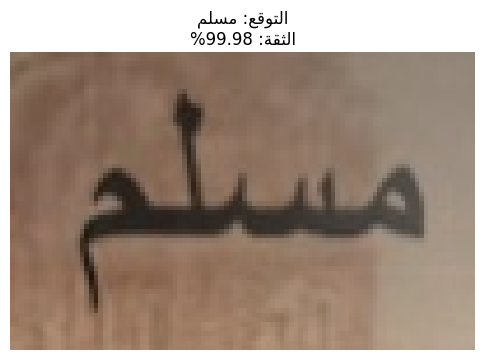

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_285_egypt_id_355_1.jpg


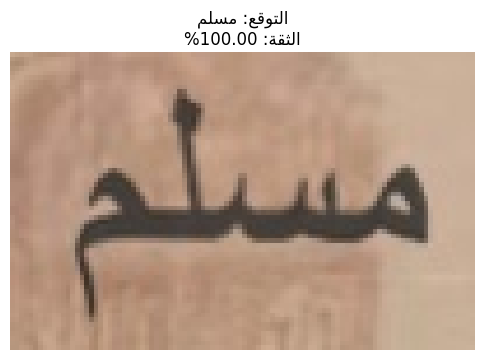

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_286_egypt_id_356_1.jpg


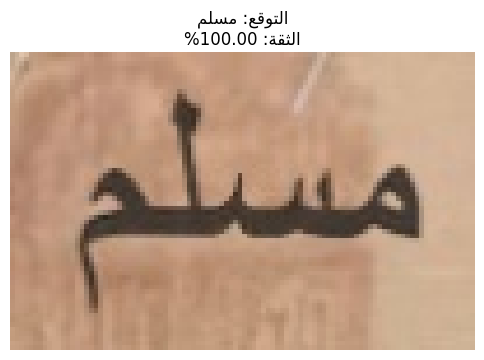

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_288_egypt_id_358_1.jpg


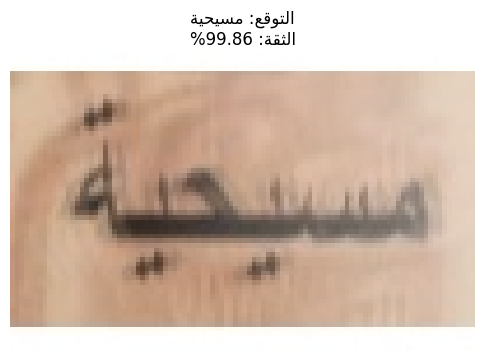

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_291_egypt_id_360_1.jpg


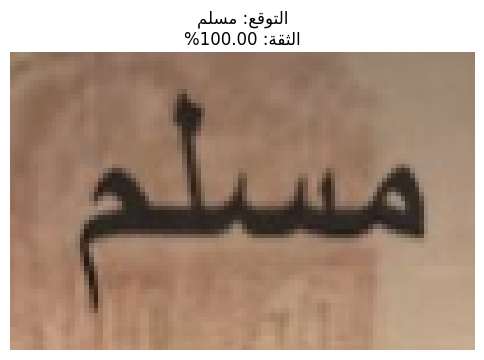

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_291_egypt_id_360_2.jpg


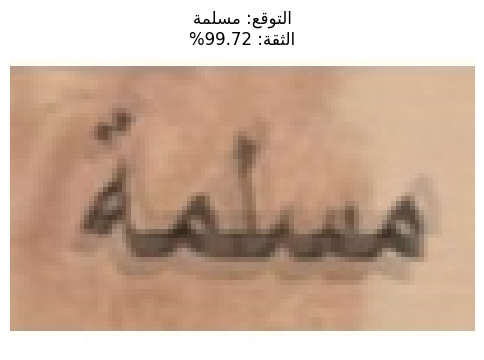

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_292_egypt_id_361_2.jpg


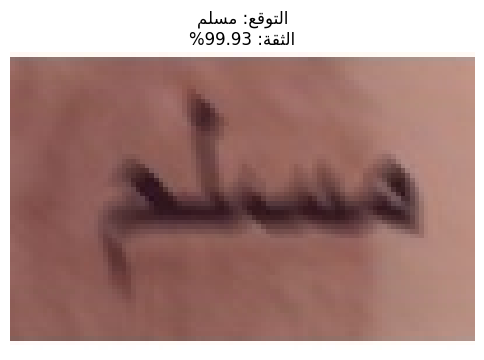

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_293_egypt_id_362_2.jpg


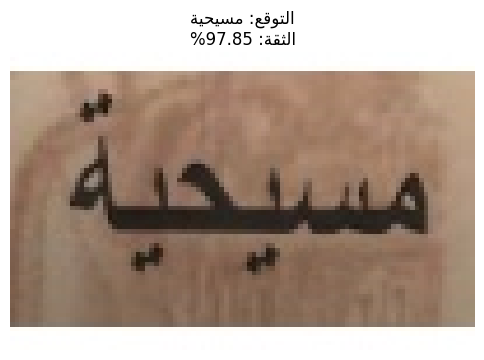

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_294_egypt_id_363_2.jpg


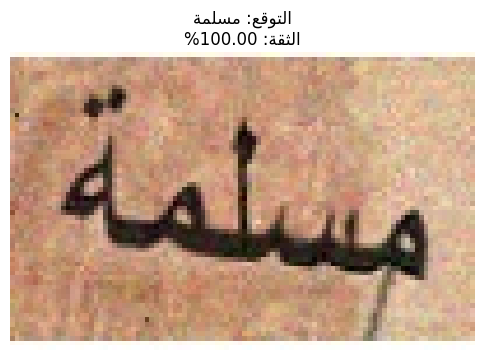

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_304_egypt_id_372_2.jpg


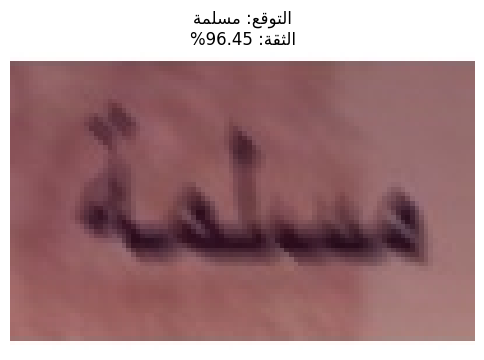

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_305_egypt_id_373_2.jpg


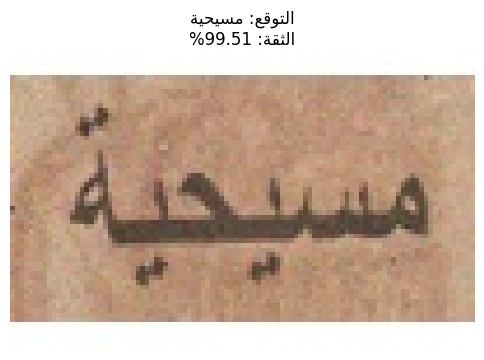

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_306_egypt_id_374_2.jpg


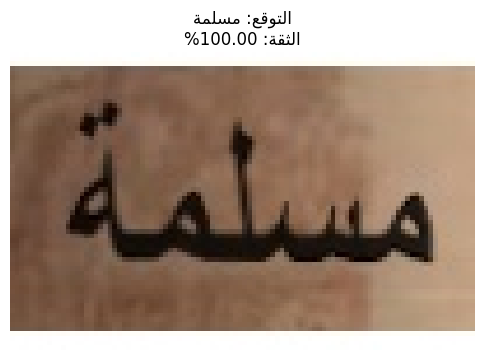

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_309_egypt_id_377_1.jpg


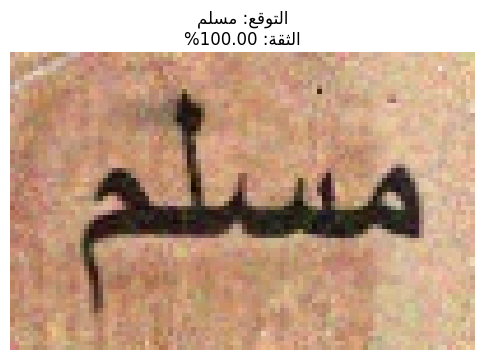

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_30_egypt_id_125_1.jpg


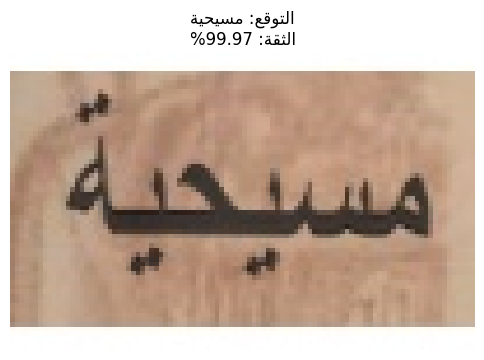

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_310_egypt_id_378_2.jpg


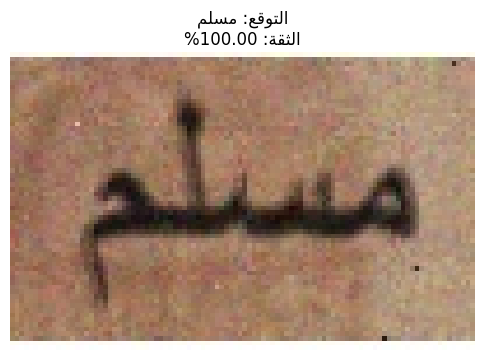

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_313_egypt_id_380_1.jpg


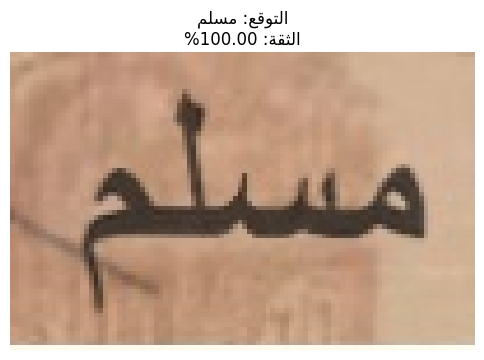

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_314_egypt_id_381_1.jpg


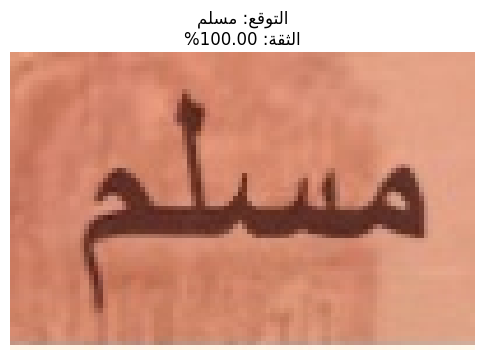

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_319_egypt_id_386_1.jpg


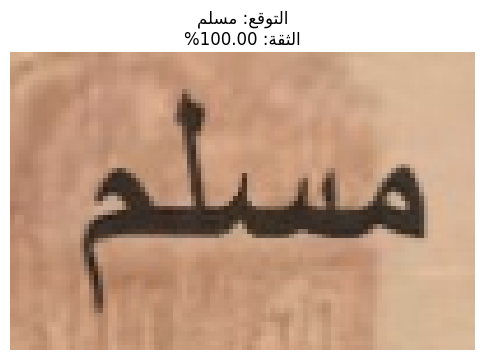

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_320_egypt_id_387_1.jpg


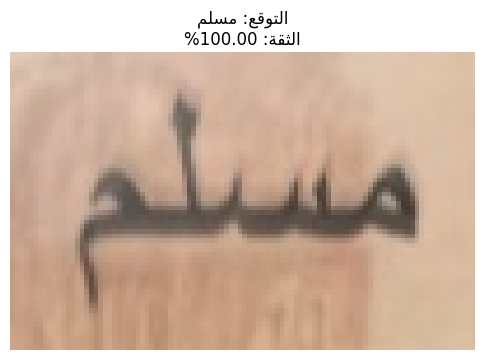

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_323_egypt_id_39_2.jpg


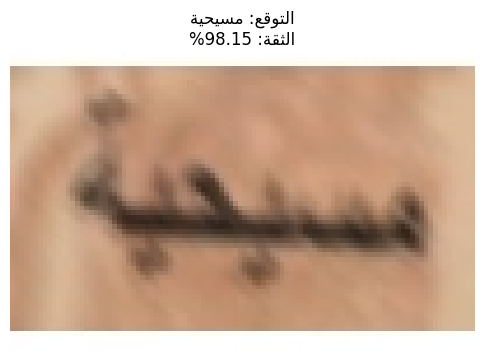

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_324_egypt_id_390_2.jpg


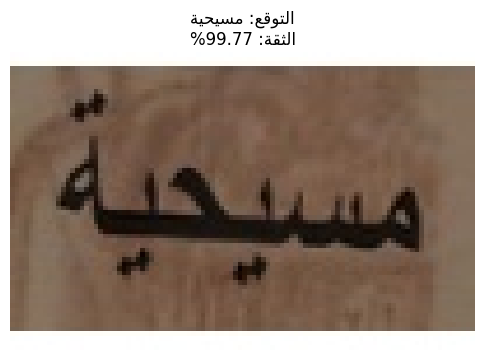

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_325_egypt_id_391_0.jpg


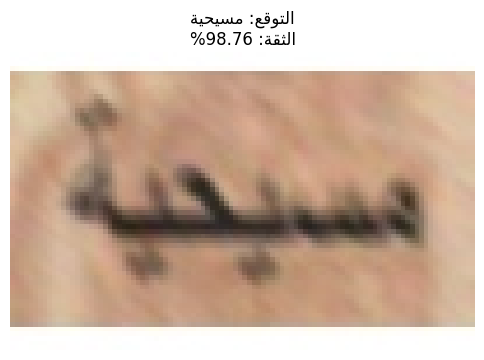

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_328_egypt_id_394_0.jpg


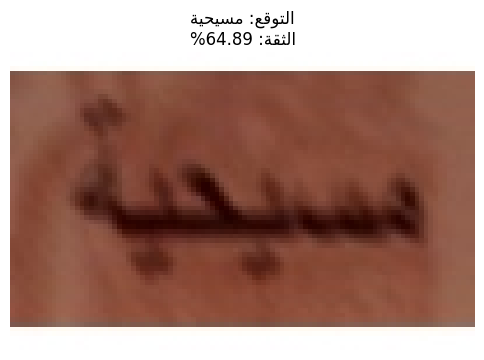

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_330_egypt_id_396_1.jpg


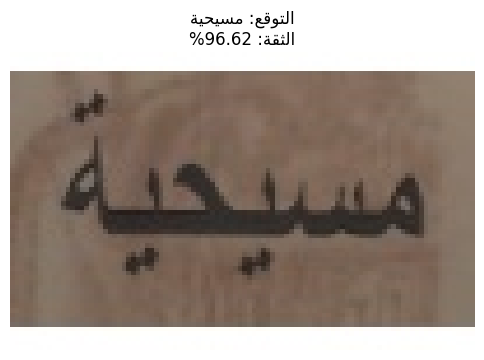

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_334_egypt_id_4_1.jpg


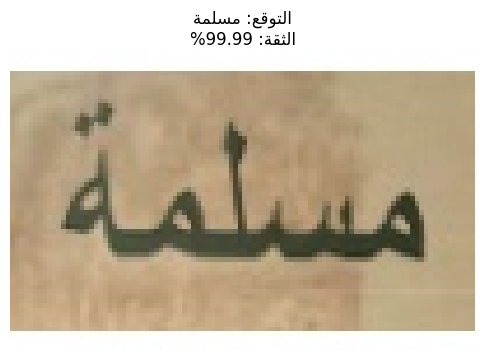

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_335_egypt_id_40_2.jpg


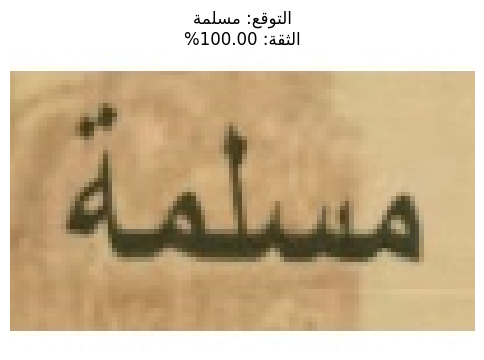

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_339_egypt_id_403_1.jpg


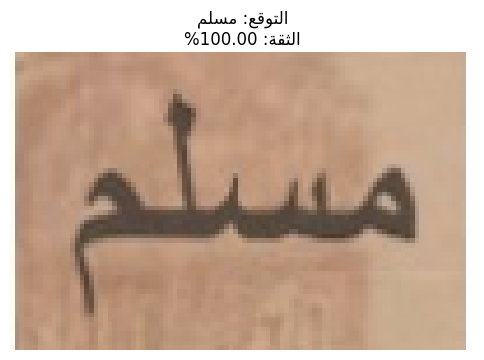

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_340_egypt_id_404_1.jpg


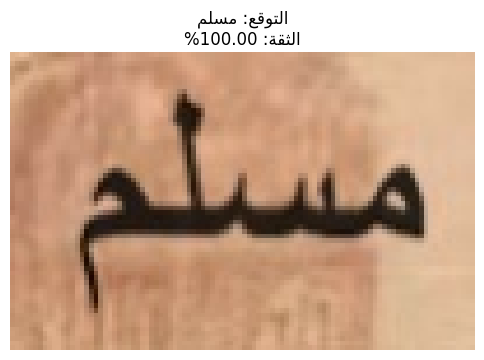

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_344_egypt_id_408_2.jpg


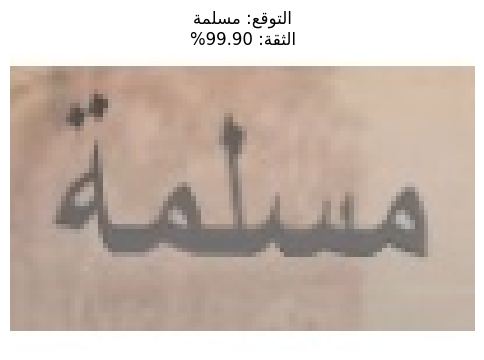

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_346_egypt_id_41_2.jpg


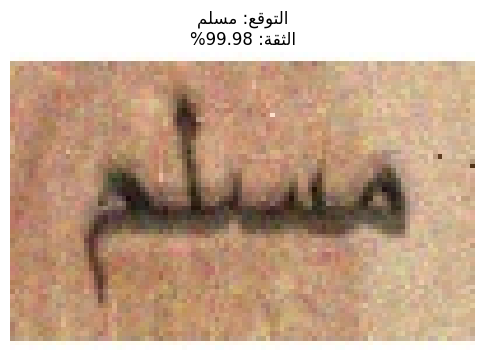

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_347_egypt_id_410_2.jpg


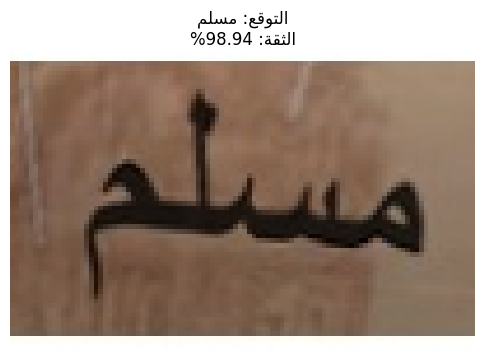

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_350_egypt_id_413_2.jpg


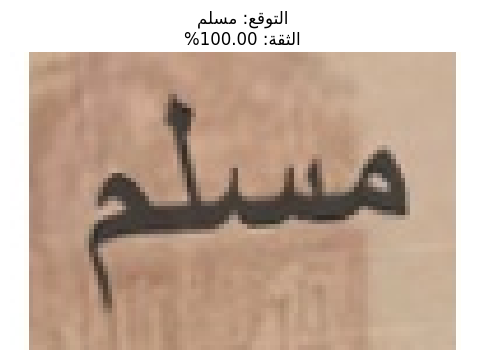

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_351_egypt_id_414_1.jpg


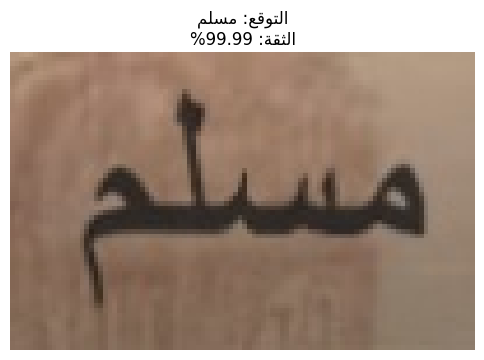

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_352_egypt_id_415_0.jpg


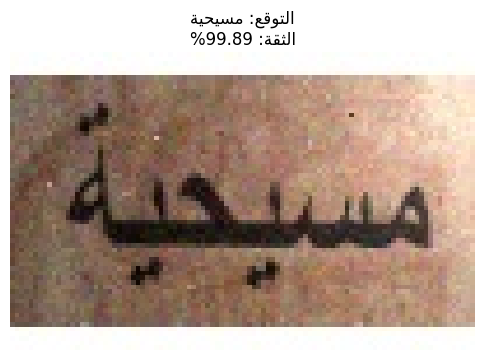

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_354_egypt_id_417_1.jpg


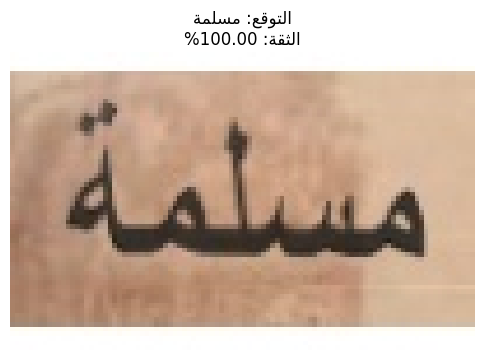

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_355_egypt_id_418_1.jpg


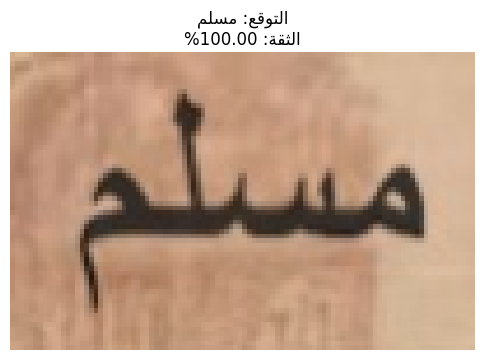

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_356_egypt_id_419_1.jpg


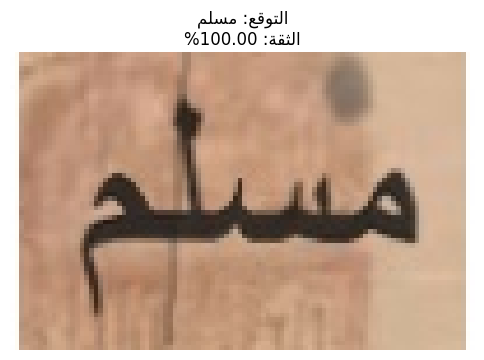

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_357_egypt_id_42_2.jpg


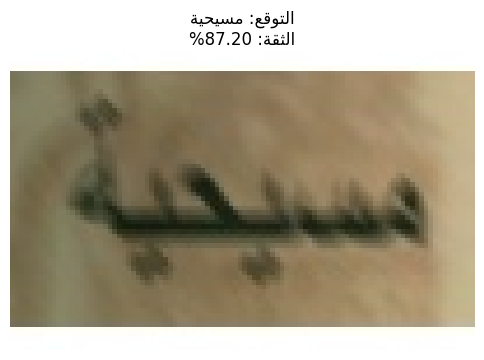

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_358_egypt_id_420_2.jpg


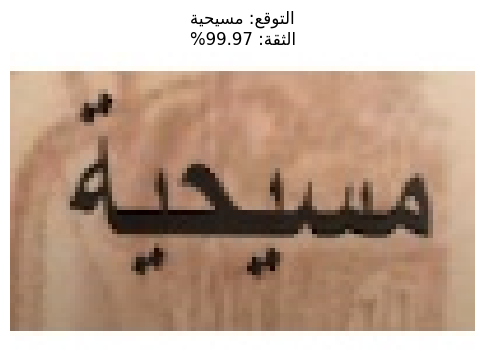

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_361_egypt_id_423_1.jpg


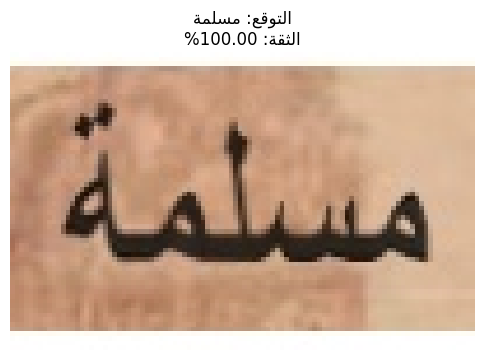

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_361_egypt_id_423_2.jpg


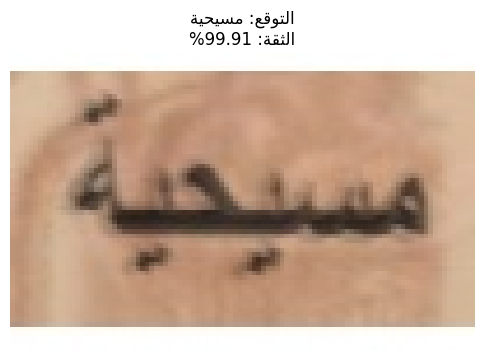

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_362_egypt_id_424_2.jpg


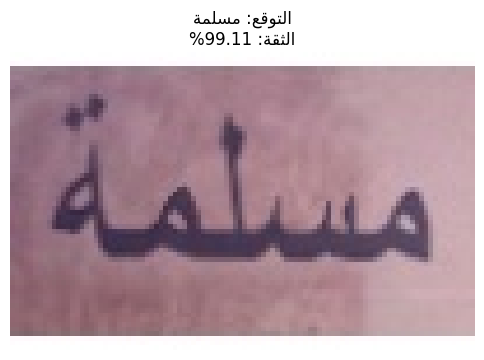

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_364_egypt_id_426_2.jpg


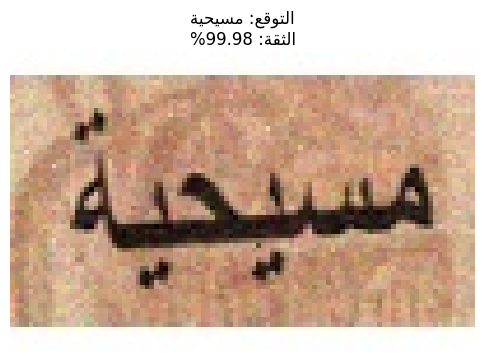

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_365_egypt_id_427_0.jpg


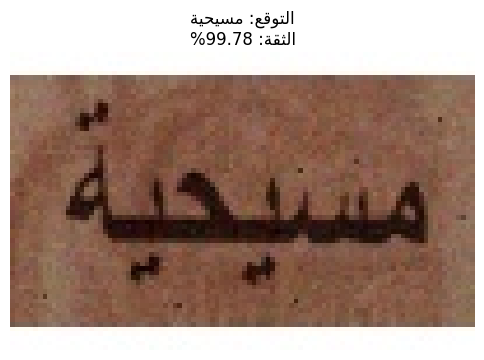

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_371_egypt_id_432_2.jpg


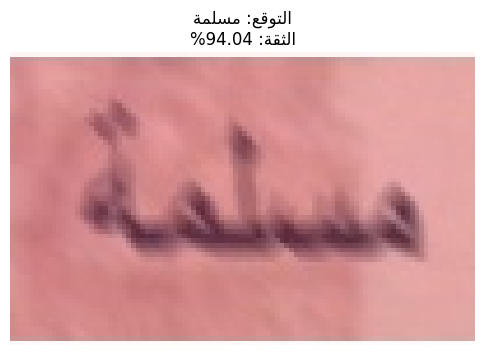

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_372_egypt_id_433_2.jpg


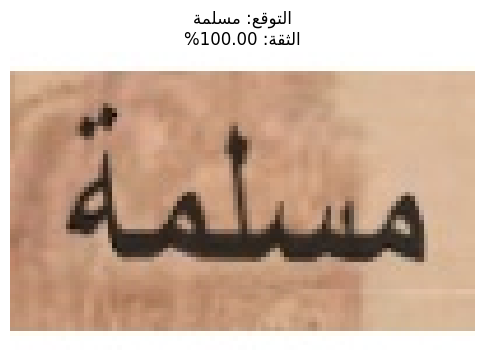

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_373_egypt_id_434_2.jpg


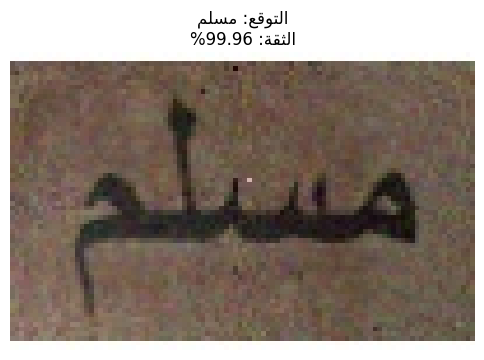

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_374_egypt_id_435_2.jpg


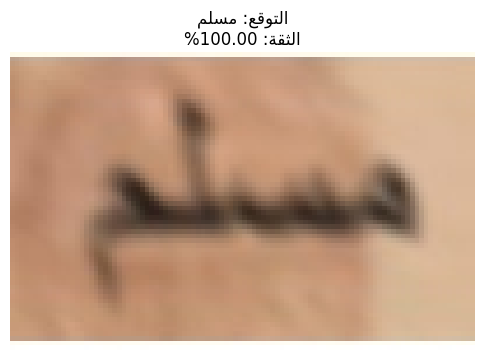

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_376_egypt_id_437_2.jpg


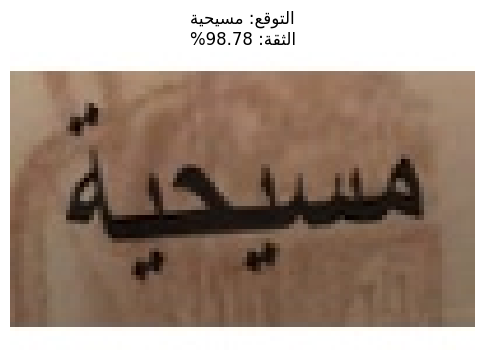

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_377_egypt_id_438_0.jpg


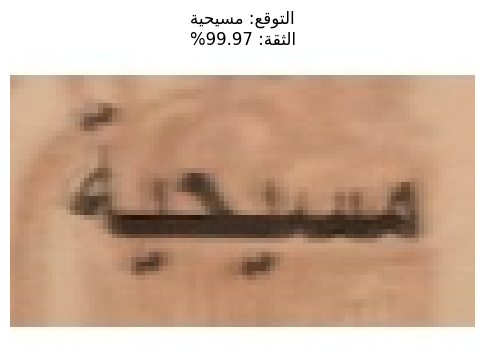

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_379_egypt_id_44_1.jpg


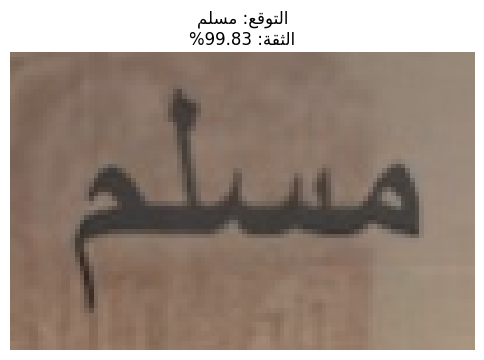

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_37_egypt_id_131_0.jpg


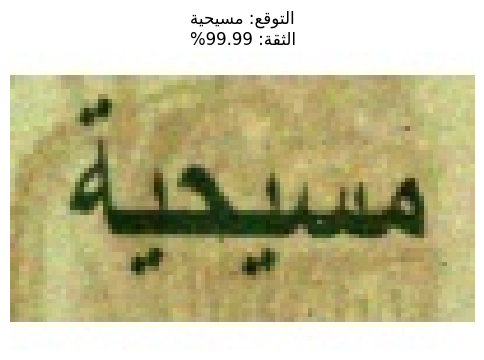

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_380_egypt_id_440_0.jpg


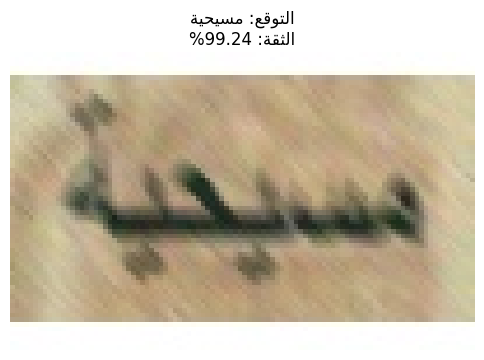

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_380_egypt_id_440_1.jpg


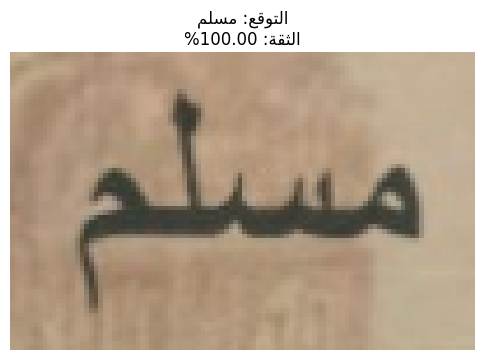

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_383_egypt_id_443_2.jpg


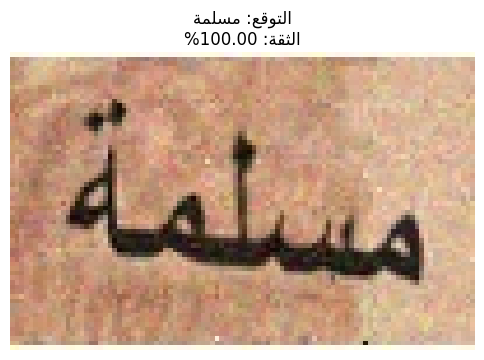

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_386_egypt_id_446_1.jpg


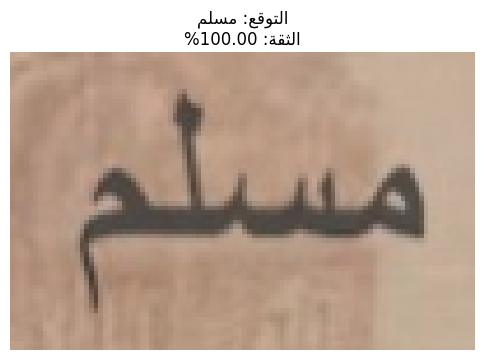

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_387_egypt_id_447_1.jpg


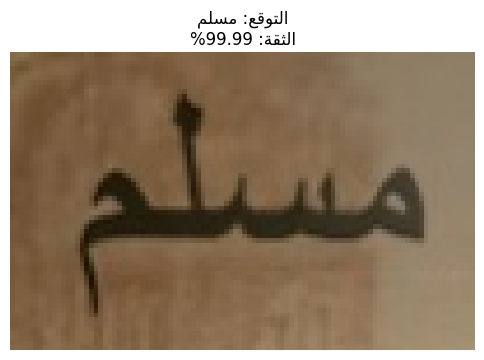

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_392_egypt_id_451_0.jpg


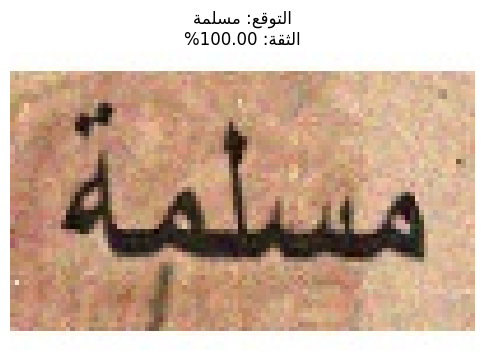

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_393_egypt_id_452_1.jpg


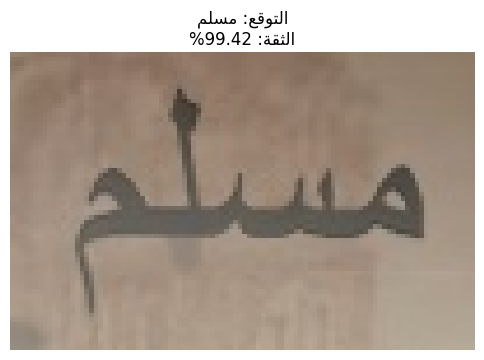

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_394_egypt_id_453_2.jpg


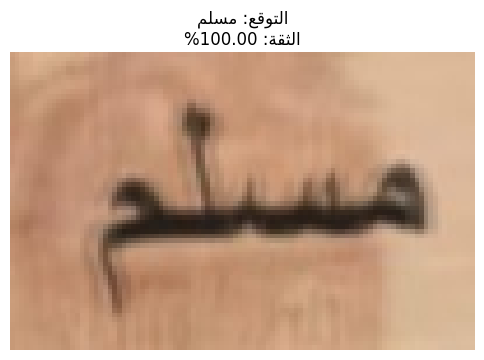

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_401_egypt_id_46_1.jpg


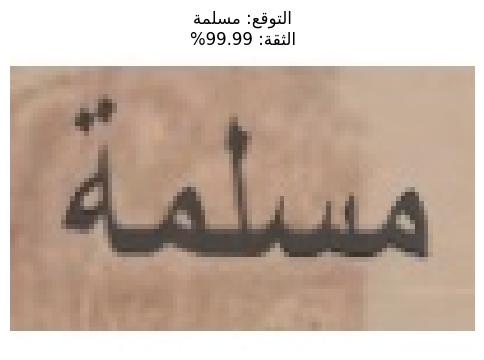

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_401_egypt_id_46_2.jpg


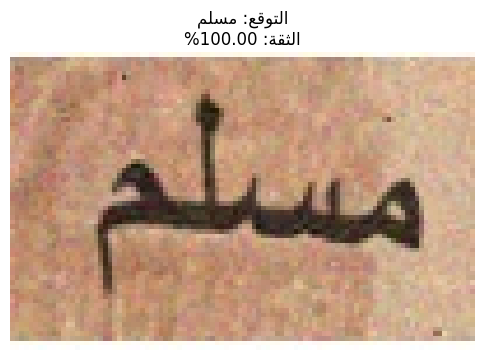

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_402_egypt_id_460_1.jpg


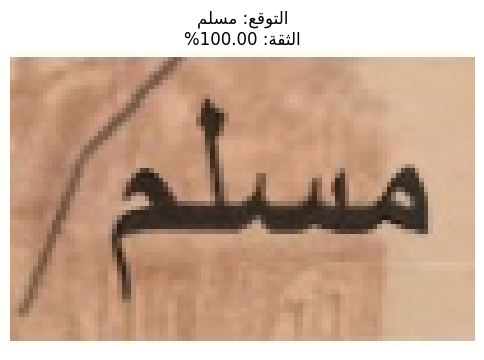

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_403_egypt_id_461_2.jpg


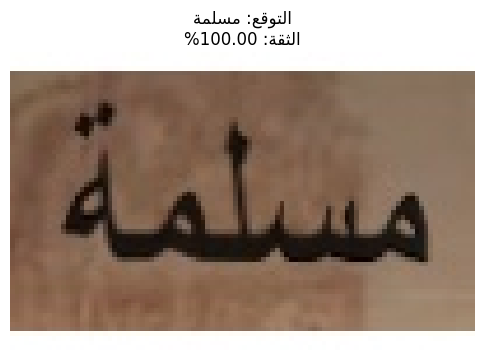

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_409_egypt_id_467_1.jpg


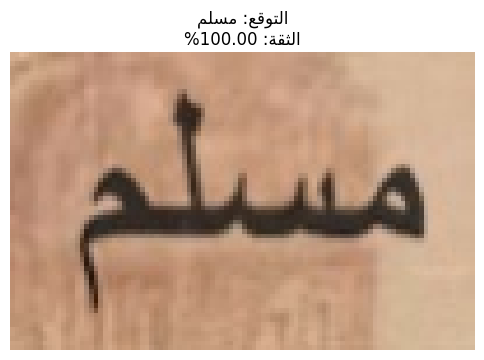

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_40_egypt_id_134_1.jpg


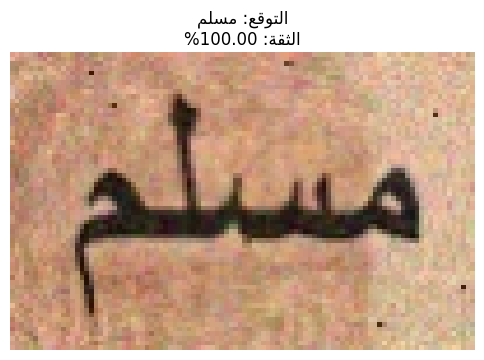

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_41_egypt_id_135_1.jpg


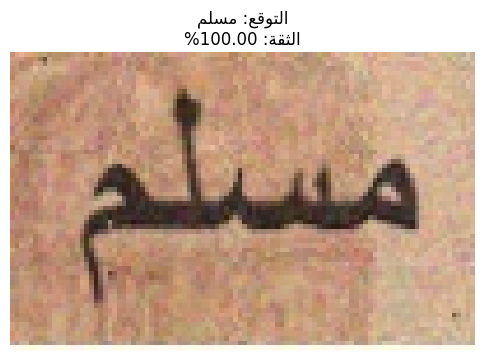

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (104).jpg


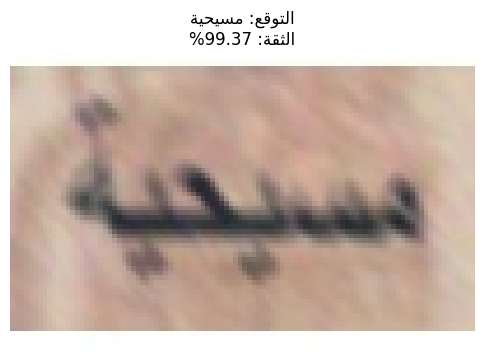

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (112).jpg


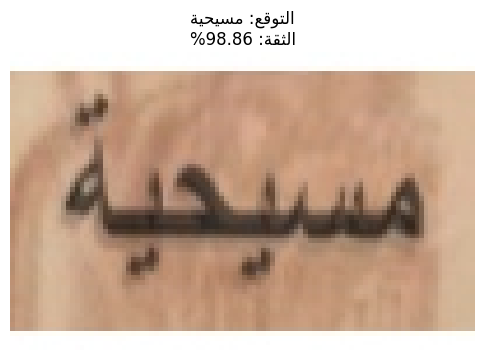

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (116).jpg


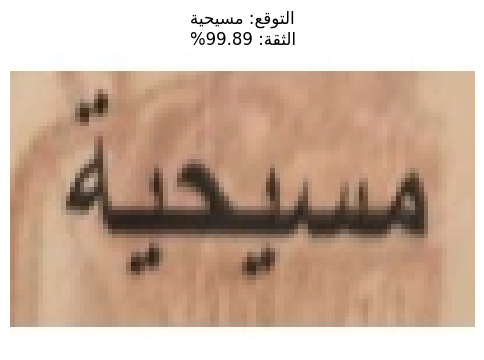

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (117).jpg


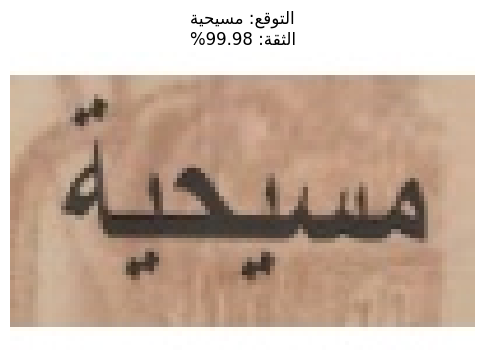

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (118).jpg


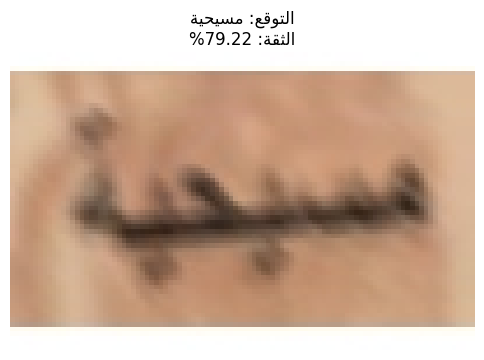

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (121).jpg


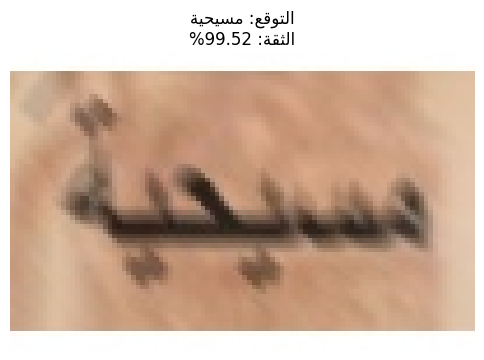

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (125).jpg


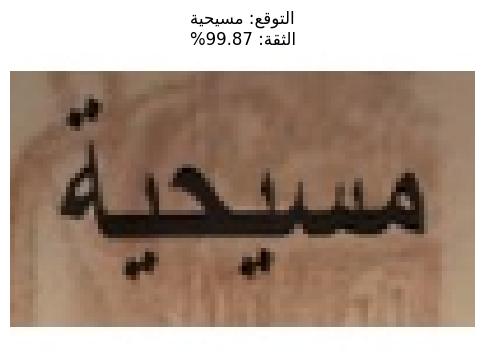

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (126).jpg


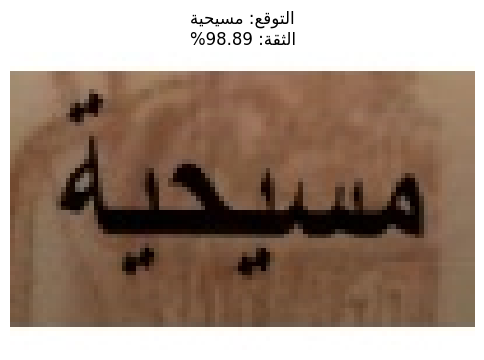

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (131).jpg


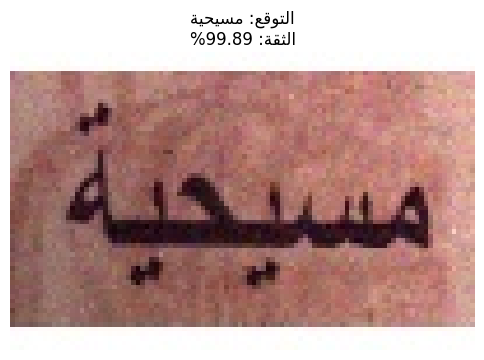

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (132).jpg


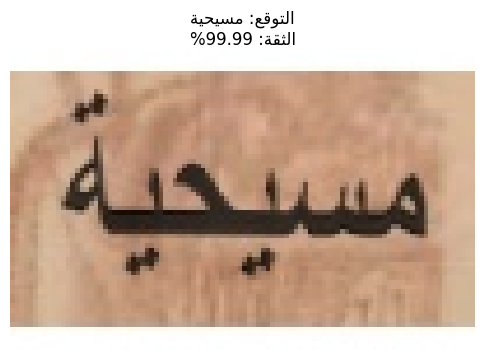

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (135).jpg


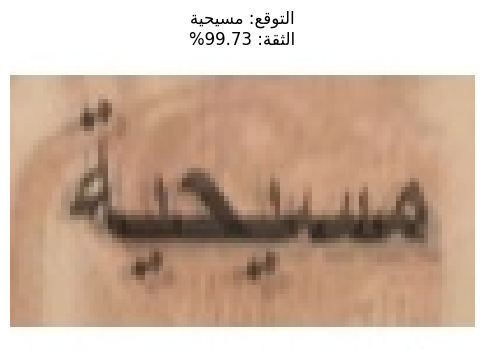

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (147).jpg


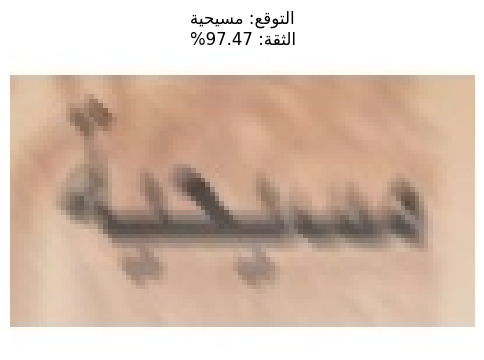

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (148).jpg


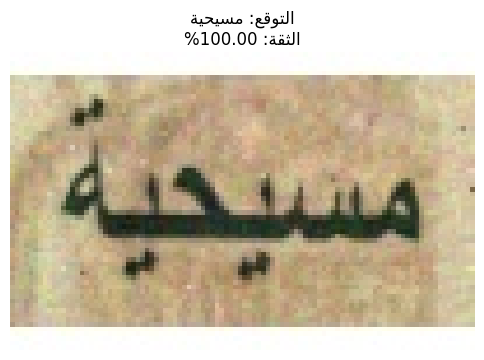

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (149).jpg


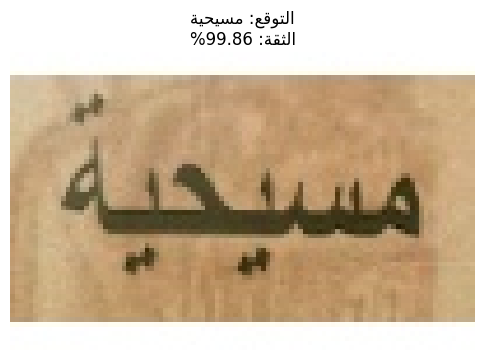

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (159).jpg


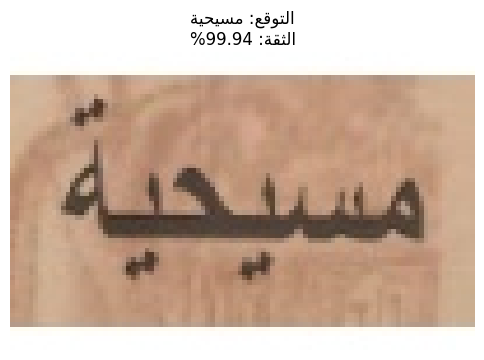

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (160).jpg


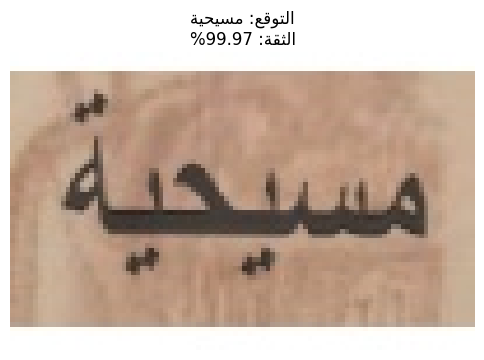

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (161).jpg


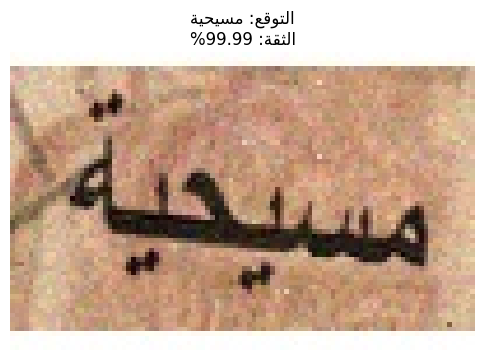

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (171).jpg


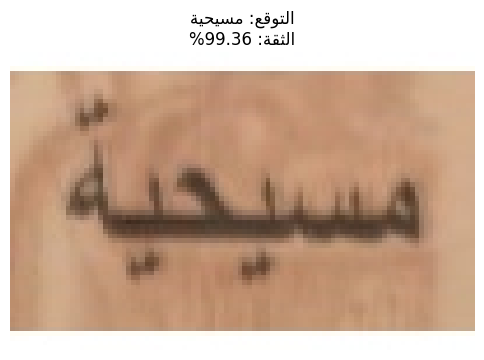

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (172).jpg


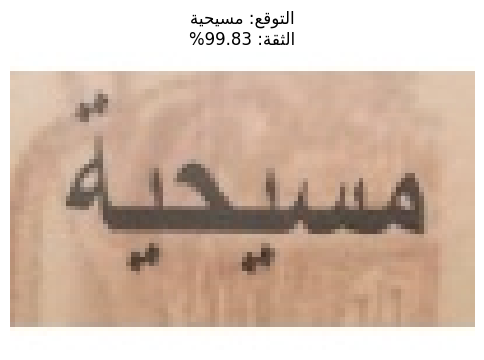

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (173).jpg


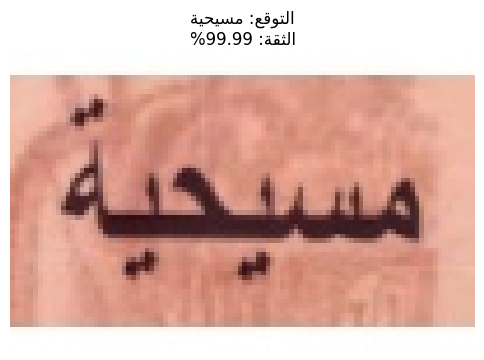

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (178).jpg


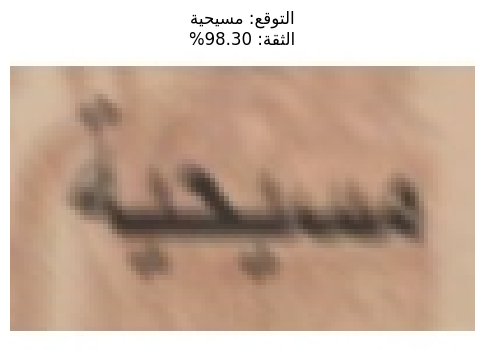

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (179).jpg


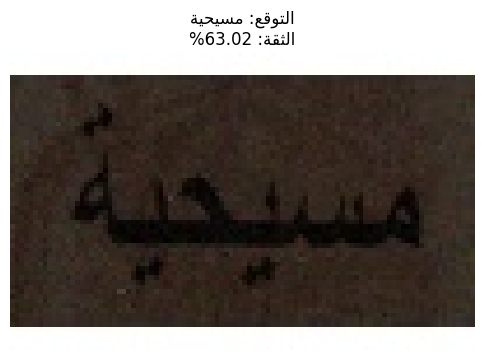

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (41).jpg


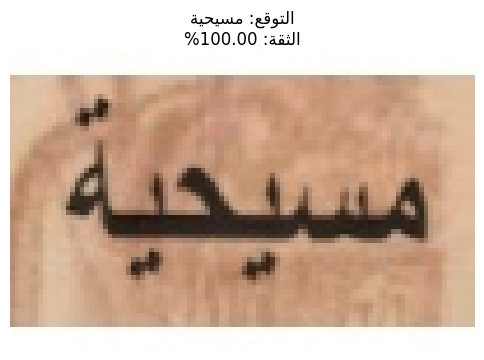

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (44).jpg


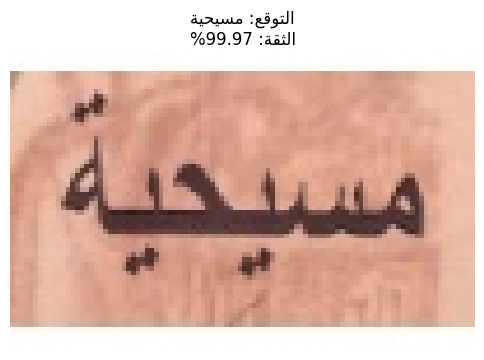

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (53).jpg


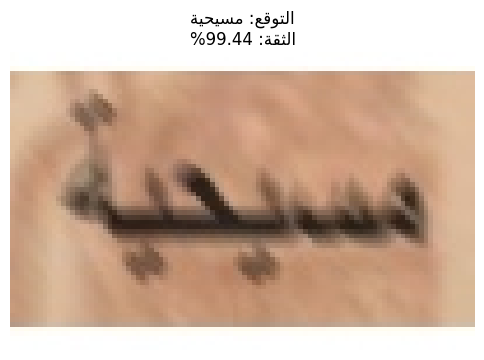

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (55).jpg


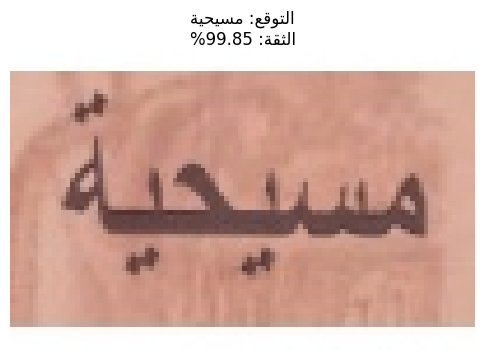

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (56).jpg


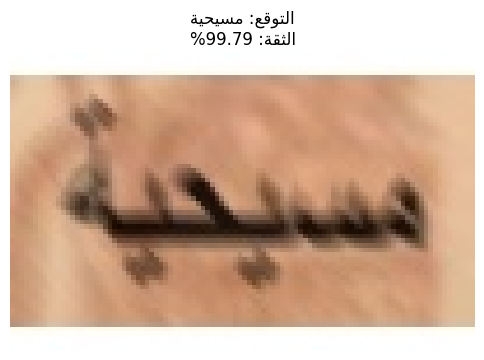

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (59).jpg


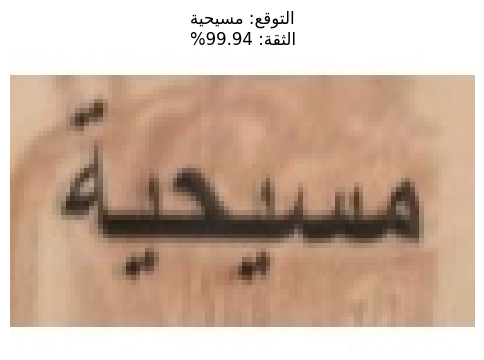

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (60).jpg


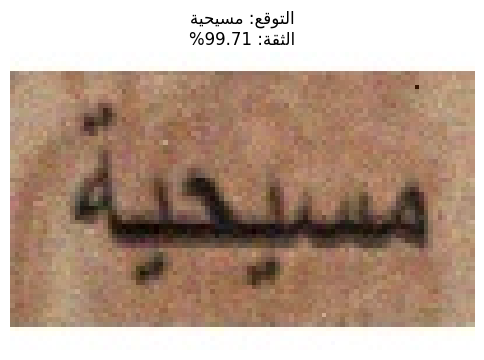

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (68).jpg


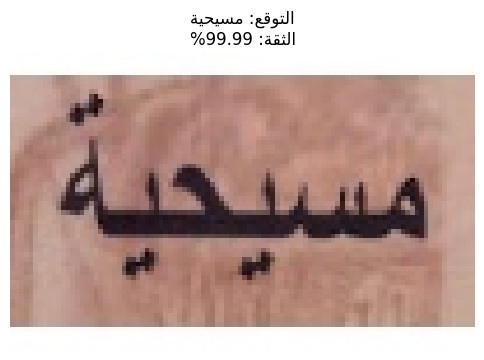

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (69).jpg


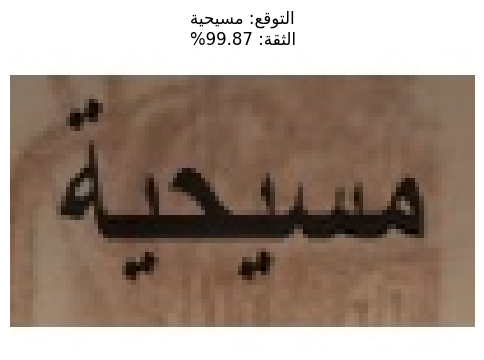

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (76).jpg


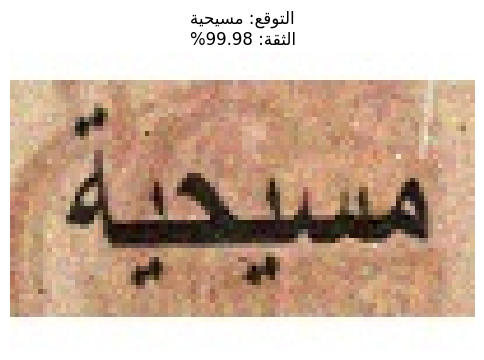

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (77).jpg


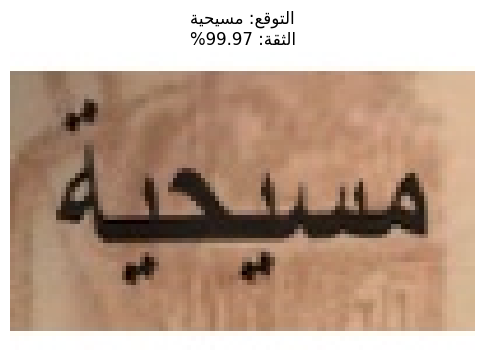

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (78).jpg


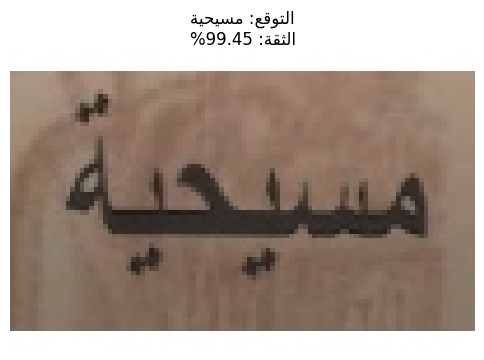

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (84).jpg


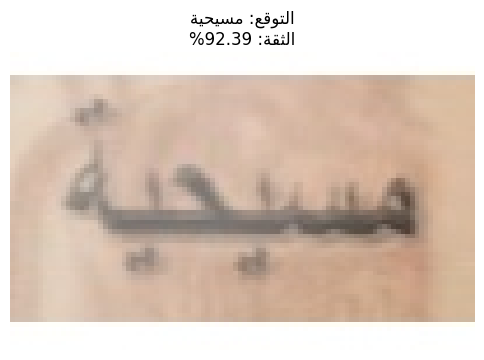

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (85).jpg


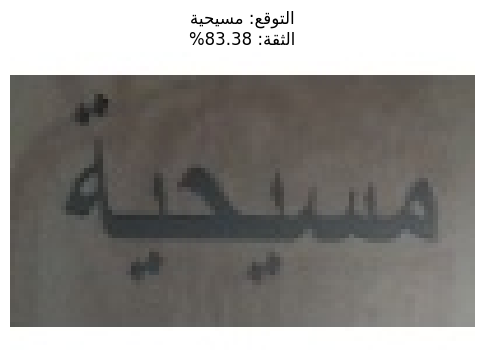

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (89).jpg


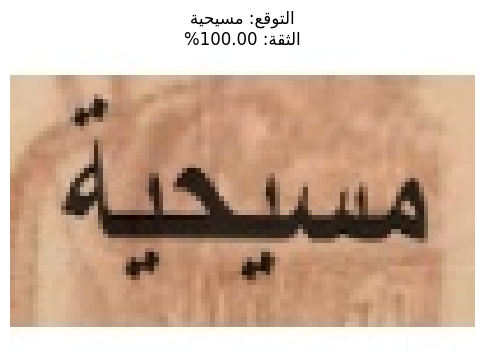

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (90).jpg


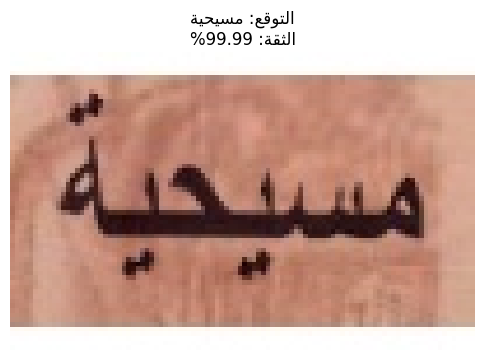

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (95).jpg


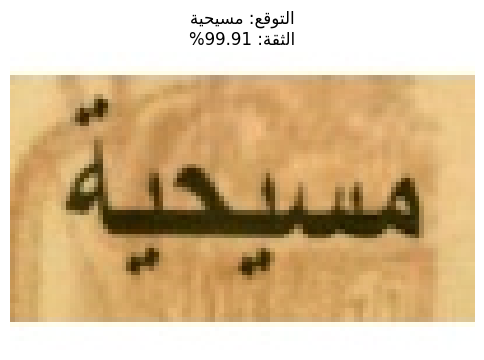

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_1kejr (98).jpg


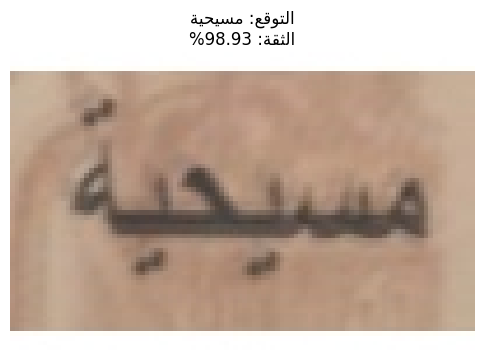

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_420_egypt_id_477_2.jpg


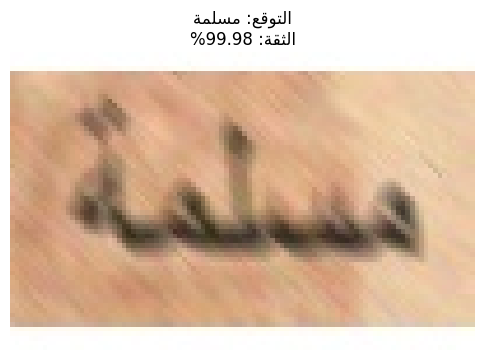

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_421_egypt_id_478_2.jpg


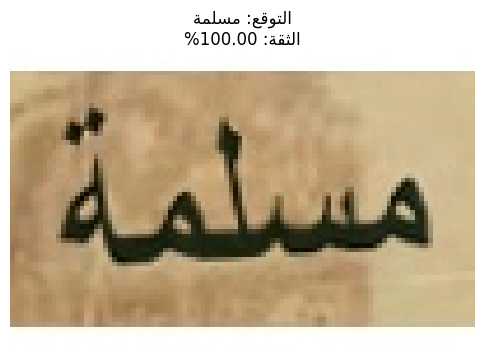

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_429_egypt_id_485_2.jpg


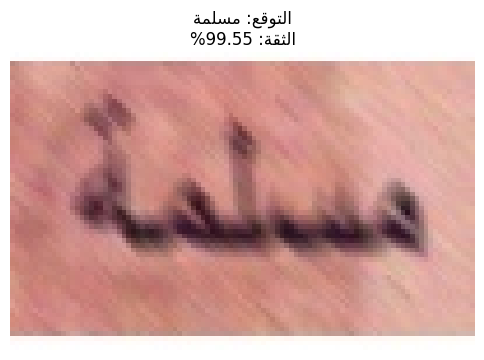

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_42_egypt_id_136_1.jpg


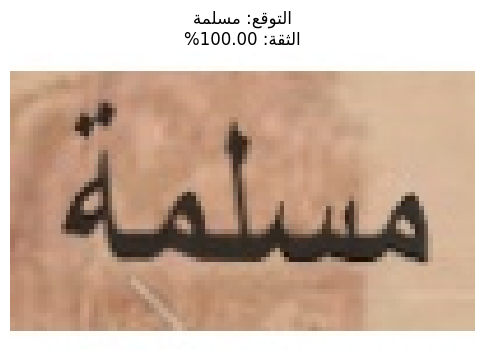

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_430_egypt_id_486_1.jpg


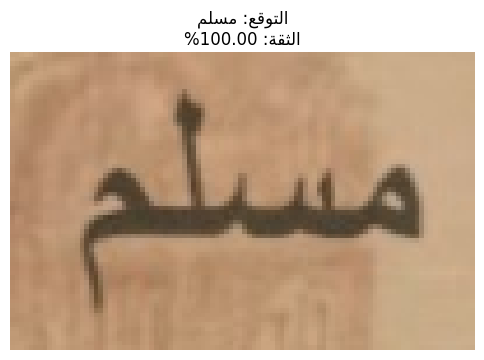

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_437_egypt_id_492_2.jpg


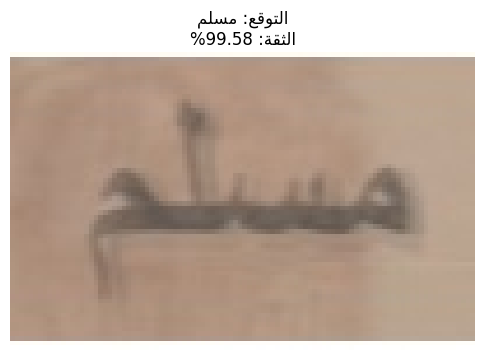

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_438_egypt_id_493_2.jpg


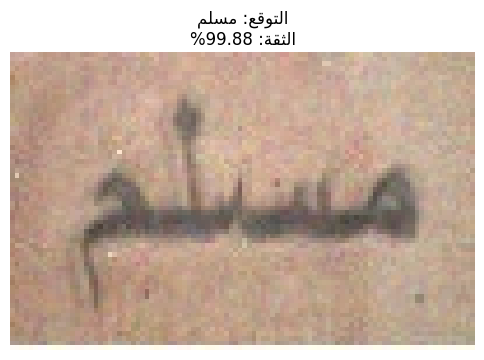

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_443_egypt_id_498_2.jpg


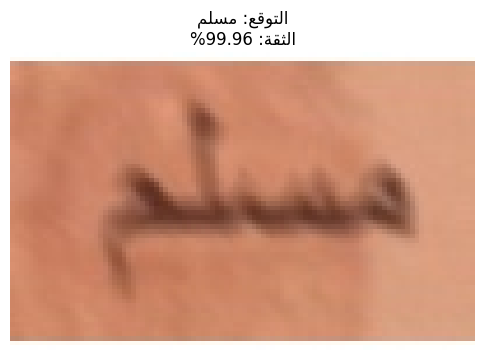

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_444_egypt_id_499_1.jpg


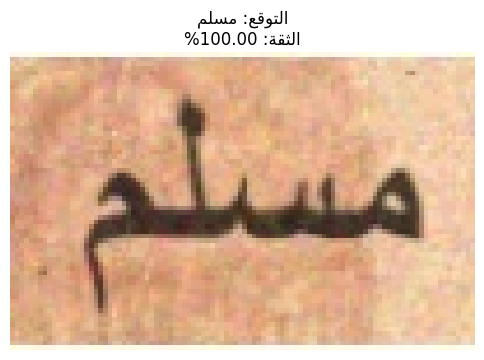

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_449_egypt_id_52_2.jpg


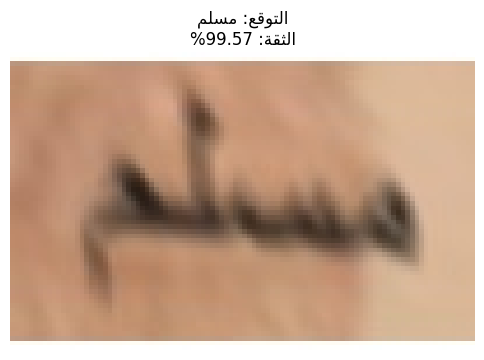

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_450_egypt_id_53_1.jpg


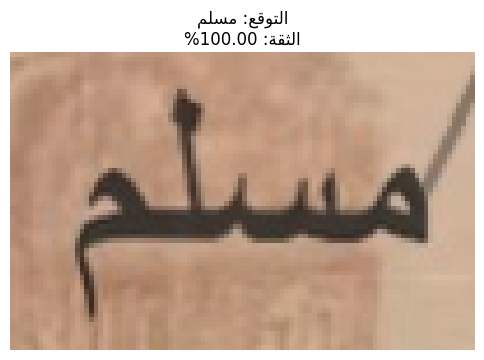

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_457_egypt_id_6_2.jpg


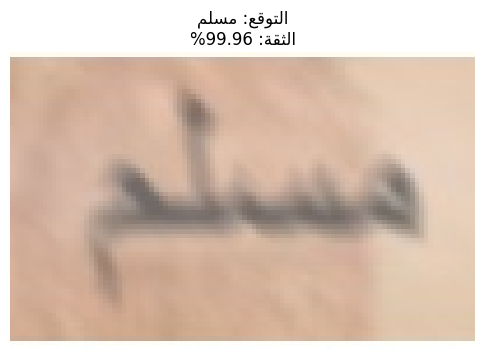

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_458_egypt_id_60_1.jpg


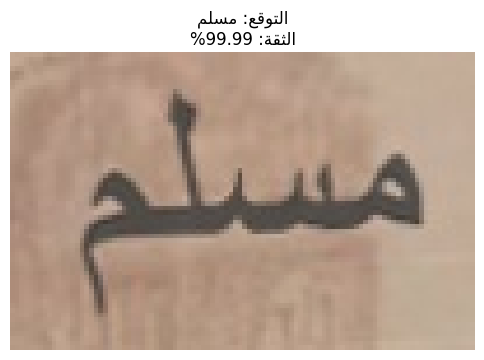

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_459_egypt_id_61_1.jpg


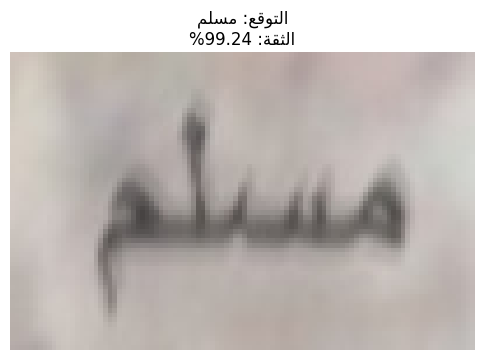

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_460_egypt_id_62_1.jpg


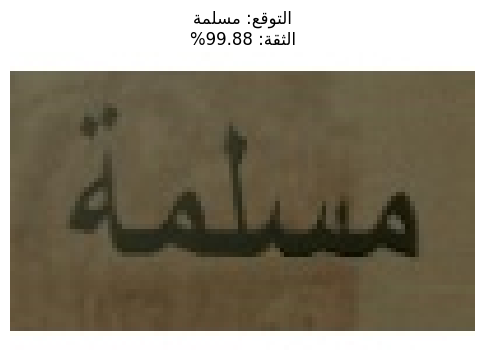

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_462_egypt_id_64_1.jpg


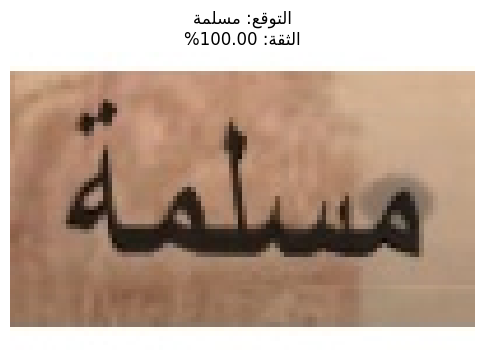

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_465_egypt_id_67_1.jpg


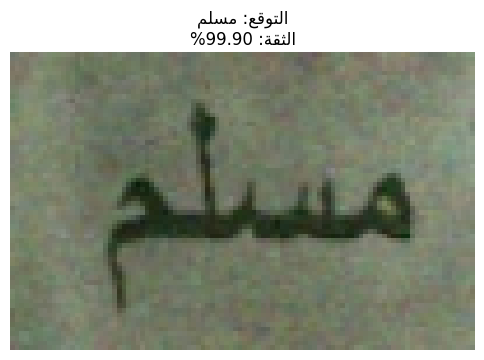

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_465_egypt_id_67_2.jpg


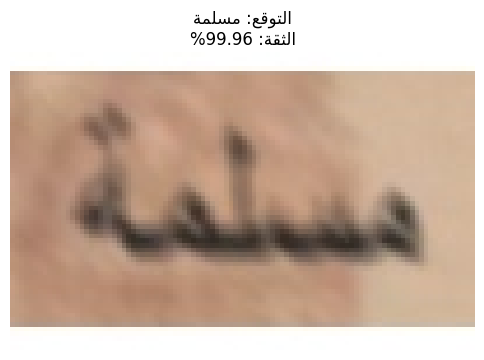

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_466_egypt_id_68_0.jpg


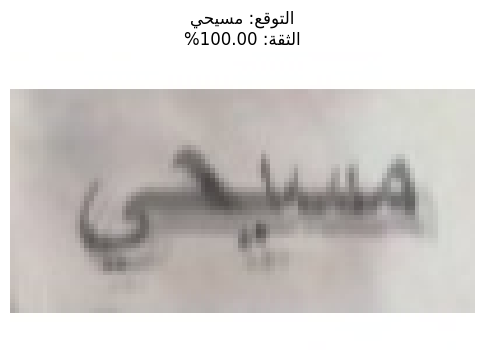

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_466_egypt_id_68_1.jpg


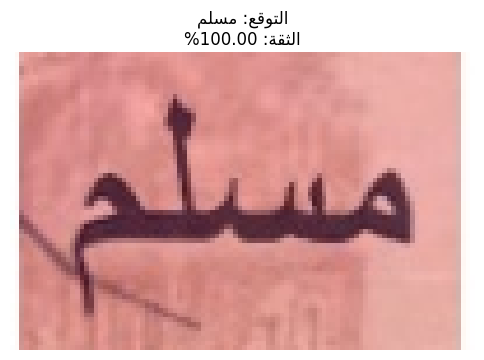

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_467_egypt_id_69_1.jpg


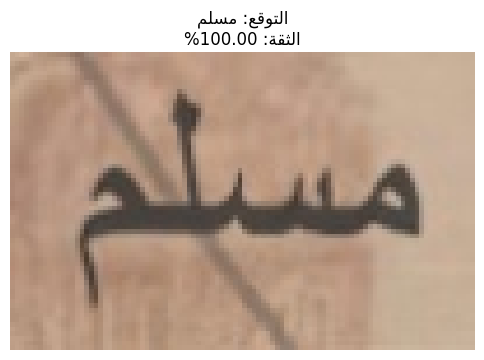

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_46_egypt_id_14_1.jpg


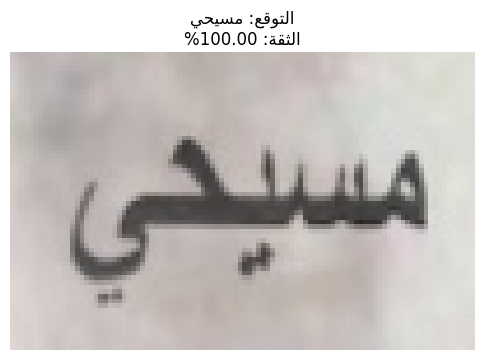

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_471_egypt_id_72_0.jpg


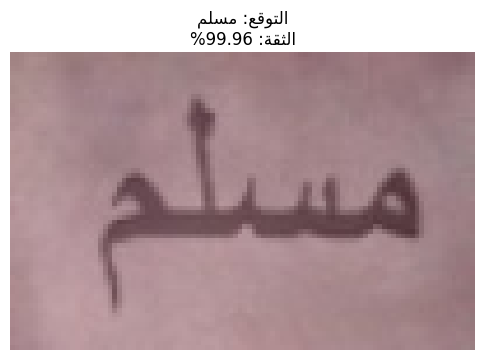

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_474_egypt_id_75_2.jpg


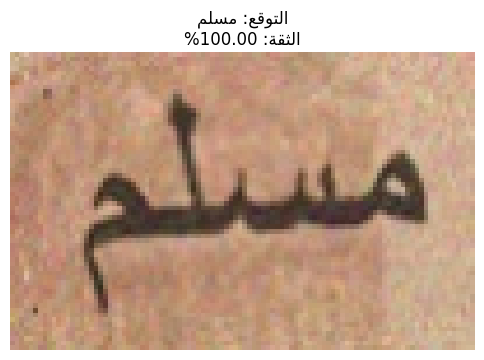

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_475_egypt_id_76_1.jpg


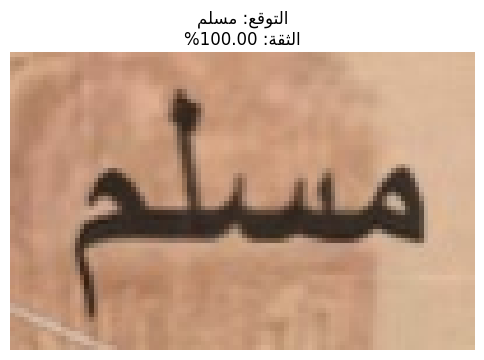

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_480_egypt_id_80_0.jpg


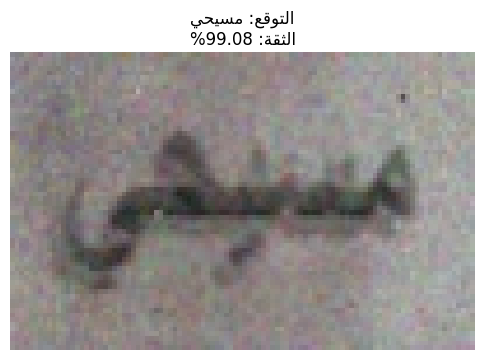

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_481_egypt_id_81_1.jpg


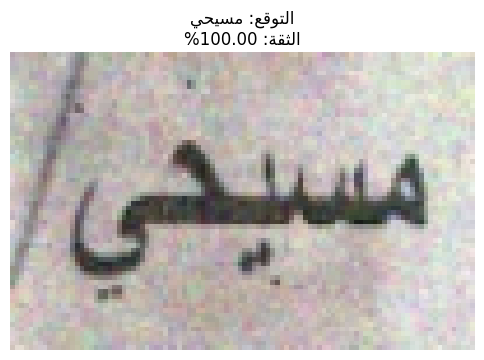

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_482_egypt_id_82_1.jpg


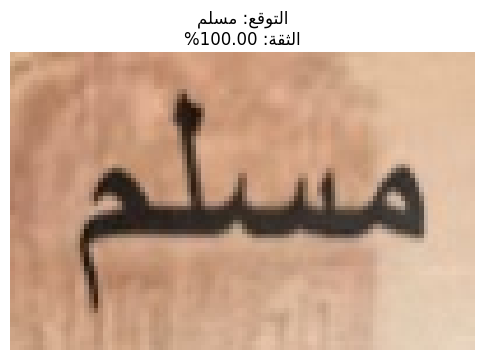

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_483_egypt_id_83_0.jpg


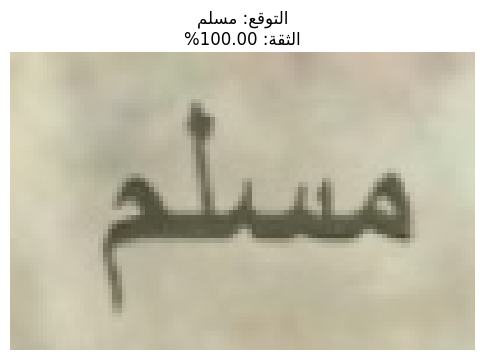

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_483_egypt_id_83_2.jpg


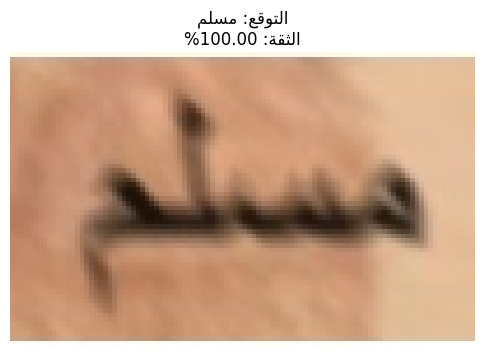

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_486_egypt_id_86_0.jpg


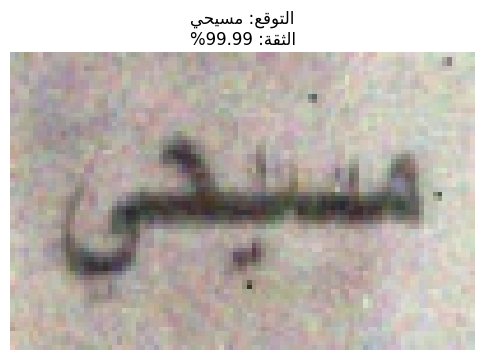

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_486_egypt_id_86_2.jpg


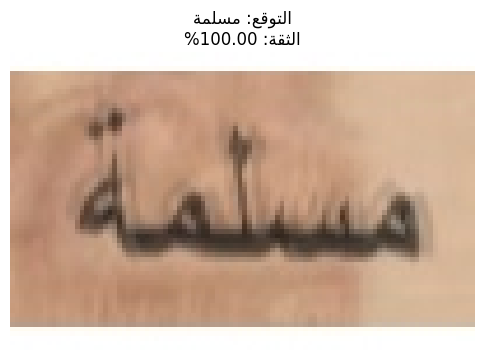

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_487_egypt_id_87_1.jpg


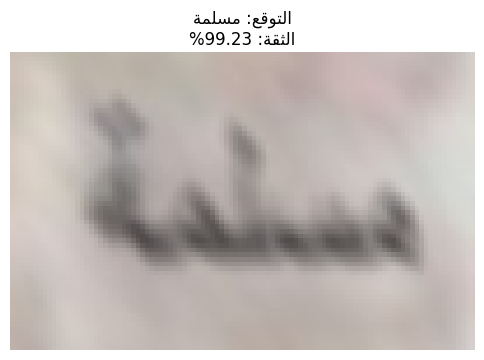

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_487_egypt_id_87_2.jpg


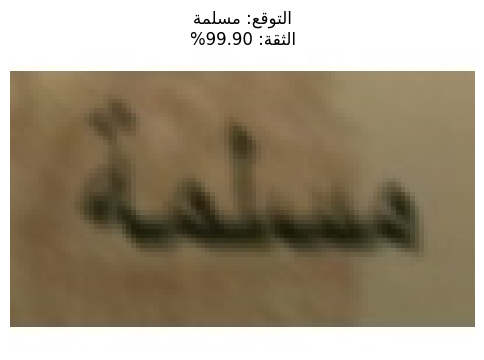

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_488_egypt_id_88_1.jpg


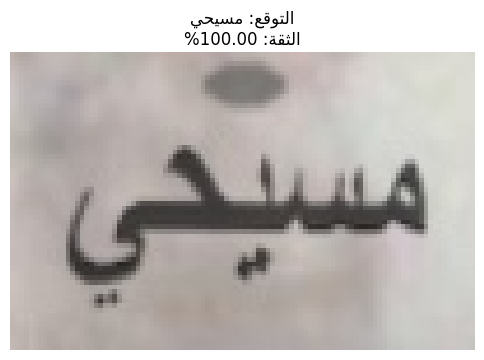

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_489_egypt_id_89_0.jpg


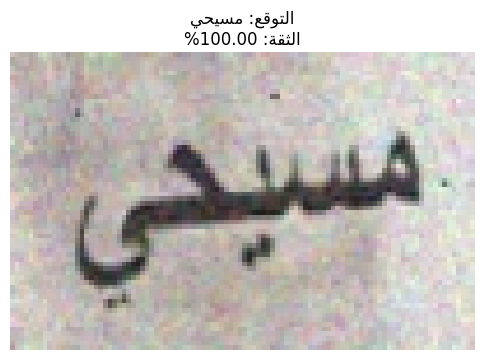

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_48_egypt_id_141_2.jpg


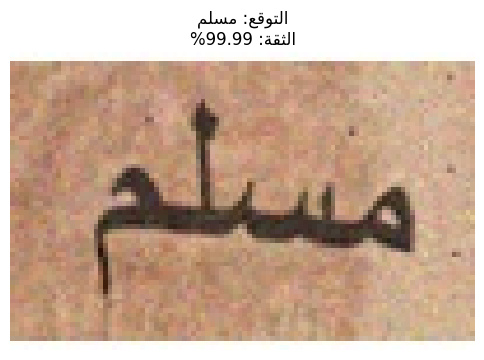

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_490_egypt_id_9_1.jpg


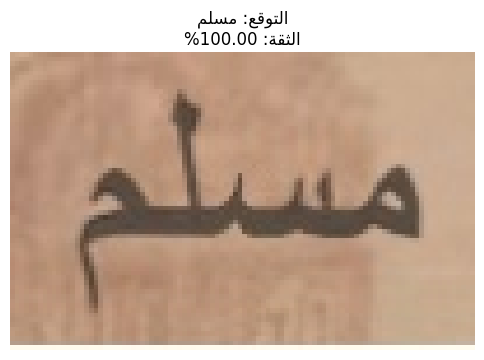

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_491_egypt_id_90_2.jpg


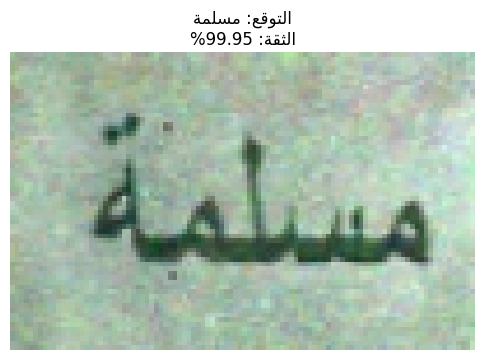

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_492_egypt_id_91_1.jpg


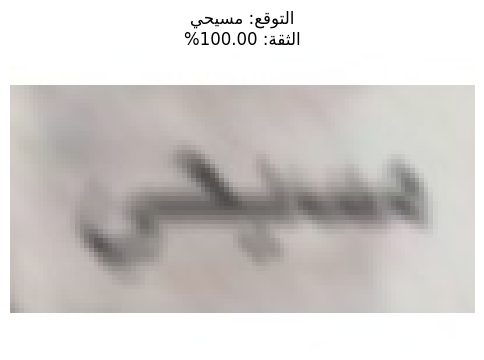

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_493_egypt_id_92_0.jpg


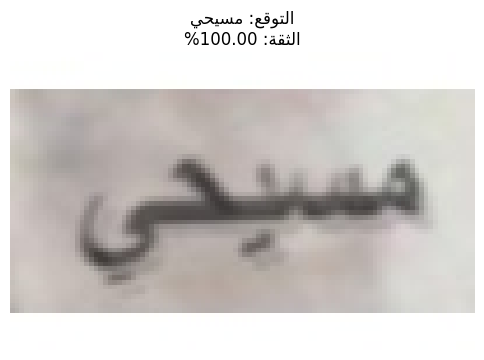

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_494_egypt_id_93_1.jpg


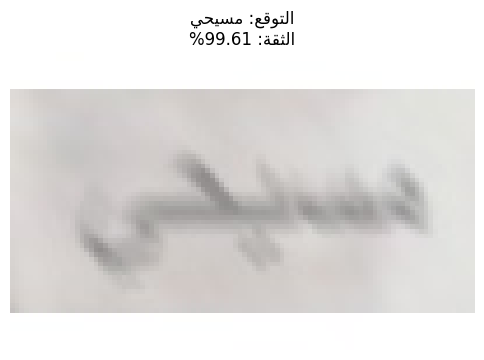

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_495_egypt_id_94_0.jpg


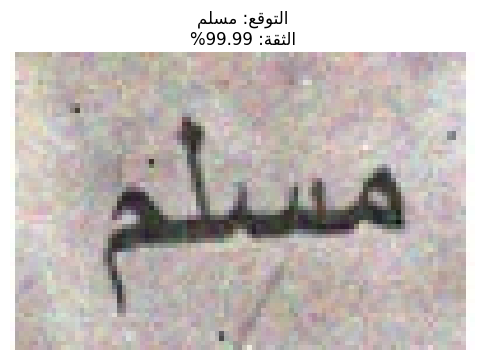

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_495_egypt_id_94_1.jpg


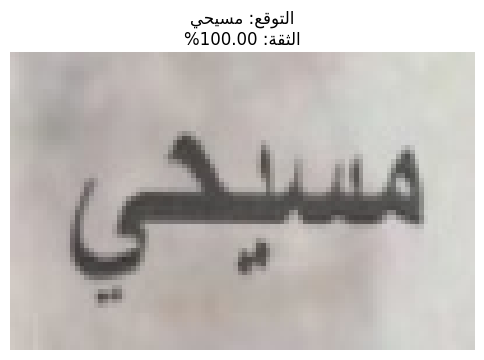

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_496_egypt_id_95_1.jpg


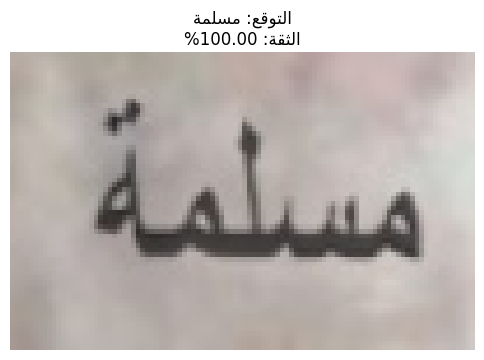

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_496_egypt_id_95_2.jpg


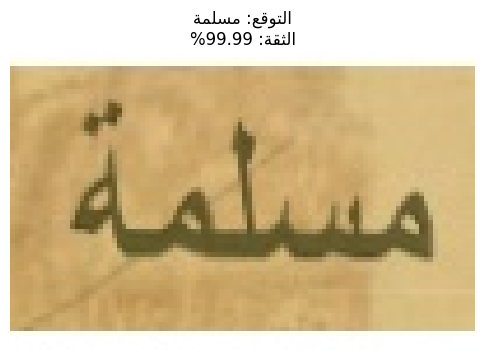

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_497_egypt_id_96_2.jpg


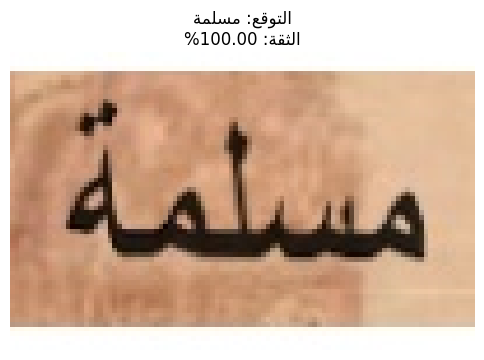

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_4_egypt_id_101_1.jpg


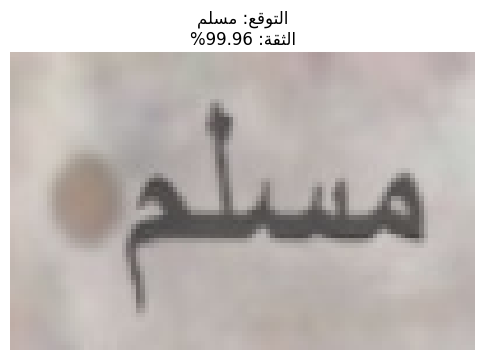

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_4_egypt_id_101_2.jpg


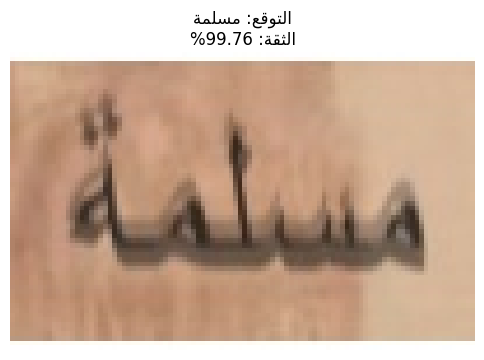

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_52_egypt_id_145_1.jpg


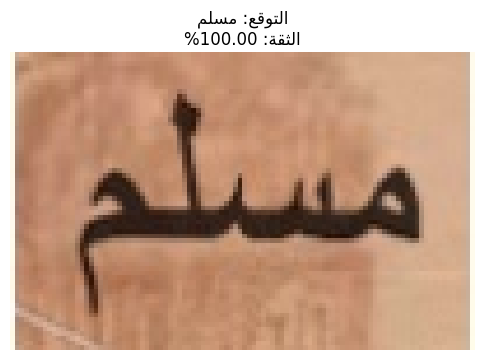

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_53_egypt_id_146_1.jpg


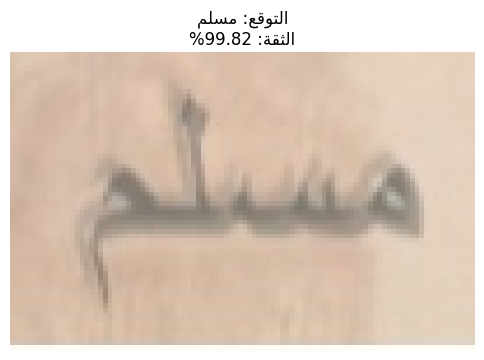

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_54_egypt_id_147_1.jpg


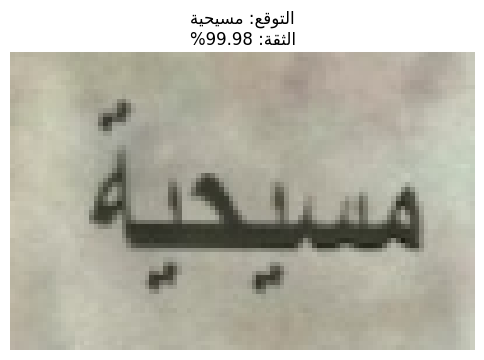

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_55_egypt_id_148_2.jpg


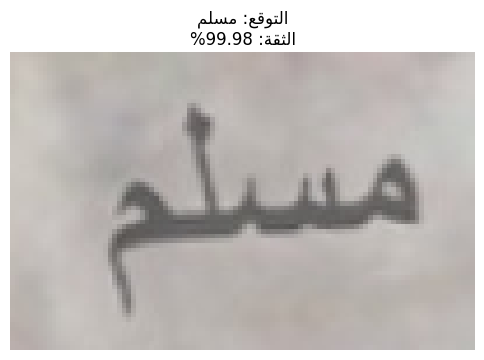

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_56_egypt_id_149_1.jpg


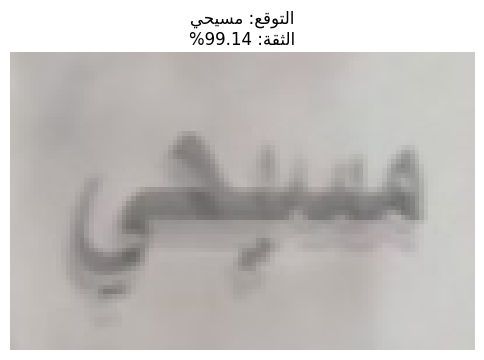

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_57_egypt_id_15_1.jpg


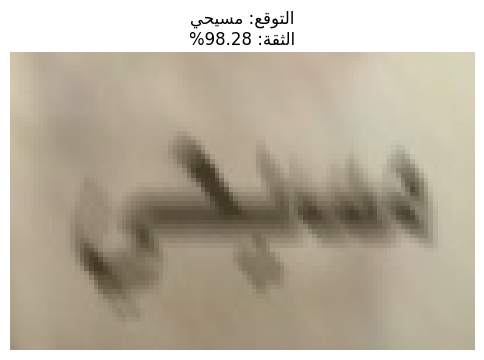

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_58_egypt_id_150_0.jpg


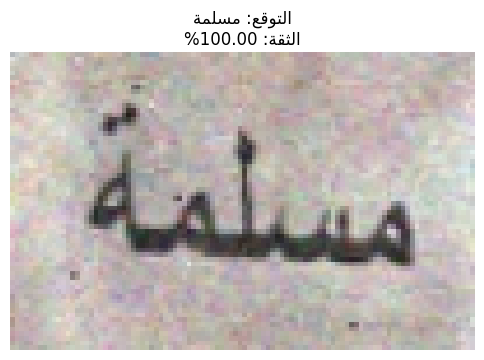

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_58_egypt_id_150_2.jpg


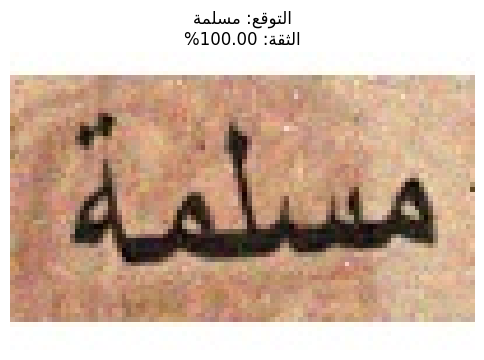

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_59_egypt_id_151_1.jpg


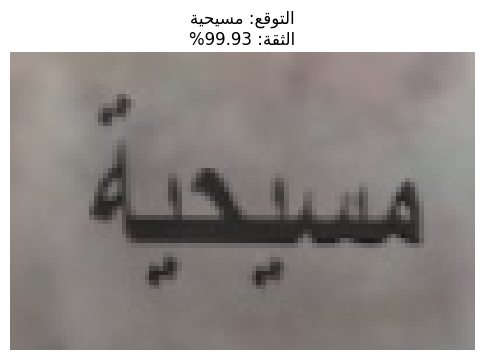

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_60_egypt_id_152_0.jpg


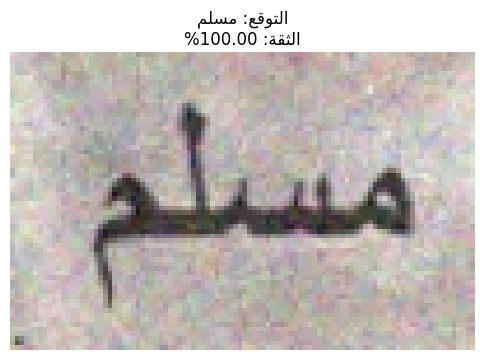

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_60_egypt_id_152_1.jpg


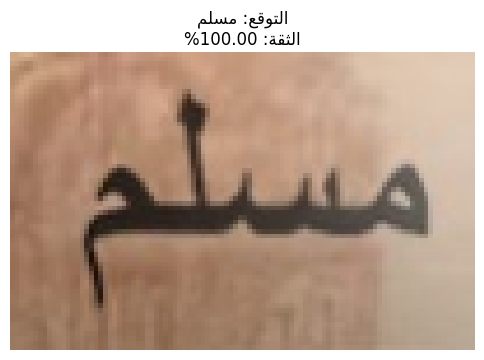

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_61_egypt_id_153_1.jpg


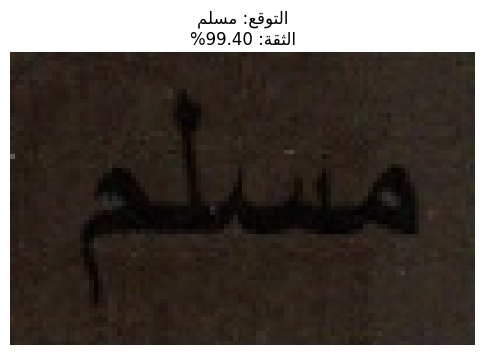

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_62_egypt_id_154_1.jpg


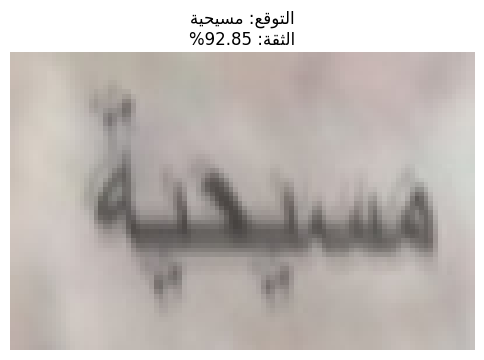

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_62_egypt_id_154_2.jpg


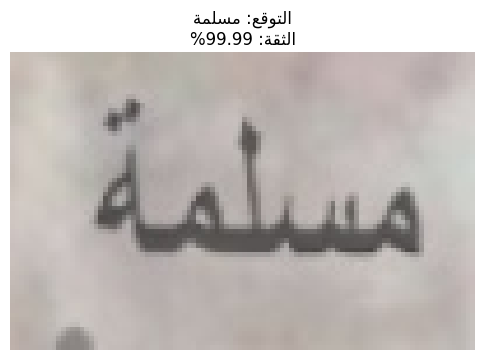

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_63_egypt_id_155_1.jpg


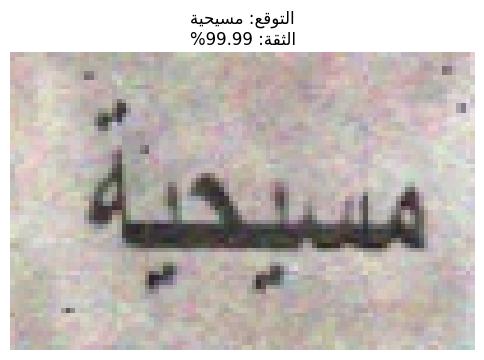

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_66_egypt_id_158_1.jpg


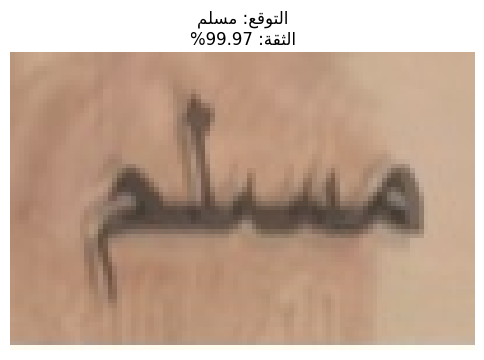

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_67_egypt_id_159_0.jpg


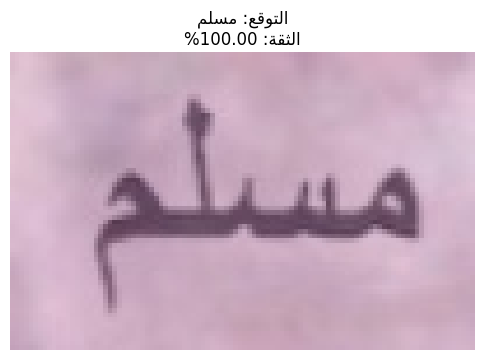

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_67_egypt_id_159_1.jpg


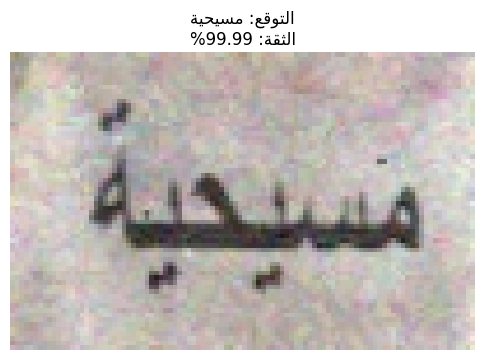

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_67_egypt_id_159_2.jpg


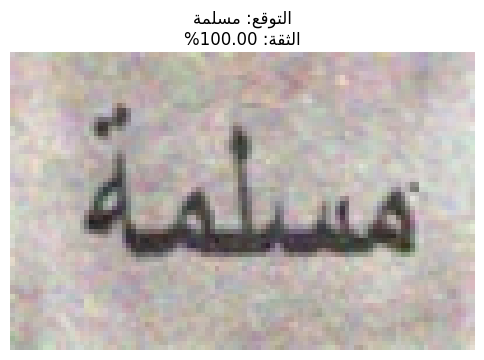

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_68_egypt_id_16_0.jpg


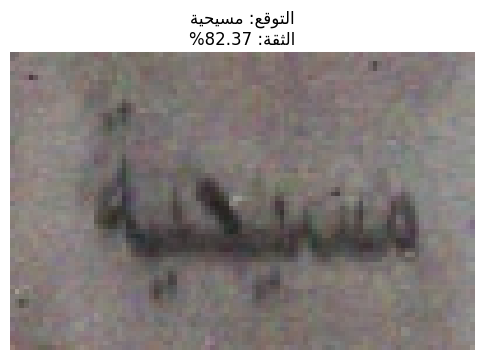

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_68_egypt_id_16_1.jpg


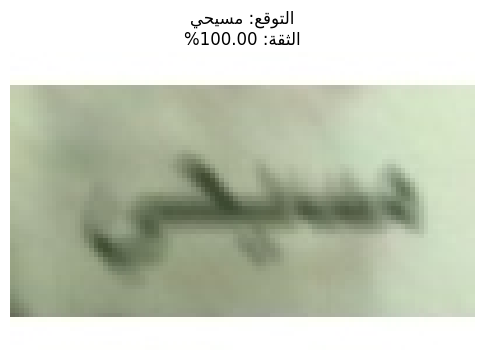

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_69_egypt_id_160_1.jpg


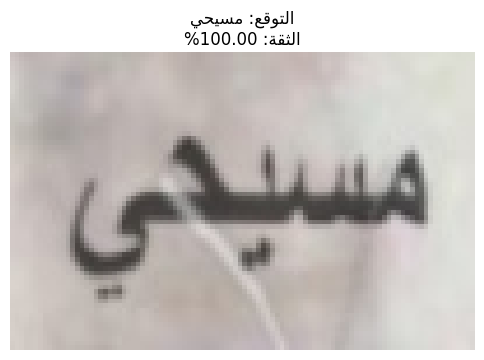

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_6_egypt_id_103_1.jpg


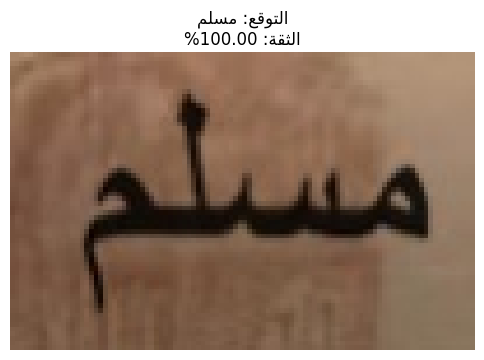

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_70_egypt_id_161_1.jpg


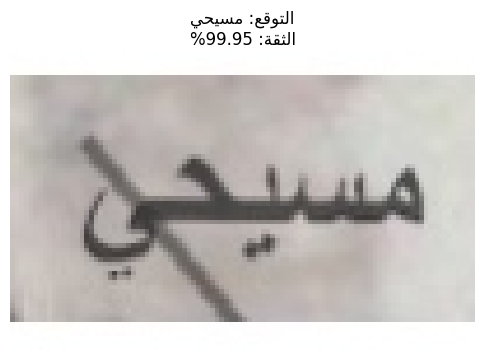

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_71_egypt_id_162_0.jpg


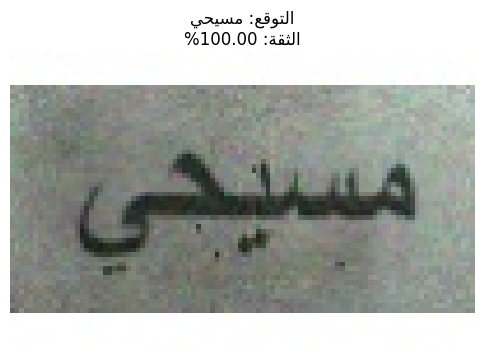

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_71_egypt_id_162_1.jpg


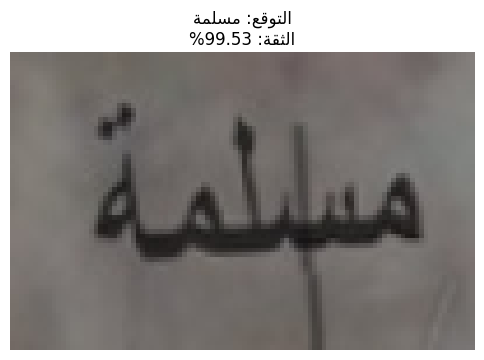

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_71_egypt_id_162_2.jpg


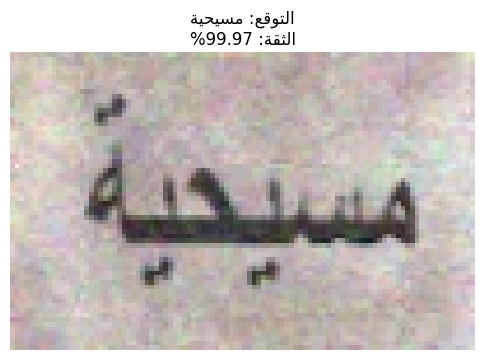

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_75_egypt_id_166_1.jpg


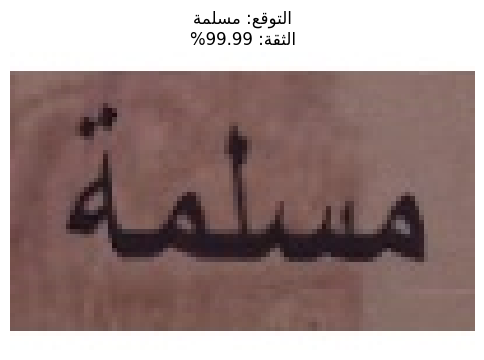

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_0.jpg


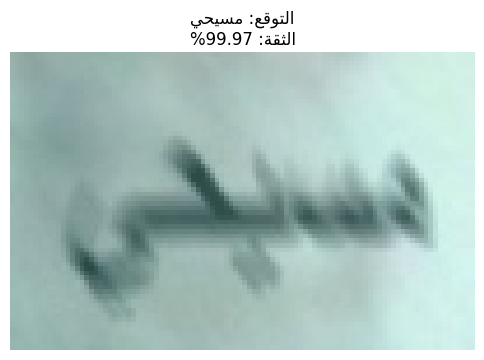

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1.jpg


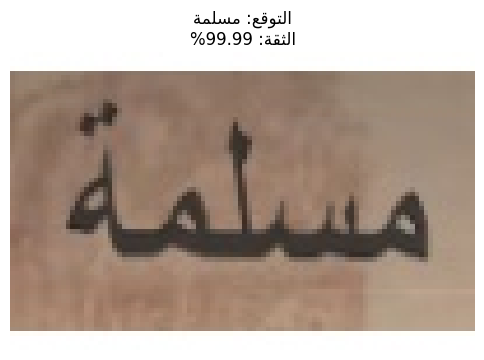

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (10).jpg


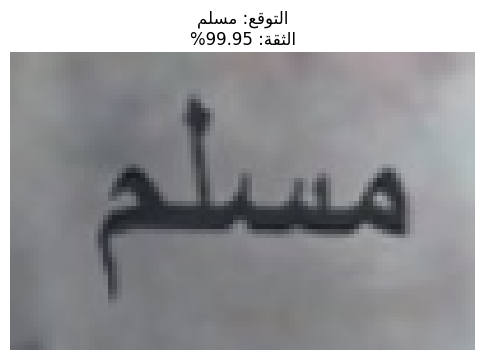

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (17).jpg


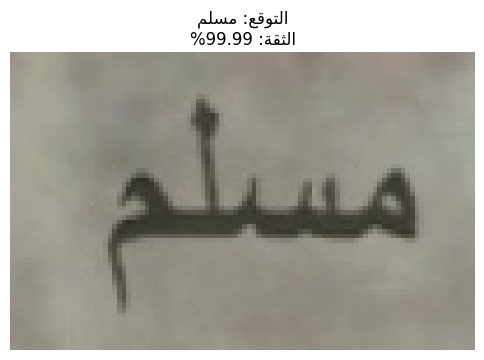

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (2).jpg


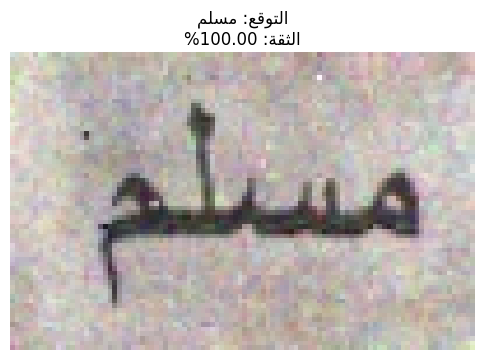

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (24).jpg


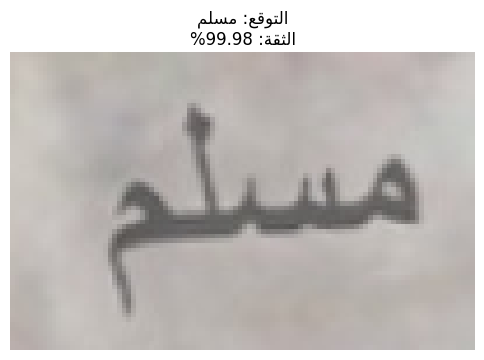

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (3).jpg


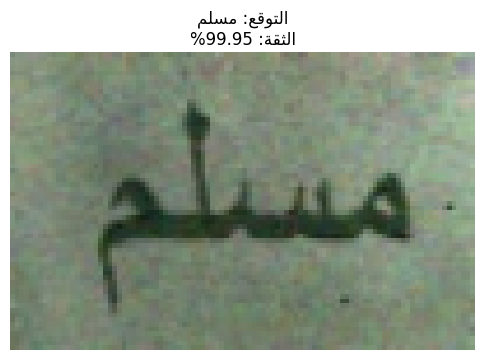

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (31).jpg


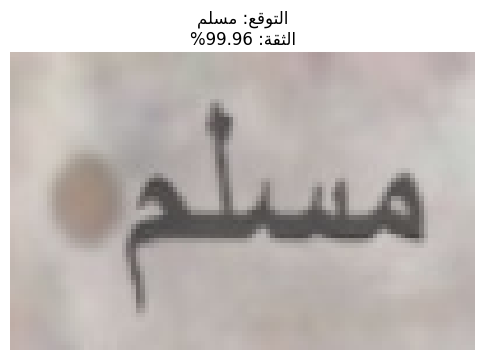

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (38).jpg


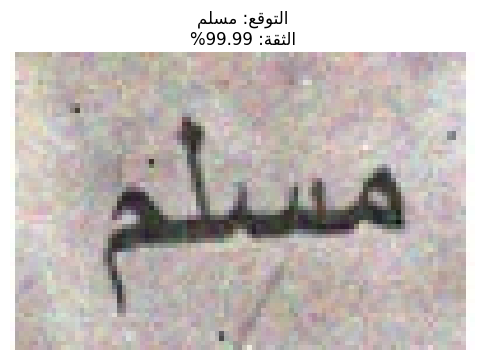

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (45).jpg


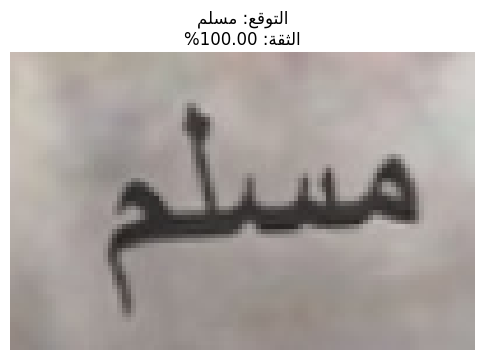

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (46).jpg


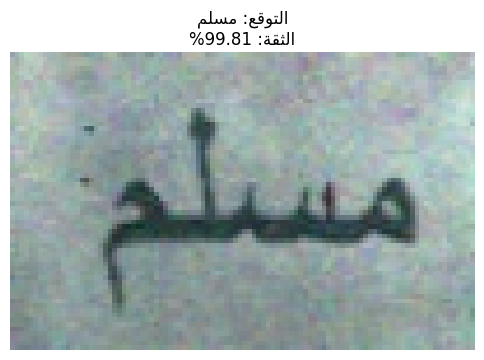

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (479).jpg


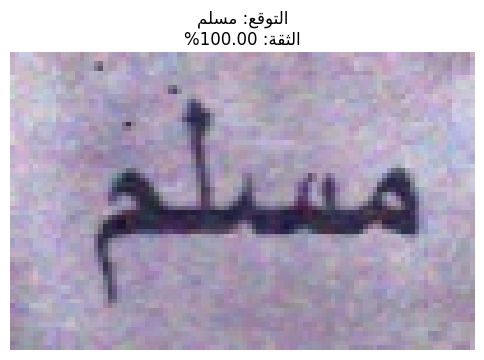

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (485).jpg


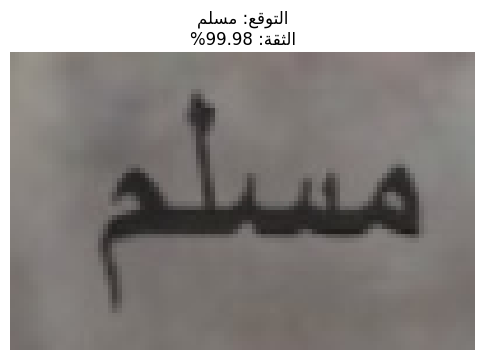

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (486).jpg


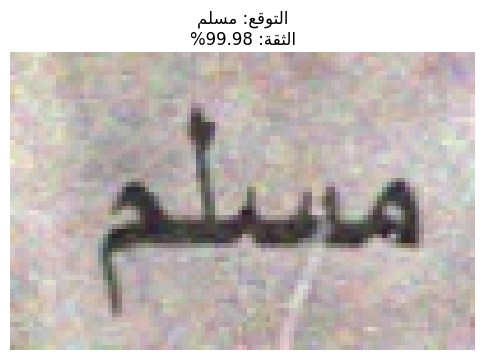

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (492).jpg


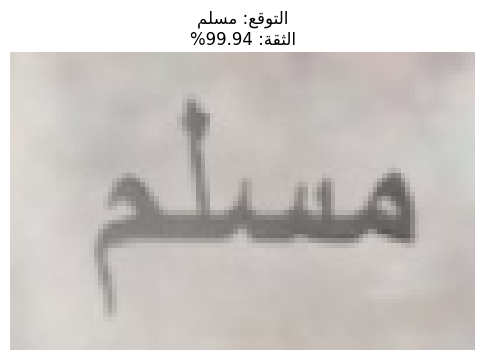

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (51).jpg


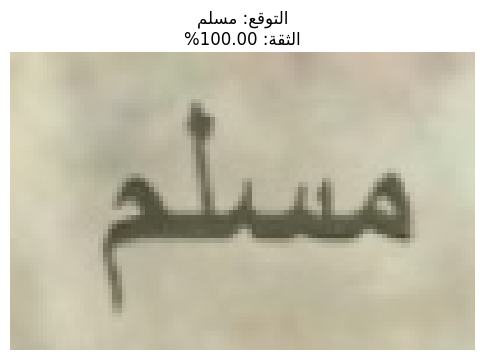

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (57).jpg


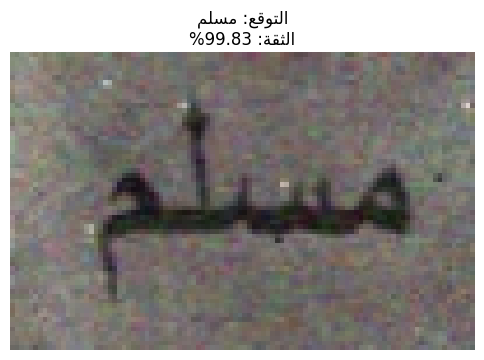

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (58).jpg


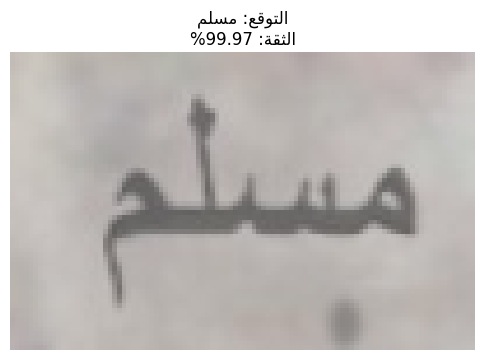

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (64).jpg


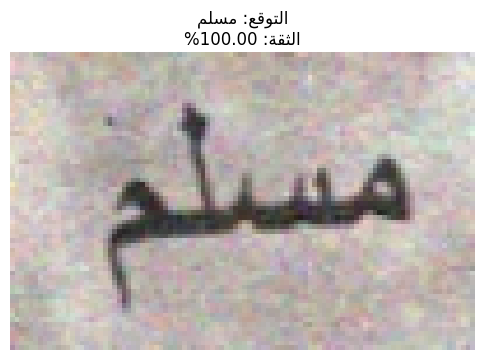

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (70).jpg


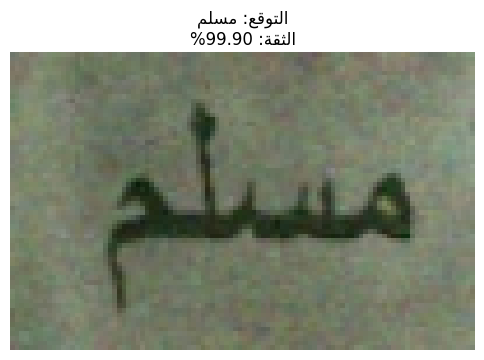

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_1فخفخ (77).jpg


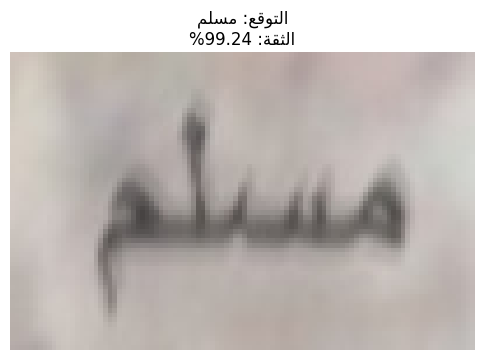

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2.jpg


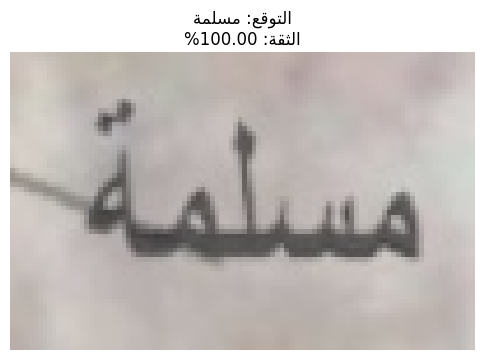

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (1).jpg


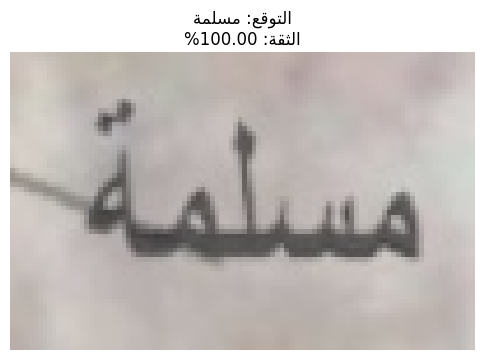

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (11).jpg


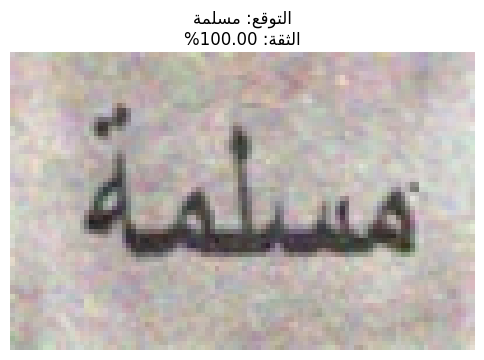

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (16).jpg


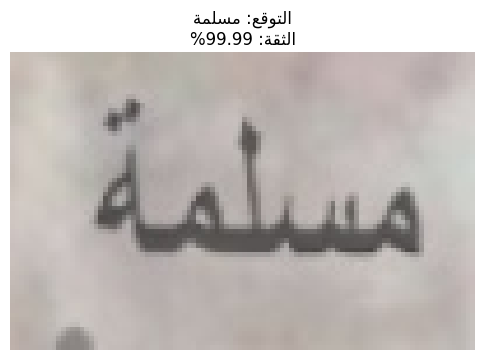

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (21).jpg


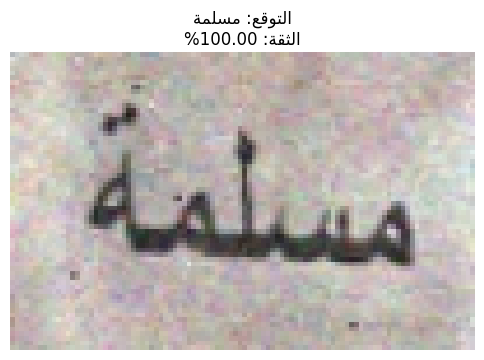

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (26).jpg


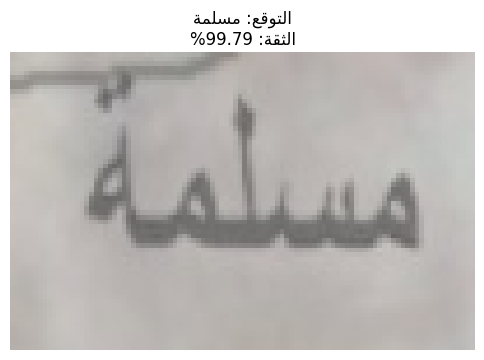

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (31).jpg


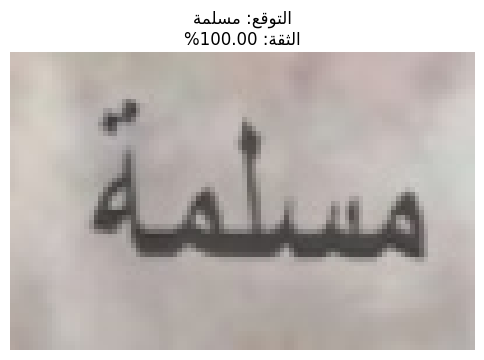

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (36).jpg


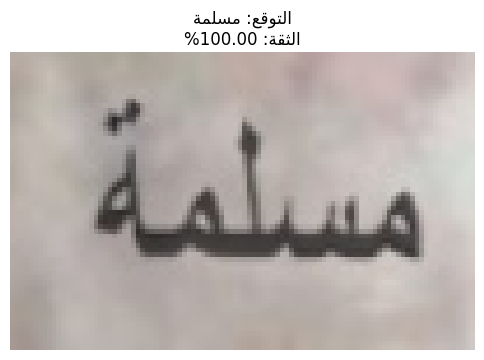

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (41).jpg


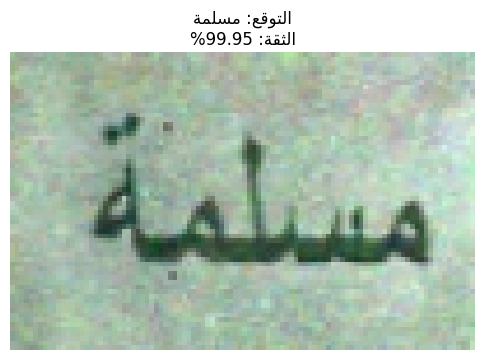

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (46).jpg


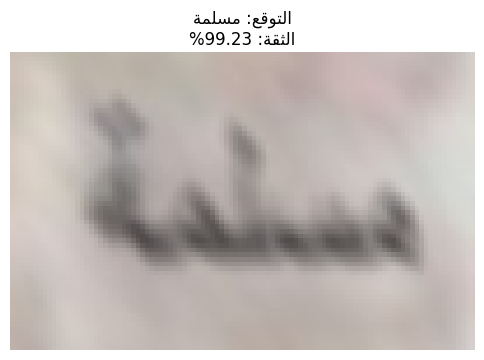

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (478).jpg


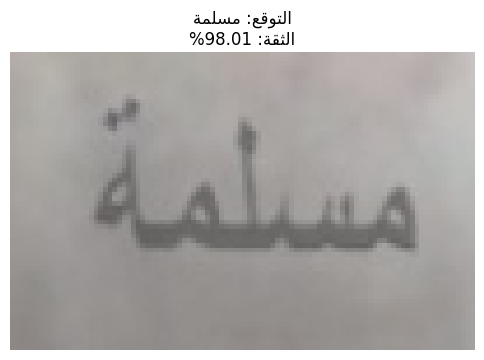

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (483).jpg


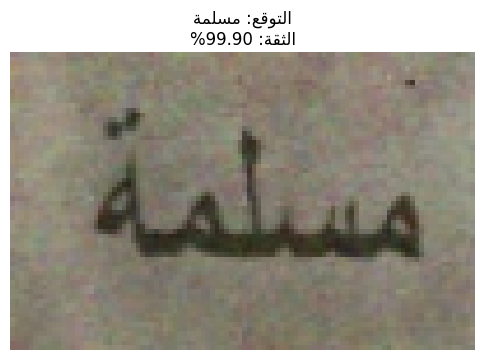

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (488).jpg


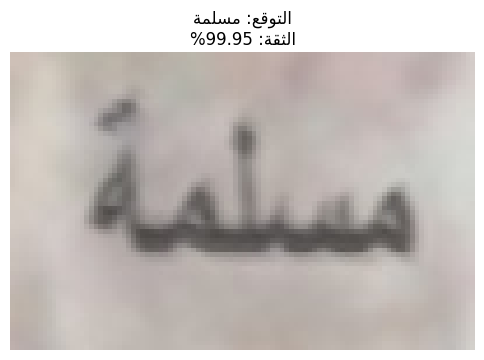

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (493).jpg


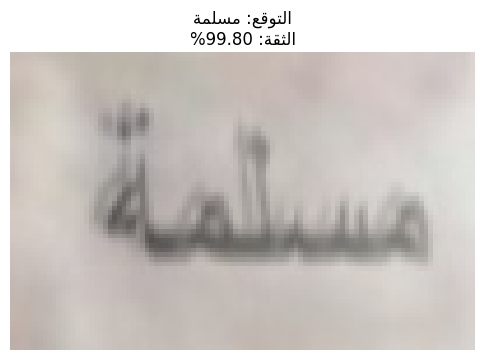

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (498).jpg


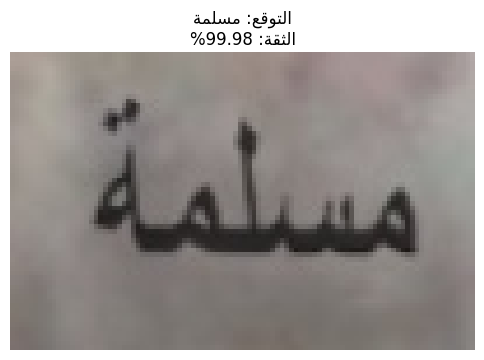

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (51).jpg


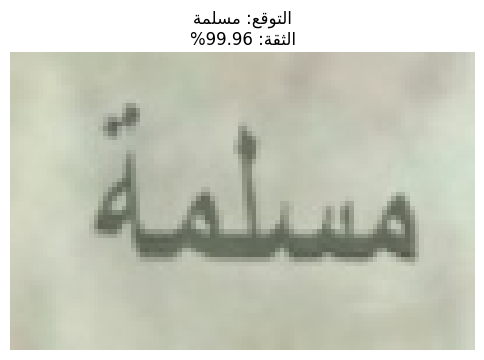

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_76_egypt_id_167_2سشمثثة (6).jpg


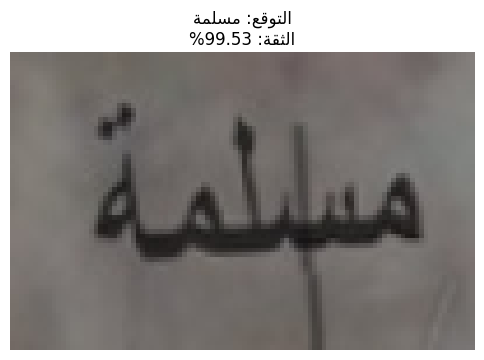

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_77_egypt_id_168_1.jpg


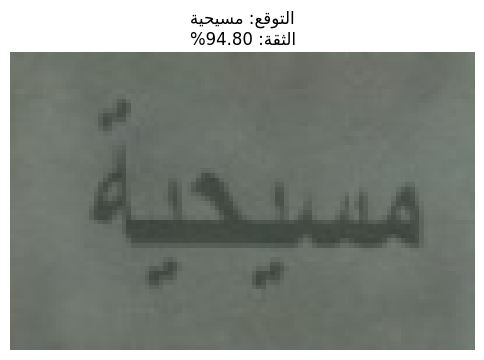

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_78_egypt_id_169_1.jpg


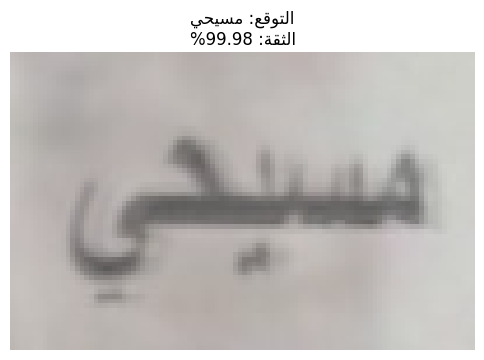

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_7_egypt_id_104_0.jpg


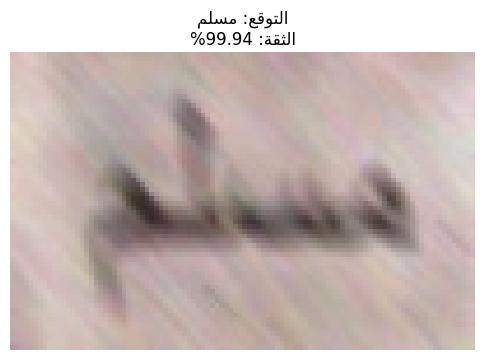

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_80_egypt_id_170_0.jpg


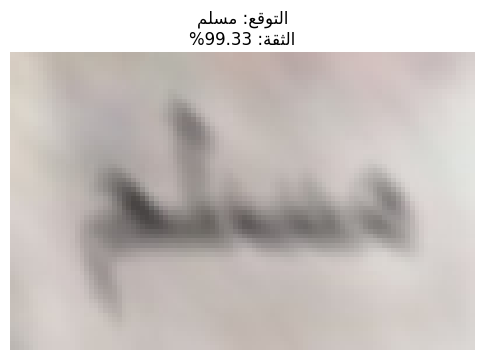

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_80_egypt_id_170_1.jpg


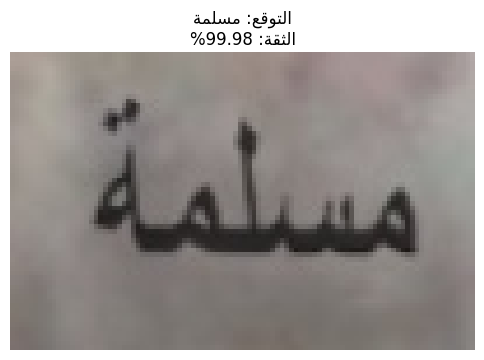

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_81_egypt_id_171_1.jpg


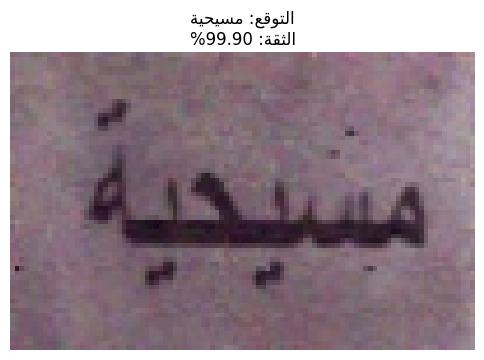

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_83_egypt_id_173_0.jpg


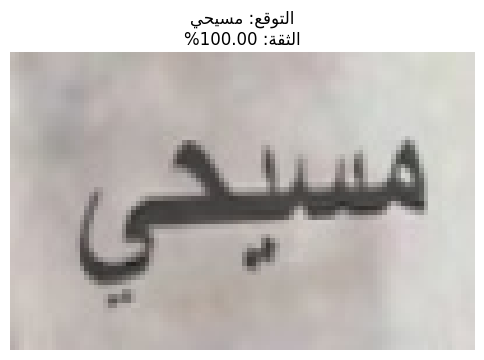

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_84_egypt_id_174_0.jpg


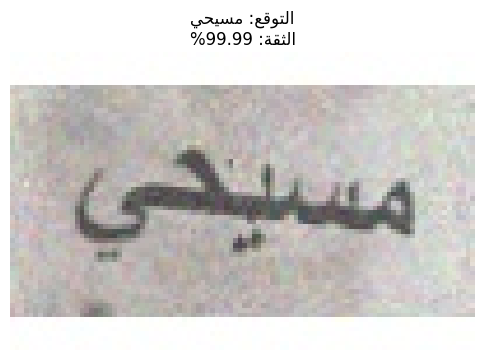

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_85_egypt_id_175_0.jpg


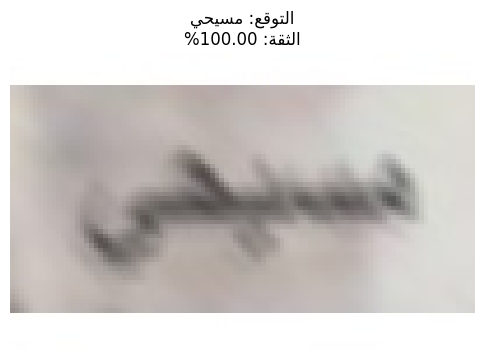

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_85_egypt_id_175_1.jpg


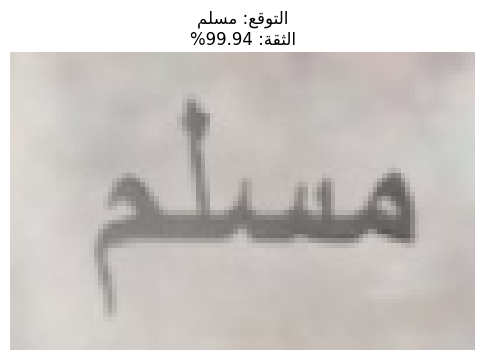

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_85_egypt_id_175_2.jpg


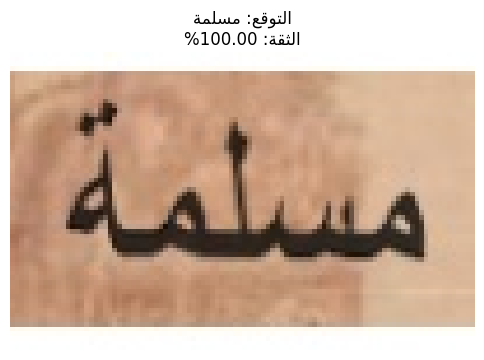

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_86_egypt_id_176_0.jpg


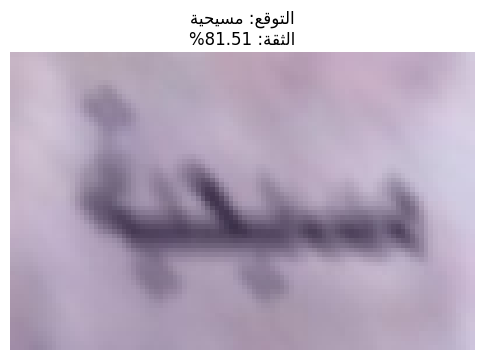

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_86_egypt_id_176_1.jpg


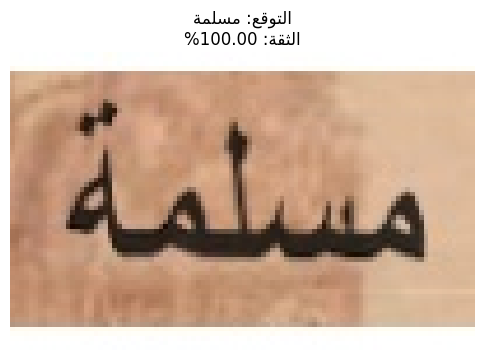

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1.jpg


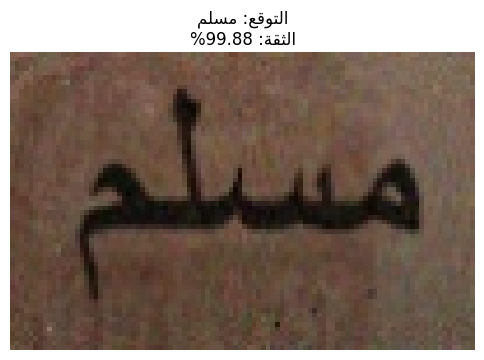

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1كوكو (12).jpg


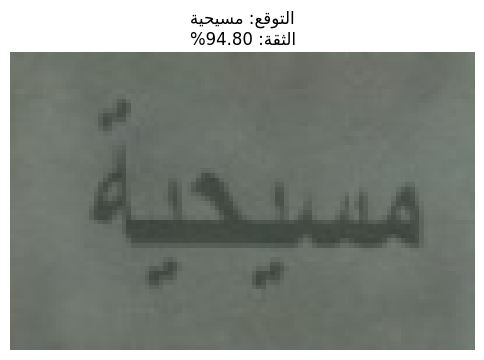

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1كوكو (16).jpg


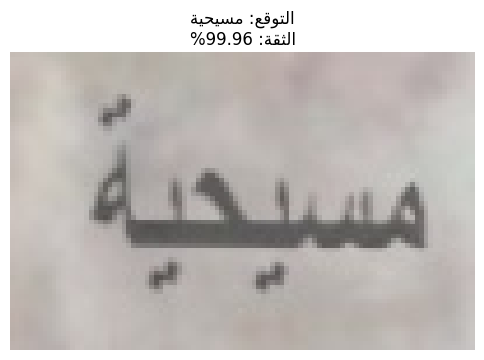

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1كوكو (17).jpg


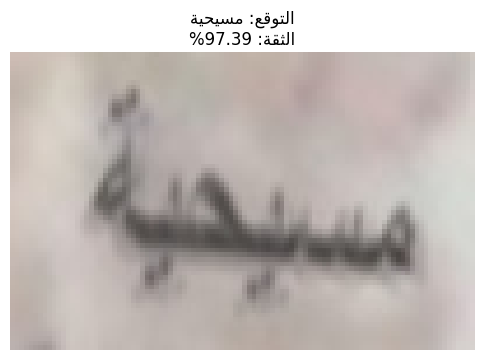

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1كوكو (2).jpg


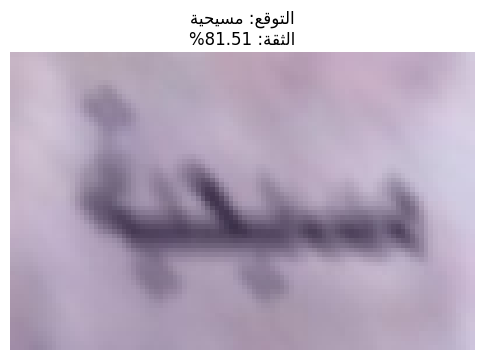

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1كوكو (22).jpg


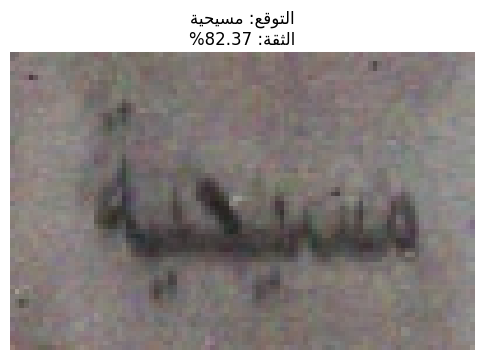

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1كوكو (27).jpg


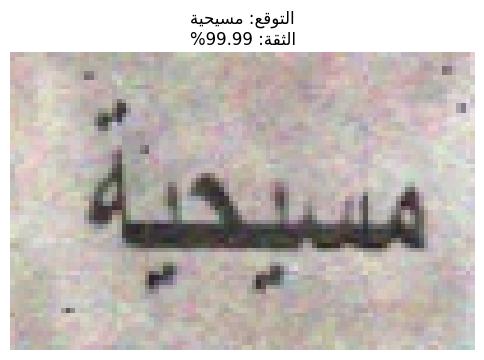

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1كوكو (32).jpg


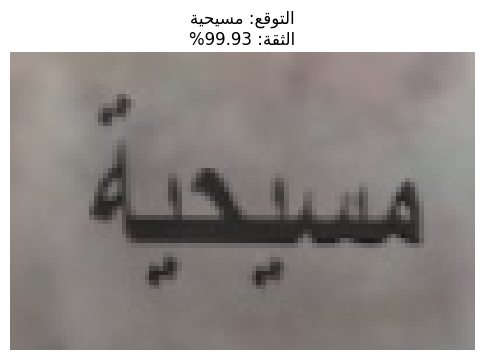

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1كوكو (37).jpg


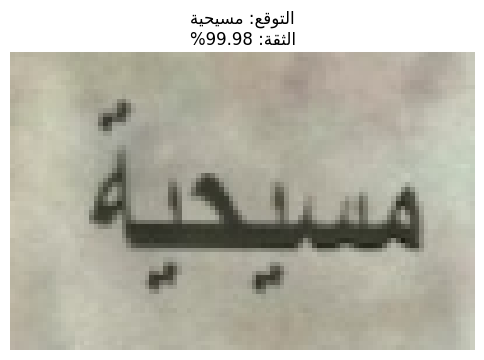

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1كوكو (488).jpg


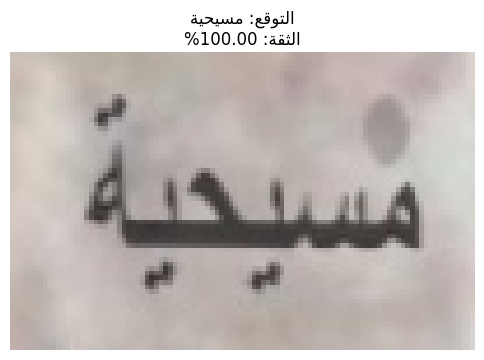

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1كوكو (489).jpg


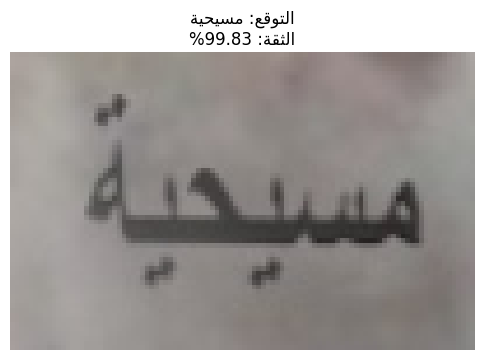

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1كوكو (493).jpg


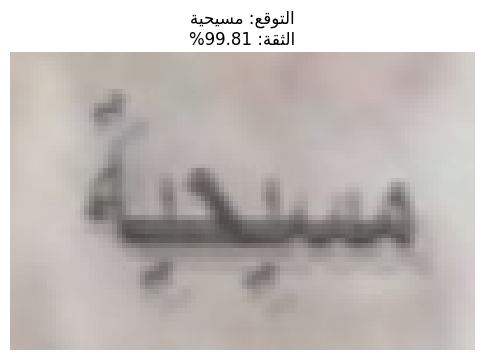

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1كوكو (494).jpg


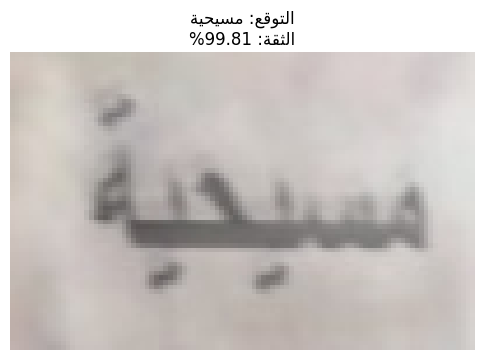

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1كوكو (498).jpg


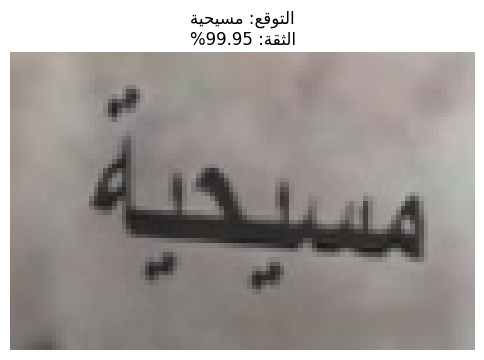

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_87_egypt_id_177_1كوكو (7).jpg


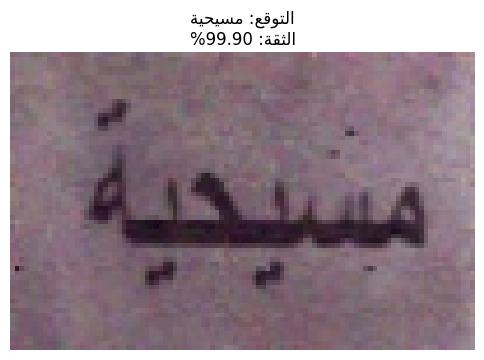

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_88_egypt_id_178_2.jpg


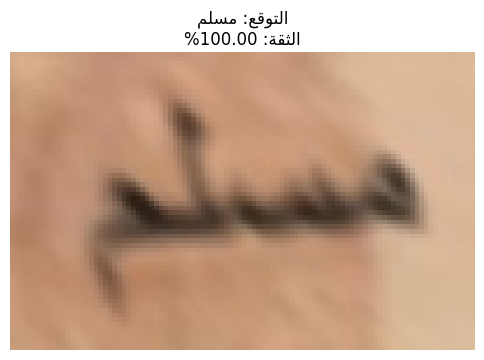

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_8_egypt_id_105_0.jpg


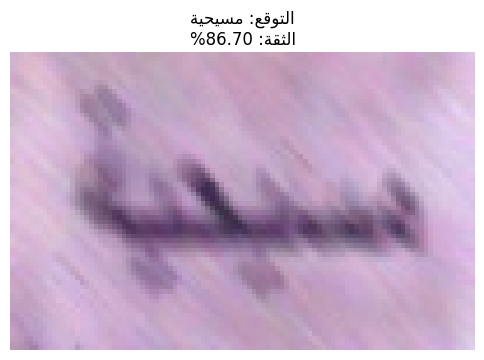

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_8_egypt_id_105_1.jpg


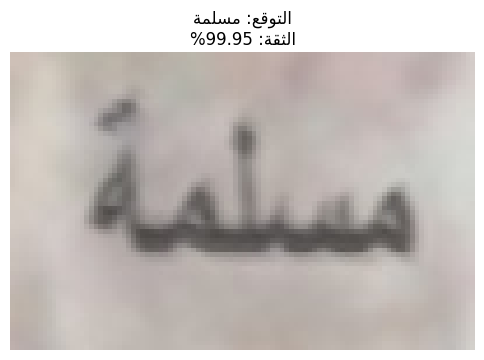

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_90_egypt_id_18_1.jpg


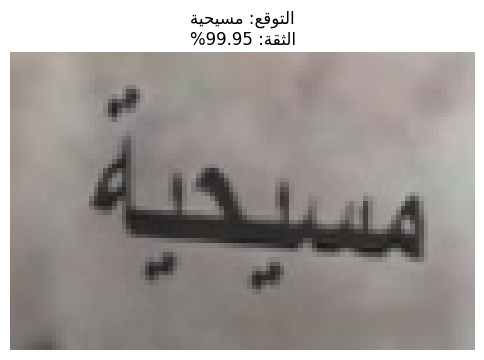

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_92_egypt_id_181_2.jpg


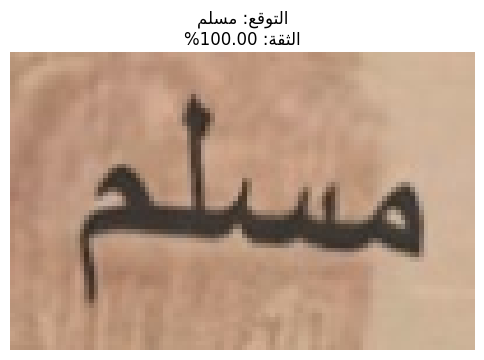

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_93_egypt_id_182_1.jpg


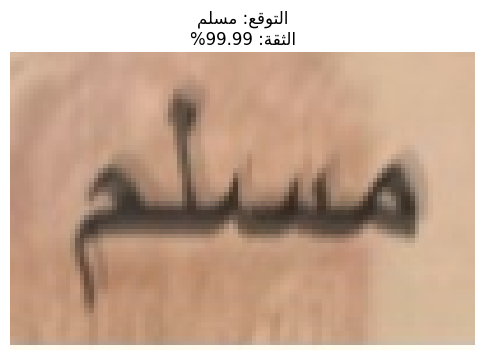

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_94_egypt_id_183_1.jpg


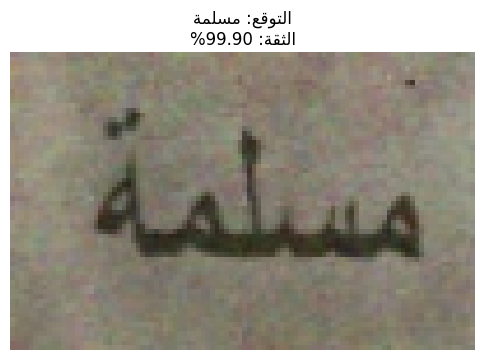

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_95_egypt_id_184_1.jpg


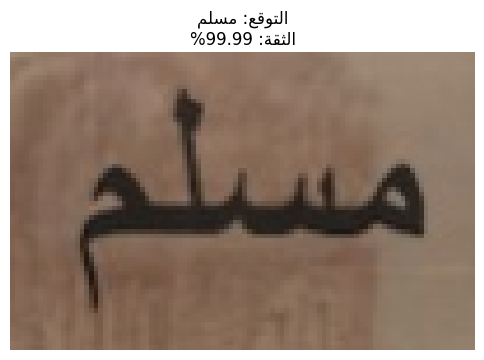

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_96_egypt_id_185_2.jpg


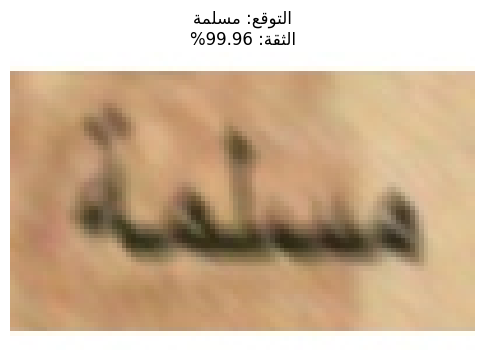

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_97_egypt_id_186_0.jpg


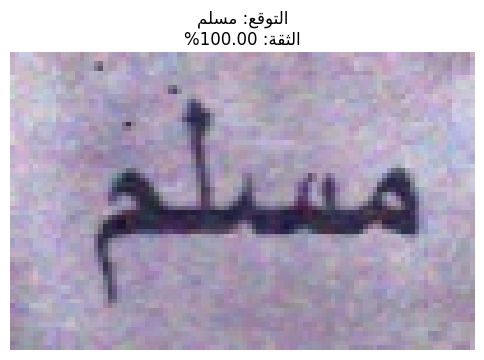

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_97_egypt_id_186_1.jpg


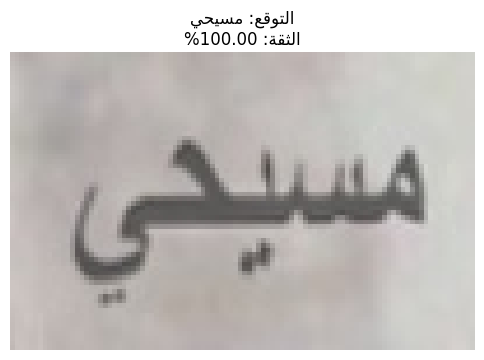

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_98_egypt_id_187_1.jpg


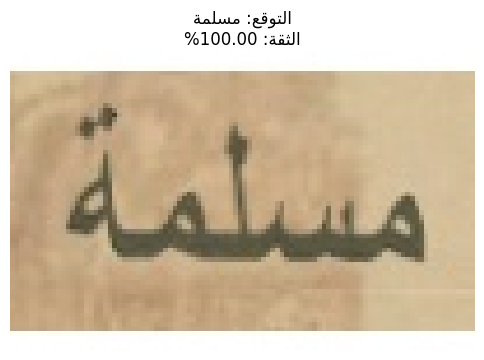

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_99_egypt_id_188_1.jpg


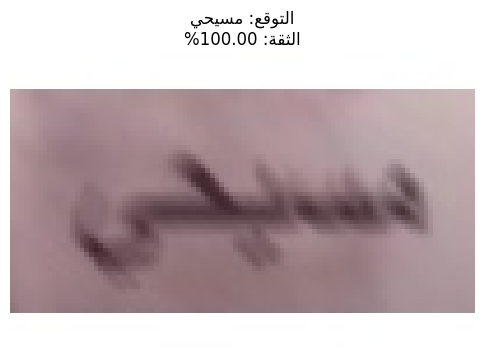

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_99_egypt_id_188_2.jpg


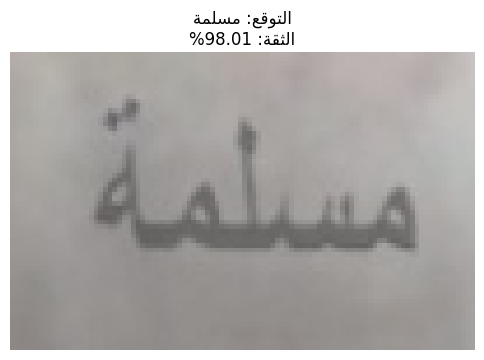

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\augmented_9_egypt_id_106_1.jpg


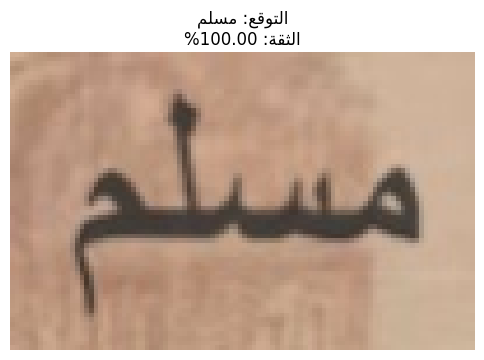

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_100_1.jpg


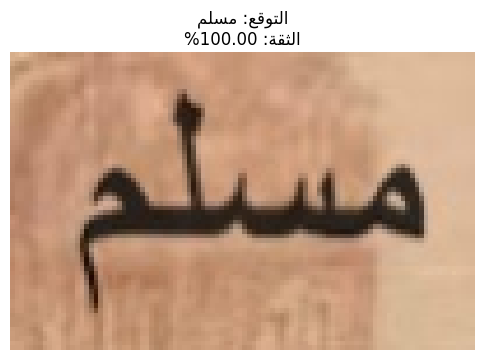

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_102_5.jpg


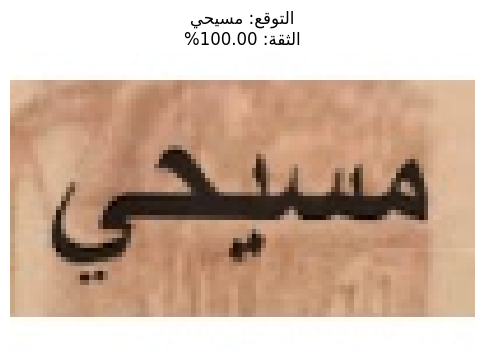

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_103_1.jpg


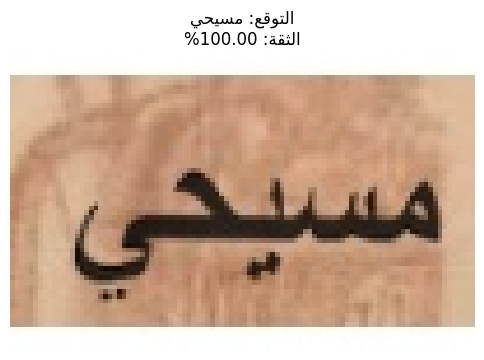

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_103_5.jpg


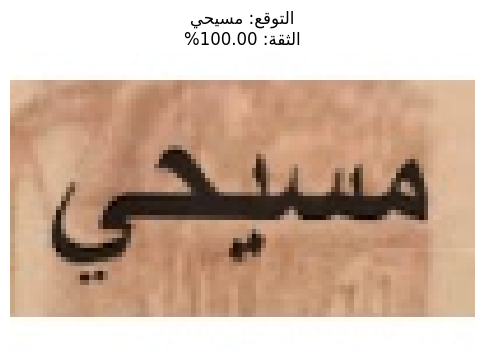

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_104_1.jpg


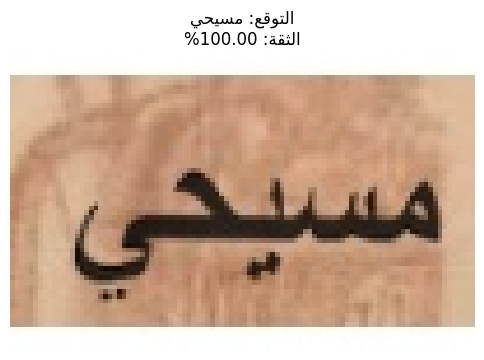

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_105_5.jpg


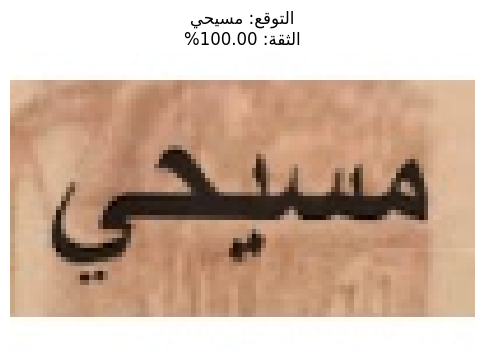

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_106_1.jpg


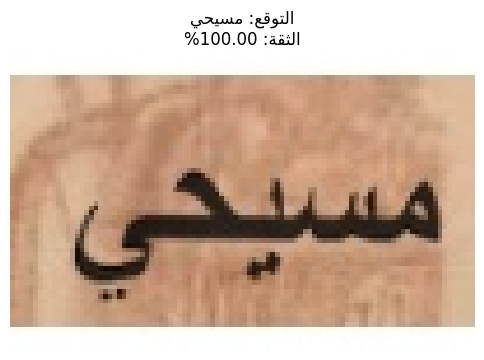

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_106_5.jpg


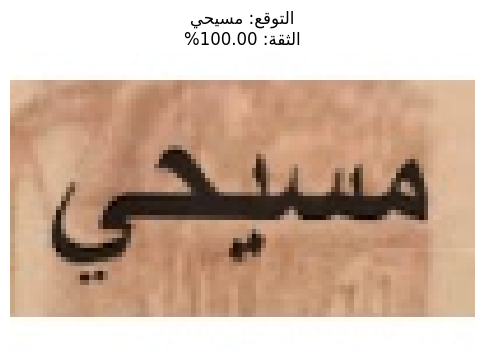

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_107_1.jpg


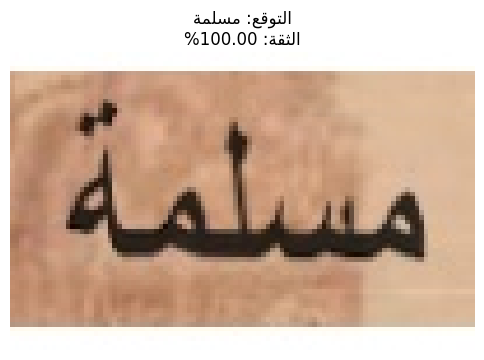

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_108_1.jpg


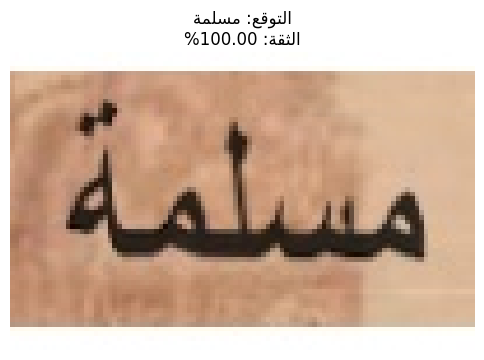

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_10_1.jpg


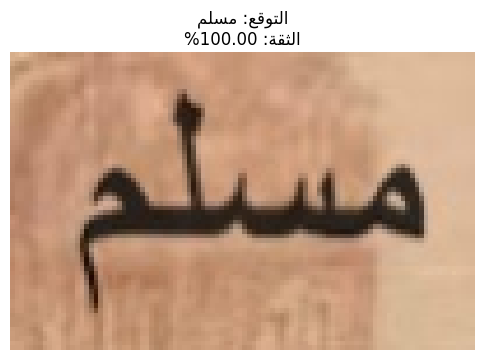

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_110_5.jpg


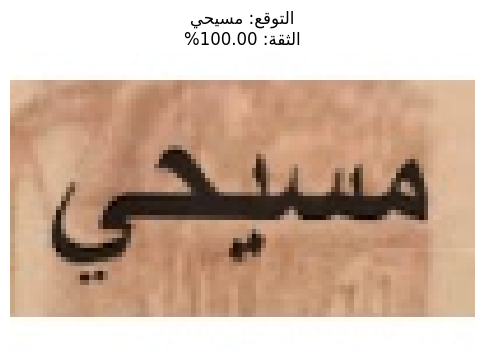

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_111_1.jpg


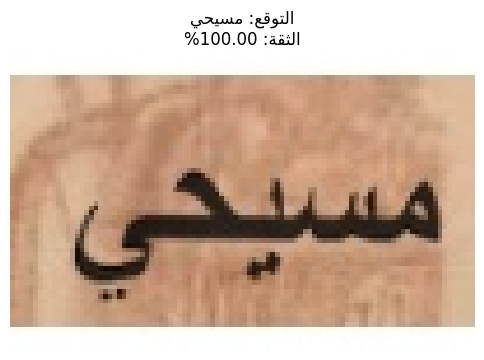

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_111_5.jpg


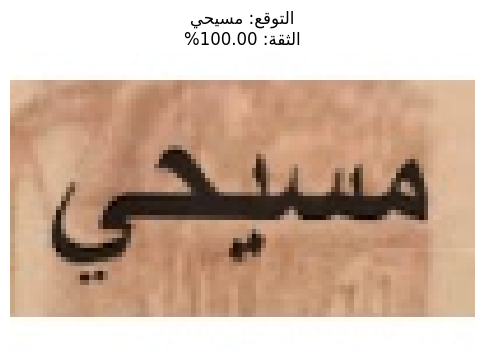

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_112_1.jpg


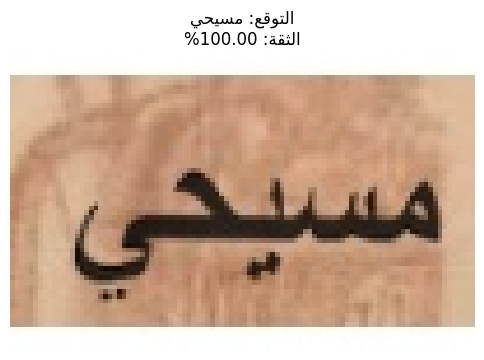

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_114_1.jpg


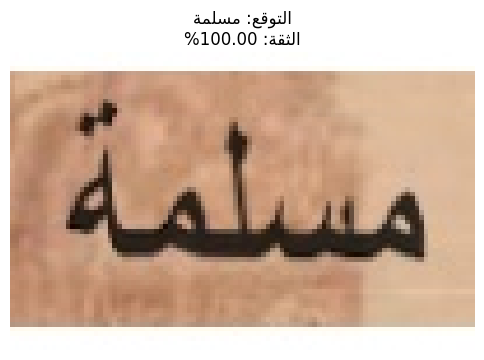

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_115_1.jpg


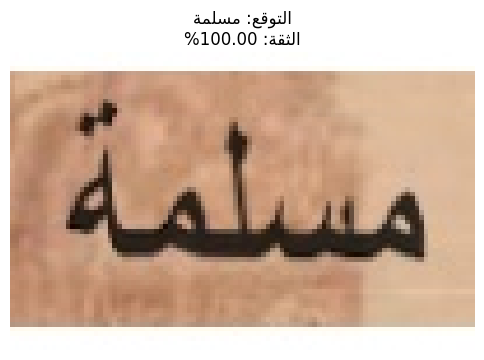

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_115_5.jpg


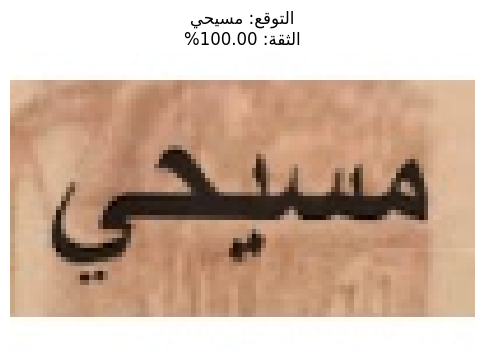

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_116_1.jpg


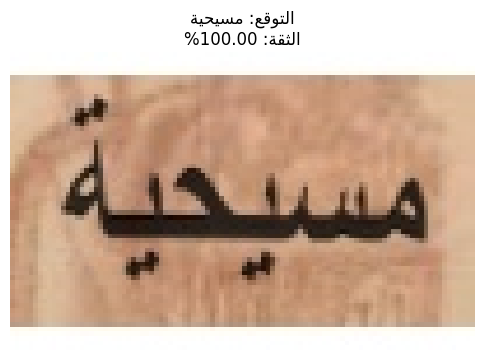

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_116_5.jpg


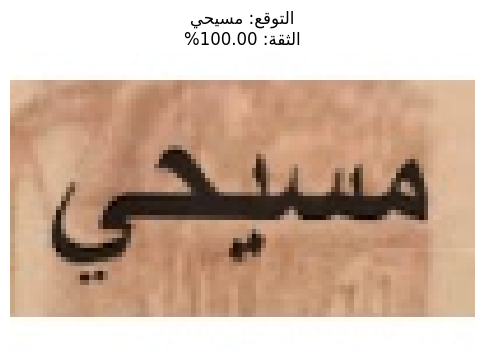

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_117_1.jpg


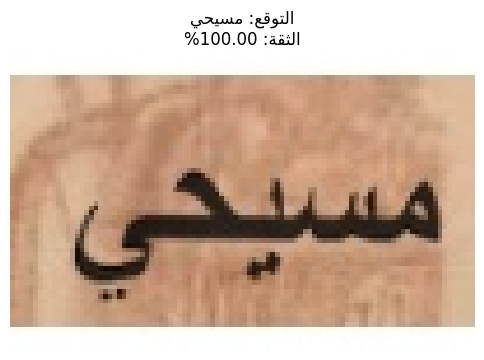

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_117_5.jpg


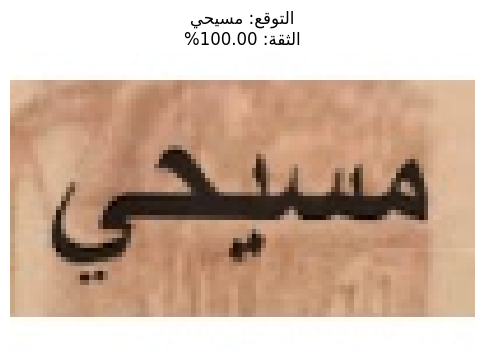

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_118_1.jpg


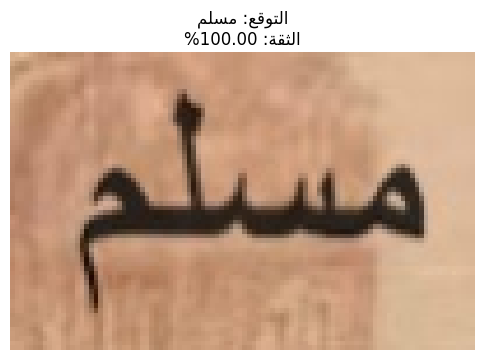

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_119_1.jpg


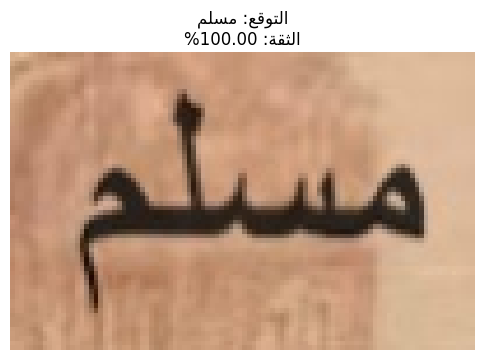

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_121_1.jpg


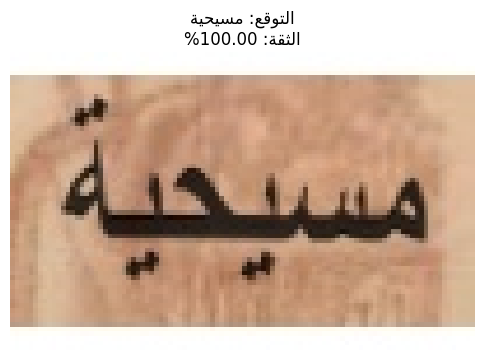

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_121_5.jpg


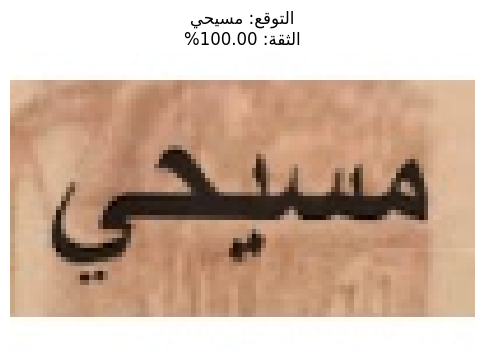

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_122_1.jpg


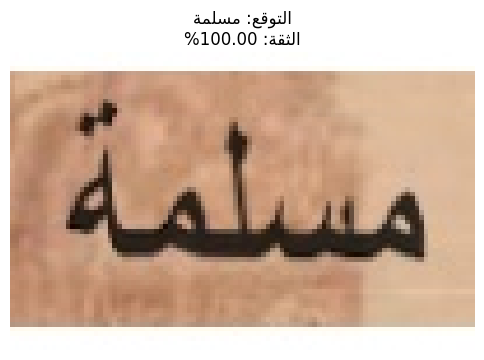

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_122_5.jpg


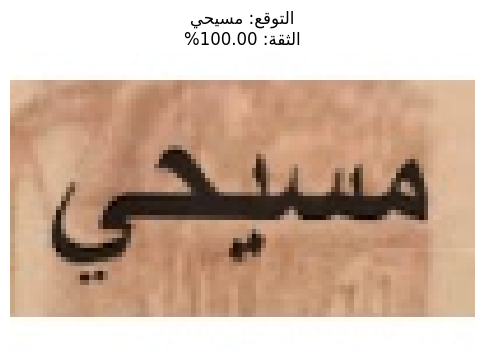

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_123_1.jpg


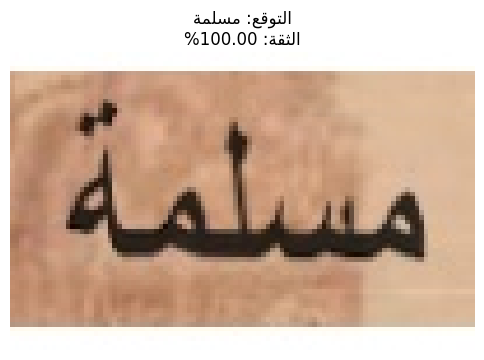

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_125_5.jpg


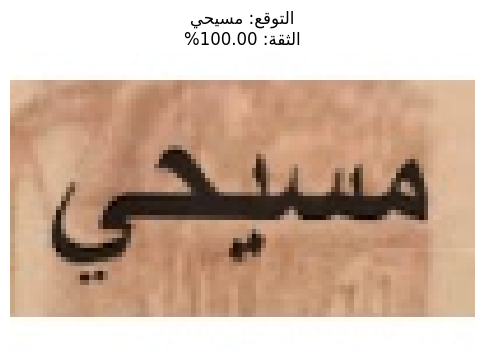

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_126_1.jpg


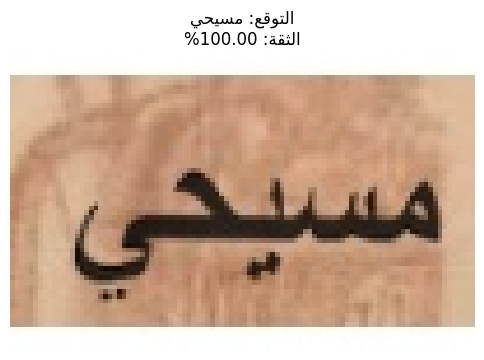

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_126_5.jpg


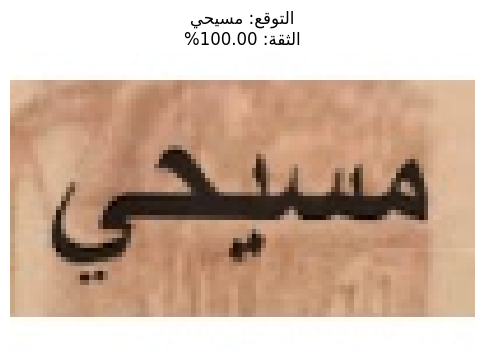

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_127_1.jpg


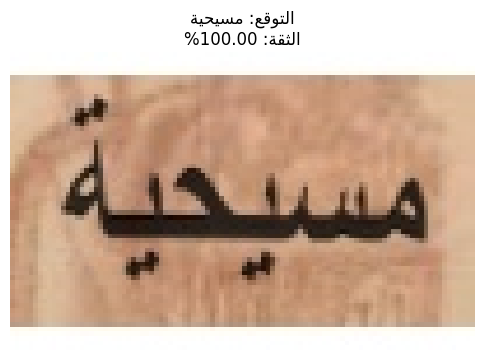

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_128_1.jpg


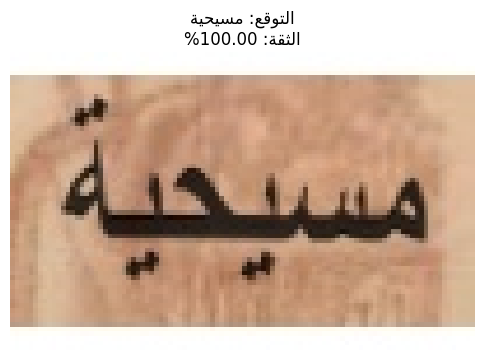

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_129_1.jpg


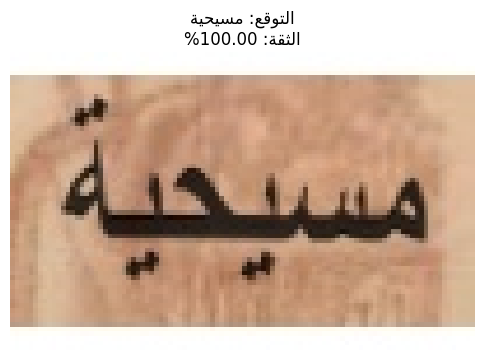

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_130_1.jpg


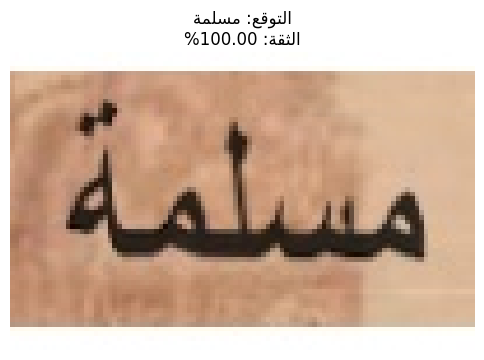

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_130_5.jpg


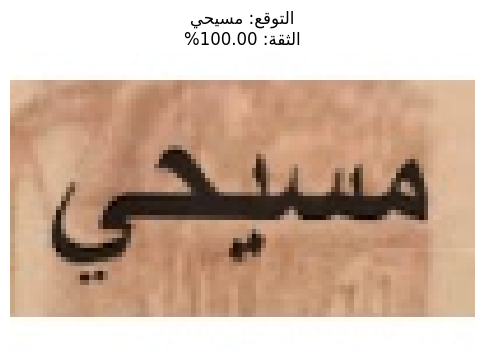

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_131_1.jpg


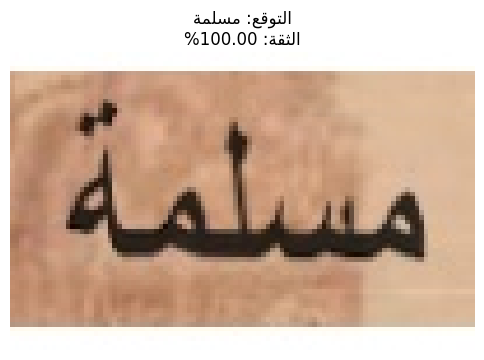

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_131_5.jpg


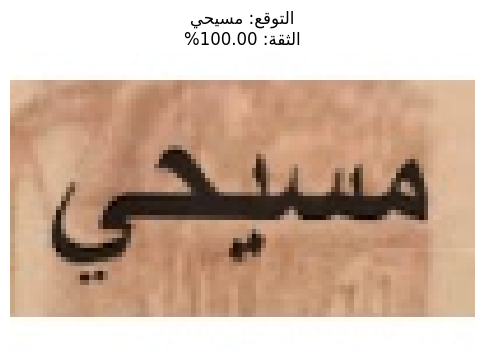

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_132_1.jpg


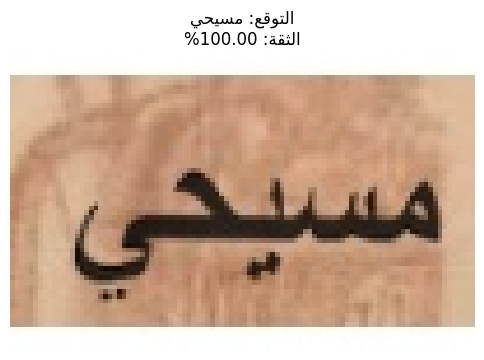

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_134_1.jpg


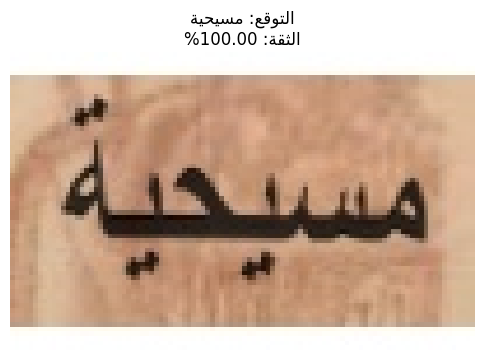

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_135_1.jpg


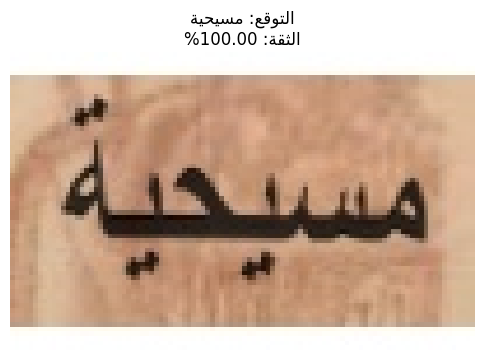

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_135_5.jpg


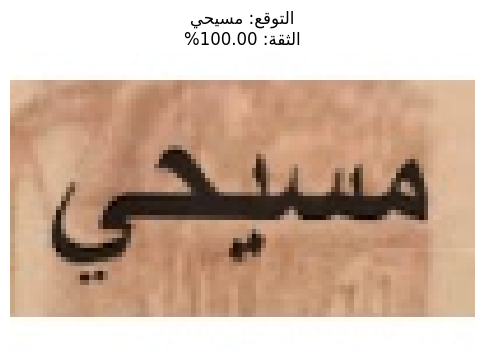

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_136_1.jpg


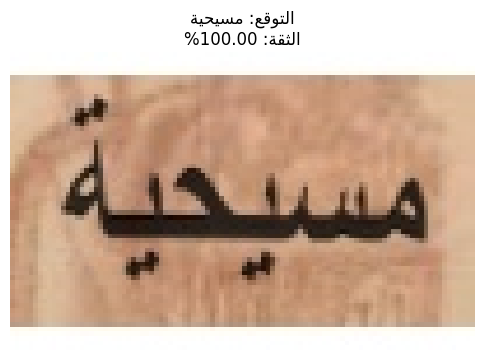

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_136_5.jpg


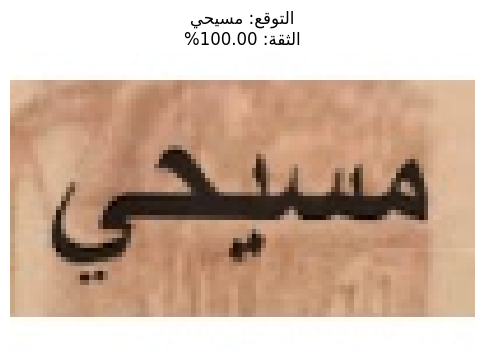

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_137_1.jpg


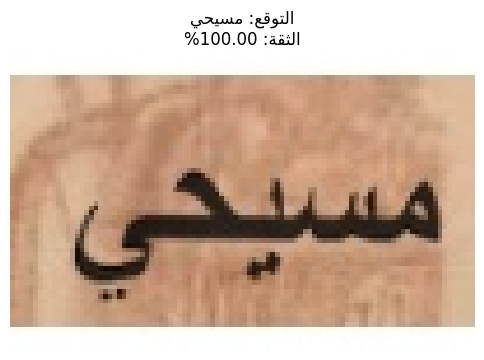

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_139_1.jpg


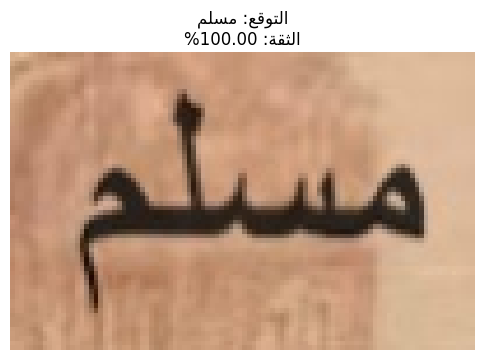

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_140_1.jpg


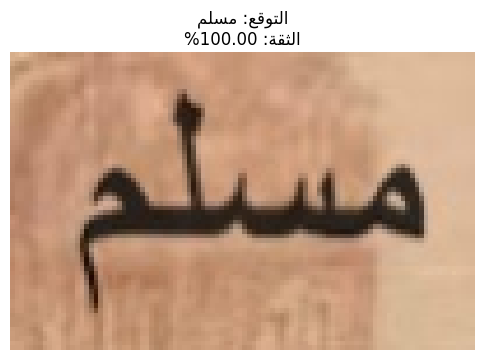

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_140_5.jpg


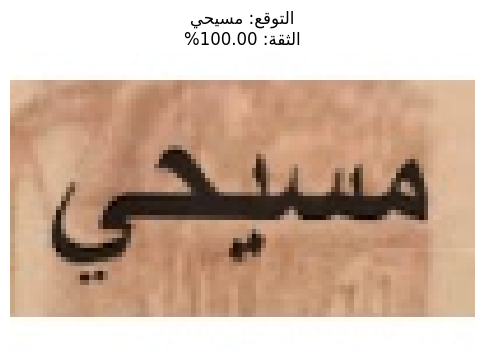

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_141_1.jpg


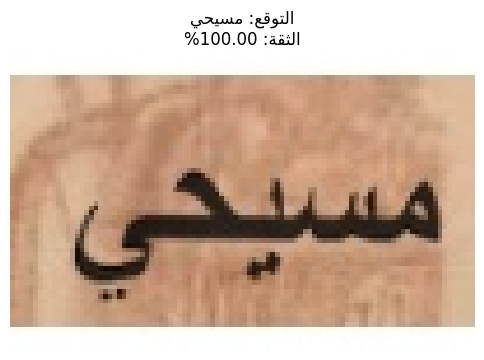

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_141_5.jpg


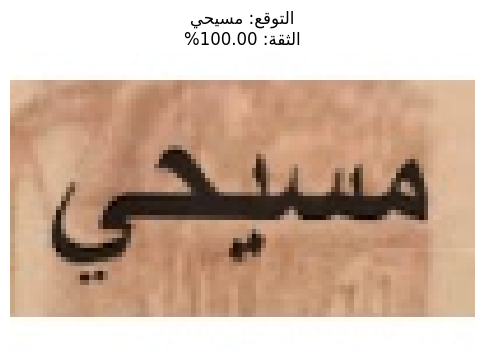

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_142_1.jpg


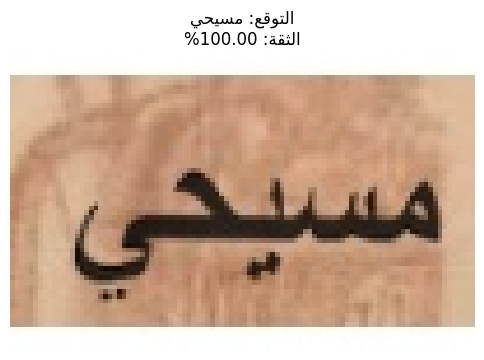

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_143_1.jpg


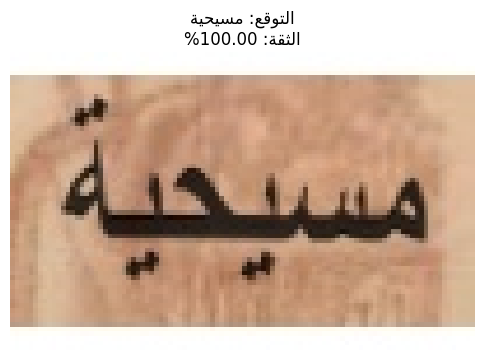

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_144_1.jpg


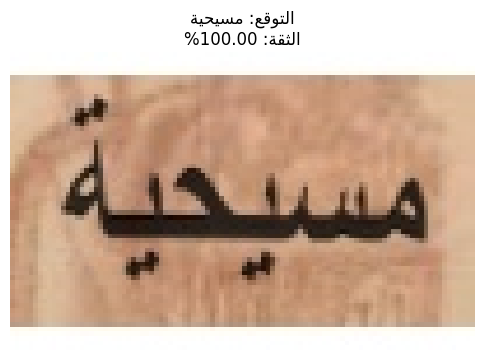

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_145_1.jpg


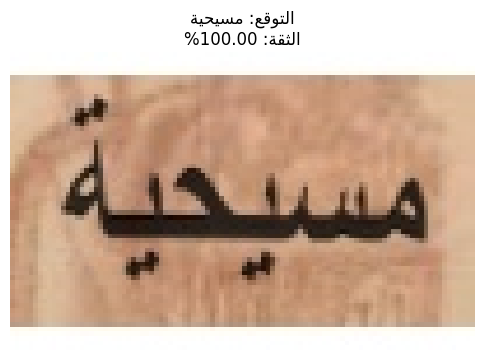

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_146_1.jpg


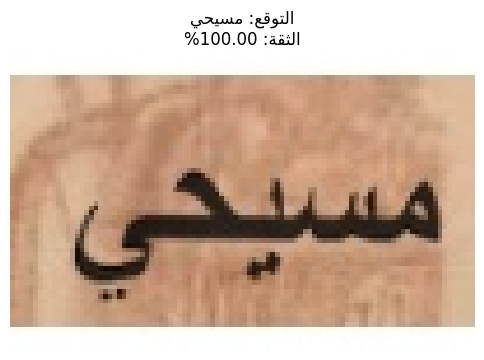

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_146_5.jpg


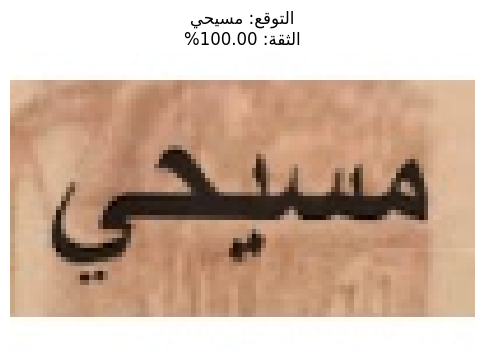

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_147_1.jpg


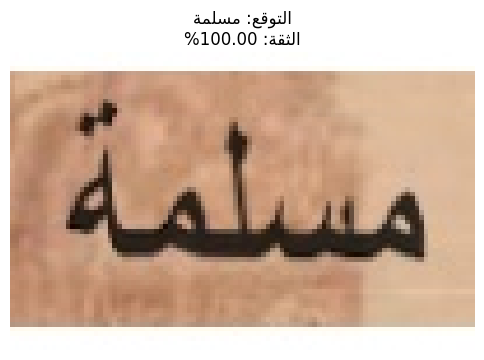

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_147_5.jpg


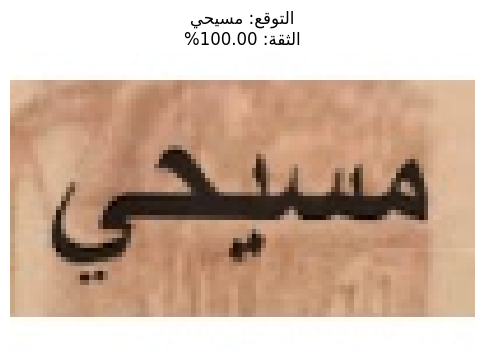

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_148_1.jpg


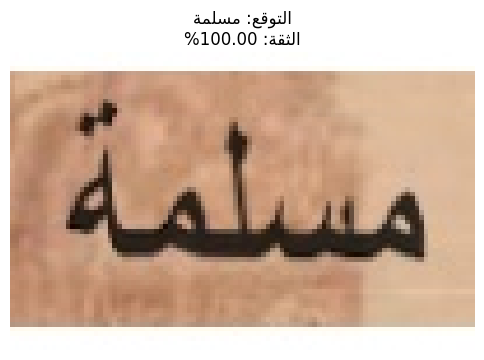

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_14_1.jpg


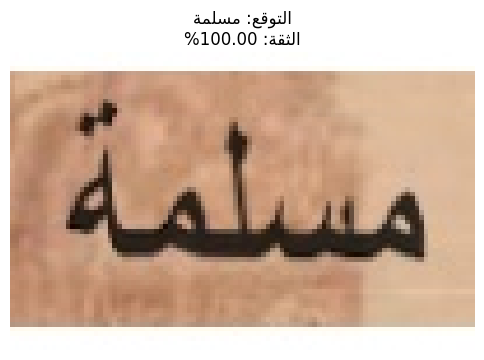

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_151_1.jpg


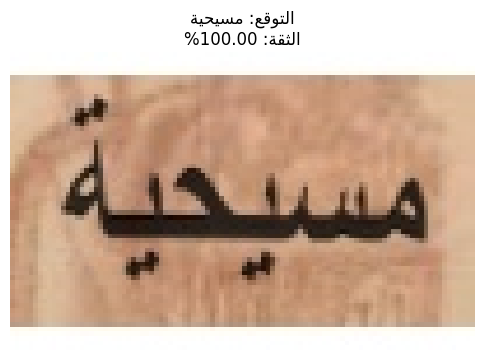

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_151_5.jpg


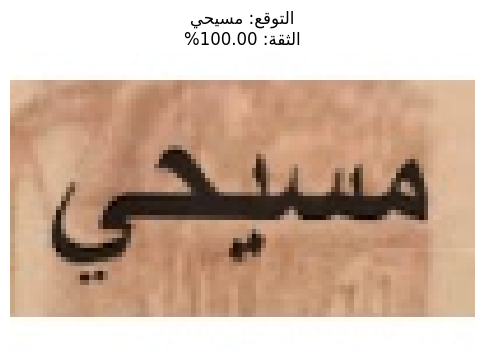

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_152_1.jpg


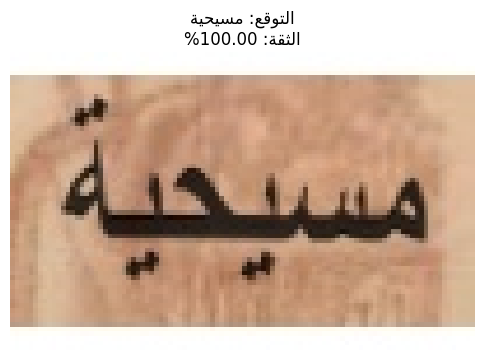

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_152_5.jpg


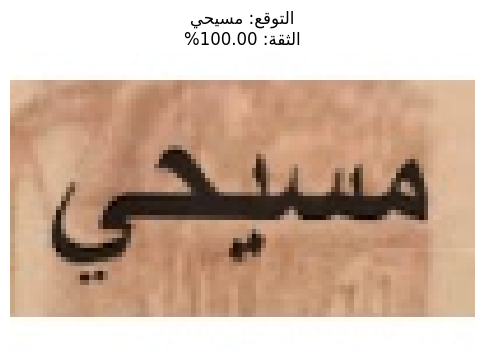

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_153_1.jpg


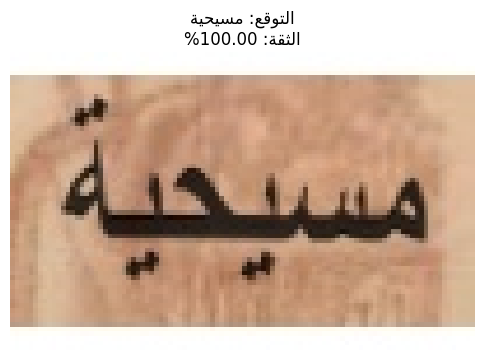

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_154_1.jpg


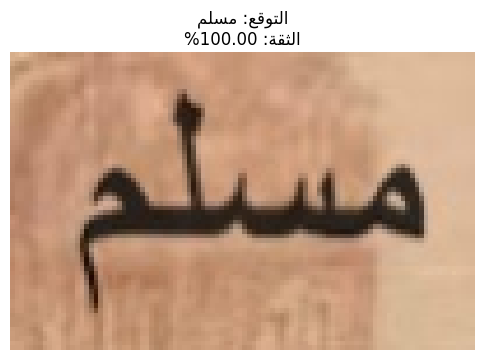

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_155_1.jpg


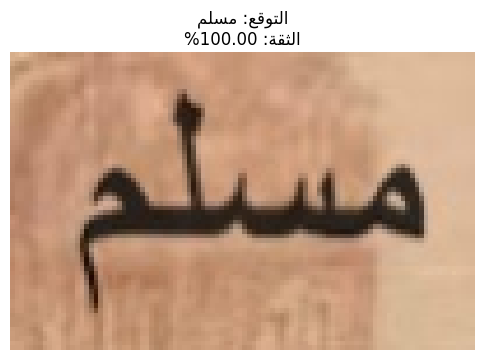

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_157_1.jpg


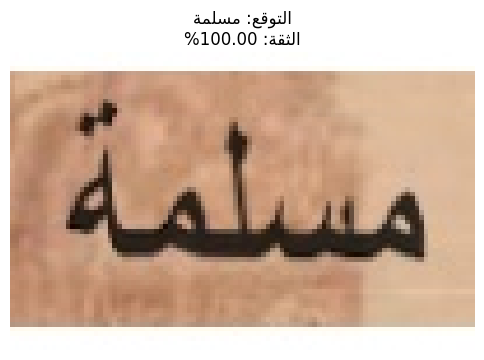

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_157_5.jpg


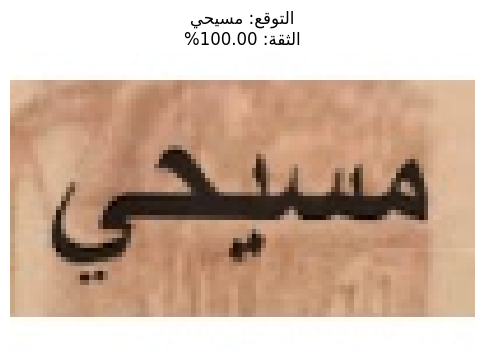

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_158_1.jpg


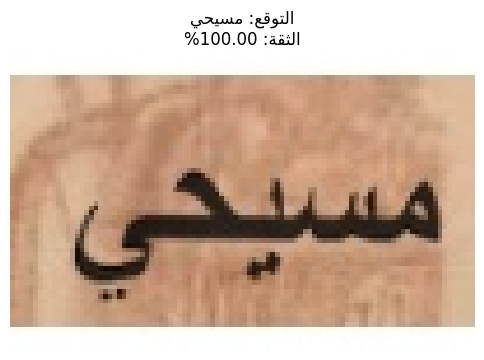

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_158_5.jpg


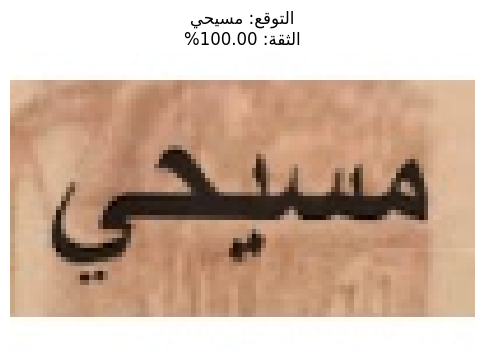

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_159_1.jpg


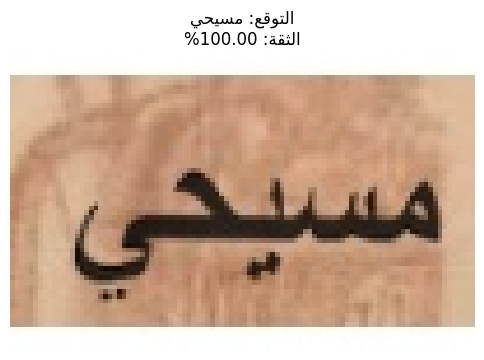

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_15_1.jpg


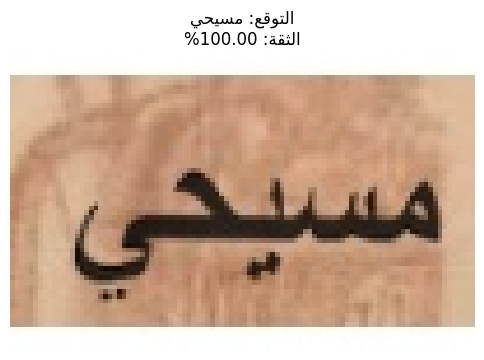

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_162_5.jpg


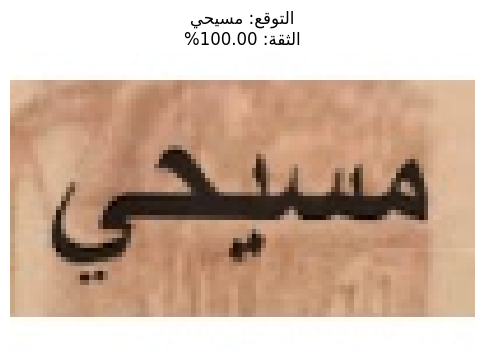

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_163_1.jpg


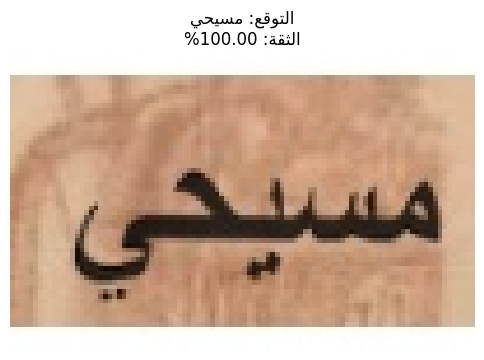

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_163_5.jpg


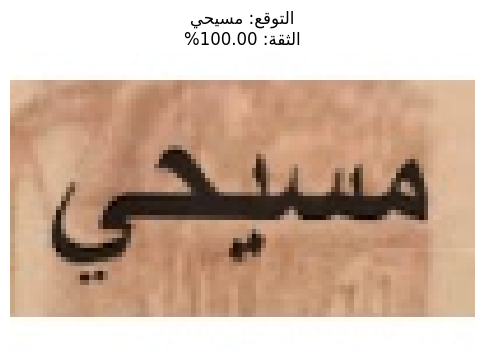

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_164_5.jpg


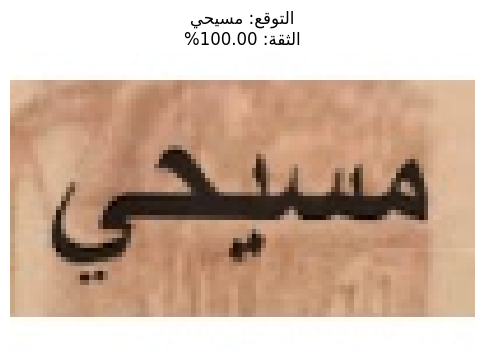

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_165_1.jpg


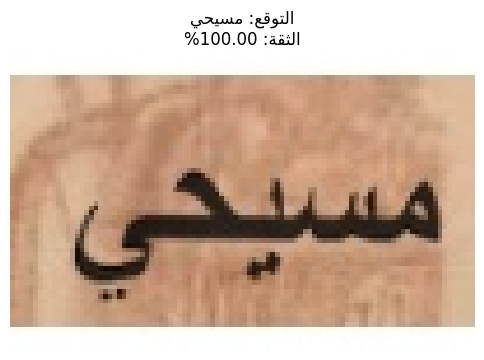

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_165_5.jpg


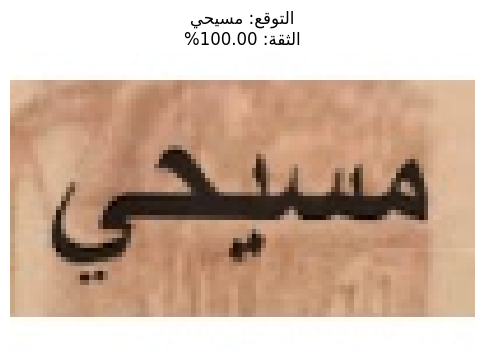

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_166_1.jpg


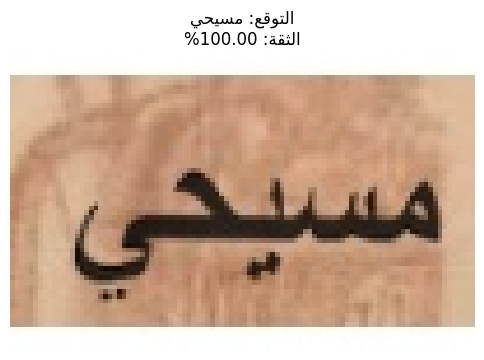

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_168_1.jpg


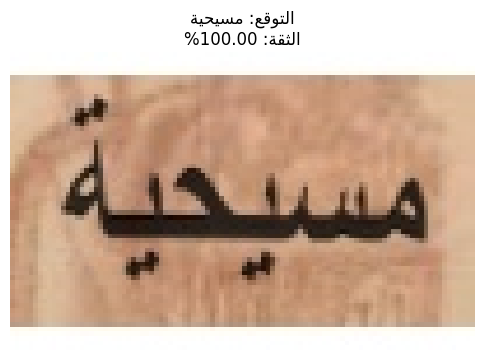

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_169_1.jpg


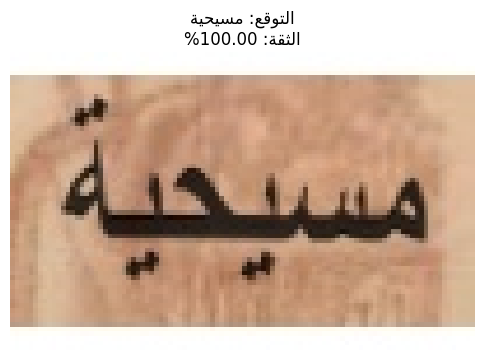

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_169_5.jpg


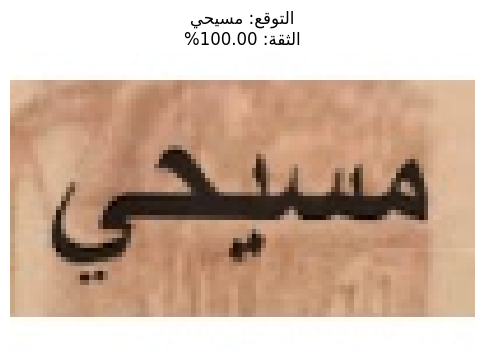

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_16_1.jpg


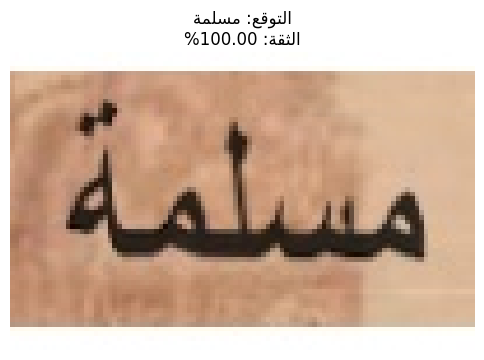

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_16_5.jpg


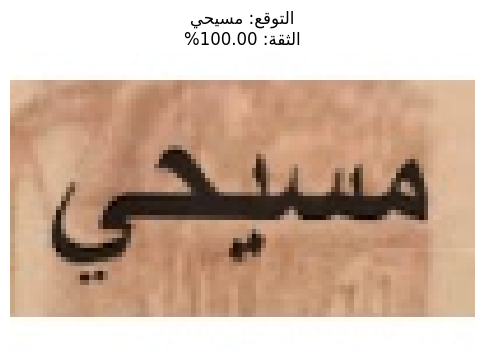

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_170_1.jpg


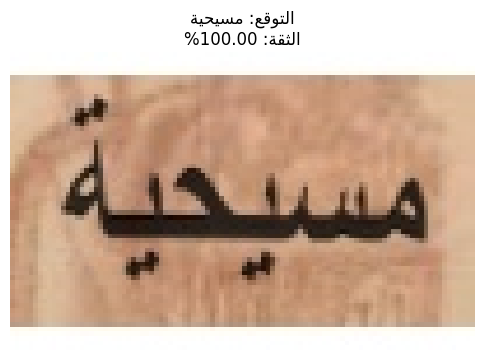

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_170_5.jpg


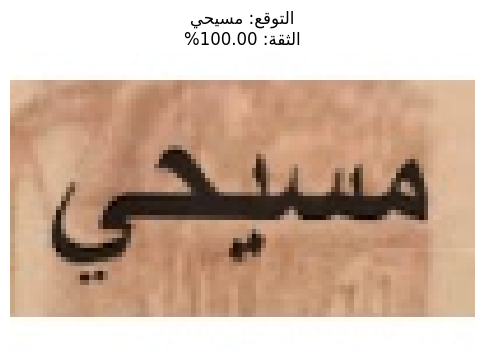

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_171_1.jpg


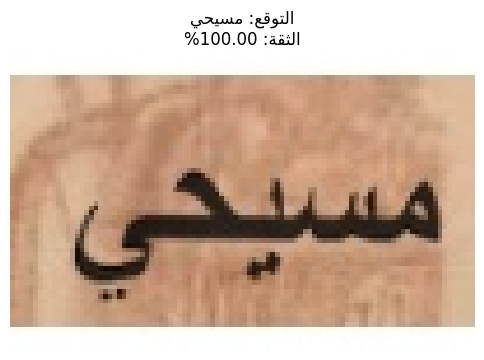

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_174_5.jpg


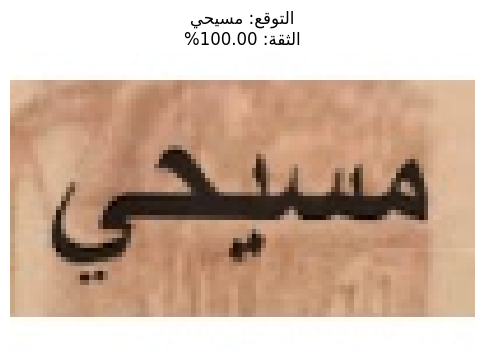

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_175_1.jpg


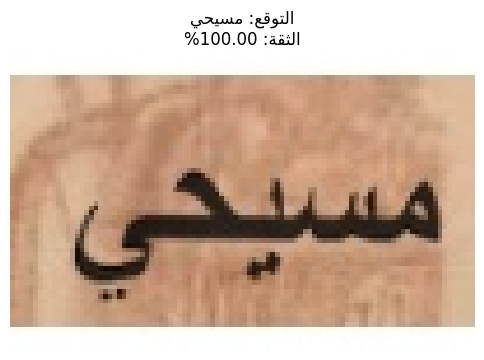

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_176_1.jpg


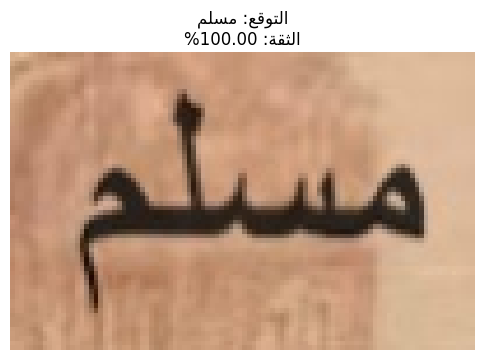

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_177_1.jpg


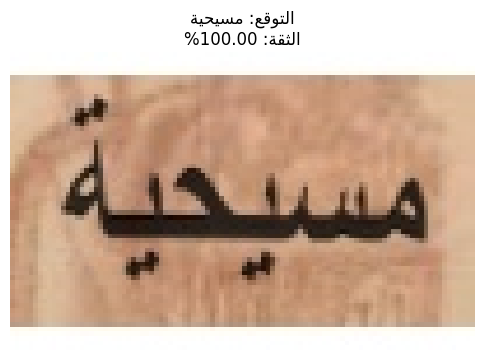

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_178_5.jpg


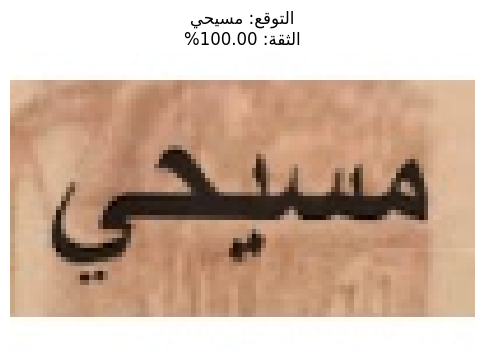

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_179_1.jpg


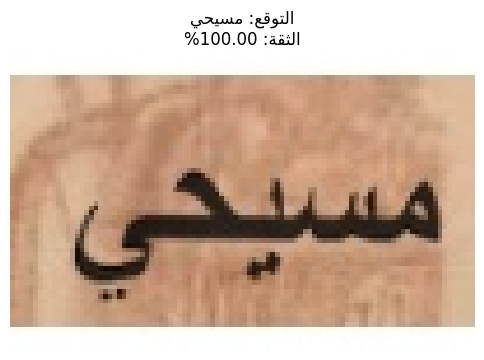

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_179_5.jpg


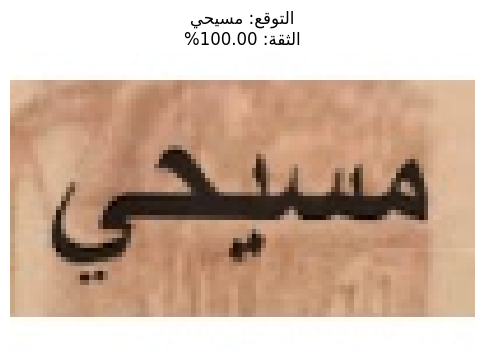

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_17_1.jpg


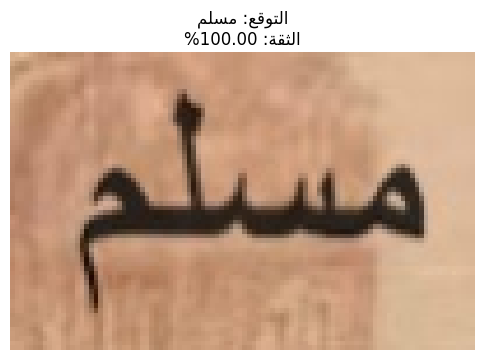

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_180_1.jpg


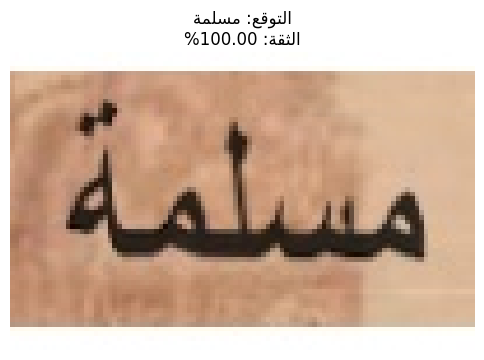

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_183_1.jpg


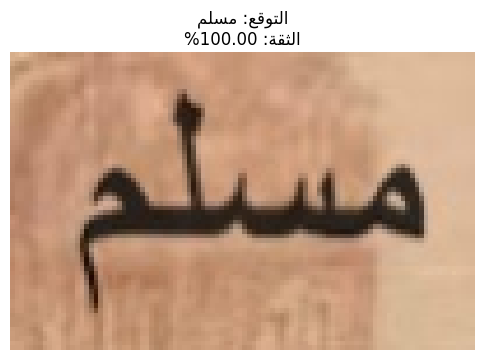

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_183_5.jpg


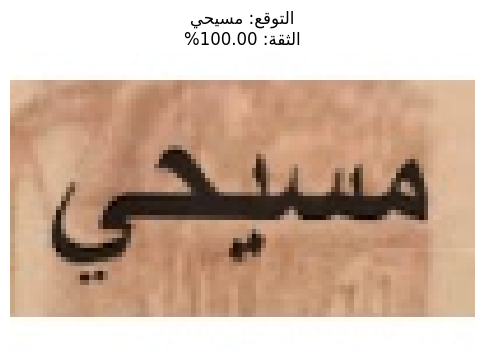

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_184_1.jpg


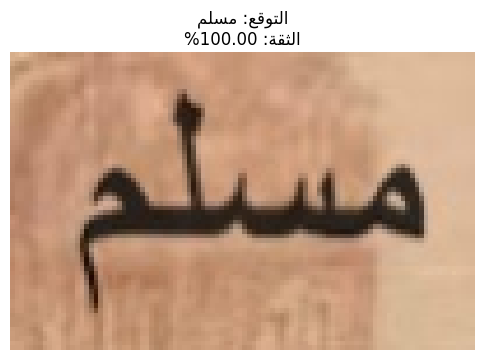

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_184_5.jpg


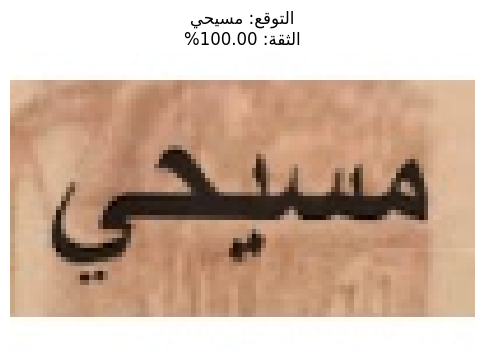

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_185_1.jpg


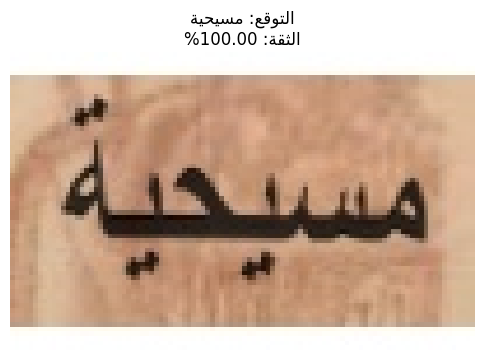

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_188_1.jpg


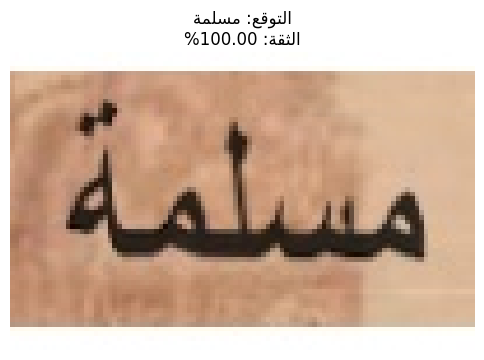

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_189_1.jpg


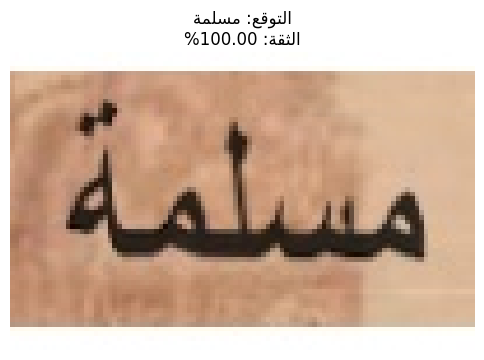

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_18_1.jpg


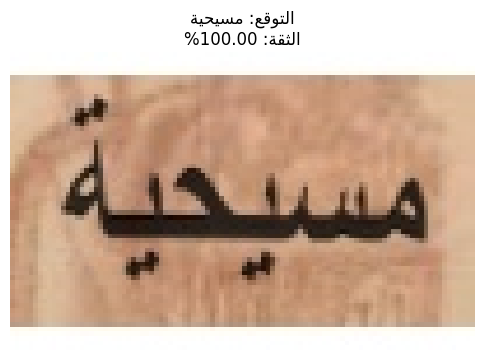

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_18_5.jpg


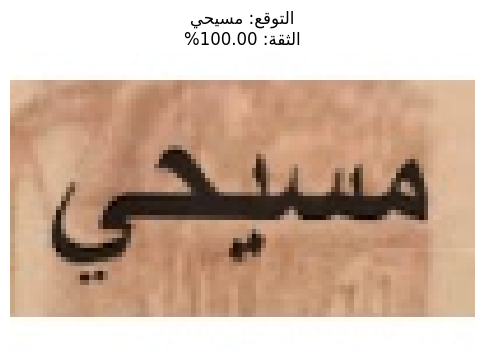

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_193_1.jpg


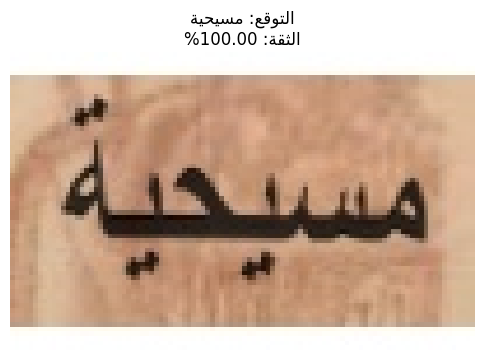

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_196_5.jpg


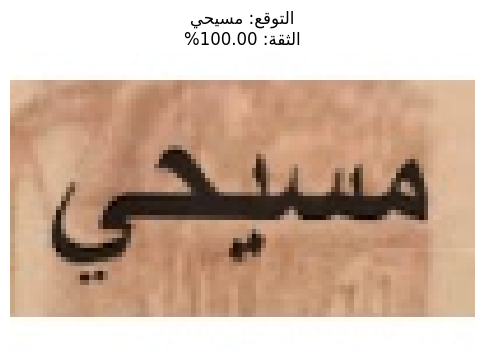

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_198_1.jpg


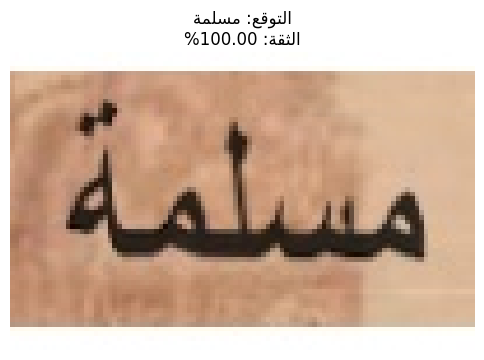

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_199_1.jpg


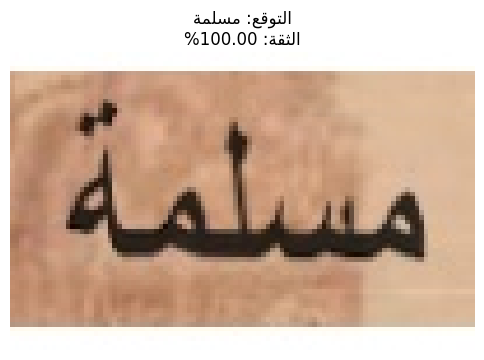

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_1_1.jpg


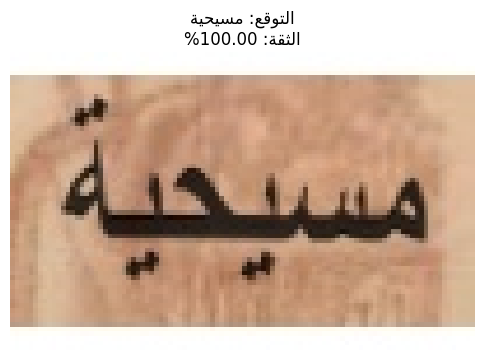

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_1_5.jpg


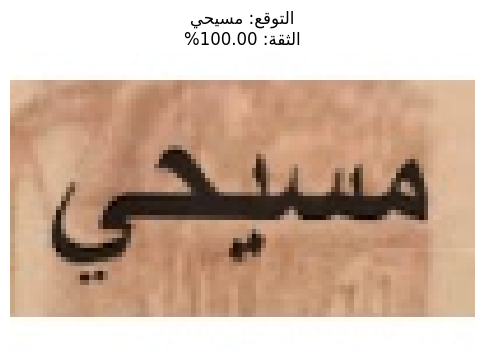

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_200_1.jpg


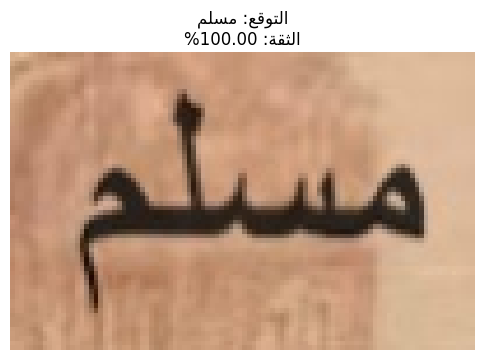

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_201_1.jpg


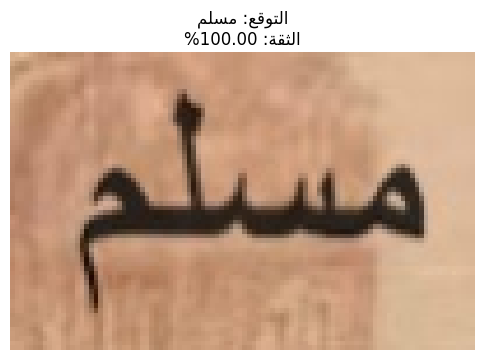

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_202_1.jpg


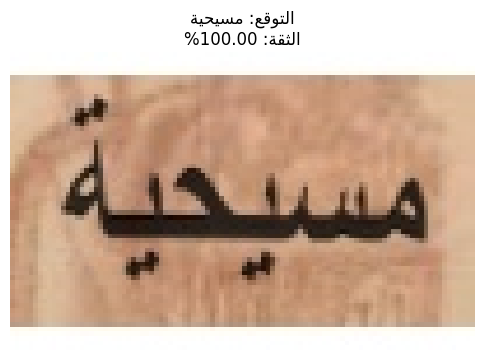

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_206_1.jpg


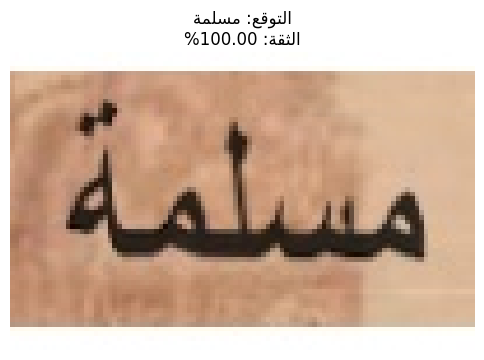

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_207_1.jpg


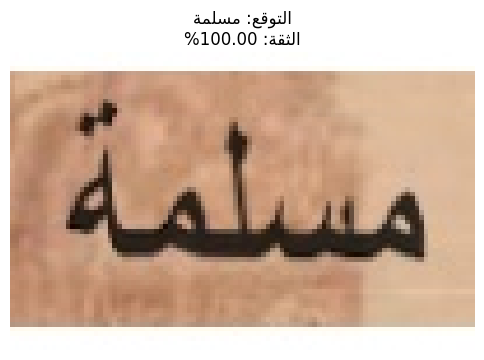

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_20_1.jpg


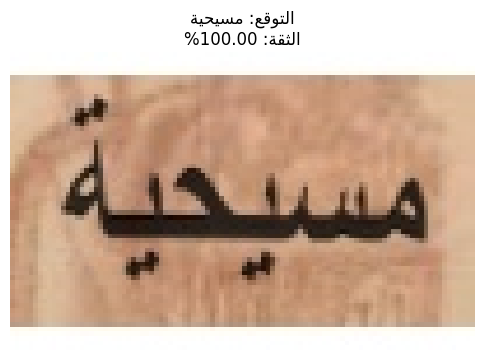

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_210_1.jpg


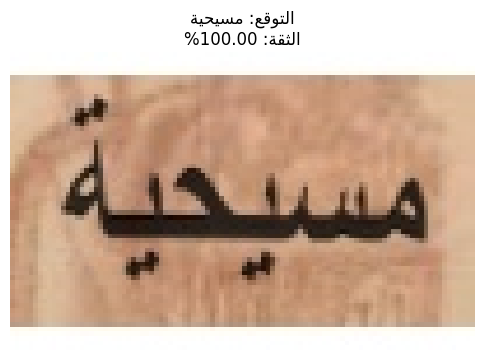

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_212_1.jpg


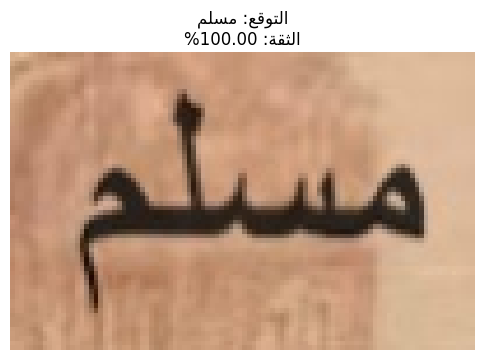

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_215_1.jpg


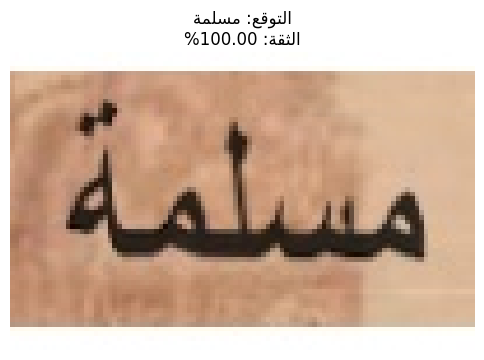

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_216_1.jpg


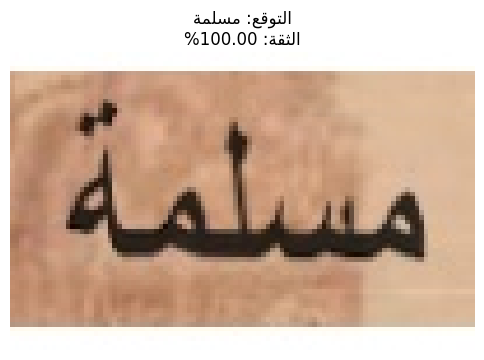

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_21_1.jpg


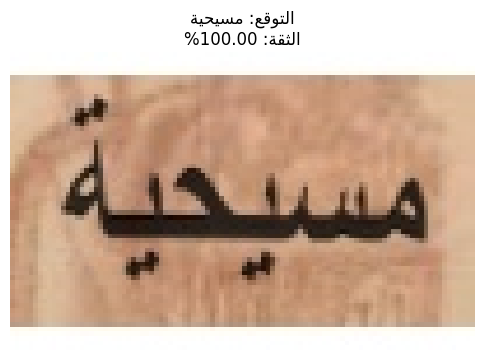

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_222_1.jpg


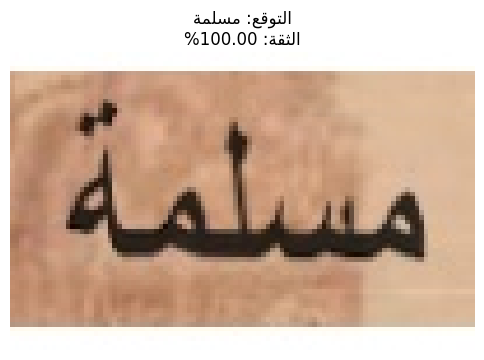

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_223_1.jpg


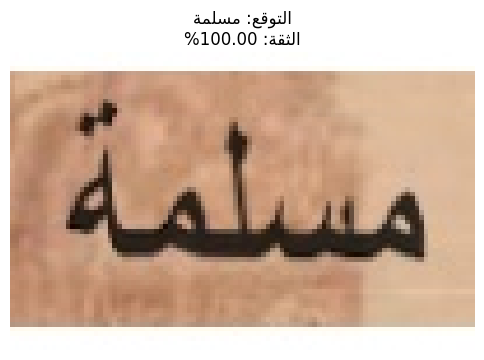

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_225_1.jpg


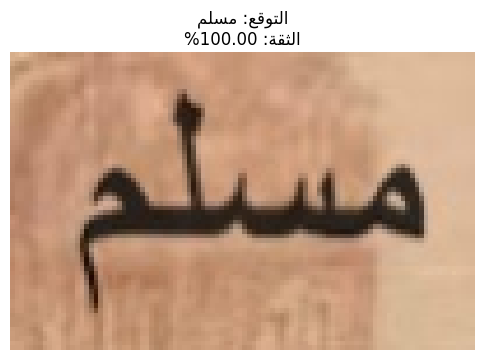

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_228_1.jpg


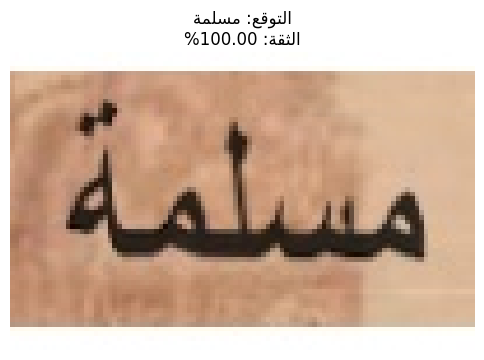

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_229_1.jpg


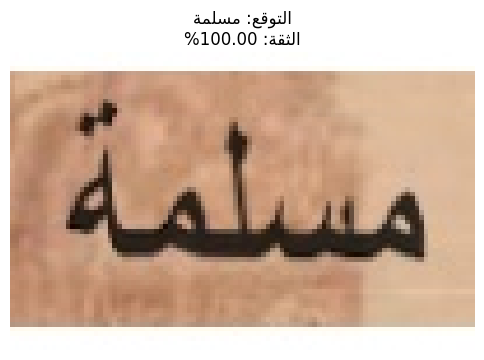

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_22_1.jpg


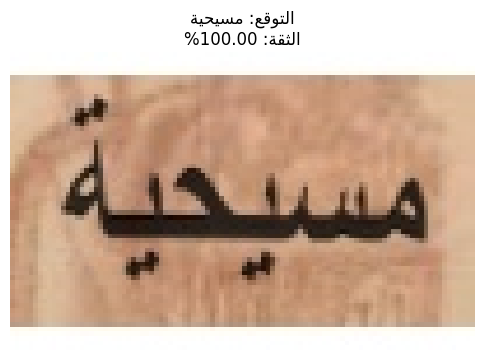

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_233_1.jpg


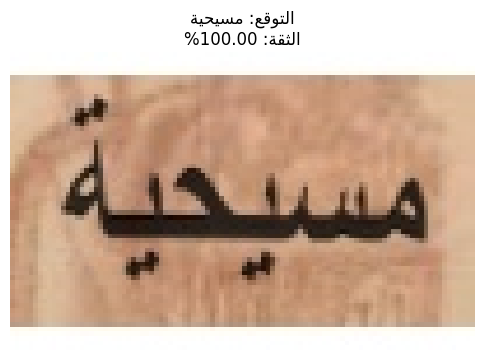

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_234_1.jpg


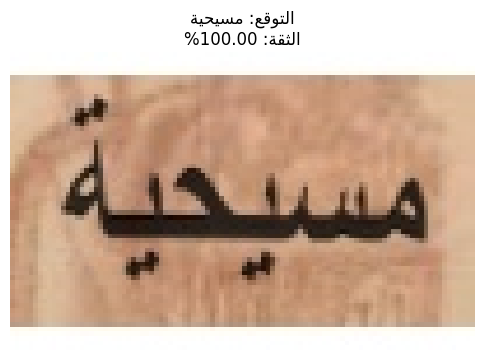

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_235_1.jpg


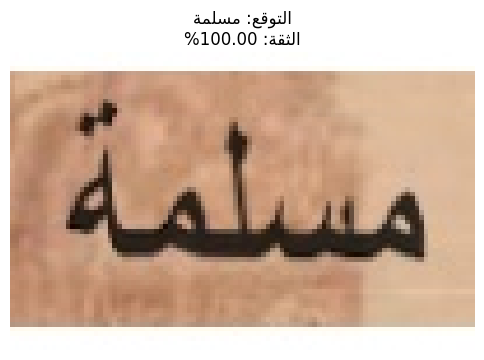

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_236_1.jpg


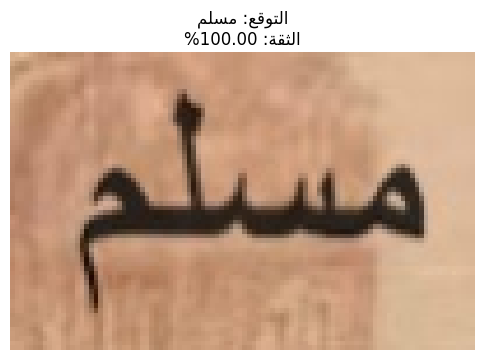

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_237_1.jpg


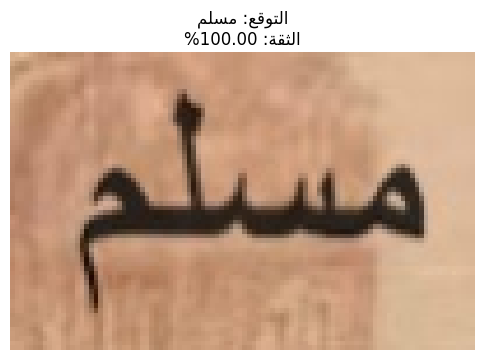

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_23_1.jpg


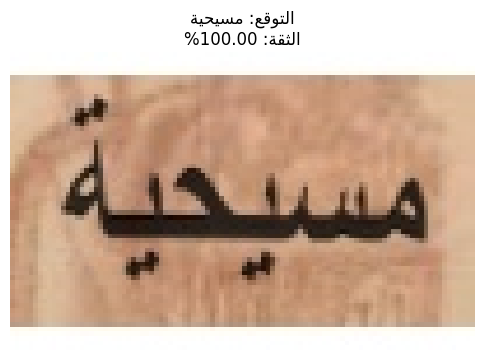

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_240_1.jpg


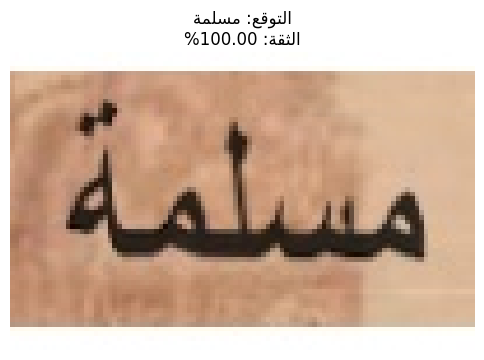

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_241_1.jpg


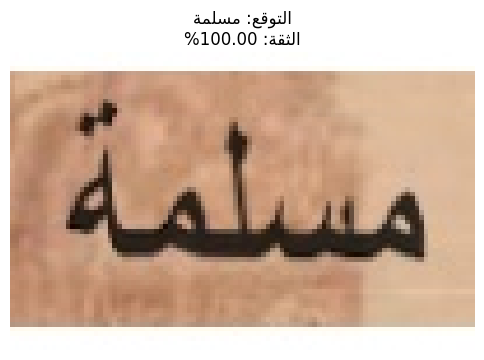

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_242_1.jpg


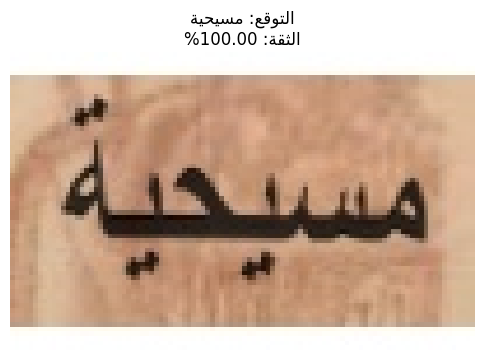

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_249_1.jpg


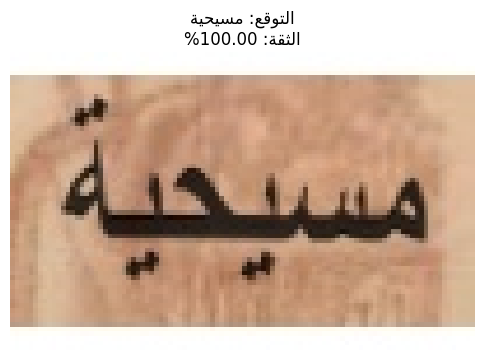

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_250_1.jpg


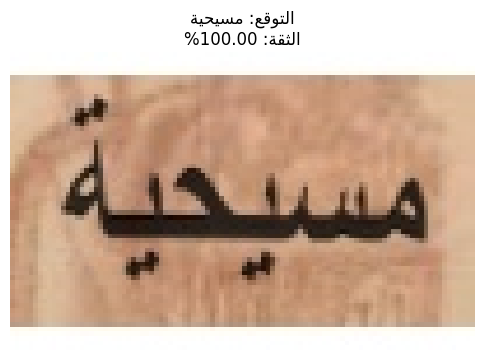

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_251_1.jpg


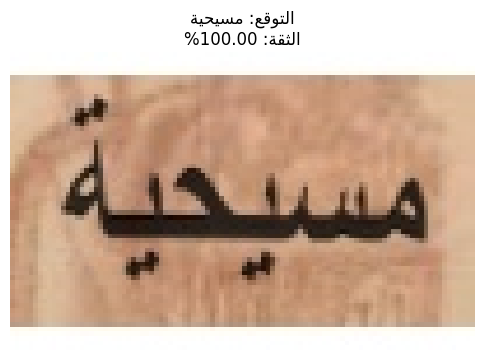

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_253_1.jpg


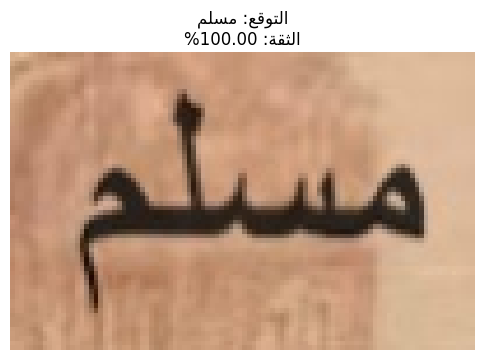

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_254_1.jpg


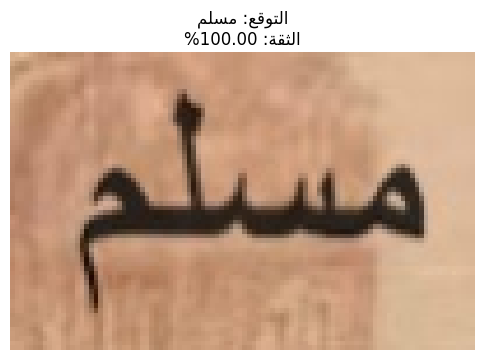

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_257_1.jpg


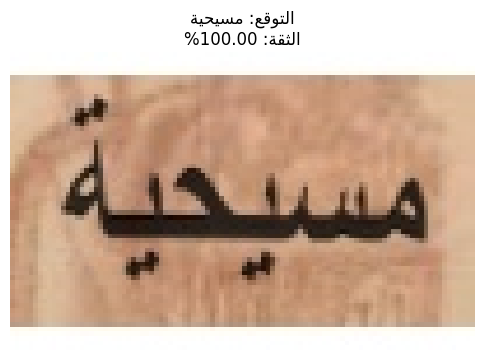

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_258_1.jpg


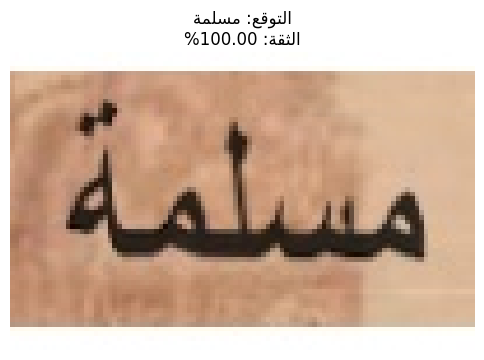

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_259_1.jpg


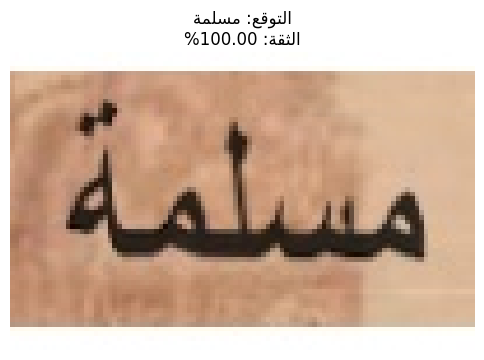

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_263_1.jpg


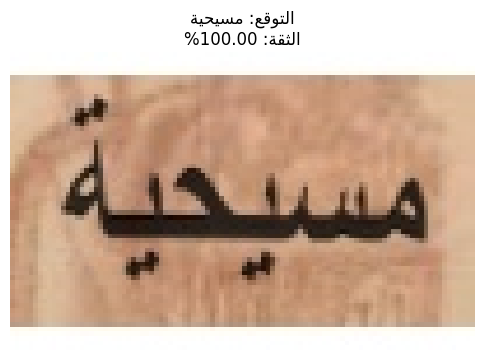

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_264_1.jpg


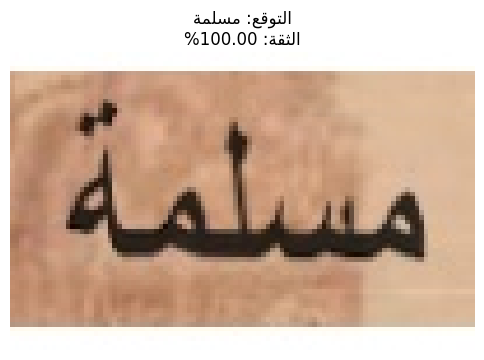

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_265_1.jpg


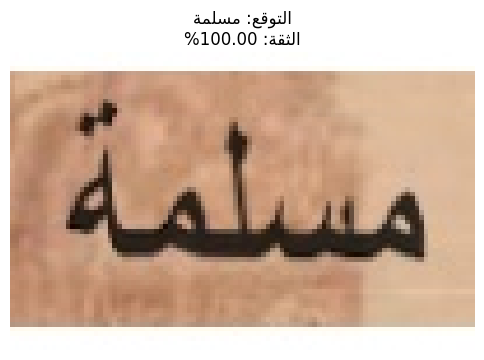

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_267_1.jpg


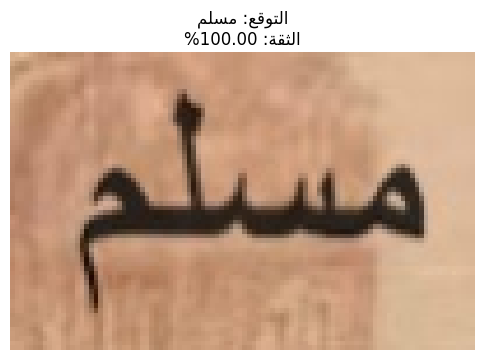

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_268_1.jpg


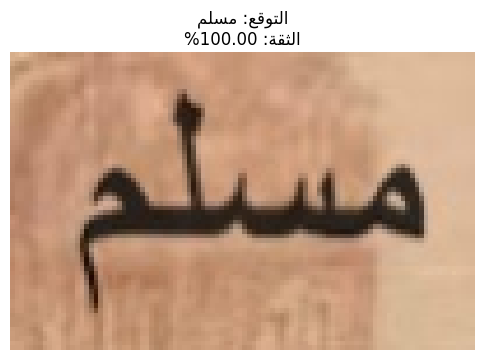

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_270_1.jpg


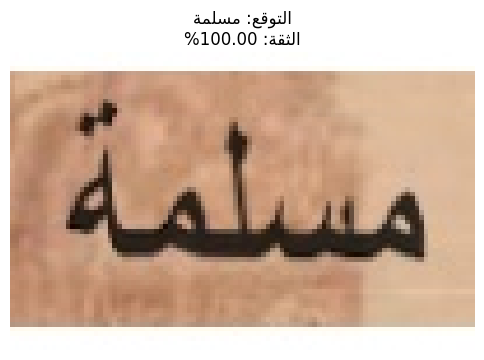

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_271_1.jpg


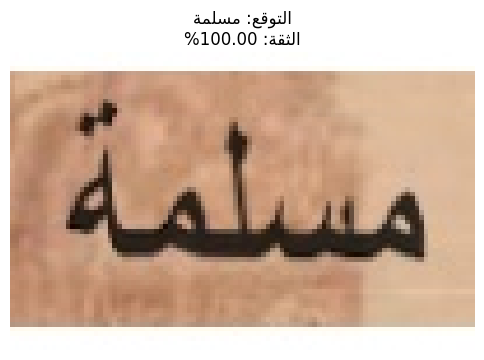

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_272_1.jpg


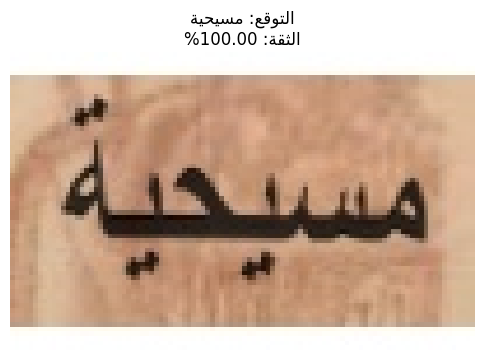

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_273_1.jpg


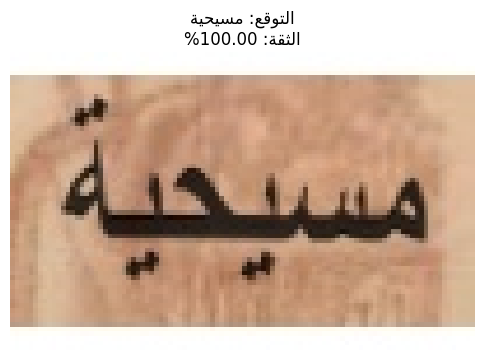

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_274_1.jpg


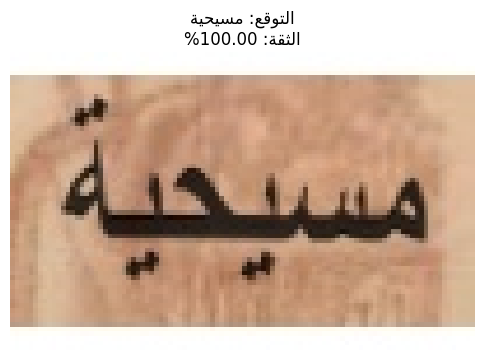

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_277_1.jpg


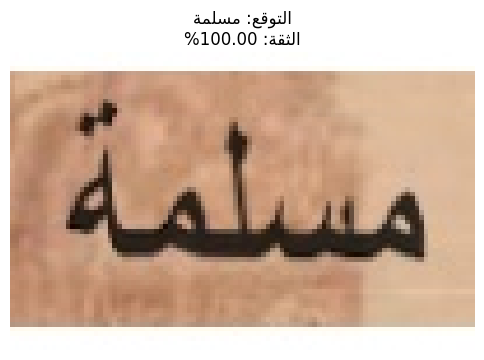

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_278_1.jpg


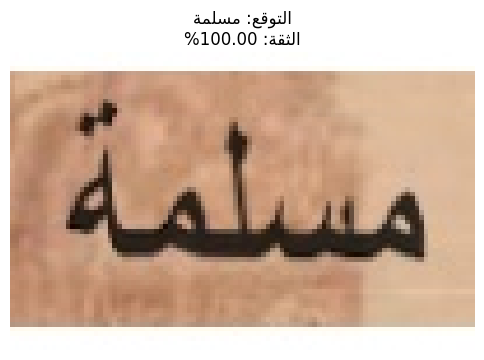

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_282_1.jpg


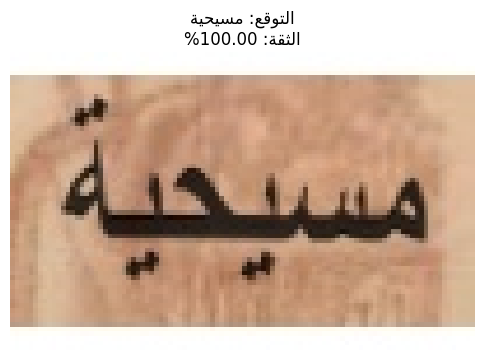

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_283_1.jpg


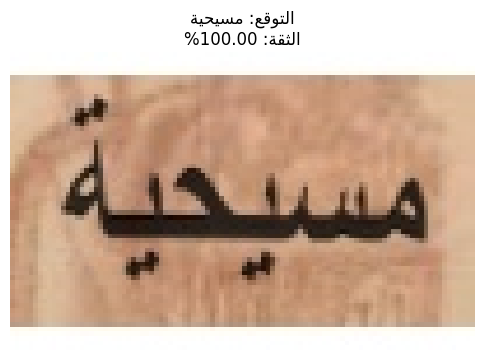

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_284_1.jpg


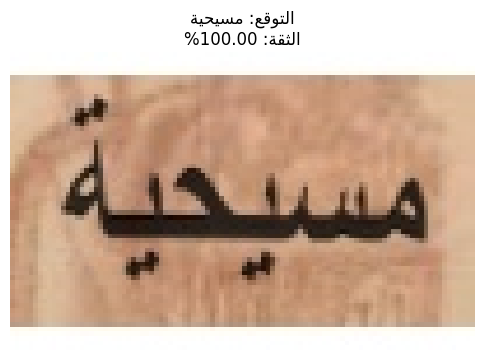

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_286_1.jpg


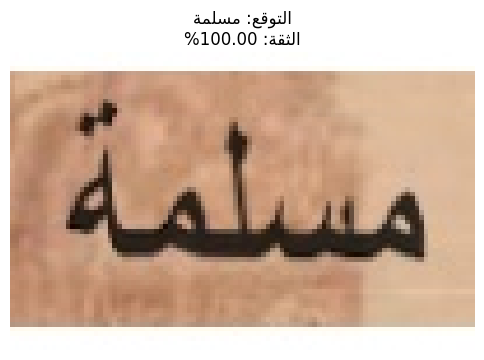

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_287_1.jpg


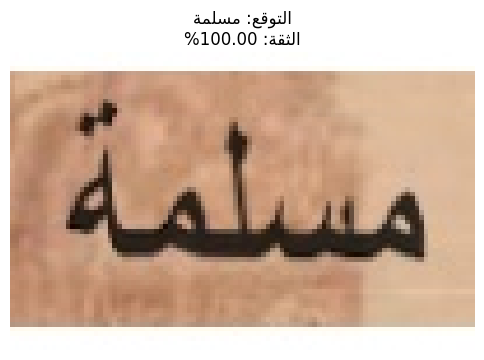

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_291_1.jpg


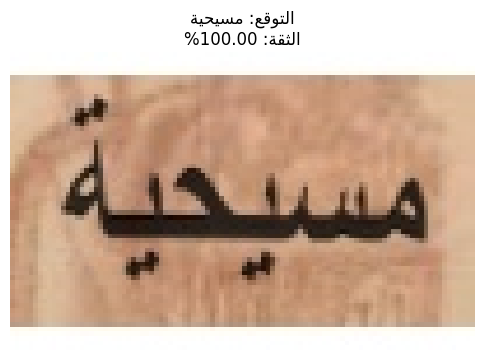

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_292_1.jpg


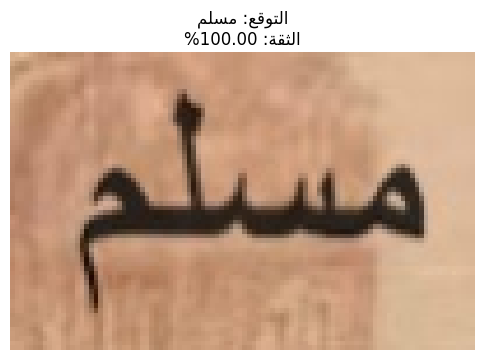

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_293_1.jpg


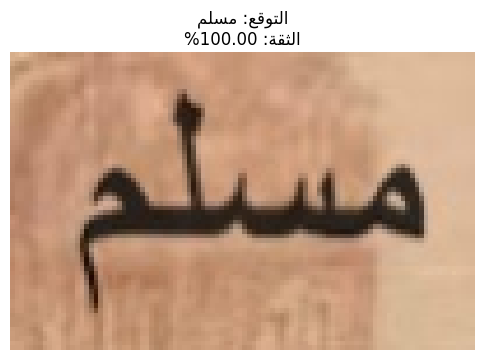

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_294_1.jpg


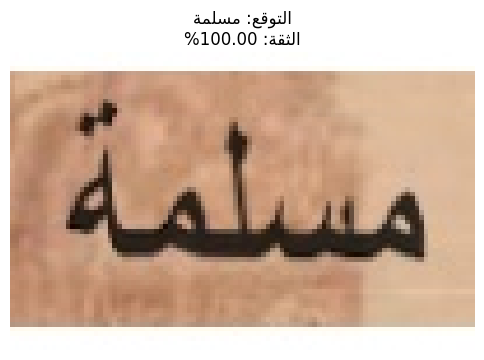

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_295_1.jpg


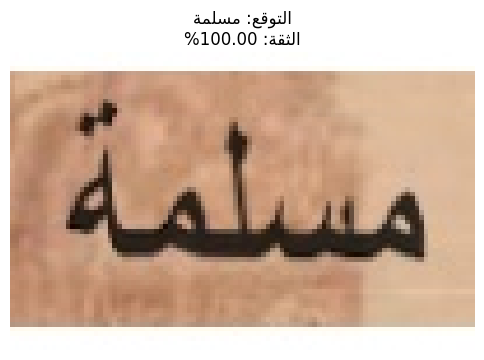

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_2_1.jpg


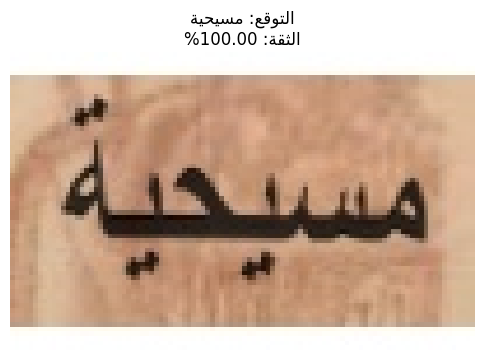

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_304_1.jpg


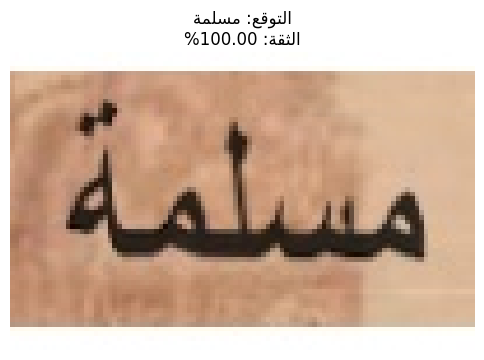

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_305_1.jpg


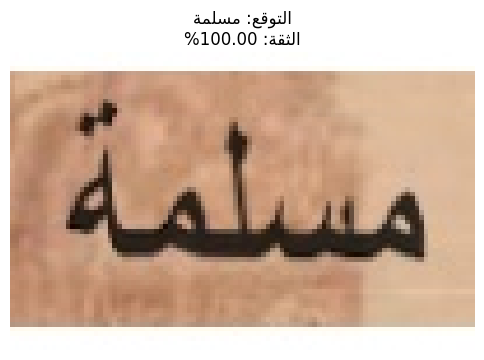

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_306_1.jpg


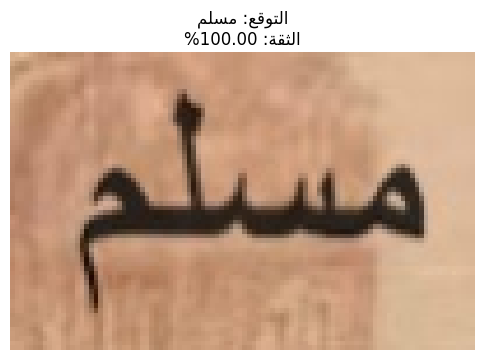

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_314_1.jpg


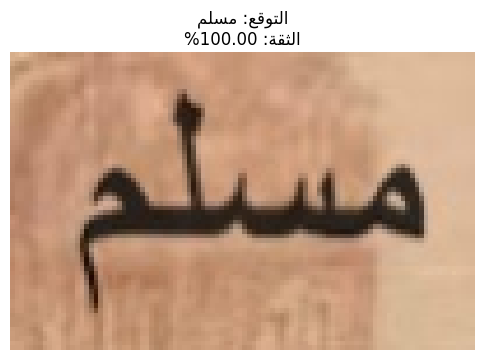

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_315_1.jpg


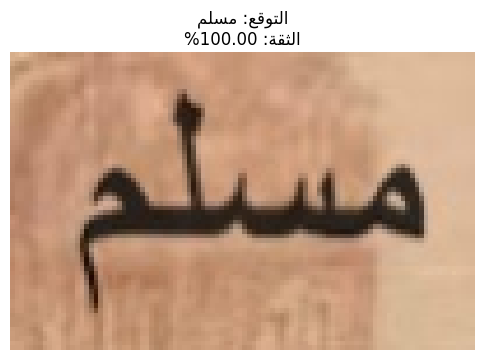

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_340_1.jpg


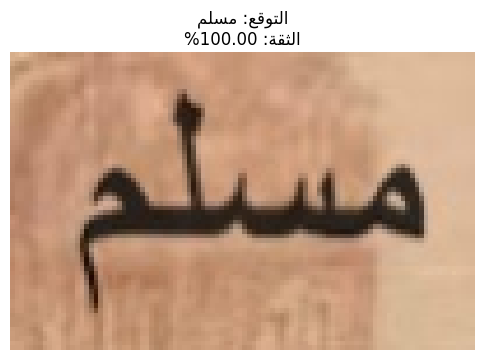

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_341_1.jpg


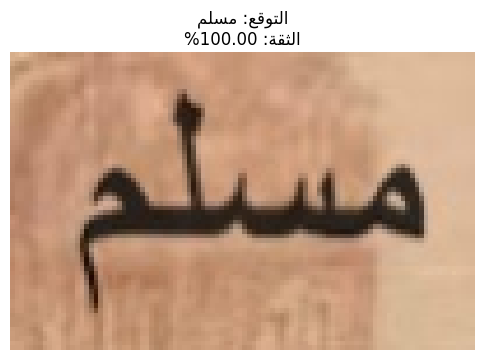

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_352_1.jpg


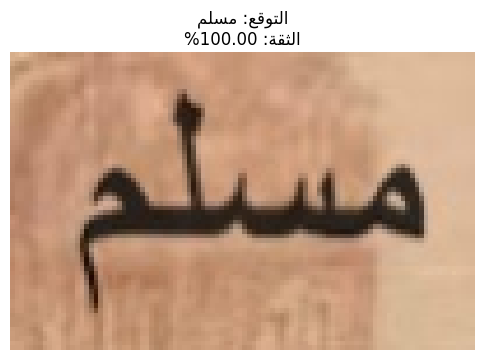

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_353_1.jpg


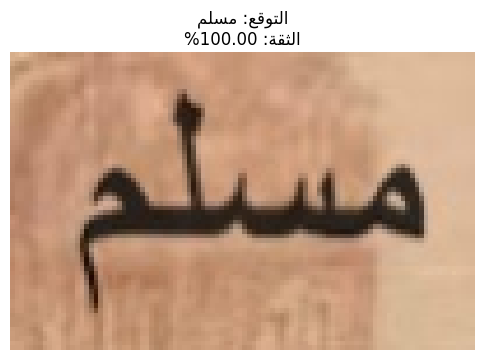

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_361_1.jpg


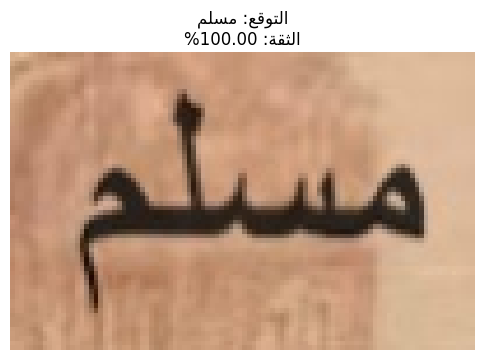

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_375_1.jpg


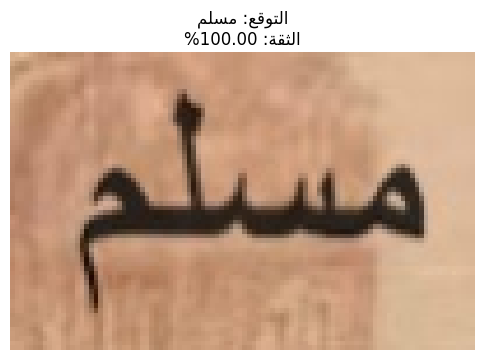

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_384_1.jpg


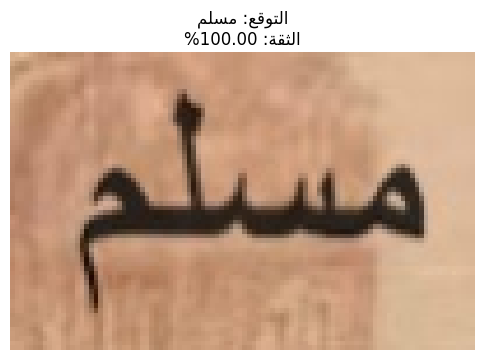

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_385_1.jpg


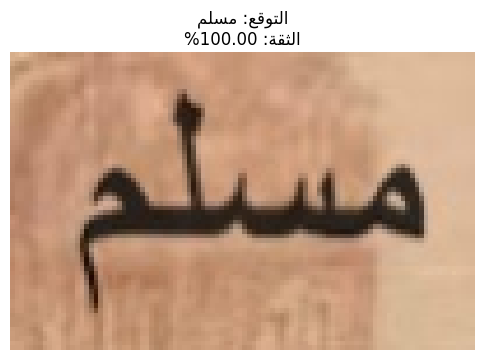

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_398_1.jpg


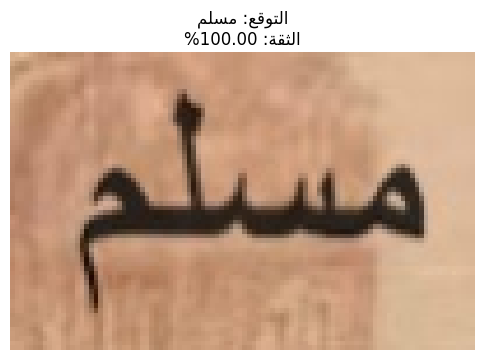

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_399_1.jpg


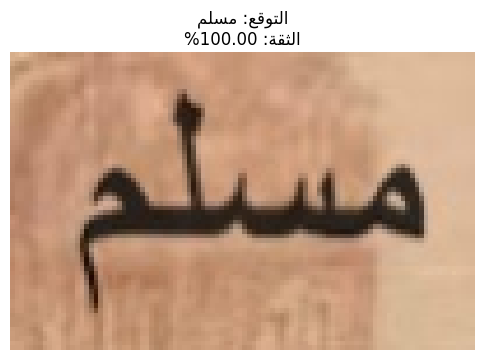

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_3_1.jpg


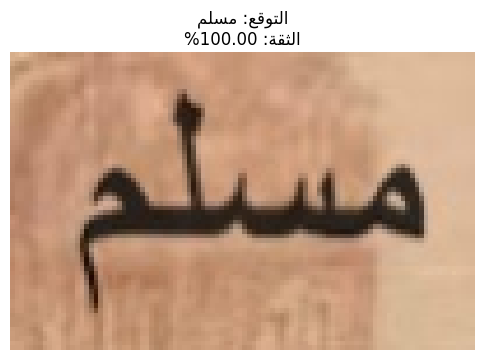

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_412_1.jpg


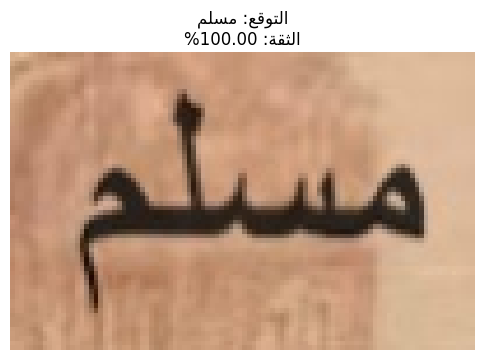

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_413_1.jpg


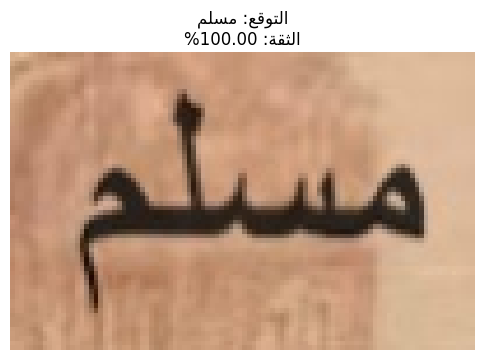

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_417_1.jpg


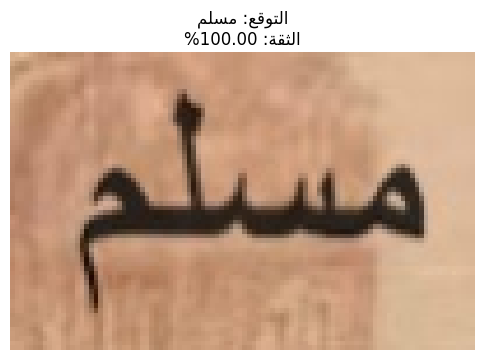

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_42_1.jpg


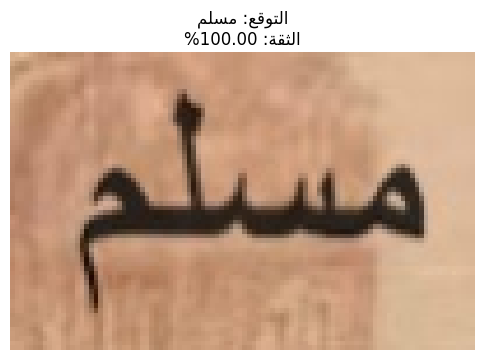

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_436_1.jpg


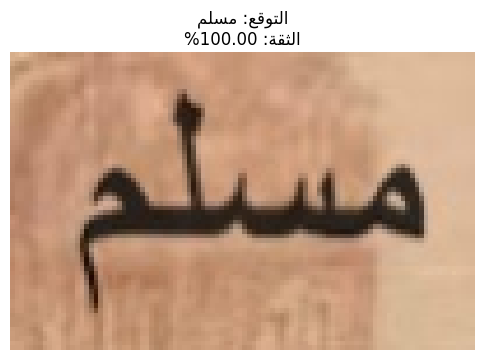

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_437_1.jpg


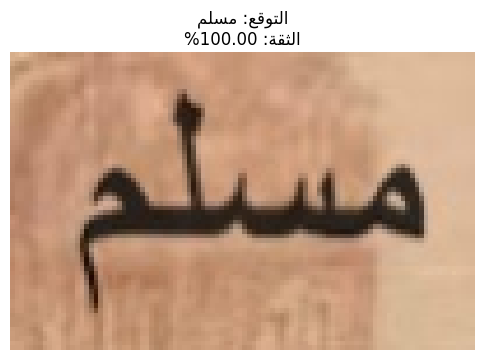

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_440_1.jpg


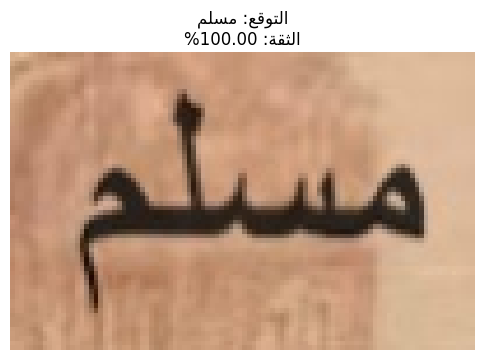

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_441_1.jpg


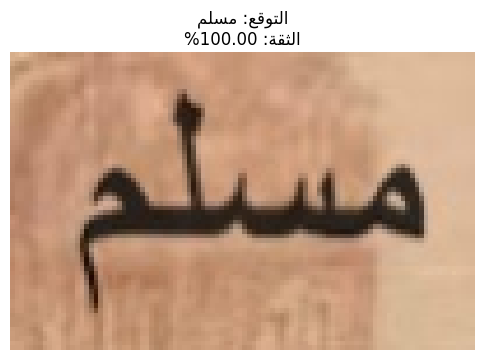

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_444_1.jpg


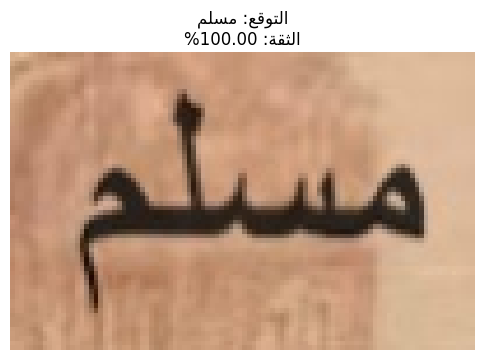

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_45_1.jpg


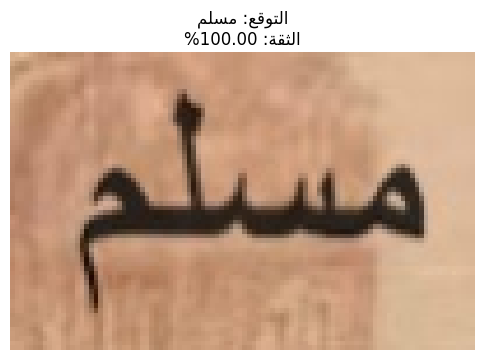

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_463_1.jpg


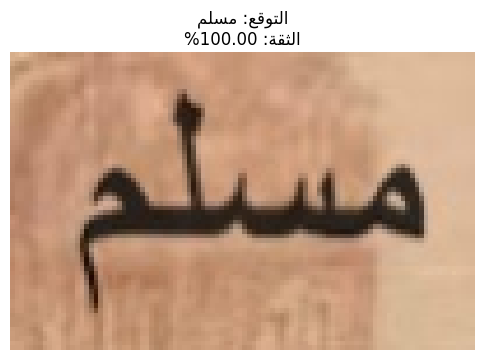

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_464_1.jpg


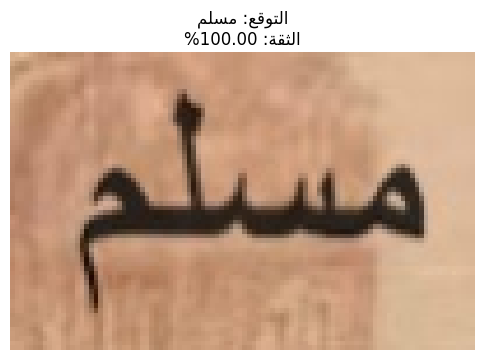

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_468_1.jpg


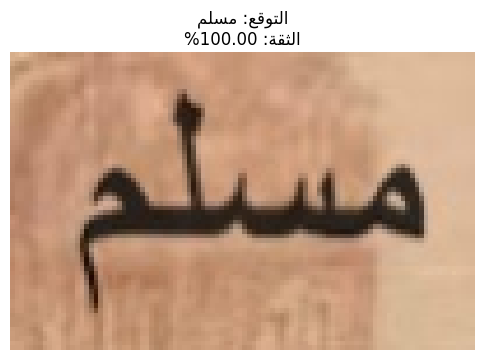

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_469_1.jpg


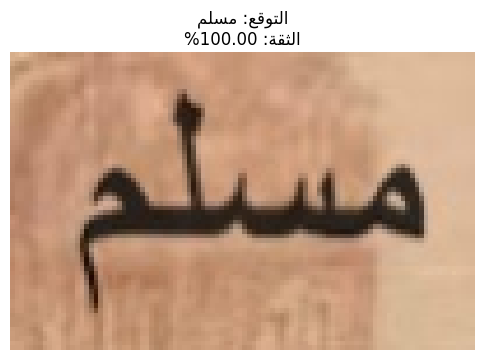

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_474_1.jpg


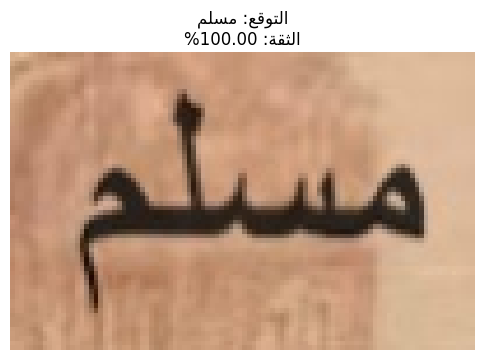

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_475_1.jpg


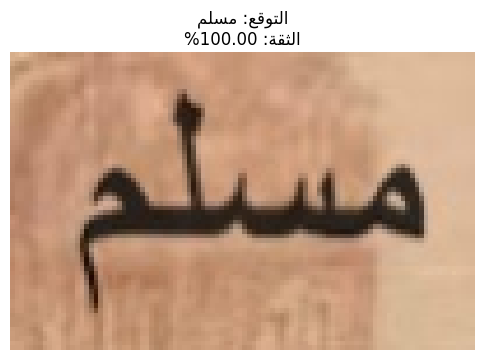

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_480_1.jpg


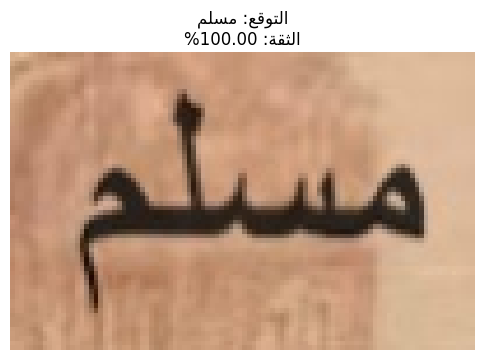

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_48_1.jpg


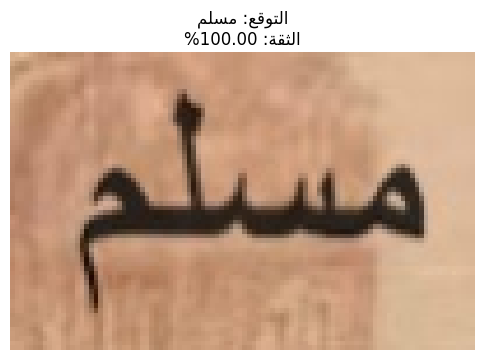

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_497_1.jpg


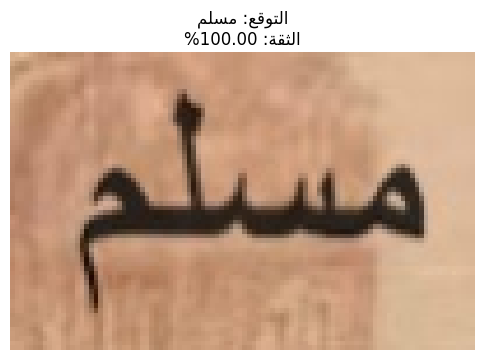

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_498_1.jpg


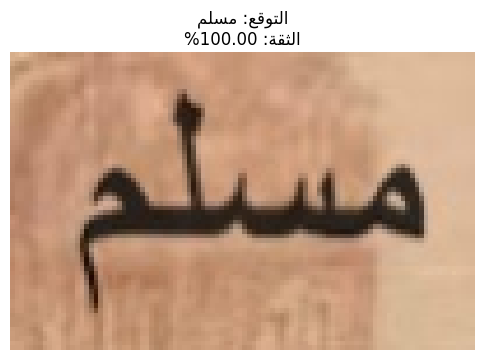

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_53_1.jpg


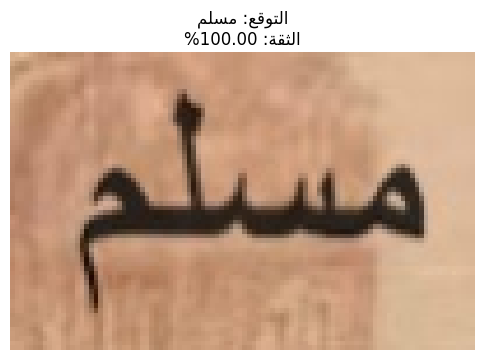

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_54_1.jpg


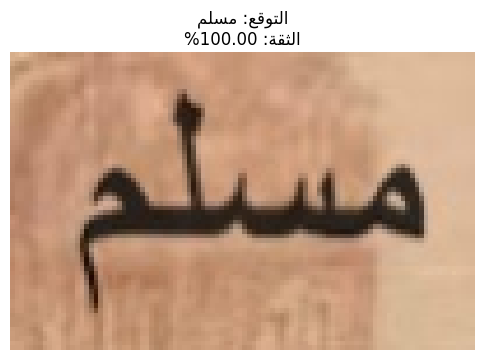

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_60_1.jpg


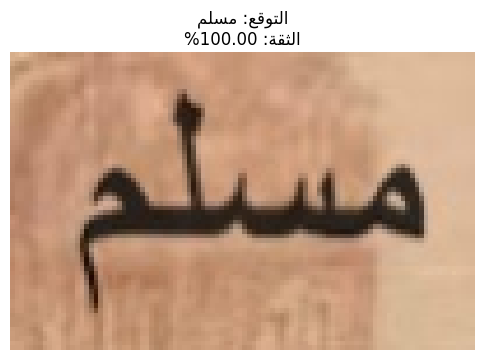

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_61_1.jpg


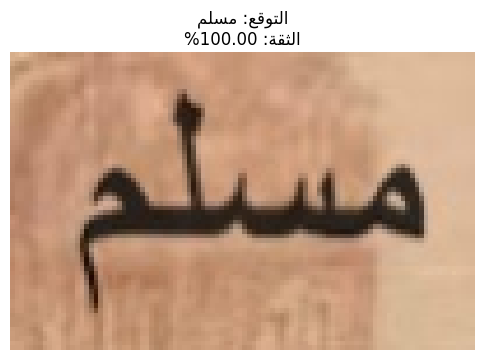

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_76_1.jpg


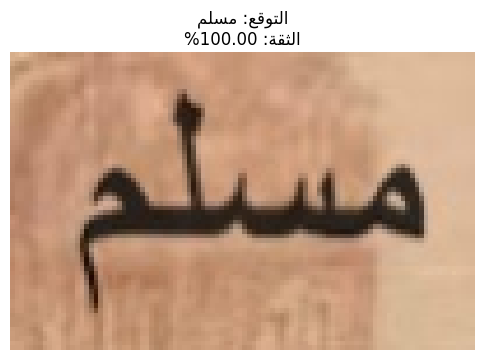

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_77_1.jpg


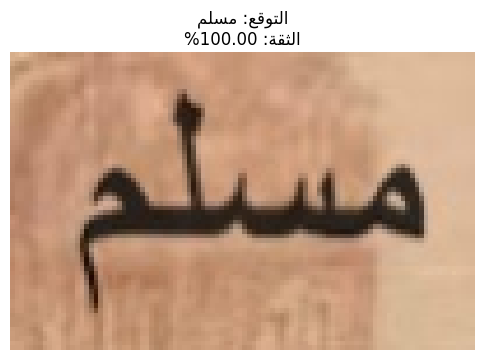

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_83_1.jpg


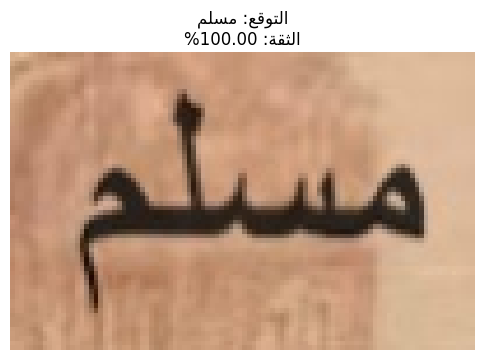

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_84_1.jpg


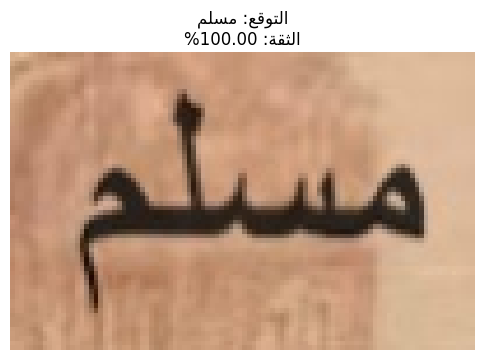

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_89_1.jpg


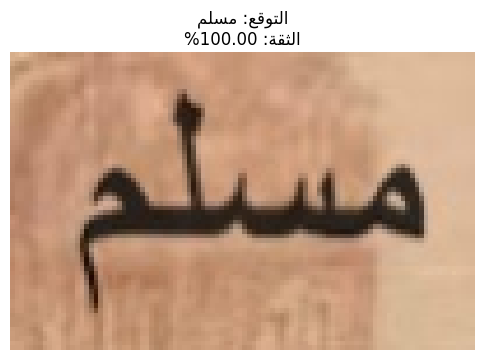

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_90_1.jpg


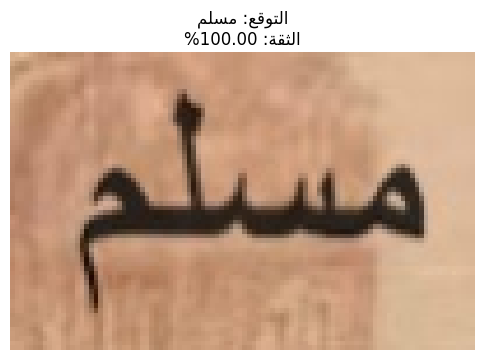

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_94_1.jpg


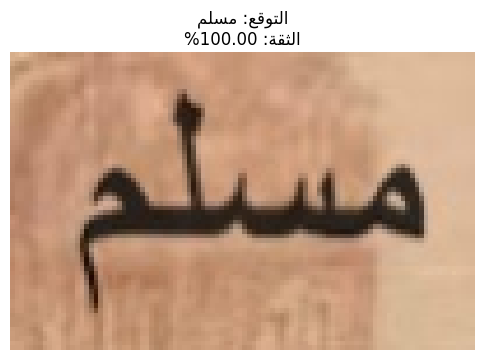

🔹 Processing: C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images\egypt_id_95_1.jpg


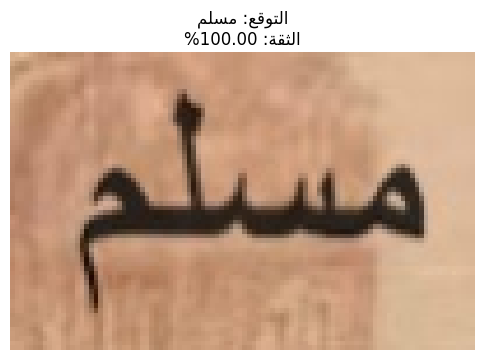

                                      filename prediction  confidence  \
0             augmented_100_egypt_id_189_1.jpg      مسيحي      0.9999   
1             augmented_100_egypt_id_189_5.jpg      مسيحي      1.0000   
2              augmented_101_egypt_id_19_1.jpg       مسلم      1.0000   
3             augmented_102_egypt_id_190_2.jpg     مسيحية      1.0000   
4  augmented_105_egypt_id_193_1لاكخيس (10).jpg      مسيحي      1.0000   

                                     predictions_raw  
0  [5.313602741807699e-06, 2.9781190846733807e-07...  
1  [1.1508489450307025e-07, 3.782353275028072e-08...  
2  [1.0, 5.019423099383857e-09, 5.674065661764871...  
3  [3.146483074090156e-10, 4.351836832938716e-05,...  
4  [5.042559081402942e-08, 1.5276984122181148e-09...  


In [5]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import matplotlib.pyplot as plt
import pandas as pd
import arabic_reshaper
from bidi.algorithm import get_display

def prepare_arabic(text):
    reshaped = arabic_reshaper.reshape(text)
    return get_display(reshaped)

def predict_religion_on_folder(model_path, test_folder, output_csv='religion_predictions.csv'):
    if not os.path.exists(model_path):
        raise FileNotFoundError(f"Model file not found at: {model_path}")
    
    if not os.path.exists(test_folder):
        raise FileNotFoundError(f"Test folder not found at: {test_folder}")
    
    try:
        model = tf.keras.models.load_model(model_path)
        print(f"✅ Successfully loaded model from {model_path}")
    except Exception as e:
        print(f"❌ Error loading model: {str(e)}")
        return None
    
    class_names = ['مسلم', 'مسلمة', 'مسيحي', 'مسيحية']
    results = []
    
    for img_file in os.listdir(test_folder):
        if img_file.lower().endswith(('.png', '.jpg', '.jpeg')):
            try:
                img_path = os.path.join(test_folder, img_file)
                print(f"🔹 Processing: {img_path}")
                
                img = load_img(img_path, target_size=(64, 100))
                img_array = img_to_array(img) / 255.0
                img_array = np.expand_dims(img_array, axis=0)
                
                predictions = model.predict(img_array, verbose=0)
                predicted_class = np.argmax(predictions[0])
                confidence = np.max(predictions[0])
                religion = class_names[predicted_class]
                
                results.append({
                    'filename': img_file,
                    'prediction': religion,
                    'confidence': round(confidence, 4),
                    'predictions_raw': predictions[0].tolist()
                })
                
                # Display the image with prediction
                plt.figure(figsize=(6, 6))
                plt.imshow(img)
                title_text = prepare_arabic(f"التوقع: {religion}\nالثقة: {confidence:.2%}")
                plt.title(title_text)
                plt.axis('off')
                plt.show()
                
            except Exception as e:
                print(f"❌ Error processing {img_file}: {str(e)}")
                results.append({
                    'filename': img_file,
                    'prediction': 'ERROR',
                    'confidence': 0,
                    'predictions_raw': [0, 0, 0, 0]
                })
    
    if results:
        df = pd.DataFrame(results)
        df.to_csv(output_csv, index=False, encoding='utf-8-sig')
        return df
    return None

if __name__ == "__main__":
    model_path = r"religion_cv_results\best_religion_model.h5"
    test_images_folder = r"C:\Users\alhas\Downloads\CNN_Text_Datasets_From_Generator\religion_test_images"  # <-- change this to the actual path

    print(f"Model path exists: {os.path.exists(model_path)}")
    print(f"Test folder exists: {os.path.exists(test_images_folder)}")
    
    if os.path.exists(model_path) and os.path.exists(test_images_folder):
        predictions = predict_religion_on_folder(
            model_path,
            test_images_folder,
            output_csv='religion_predictions.csv'
        )
        if predictions is not None:
            print(predictions.head())
    else:
        print("\n❌ Error: Missing files or directories. Please check paths.")


<!-- import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import matplotlib.pyplot as plt
import pandas as pd
import arabic_reshaper
from bidi.algorithm import get_display

def prepare_arabic(text):
    reshaped = arabic_reshaper.reshape(text)
    return get_display(reshaped)

def predict_religion_on_folder(model_path, test_folder, output_csv='religion_predictions.csv'):
    if not os.path.exists(model_path):
        raise FileNotFoundError(f"Model file not found at: {model_path}")
    
    if not os.path.exists(test_folder):
        raise FileNotFoundError(f"Test folder not found at: {test_folder}")
    
    try:
        model = tf.keras.models.load_model(model_path)
        print(f"✅ Successfully loaded model from {model_path}")
    except Exception as e:
        print(f"❌ Error loading model: {str(e)}")
        return None
    
    class_names = ['مسلم', 'مسلمة', 'مسيحي', 'مسيحية']
    results = []
    
    for img_file in os.listdir(test_folder):
        if img_file.lower().endswith(('.png', '.jpg', '.jpeg')):
            try:
                img_path = os.path.join(test_folder, img_file)
                print(f"🔹 Processing: {img_path}")
                
                img = load_img(img_path, target_size=(64, 100))
                img_array = img_to_array(img) / 255.0
                img_array = np.expand_dims(img_array, axis=0)
                
                predictions = model.predict(img_array, verbose=0)
                predicted_class = np.argmax(predictions[0])
                confidence = np.max(predictions[0])
                religion = class_names[predicted_class]
                
                results.append({
                    'filename': img_file,
                    'prediction': religion,
                    'confidence': round(confidence, 4),
                    'predictions_raw': predictions[0].tolist()
                })
                
                plt.figure(figsize=(6, 6))
                plt.imshow(img)
                title_text = prepare_arabic(f"التوقع: {religion}\nالثقة: {confidence:.2%}")
                plt.title(title_text)
                plt.axis('off')
                plt.show()
                
            except Exception as e:
                print(f"❌ Error processing {img_file}: {str(e)}")
                results.append({
                    'filename': img_file,
                    'prediction': 'ERROR',
                    'confidence': 0,
                    'predictions_raw': [0, 0, 0, 0]
                })
    
    if results:
        df = pd.DataFrame(results)
        df.to_csv(output_csv, index=False)
        return df
    return None

if __name__ == "__main__":
    model_path = r"religion_cv_results/best_religion_model.h5"
    test_images_folder = r"path_to_your_test_images"
    
    print(f"Model path exists: {os.path.exists(model_path)}")
    print(f"Test folder exists: {os.path.exists(test_images_folder)}")
    
    if os.path.exists(model_path) and os.path.exists(test_images_folder):
        predictions = predict_religion_on_folder(
            model_path,
            test_images_folder,
            output_csv='religion_predictions.csv'
        )
        if predictions is not None:
            print(predictions.head())
    else:
        print("\n❌ Error: Missing files or directories. Please check paths.") -->